In [1]:
println("Start")

Start


In [2]:
using Distributions
using Random
using Plots
using PyPlot
using StatsBase
using StatsPlots
using Serialization
using LinearAlgebra
using LinearSolve
using IJulia

import Base.copy

# Problem-Suite

Problem-Suite is a large structured notebook containing all of the functions created so far for this project.

Sections:

-[Miscellaneous Functions](#Miscellaneous-Functions)

-[Pre-requisite functions for uniformised AVI](#Pre-requisite-functions-for-uniformised-AVI)

-[Uniformised AVI functions](#Uniformised-AVI-functions)

-[Pre-requisite functions for SMARVI](#Pre-requisite-functions-for-SMARVI)

-[SMARVI Functions](#SMARVI-Functions)

-[Pre-requisite Functions for Exact DP on Homogeneous Problems](#Pre-requisite-Functions-for-Exact-DP-on-Homogeneous-Problems)

-[Exact DP on Homogeneous Problems (RVIA and PE/PI)](#Exact-DP-for-Homogeneous-problem)

-[Pre-requisite Functions for Exact DP on Inhomogeneous Problems](#Pre-requisite-Functions-for-Exact-DP-on-Inhomogeneous-Problems)

-[Exact DP on Inhomogeneous Problems (RVIA and PE/PI)](#Exact-DP-for-Inhomogeneous-Problem-(using-exact-h-or-VFA))

-[Evaluation via simulation](#Evaluation-via-simulation)

-[APE on Fully Active Policy](#APE-on-Fully-Active-Policy)

-[SMARPE](#SMARPE)

-[Tabular SMARVI and gEval](#tabular-smarvi-and-geval)

-[SMART Functions](#SMART-Functions)

-[SMARVI - New VFA](#SMARVI---New-VFA)

-[SMARPI New VFA Functions](#SMARPI-New-VFA-Functions)

-[FA Usage Cost-to-go Aggregation](#fa-usage-cost-to-go-aggregation)

-[SMARPE for Usage+Penalty costs-to-go](#smarpe-for-usagepenalty-costs-to-go)

-[DCP Heuristic](#dcp-heuristic)

-[Homogeneous Design Problem](#homogeneous-design-problem)

-[Two Link Multiple Copies Design Problem](#two-link-multiple-copy-design-problem)

-[Experiments on Homog Design Problem](#experiments-on-homog-design-problem)

-[Experiments on TLMC Problems](#experiments-on-tlmc-problems)

-[Experiments for Unconstrained DCP Problems](#experiments-for-unconstrained-dcp-problems)

-[Experiments on Constrained DCP Problems](#experiments-on-constrained-dcp-problems)

-[Experiments on Small Problems](#Experiments-on-Small-Problems)

-[Experiments on Large Problems](#Experiments-on-Large-Problems)

# Miscellaneous Functions

-Functions for enumerating state and action spaces

-Functions for calculating flows given a state or state-action pair

-Function for evaluating a VFA at a given state

In [3]:
mutable struct problemParams
    #Misc
    N::Int64 #Number of links
    beta::Float64 #demand

    #rates
    alpha::Array{Float64} #array of deg rates
    tau::Array{Float64} #array of repair rates
    
    #Costs
    c::Array{Float64} #array of usage costs
    r::Array{Float64} #array of repair costs
    p::Float64 #penalty cost
end

In [4]:
function problemParams()
    return problemParams(0, 0.0, [], [], [], [], 0.0)
end

function problemParams(; N = 0, beta = 0.0, alpha = [], tau = [], c = [], r = [], p = 0.0)
    return problemParams(N, beta, alpha, tau, c, r, p)
end

problemParams

In [5]:
function copy(probParams::problemParams)
    (; N, beta, alpha, tau, c, r, p) = probParams
    return problemParams(N, beta, alpha, tau, c, r, p)
end

copy (generic function with 134 methods)

In [6]:
function problemParamsSubset(probParams::problemParams, dcp::Array{Int64})
    (; N, beta, alpha, tau, c, r, p) = probParams
    newN = sum(dcp)
    newAlpha = []
    newTau = []
    newC = []
    newR = []

    for i in 1:N
        if dcp[i] == 1
            push!(newAlpha, alpha[i])
            push!(newTau, tau[i])
            push!(newC, c[i])
            push!(newR, r[i])
        end
    end

    return problemParams(newN, beta, newAlpha, newTau, newC, newR, p)
end

problemParamsSubset (generic function with 1 method)

In [7]:
#produce an array of array representations of all possible states
function enumerateStates(N::Int64)
    if N==1
        return [[1],[2],[3]]
    end
    
    output = []
    lower = enumerateStates(N-1)
    for s in lower
        new1 = append!([1],s)
        new2 = append!([2],s)
        new3 = append!([3],s)
        append!(output,[new1])
        append!(output,[new2])
        append!(output,[new3])
    end
    
    return output
end

#produce an array of array representations of all possible actions
function enumerateActions(N::Int64)
    if N==1
        return [[0],[1]]
    end
    
    output = []
    lower = enumerateActions(N-1)
    for a in lower
        new1 = append!([0],a)
        new2 = append!([1],a)
        append!(output,[new1])
        append!(output,[new2])
    end
    
    return output
end    

#produce an array of array representations of all possible actions subject to a cardinality constraint
function enumerateActions(N::Int64, K::Int64)
    if K == 0
        return [fill(0, N)]
    end

    if N == 1
        return [[0],[1]]
    end
    
    if K == 1
        output = []
        for i in 1:N
            new = fill(0, N)
            new[i] = 1
            push!(output, new)
        end

        return output
    end

    if N <= K
        return enumerateActions(N)
    end

    output = []
    lower = enumerateActions(N-1, K)
    for a in lower
        new1 = append!([0],a)
        append!(output,[new1])
        if sum(a) < K
            new2 = append!([1],a)
            append!(output,[new2])
        end
    end
    
    return output
end   

#produce array of array representations of all restricted, or single-repair, actions
function enumerateRestrictedActions(N::Int64)
    if N==1
        return [[0],[1]]
    end
    
    output = [zeros(Int64,N)]
    for i in 1:N
        temp = zeros(N)
        temp[i] = 1
        append!(output,[temp])
    end
    
    return output
end

#convert all array elements to string, then concatanate all elements (DEPRECATED AS DICTS CAN TAKE ARRAYS AS KEYS)
function arrayToString(x)
    return join(string.(x))
end

arrayToString (generic function with 1 method)

In [8]:
#function for calculating the flows given a state
function calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    #update flows
    flows = zeros(N)
    healthy = sum(i == 1 for i in s)
    
    #if no links are healthy, return 
    if healthy == 0
        return flows, c1
    end
    
    #otherwise, find best route, and return
    bestCost = maximum(c0) + 1
    usedLink = 0
    for k in 1:N
        if s[k] == 1 && c0[k] < bestCost
            bestCost = c0[k]
            usedLink = k
        end
    end
    
    flows[usedLink] = beta
    
    return flows, bestCost
end

#function for calculating the flows given a state-action pair
function calculateFlows(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    sPrime = s - a
    return calculateFlows(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
end

#function call from problemParams struct
function calculateFlows(s, probParams::problemParams)
    (; N, beta, alpha, tau, c, r, p) = probParams
    alpha_d = fill(0.0, N)
    return calculateFlows(s,N,alpha_d, alpha, beta, tau, c, p, r)
end

#function call with action from problemParams struct
function calculateFlows(s, a, probParams::problemParams)
    (; N, beta, alpha, tau, c, r, p) = probParams
    alpha_d = fill(0.0, N)
    return calculateFlows(s - a, N,alpha_d, alpha, beta, tau, c, p, r)
end

calculateFlows (generic function with 4 methods)

In [9]:
#evaluate a VFA at a given state
function v(s::Vector{Int64}, params::Vector{Float64}, features::Vector{Function})
    numFeatures = length(features)
    return params[1] + sum(params[i+1]*features[i](s) for i in 1:numFeatures)
end

v (generic function with 1 method)

In [10]:
#version of v that takes flows for the features
function v(s::Vector{Int64}, flows::Vector{Float64}, params::Vector{Float64}, features::Vector{Function})
    N = length(params)
    return params[1] + sum(params[i]*features[i-1](s, flows) for i in 2:N)
end

v (generic function with 2 methods)

In [11]:
#Note here that tau is a vector of independend repair rates
function calculatePi_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, lambda)
    mu = fill(0.0, N)
    nu = tau + alpha_r + lambda
    pi = fill(0.0, N, 3) #index by pi[edge, state]
    alpha_u = beta*alpha_d + alpha_r
    mu[1] = alpha_u[1]
    pi[1,1] = lambda[1]*tau[1]/(mu[1]*nu[1]+lambda[1]*tau[1])
    pi[1,2] = (lambda[1]/nu[1])*(1 - pi[1,1])
    pi[1,3] = 1 - pi[1,1] - pi[1,2]

    useprob = 1
    for i in 2:N
        useprob = useprob*(1 - pi[i-1,1])
        mu[i] = useprob*alpha_u[i] + (1 - useprob)alpha_r[i]
        normConst = mu[i]*nu[i] + lambda[i]*tau[i]
        pi[i,1] = tau[i]*lambda[i]/normConst
        pi[i,2] = (lambda[i]/nu[i])*(1 - pi[i,1])
        pi[i,3] = 1 - pi[i,1] - pi[i,2]
    end

    return pi
end

calculatePi_SSP (generic function with 1 method)

In [12]:
function calculateG_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, lambda)
    pi = calculatePi_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, lambda)
    prodNonHealthy = fill(0.0, N)
    prodNonHealthy[1] = 1 - pi[1,1]
    for i in 2:N
        prodNonHealthy[i] = prodNonHealthy[i-1]*(1 - pi[i,1])
    end

    return sum(r[i]*pi[i,2] for i in 1:N) + beta*c0[1]pi[1,1] + sum(beta*c0[i]*pi[i,1]*prodNonHealthy[i-1] for i in 2:N)+ beta*c1*prodNonHealthy[N], pi
end

calculateG_SSP (generic function with 1 method)

In [13]:
function calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsPolicy)
    if dsPolicy == fill(0,N)
        return beta*c1
    end
    S = []
    K = 0

    #calculate S the set of maintained links and K the number of maintained links
    prodNonHealthy = [1.0]
    prodNonHealthyCurrent = 1
    for i in 1:N
        if dsPolicy[i] == 1
            push!(S, i)
            K+=1
        end
    end

    #calculate p_AD(j in S, j<i) for all i in S, and p_AD(i in S)
    for i in S
        prodNonHealthyCurrent = prodNonHealthyCurrent*alpha_r[i]/(alpha_r[i] + tau[i])
        push!(prodNonHealthy, prodNonHealthyCurrent)
    end

    #calculate and return g
    return sum(r[S[i]]*alpha_r[S[i]]/(alpha_r[S[i]] + tau[S[i]]) + beta*c0[S[i]]*tau[S[i]]*prodNonHealthy[i]/(alpha_r[S[i]] + tau[S[i]]) for i in 1:K) + beta*c1*prodNonHealthy[K+1]
end

function calculateG_DSP(probParams::problemParams, dcp)
    (; N, beta, alpha, tau, c, r, p) = probParams
    alpha_d = fill(0.0, N)
    return calculateG_DSP(N,alpha_d, alpha, beta, tau, c, p, r, dcp)
end

calculateG_DSP (generic function with 2 methods)

In [14]:
function calculateG_SSP_Homog(N,alpha_d, alpha_r, beta, tau, c0, c1, r, lambdaActive, K)
    alpha_d = [alpha_d for i in 1:N]
    alpha_r = [alpha_r for i in 1:N]
    c0 = fill(c0, N)
    r = fill(r, N)
    lambda = fill(0.0, N)
    for i in 1:K
        lambda[i] = lambdaActive
    end

    return calculateG_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, lambda)
end

calculateG_SSP_Homog (generic function with 1 method)

In [15]:
#Computes the Fully Active action for a given state s
function faAction(s)
    N = length(s)
    a = zeros(Int64,N)
    for i in 1:N
        if s[i] == 3
            a[i] = 1
        end
    end
    return a
end

faAction (generic function with 1 method)

In [16]:
function sampleTruncExp(mean, upper)
    while true
        s = rand(Exponential(mean))
        if s < upper
            return s
        end
    end
end

sampleTruncExp (generic function with 1 method)

# Pre-requisite functions for uniformised AVI

This section contains functions used within the AVI algorithms

Given a state-action pair, return the next random pre-decision state, the instant cost, and the updated flows

In [17]:
function updateStateAndFlowsUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, flows)
    #immediate change
    sPrime = s - a
    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    #observe exogenous information
    w = rand(Uniform(0, 1))
    
    #interpret exog info: is it a demand deg, rare deg, or completed repair 
    found = false
    runningTotal = 0
    
    #demand degs
    for k in 1:N
        if runningTotal <= w <= runningTotal + flows[k]*alpha_d[k]*del
            found = true
            sPrime[k] = 3
            #println("Demand Deg at "*string.(k))
            break
        end
        runningTotal = runningTotal + flows[k]*alpha_d[k]*del
    end
    
    #rare degs
    if found == false
        for k in 1:N
            if runningTotal <= w <= runningTotal + (s[k]!=3)*alpha_r[k]*del
                found = true
                sPrime[k] = 3
                #println("Rare Deg at "*string.(k))
                break
            end
            runningTotal = runningTotal + alpha_r[k]*del
        end
    end
    
    #repairs
    if found == false
        for k in 1:N
            if runningTotal <= w <= runningTotal + (s[k]==2)*tau[k]*del
                found = true
                sPrime[k] = 1
                break
            end
            runningTotal = runningTotal + (s[k]==2)*tau[k]*del
        end
    end
    
    if found == false
        #println("NO EVENT")
    end
    
    #update flows
    flowUpdate = calculateFlows(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    newFlows = flowUpdate[1]
    bestCost = flowUpdate[2]
    healthy = sum(i == 1 for i in sPrime)
    
    return sPrime, (beta*bestCost + sum(r[k]*(sPrime[k]==2) for k in 1:N))*del, newFlows
end

updateStateAndFlowsUnif (generic function with 1 method)

Given a state action pair, return the instant cost over the delta timestep.

In [18]:
#instant cost over the timestep
function instantCostUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
    #immediate change
    sPrime = s - a
    healthy = sum(sPrime[i] == 1 for i in 1:N)
    repair = sum(sPrime[i] == 2 for i in 1:N)
    damaged = sum(sPrime[i] == 3 for i in 1:N)
    
    #update flows
    flowUpdate = calculateFlows(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    newFlows = flowUpdate[1]
    bestCost = flowUpdate[2]
    
    return (beta*bestCost + sum(r[k]*(sPrime[k]==2) for k in 1:N))*del
end

instantCostUnif (generic function with 1 method)

# Pre-requisite functions for SMARVI

Helper functions for the SMARVI algorithms

Given a state-action pair and pre-calculated flows, return the expected sojourn time for the state-action pair.

In [19]:
#Calculate the expected sojourn time of a state-action pair
function sojournTime(s, a, flows, N, alpha_d, alpha_r, beta, tau)
    s = s - a
    if s == fill(3,N)
        return 1/(beta*sum(alpha_d) + sum(alpha_r) + sum(tau))
    end
    
    
    totalRate = sum(flows[i]*alpha_d[i] + alpha_r[i]*(s[i]!=3) + tau[i]*(s[i]==2) for i in 1:N)
    
    return 1/totalRate
end

function sojournTime(s, flows, N, alpha_d, alpha_r, beta, tau)
    if s == fill(3,N)
        return 1/(beta*sum(alpha_d) + sum(alpha_r) + sum(tau))
    end
    
    
    totalRate = sum(flows[i]*alpha_d[i] + alpha_r[i]*(s[i]!=3) + tau[i]*(s[i]==2) for i in 1:N)
    
    return 1/totalRate
end

sojournTime (generic function with 2 methods)

In [20]:
function sojournTime_MCP(s, mcp, flows, N, alpha_d, alpha_r, beta, tau)
    #deal with instant repairs
    for i in 1:N
        if s[i] == 3 && mcp[i] == -1
            return 0.0
        end
    end

    totalRate = sum(flows[i]*alpha_d[i] + alpha_r[i]*(s[i]!=3) + tau[i]*(s[i]==2) + mcp[i]*(s[i] == 3 && mcp[i]!= -1) for i in 1:N)

    return 1/totalRate
end

sojournTime_MCP (generic function with 1 method)

Given a state-action pair and flows, calculate the expected cost accumulated until a transition occurs, or calculate the simulated cost accumulated over a simulated time del.

In [21]:
#calculate the expected cost accumulated until a transition 
function instantCostCont(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows; del = 0)
    if del == 0
        del = sojournTime(s, a, flows, N, alpha_d, alpha_r, beta, tau)
    end
    
    return instantCostUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
end

function instantCostCont(s, a, probParams, flows; del = 0)
    (; N, alpha, beta, tau, c, p, r) = probParams
    alpha_d = fill(0.0, N)
    return instantCostCont(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows; del = del)
end


instantCostCont (generic function with 2 methods)

Given a state-action pair, return the next random pre-decision state, the cost accumulated over the sojourn time, and the updated flows

In [22]:
function updateStateAndFlowsCont(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
    #immediate change
    sPrime = s - a
    sOld = copy(sPrime)
    flowsOld = copy(flows)
    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    #deal with all-damaged edge case
    if sPrime == fill(3, N)
        del = 1/(sum(beta*alpha_d) + sum(alpha_r) + sum(tau))
        return sPrime, beta*c1*del, flows, del
    end

    #create list of events (degradations for all non-damaged links and repair events for all repairing links) and list of rates
    events = [i for i in 1:N if sPrime[i]!=3]
    eventsRep = [N + i for i in 1:N if sPrime[i] == 2]
    append!(events, eventsRep)

    rates = [flows[i]*alpha_d[i] + alpha_r[i] for i in 1:N if sPrime[i]!=3]
    ratesRep = [tau[i] for i in 1:N if sPrime[i] == 2]
    append!(rates, ratesRep)

    #sample event
    del = 1/sum(rates)
    event = wsample(events, rates)

    #if event >= N+1, it's a repair, otherwise it's a degradation
    if event >= N + 1 
        sPrime[event - N] = 1
    else
        sPrime[event] = 3
    end
    
    #update flows
    flowUpdate = calculateFlows(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    newFlows = flowUpdate[1]
    bestCost = flowUpdate[2]
    
    return sPrime, (beta*c1*(healthy == 0) + sum(flowsOld[k]*c0[k] + r[k]*(sOld[k]==2) for k in 1:N))*del, newFlows, del
end

updateStateAndFlowsCont (generic function with 1 method)

In [23]:
function updateStateAndFlowsCont_DCP(s,dcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
    a = [(dcp[i] == 1)*(s[i] == 3) for i in 1:N]
    if sum(a) > 0
        return s - a, 0.0, flows, 0.0
    end
    return updateStateAndFlowsCont(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
end

updateStateAndFlowsCont_DCP (generic function with 1 method)

Given a state and an MCP (mixed composite policy), return the post-transition state, the cost accumulated over the sojourn time, and the updated flows. 
MCP allows for exact instant repairs, and random repair starts, essentially allowing for a "soft" version of DCPs.

In [24]:
function updateStateAndFlowsCont_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
    #handle instant repairs
    sPrime = copy(s)
    instantChangeFlag = false
    for i in 1:N
        if sPrime[i] == 3 && mcp[i] == -1
            sPrime[i] = 2
            instantChangeFlag = true
        end
    end

    if instantChangeFlag
        return sPrime, 0.0, flows, 0.0
    end

    #main body
    sOld = copy(sPrime)
    flowsOld = copy(flows)
    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)


    #create list of events (degradations for all non-damaged links and repair events for all repairing links) and list of rates
    events = [i for i in 1:N if sPrime[i]!=3]
    eventsRep = [N + i for i in 1:N if sPrime[i] == 2]
    eventsRepStart = [2*N + i for i in 1:N if mcp[i] != -1 && sPrime[i] == 3]
    append!(events, eventsRep)
    append!(events, eventsRepStart)

    rates = [flows[i]*alpha_d[i] + alpha_r[i] for i in 1:N if sPrime[i]!=3]
    ratesRep = [tau[i] for i in 1:N if sPrime[i] == 2]
    ratesRepStart = [mcp[i] for i in 1:N if mcp[i] != -1 && sPrime[i] == 3]
    append!(rates, ratesRep)
    append!(rates, ratesRepStart)

    #calculate sojourn time sample event
    del = 1/sum(rates)

    #sample event
    event = wsample(events, rates)
    
    #interpret event
    if event <= N
        sPrime[event] = 3 #degradation
    elseif N < event && event <= 2*N
        sPrime[event - N] = 1 #successful repair
    else
        sPrime[event - 2*N] = 2 #random repair Start
    end
    
    #update flows
    flowUpdate = calculateFlows(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    newFlows = flowUpdate[1]
    bestCost = flowUpdate[2]
    
    return sPrime, (beta*c1*(healthy == 0) + sum(flowsOld[k]*c0[k] + r[k]*(sOld[k]==2) for k in 1:N))*del, newFlows, del
end

updateStateAndFlowsCont_MCP (generic function with 1 method)

Generate random action for e-greedy algorithms

In [25]:
#Calculate random action for e-greedy algorithms
function randomAction(s,N)
    #deal with all-damaged case
    if s == fill(3,N)
        return randomActionAllDamaged(N)
    end

    damaged = [0]
    for i in 1:N
        if s[i] == 3
            append!(damaged, [i])
        end
    end
            
    choice = sample(damaged)
    optA = zeros(Int64, N)
    if choice == 0
        return optA
    else
        optA[choice] = 1
        return optA
    end
end

#calculate random action for [3,3...,3] state
function randomActionAllDamaged(N)
    choice = sample(1:N)
    a = zeros(Int64, N)
    a[choice] = 1
    return a
end

randomActionAllDamaged (generic function with 1 method)

# Pre-requisite Functions for Exact DP on Homogeneous Problems 

Helper functions for Homogeneous Exact DP

Calculates instant cost for homogeneous problem

In [26]:
#instant cost function strictly for homogeneous problem
function instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
    #immediate change
    i1Prime = i1 - a
    i2Prime = i2 + a
    
    #if no links are healthy, return 
    if N - i1 - i2 == 0
        return (beta*c1 + r*i2Prime)*del
    end
    
    
    return (beta*c0 + r*i2Prime)*del
end

instantCostHomog (generic function with 1 method)

Given state (i_1, i_2) and action a, calculates the expected next value function after one timestep

In [27]:
#calculates E(h(s')) from s,a strictly for a homogeneous problem
function expectedNextValueHomog(i1,i2, h, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
    #immediate change
    i1Prime = i1 - a
    i2Prime = i2 + a
    thisH = h[i1Prime+1,i2Prime+1]
    
    #if all are damaged
    if i1Prime == N
        return thisH
    end
    
    #if none are healthy
    if N - i1 - i2 == 0
        return thisH + tau*i2Prime*del*(h[i1Prime+1,i2Prime-1+1] - thisH) + i2Prime*del*alpha_r*(h[i1Prime+1+1, i2Prime-1+1] - thisH)
    end
    
    #if none are repairing
    if i2Prime == 0
        return thisH + (beta*alpha_d + (N - i1Prime - i2Prime)*alpha_r)*del*(h[i1Prime+1+1,i2Prime+1] - thisH)
    end
    
    return thisH + (beta*alpha_d + (N - i1Prime - i2Prime)*alpha_r)*del*(h[i1Prime+1+1,i2Prime+1] - thisH) + i2Prime*alpha_r*del*(h[i1Prime+1+1,i2Prime-1+1] - thisH) + tau*i2Prime*del*(h[i1Prime+1,i2Prime-1+1] - thisH)
end

expectedNextValueHomog (generic function with 1 method)

Given state (i_1,i_2) and value function h, calculates and returns the best action for the state using full expectations.

In [28]:
#calculates the exact PI action strictly for a homogeneous problem
function piActionHomog(i1, i2, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; forceActive = false)
    if i1 == 0
        return 0
    end
    
    if i1 == N && forceActive
        optA = 1
        optH = instantCostHomog(i1,i2,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
        for a in 2:i1
            testH = instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
            if testH <= optH
                optA = a
                optH = testH
            end
        end
        return optA
    end
    
    optA = 0
    optH = instantCostHomog(i1,i2,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
    for a in 1:i1
        testH = instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
        if testH <= optH
            optA = a
            optH = testH
        end
    end
    
    return optA
end

piActionHomog (generic function with 1 method)

Similar to above, but uses the approximation Q(s,a) = h(s+a) for a!=0

In [29]:
#calculates the approx PI action based on instantaneous approximation, strictly for a homogeneous problem
function piActionHomogApprox(i1, i2, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g; forceActive = false)
    #deal with "nothing damaged" edge case
    if i1 == 0
        return 0
    end
    
    #deal with "everything damaged" edge case
    if i1 == N && forceActive
        optA = 1
        optH = h[i1-optA+1,i2+optA+1]
        for a in 2:i1
            testH = h[i1-a+1,i2+a+1]
            if testH <= optH
                optA = a
                optH = testH
            end
        end
        return optA
    end
    
    optA = 0
    optH = instantCostHomog(i1,i2,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) - g*del
    for a in 1:i1
        testH = h[i1-a+1,i2+a+1]
        if testH <= optH
            optA = a
            optH = testH
        end
    end
    
    return optA
end

piActionHomogApprox (generic function with 1 method)

Given h, constructs optimal policy using exact PI method

In [30]:
#calculates the exact PI policy strictly for a homogeneous problem
function piPolicyHomog(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; forceActive = false)
    policy = zeros(Int64, N+1, N+1)
    for i1 in 0:N
        for i2 in 0:(N - i1)
            policy[i1+1,i2+1] = piActionHomog(i1, i2, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; forceActive = forceActive)
        end
    end
    
    return policy
end

piPolicyHomog (generic function with 1 method)

Given h, constructs optimal policy using Q(s,a) = h(s,a) for a!=0 approximation

In [31]:
#calculates the approx PI policy based on instantaneous approximation, strictly for a homogeneous problem
function piPolicyHomogApprox(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g; forceActive = false)
    policy = zeros(Int64, N+1, N+1)
    for i1 in 0:N
        for i2 in 0:(N - i1)
            policy[i1+1,i2+1] = piActionHomogApprox(i1, i2, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g; forceActive = forceActive)
        end
    end
    
    return policy
end

piPolicyHomogApprox (generic function with 1 method)

Constructs a h table from a VFA

In [32]:
function hFromVFAHomog(N, params, features)
    #construct hIn table
    hIn = zeros(Float64, N+1, N+1)
    for i1 in 0:N
        for i2 in 0:(N - i1)
            s = fill(1,N)
            if i1 > 0
                for i in 1:i1
                    s[i] = 3
                end
            end
            
            if i2 > 0
                for i in (i1+1):(i1+i2)
                    s[i] = 2
                end
            end
            
            hIn[i1+1,i2+1] = v(s, params, features)
        end
    end
    
    return hIn
end

hFromVFAHomog (generic function with 1 method)

# Exact DP for Homogeneous problem

Actual DP algorithms 

Given a h table, performs PE on PI policy derived from h, and returns g, h, n (number of iterations), and the PI policy

In [33]:
#Evaluates a PI policy based on a given exact h function, strictly for a homogeneous problem 
function rpiHomog(N::Int64, hIn, alpha_d::Float64, alpha_r::Float64, beta::Float64, tau, c0::Float64, c1::Float64, r::Float64, epsilon::Float64; nMax = 0, delScale = 1, forceActive = false)
    #calculate stepsize and initialise h,w,and policy vectors
    del = 1/(delScale*(beta*alpha_d + N*alpha_r + N*tau))
    h = zeros(Float64, N+1, N+1)
    w = zeros(Float64, N+1, N+1)
    policy = piPolicyHomog(hIn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; forceActive = forceActive)
    n = 0
    #repeat until epsilion-convergence or n = nMax
    while true
        n = n + 1
        #calculate new w values
        for i1 in 0:N
            for i2 in 0:(N - i1)
                a = policy[i1+1,i2+1]
                w[i1+1,i2+1] = instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
            end
        end
        
        
        #calculate new relative values
        hNew = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:(N - i1)
                hNew[i1+1,i2+1] = w[i1+1,i2+1] - w[1,1]
            end
        end
        
        #check for convergence
        deltas = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:N-i1
                deltas[i1+1,i2+1] = hNew[i1+1,i2+1] - h[i1+1,i2+1]
            end
        end
        
        h = hNew
        if maximum(deltas) < epsilon || n == nMax
            break
        end
    end
    
    v = beta*c0*del + (beta*alpha_d + (N)*alpha_r)*del*h[1+1,0+1] + (1 - (beta*alpha_d + (N)*alpha_r)*del)*h[0+1,0+1]
    
    return v/del, h, n, policy
end

rpiHomog (generic function with 1 method)

Performs PE on the fully active policy

In [34]:
#Evaluates the fully active policy, strictly for a homogeneous problem 
function rpeFAHomog(N::Int64, alpha_d::Float64, alpha_r::Float64, beta::Float64, tau, c0::Float64, c1::Float64, r::Float64, epsilon::Float64; nMax = 0, delScale = 1, forceActive = false)
    #calculate stepsize and initialise h,w,and policy vectors
    del = 1/(delScale*(beta*alpha_d + N*alpha_r + N*tau))
    h = zeros(Float64, N+1, N+1)
    w = zeros(Float64, N+1, N+1)
    n = 0
    #repeat until epsilion-convergence or n = nMax
    while true
        n = n + 1
        #calculate new w values
        for i1 in 0:N
            for i2 in 0:(N - i1)
                a = i1
                w[i1+1,i2+1] = instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
            end
        end
        
        
        #calculate new relative values
        hNew = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:(N - i1)
                hNew[i1+1,i2+1] = w[i1+1,i2+1] - w[1,1]
            end
        end
        
        #check for convergence
        deltas = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:N-i1
                deltas[i1+1,i2+1] = hNew[i1+1,i2+1] - h[i1+1,i2+1]
            end
        end
        
        h = hNew
        if maximum(deltas) < epsilon || n == nMax
            break
        end
    end
    
    v = beta*c0*del + (beta*alpha_d + (N)*alpha_r)*del*h[1+1,0+1] + (1 - (beta*alpha_d + (N)*alpha_r)*del)*h[0+1,0+1]
    
    return v/del, h, n
end

rpeFAHomog (generic function with 1 method)

Similar to rpiHomog, but uses Q(s,a) = h(s,a) approximation for PI step.

In [35]:
#Evaluates an approximate PI policy based on a given exact h function and instananeous actions, strictly for a homogeneous problem 
function rpiHomogApprox(N::Int64, hIn, alpha_d::Float64, alpha_r::Float64, beta::Float64, tau, c0::Float64, c1::Float64, r::Float64, epsilon::Float64, g::Float64; nMax = 0, delScale = 1, forceActive = false)
    #calculate stepsize and initialise h,w,and policy vectors
    del = 1/(delScale*(beta*alpha_d + N*alpha_r + N*tau))
    h = zeros(Float64, N+1, N+1)
    w = zeros(Float64, N+1, N+1)
    policy = piPolicyHomogApprox(hIn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g; forceActive = forceActive)
    n = 0
    #repeat until epsilion-convergence or n = nMax
    while true
        n = n + 1
        #calculate new w values
        for i1 in 0:N
            for i2 in 0:(N - i1)
                a = policy[i1+1,i2+1]
                w[i1+1,i2+1] = instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
            end
        end
        
        
        #calculate new relative values
        hNew = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:(N - i1)
                hNew[i1+1,i2+1] = w[i1+1,i2+1] - w[1,1]
            end
        end
        
        #check for convergence
        deltas = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:N-i1
                deltas[i1+1,i2+1] = hNew[i1+1,i2+1] - h[i1+1,i2+1]
            end
        end
        
        h = hNew
        if maximum(deltas) < epsilon || n == nMax
            break
        end
    end
    
    v = beta*c0*del + (beta*alpha_d + (N)*alpha_r)*del*h[1+1,0+1] + (1 - (beta*alpha_d + (N)*alpha_r)*del)*h[0+1,0+1]
    
    return v/del, h, n, policy
end

rpiHomogApprox (generic function with 1 method)

Performs RVIA

In [36]:
#Performs RVIA 
function rviHomog(N::Int64, alpha_d::Float64, alpha_r::Float64, beta::Float64, tau, c0::Float64, c1::Float64, r::Float64, epsilon::Float64; nMax = 0, delScale = 1, forceActive = false)
    #calculate stepsize and initialise h,w,and policy vectors
    del = 1/(delScale*(beta*alpha_d + N*alpha_r + N*tau))
    h = zeros(Float64, N+1, N+1)
    w = zeros(Float64, N+1, N+1)
    n = 0
    deltas = zeros(Float64, N+1, N+1)
    #repeat until epsilion-convergence or n = nMax
    while true
        n = n + 1
        #calculate new w values
        for i1 in 0:N
            for i2 in 0:(N - i1)
                a = piActionHomog(i1, i2, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; forceActive = forceActive)
                w[i1+1,i2+1] = instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)
            end
        end
        
        
        #calculate new relative values
        hNew = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:(N - i1)
                hNew[i1+1,i2+1] = w[i1+1,i2+1] - w[1,1]
            end
        end
        
        #check for convergence
        deltas = zeros(Float64, N+1, N+1)
        for i1 in 0:N
            for i2 in 0:N-i1
                deltas[i1+1,i2+1] = hNew[i1+1,i2+1] - h[i1+1,i2+1]
            end
        end
        
        h = hNew
        if maximum(deltas) - minimum(deltas) < epsilon || n == nMax
            break
        end
    end
    
    v = beta*c0*del + (beta*alpha_d + (N)*alpha_r)*del*h[1+1,0+1] + (1 - (beta*alpha_d + (N)*alpha_r)*del)*h[0+1,0+1]
    
    return v/del, h, n, piPolicyHomog(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; forceActive = false), maximum(deltas) - minimum(deltas)
end

rviHomog (generic function with 1 method)

In [37]:
N = 5
alpha_d = 0.0
alpha_r = 0.01
beta = 10.0
tau = 1.0
c0 = 1.0
c1 = 1000.0
r = 100.0
epsilon = 1e-10
res = rviHomog(N, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, forceActive = false)

(12.390581167381814, [0.0 99.0103388255285 … 401.2333222754925 2498.755206042017; 47.811623347636306 146.83301751775983 … 2498.755206042017 0.0; … ; 306.79124986238156 2498.755206042017 … 0.0 0.0; 2498.755206042017 0.0 … 0.0 0.0], 3923, [0 0 … 0 0; 0 0 … 1 0; … ; 1 4 … 0 0; 5 0 … 0 0], 9.987388693843968e-11)

In [38]:
res[4]

6×6 Matrix{Int64}:
 0  0  0  0  0  0
 0  0  0  0  1  0
 0  0  0  2  0  0
 0  0  3  0  0  0
 1  4  0  0  0  0
 5  0  0  0  0  0

In [39]:
del = 1/(N*tau + N*alpha_r)
h = res[2]
i1 = 5
i2 = 0
a = 4
instantCostHomog(i1,i2,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueHomog(i1,i2, h, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del)

2857.729333466722

# Pre-requisite Functions for Exact DP on Inhomogeneous Problems

Helper functions for inhomogeneous exact DP

Given a state-action pair and h, calculates the expected next value of the value function after one timestep.

In [40]:
#calculates E(h(s')) from s,a using exact h table
function expectedNextValueExact(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h)
    #immediate change
    sPrime = s - a
    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    runningTotal = 0.0
    runningTotalProb = 0.0
    
    flows = zeros(Float64, N)
    if healthy > 0
        #otherwise, find best route, and return
        bestCost = maximum(c0) + 1
        usedLink = 0
        for k in 1:N
            if sPrime[k] == 1 && c0[k] < bestCost
                bestCost = c0[k]
                usedLink = k
            end 
        end
        
        flows[usedLink] = beta
    end
    
    
    #demand degs
    for k in 1:N
        sNext = copy(sPrime)
        sNext[k] = 3
        runningTotal += flows[k]*alpha_d[k]*del*h[sNext]
        runningTotalProb += flows[k]*alpha_d[k]*del
    end
    
    #rare degs
    for k in 1:N
        if sPrime[k] != 3
            sNext = copy(sPrime)
            sNext[k] = 3
            runningTotal += alpha_r[k]*del*h[sNext]
            runningTotalProb += alpha_r[k]*del
        end
    end
    
    #repairs
    for k in 1:N
        if sPrime[k] == 2
            sNext = copy(sPrime)
            sNext[k] = 1
            runningTotal += tau[k]*del*h[sNext]
            runningTotalProb += tau[k]*del
        end
    end
    
    return runningTotal + (1 - runningTotalProb)*h[sPrime]
end 

expectedNextValueExact (generic function with 1 method)

Given a state and a h table, calculates the PI action for s.

In [41]:
#calculates PI action using exact h table
function piActionExact(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; actionType = "restricted")
    if s == fill(1, N)
        return zeros(Int64, N)
    end
    
    optA = zeros(Int64, N)
    optH = instantCostUnif(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s, optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del,h)

    if actionType == "restricted"
        for i in 1:N
            if s[i] == 3
                a = zeros(Int64,N)
                a[i] = 1
                testH = instantCostUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del,h)
                if testH < optH
                    optA = a
                    optH = testH
                end
            end
        end
        return optA
    elseif actionType == "full"
        actionSpace = enumerateActions(N)
        for a in actionSpace
            check = true
            for i in 1:N
                if a[i] == 1 && s[i]!=3
                    check = false
                    break
                end
            end

            if check
                testH = instantCostUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s, a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del,h)
                if testH < optH
                    optA = a
                    optH = testH
                end
            end
        end

        return optA
    else
        return "ERROR"
    end
end

piActionExact (generic function with 1 method)

Similar to above, but uses the approximation Q(s,a) = h(s+a)

In [42]:
#calculates PI action using exact h table, based off instananeous actions
function piActionExactInstant(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g)
    if s == fill(1, N)
        return zeros(Int64, N)
    end
    
    optA = zeros(Int64, N)
    optH = instantCostUnif(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s, optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del,h) - g*del
    for i in 1:N
        if s[i] == 3
            a = zeros(Int64,N)
            a[i] = 1
            testH = h[s-a]
            if testH < optH
                optA = a
                optH = testH
            end
        end
    end
    return optA
end

piActionExactInstant (generic function with 1 method)

Constructs PI policy using h table and no approximation

In [43]:
#calculates PI policy using exact h table
function piPolicyExact(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; actionType = "restricted")
    policy = Dict()
    stateSpace = enumerateStates(N)
    for s in stateSpace
        policy[s] = piActionExact(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; actionType = actionType)
    end
    
    return policy
end

piPolicyExact (generic function with 1 method)

Constructs PI policy using h table and Q(s,a) = h(s+a) approximation

In [44]:
#calculates PI policy using exact h table, interpretting h with instant actions
function piPolicyExactInstant(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g)
    policy = Dict()
    stateSpace = enumerateStates(N)
    for s in stateSpace
        policy[s] = piActionExactInstant(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g)
    end
    
    return policy
end

piPolicyExactInstant (generic function with 1 method)

# Exact DP for Inhomogeneous Problem (using exact h or VFA)

DP algorithms for inhomogeneous problem

Note that throughout when we talk of a Q(s,a) = h(s+a) approximation, this only refers to action selection and not update rules, and excludes a=0

Given an explicit policy table, performs PE, returns g, h and n (# of iterations)

In [45]:
#Performs PE using exact policy table
function rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100)
    #calculate stepsize and initialise h,w,and policy dictionaries
    del = 1/(delScale*(beta*sum(alpha_d) + sum(alpha_r) + sum(tau)))
    h = Dict()
    w = Dict()
    stateSpace = enumerateStates(N)
    actionSpace = enumerateRestrictedActions(N)
    for s in stateSpace
        h[s] = 0.0
        w[s] = 0.0
    end
    s0  = fill(1, N)
    n = 0
    deltas = Dict()
    delta = 0.0
    #do until max iterations met or epsilon convergence
    while true
        n = n + 1
        #find updates for every state
        for s in stateSpace
            a = policy[s]
            w[s] = instantCostUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h)
        end
        
        #calculate relative values and delta
        for s in stateSpace
            update = w[s] - w[s0]
            deltas[s] = update - h[s]
            h[s] = update
        end
        
        delta = maximum(values(deltas)) - minimum(values(deltas))
        #stopping condition
        if delta < epsilon || n == nMax
            break
        end
        
        if printProgress && n%modCounter == 0
            println(n)
        end
    end
    
    a = zeros(Int64, N)
    g = instantCostUnif(s0,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s0,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h) - h[s0]
    
    return g/del, h, n, delta
end

function rpe(probParams::problemParams, policy, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100)
    (; N, alpha, beta, tau, c, r, p) = probParams 
    alpha_d = fill(0.0, N)
    return rpe(N, policy, alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter)
end

rpe (generic function with 2 methods)

In [46]:
function healthy(s)
    for i in s
        if i == 1
            return true
        end
    end

    return false
end

healthy (generic function with 1 method)

In [47]:
function rpe_dmttf(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100)
    #calculate stepsize and initialise h,w,and policy dictionaries
    del = 1/(delScale*(beta*sum(alpha_d) + sum(alpha_r) + sum(tau)))
    h = Dict()
    w = Dict()
    stateSpace = enumerateStates(N)
    actionSpace = enumerateRestrictedActions(N)
    for s in stateSpace
        h[s] = 0.0
        w[s] = 0.0
    end
    s0  = fill(3, N)
    n = 0
    deltas = Dict()
    delta = 0.0
    #do until max iterations met or epsilon convergence
    while true
        n = n + 1
        #find updates for every state
        for s in stateSpace
            a = policy[s]
            w[s] = healthy(s)*del + expectedNextValueExact(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h)
        end
        
        #calculate relative values and delta
        for s in stateSpace
            update = w[s] - w[s0]
            deltas[s] = update - h[s]
            h[s] = update
        end
        
        delta = maximum(values(deltas)) - minimum(values(deltas))
        #stopping condition
        if delta < epsilon || n == nMax
            break
        end
        
        if printProgress && n%modCounter == 0
            println(n)
        end
    end
    
    a = zeros(Int64, N)
    g = instantCostUnif(s0,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s0,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h) - h[s0]
    
    return g/del, h, n, delta
end

rpe_dmttf (generic function with 1 method)

Given a h table, constructs PI policy and performs PE, returning g, h, n and the PI policy

In [48]:
#Performs one round of exact PI and PE using exact h table
function rpiExact(N, hIn, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100, actionType = "restricted")
    del = 1/(delScale*(beta*sum(alpha_d) + sum(alpha_r) + sum(tau)))
    policy = piPolicyExact(hIn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; actionType = actionType)
    output = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter)
    return output[1], output[2], output[3], policy
end

function rpiExact(probParams::problemParams, hIn, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100, actionType = "restricted")
    (; N, alpha, beta, tau, c, r, p) = probParams 
    alpha_d = fill(0.0, N)
    return rpiExact(N, hIn, alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter, actionType = actionType)
end

rpiExact (generic function with 2 methods)

Similar to above, but uses Q(s,a) = h(s+a) approximation

In [49]:
#Performs one round of exact PI and PE using exact h table, using instant actions to interpet h
function rpiExactInstant(N, hIn, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon, g; nMax = 0, delScale = 1, printProgress = false, modCounter = 100)
    #calculate stepsize and initialise h,w,and policy dictionaries
    del = 1/(delScale*(beta*sum(alpha_d) + sum(alpha_r) + sum(tau)))
    policy = piPolicyExactInstant(hIn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del, g)
    output = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter)
    return output[1], output[2], output[3], policy
end

rpiExactInstant (generic function with 1 method)

Performs PE on the fully active policy

In [50]:
#Performs exact PE on the fully-active policy
function rpeFA(N, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100)
    stateSpace = enumerateStates(N)
    policy = Dict()
    for s in stateSpace
        policy[s] = faAction(s)
    end
    
    return rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter)
end

rpeFA (generic function with 1 method)

Performs PE on fully passive policy

In [51]:
#Performs exact PE on the passive policy
function rpePassive(N, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, printProgress = false, modCounter = 100)
    policy = Dict()
    for s in stateSpace
        policy[s] = zeros(Int64, N)
    end
    
    return rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter)
end

rpePassive (generic function with 1 method)

Performs RVIA

In [52]:
#Performs RVIA
function rvi(N, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = N, printProgress = true, modCounter = 1000, actionType = "restricted")
    #calculate stepsize and initialise h,w,and policy dictionaries
    del = 1/(delScale*(beta*sum(alpha_d) + sum(alpha_r) + sum(tau)))
    h = Dict()
    w = Dict()
    policy = Dict()
    stateSpace = enumerateStates(N)
    if actionType == "restricted"
        actionSpace = enumerateRestrictedActions(N)
    elseif actionType == "full"
        actionSpace = enumerateActions(N)
    else
        return "ERROR"
    end

    for s in stateSpace
        h[s] = 0.0
        w[s] = 0.0
        policy[s] = zeros(Int64,N)
    end
    s0  = fill(1, N)
    n = 0
    
    deltas = Dict()
    delta = 0.0

    #do until max iterations met or epsilon convergence
    while true
        n = n + 1
        #find updates for every state
        for s in stateSpace
            a = piActionExact(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, del; actionType = actionType)
            w[s] = instantCostUnif(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h)
            policy[s] = a
        end
        
        #calculate relative values and delta
        for s in stateSpace
            update = w[s] - w[s0]
            deltas[s] = update - h[s]
            h[s] = update
        end
        
        delta = maximum(values(deltas)) - minimum(values(deltas))
        
        #stopping condition
        if delta < epsilon || n == nMax
            break
        end
        
        if printProgress && n%modCounter == 0
            println(n)
        end
    end
    
    a = zeros(Int64, N)
    g = instantCostUnif(s0,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del) + expectedNextValueExact(s0,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, del, h) - h[s0]
    
    return g/del, h, n, policy, delta
end

function rvi(probParams::problemParams, epsilon; nMax = 0, delScale = N, printProgress = true, modCounter = 1000, actionType = "restricted")
    (; N, alpha, beta, tau, c, r, p) = probParams 
    alpha_d = fill(0.0, N)

    return rvi(N, alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = printProgress, modCounter = modCounter, actionType = actionType)
end

rvi (generic function with 2 methods)

# Evaluation via simulation

Various evaluation functions for approximating g

Finds the g of the fully active policy

In [53]:
#Evaluates the FA policy
function gEvaluationFA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax; s = fill(1,N), printProgress = false, modCounter = 100000, stateTrace = false)
    #initialise
    s0 = fill(1,N)
    flows = zeros(N)
    runningTotal = 0.0
    timePassed = 0.0
    runningTotals = [0.0]
    times = [0.0]
    g = 0.0
    gs = [g]
    
    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        
        #formulate FA action
        bestA = faAction(s)
        
        if stateTrace
            println(s)        
        end

        #update state, flows and g
        if bestA == zeros(Int64, N)
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            s = result[1]
            c = result[2]
            flows = result[3]
            time = result[4]
            g = (g*timePassed + c)/(timePassed + time)
            timePassed += time
        else
            s = s - bestA
        end
        
        append!(gs,[g])
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return g, gs, timePassed
end

gEvaluationFA (generic function with 1 method)

In [54]:
#Evaluates a Deterministic Static Policy (e-soft)
function gEvaluationDSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, dsPolicy; s = fill(1, N),  epsilon = -1.0, printProgress = false, modCounter = 100000, forceActive = false, stateTrace = false)
    #initialise
    flows = zeros(N)
    runningTotal = 0.0
    timePassed = 0.0
    runningTotals = [0.0]
    times = [0.0]
    g = 0.0
    gs = [g]
    
    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        if stateTrace
            println(s)
        end
        
        #formulate DSP action
        bestA = fill(0, N)
        if rand(Uniform(0,1)) > epsilon
            for i in 1:N
                if s[i] == 3 && dsPolicy[i] == 1
                    bestA[i] = 1
                end
            end
        else
            bestA = randomAction(s, N)
        end
        
        #update state, flows and g
        if bestA == zeros(Int64, N)
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            s = result[1]
            c = result[2]
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        append!(gs,[g])
        append!(runningTotals, [runningTotal])
        append!(times,[timePassed])
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return g, gs, runningTotals, times, s
end

gEvaluationDSP (generic function with 1 method)

In [55]:
function gEvaluationMCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, mcp; s = fill(1,N), timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
    #initialise
    epsilon = -1.0
    s0 = [1 for i in 1:N]

    flows = zeros(N)
    g = 0.0
    gs = [g]
    
    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]

    #do nMax iterations of evaluation
    for n in 1:nMax
        
        #update state, flows and g
        result = updateStateAndFlowsCont_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        c = result[2]
        s = sPrime
        flows = result[3]
        time = result[4]
            
        if time > 0.0
            g = (g*timePassed + c)/(timePassed + time)
            timePassed += time
        end

        push!(gs, g)

        if printStates 
            println(s)
        end
        
        if printProgress == true && n%modCounter == 0
            println(n)
        end
    end

    return g, gs
end

gEvaluationMCP (generic function with 1 method)

# Tabular SMARVI and gEval

Tabular SMARVI algorithms (non e-greedy, e-greedy, and e-greedt with state trace), associated gEval function, and helper functions

Given a state s, its flows, and a h-g pair, return the optimal action and V value for s

In [56]:
function smarActionAndVFromTable(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, h, g)
    #find optimal action
    optA = zeros(Int64,N)
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
        
    for i in 1:N
        if s[i] == 3
            a = zeros(Int64, N)
            a[i] = 1
               
            if h[s-a] <= optV
                optV = h[s-a]
                optA = a
            end
        end
    end
        
    #Fix choose optimal non-passive action if state is [3,3,...,3]
    if s == fill(3,N) && optA == zeros(Int64, N)
        optA[1] = 1
        optV = h[s-optA]
            
        for i in 2:N
            if s[i] == 3
                a = zeros(Int64, N)
                a[i] = 1
                testV = h[s-a]
                if testV <= optV
                    optV = testV
                    optA = a
                end
            end
        end
    end

    return optA, optV
end

smarActionAndVFromTable (generic function with 1 method)

Given a state-action pair and a h table, compute the next expected h value given that a transition has occured

In [57]:
#Calculates E(h(s')) given a state-action pair, and tabular h
function expectedNextValueContTab(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h)
    del = sojournTime(s, a, flows, N, alpha_d, alpha_r, beta, tau)
    #immediate change
    sPrime = s - a
    
    #different treatment for all-damaged state
    if sPrime == fill(3,N)
        return h[sPrime]
    end
    
    runningTotal = 0
    
    #demand degs
    for k in 1:N
        sNext = copy(sPrime)
        sNext[k] = 3
        runningTotal += flows[k]*alpha_d[k]*del*h[sNext]
    end
    
    #rare degs
    for k in 1:N
        if sPrime[k] != 3
            sNext = copy(sPrime)
            sNext[k] = 3
            runningTotal += alpha_r[k]*del*h[sNext]
        end
    end
    
    #repairs
    for k in 1:N
        if sPrime[k] == 2
            sNext = copy(sPrime)
            sNext[k] = 1
            runningTotal += tau[k]*del*h[sNext]
        end
    end
    
    return runningTotal
end   

expectedNextValueContTab (generic function with 1 method)

Tabular SMARVI, without ST (set epsilon = 0 for full-exploitation)

In [58]:
#Performs AVI in the continuous time setting, approximating E(h(s')) using all possible transitions
#Uses tabular representation instead of VFA and e-greedy action selection
function smarviTab(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c; printProgress = false, modCounter = 100000, stateDepEpsilon = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]

    h = Dict()
    for s in stateSpace
        h[s] = 0.0
    end
    
    numVisits = Dict()
    for s in stateSpace
        numVisits[s] = 0
    end
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #update numVisits
        numVisits[s] += 1

        #formulate optimal action
        optAandV = smarActionAndVFromTable(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, h, g)
        optA = optAandV[1]
        optV = optAandV[2]
        
        epsilon = c/(c + n)
        if stateDepEpsilon
            epsilon = c/(c + numVisits[s])
        end

        if rand(Uniform(0,1)) < epsilon
            optA = randomAction(s, N)
            if optA == zeros(Int64, N)
                t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
                optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
            else
                optV = h[s - optA]
            end    
        end 
        
        bestA = optA
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #find value of v^n:
        bestV = optV - h[s0]
        
        #update VFA
        currentEst = h[s]
        h[s] += (b/(b + numVisits[s]))*(bestV - currentEst)
        
        #update flows and average
        if bestA == zeros(Int64, N)
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return h, g, gs
end

smarviTab (generic function with 1 method)

Similar to above, but incorporates the state trace

In [59]:
#Uses tabular representation instead of VFA, e-greedy action selection, and state trace 
function smarviTab_ST(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c; printProgress = false, modCounter = 100000, stateDepEpsilon = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    stateTrace = []
    h = Dict()
    for s in stateSpace
        h[s] = 0.0
    end
    
    numVisits = Dict()
    for s in stateSpace
        numVisits[s] = 0
    end
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #update numVisits
        numVisits[s] += 1

        #update trace
        push!(stateTrace, s)

        #formulate optimal action
        optAandV = smarActionAndVFromTable(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, h, g)
        optA = optAandV[1]
        optV = optAandV[2]
        
        #choose epsilon
        epsilon = c/(c + n)
        if stateDepEpsilon
            epsilon = c/(c + numVisits[s])
        end

        #choose actual action
        if rand(Uniform(0,1)) < epsilon
            optA = randomAction(s, N)
            if optA == zeros(Int64, N)
                t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
                optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
            else
                optV = h[s - optA]
            end    
        end 
        
        bestA = optA
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #find value of v^n:
        bestV = optV - h[s0]
        
        #update VFA
        if bestA == zeros(Int64, N)
            for st in stateTrace
                currentEst = h[st]
                h[st] += (b/(b + numVisits[st]))*(bestV - currentEst)
            end
            stateTrace = []
        end

        #update flows and average
        if bestA == zeros(Int64, N)
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return h, g, gs
end

smarviTab_ST (generic function with 1 method)

Similar to above (so e-greedy and state trace), but uses a moving average window to approximate g, allowing old estimates to be discarded

In [60]:
#Tabular SMARVI with moving average online approximation for g, e-greedy action selection, and state trace
function smarviTabMA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c; window = 2500000, printProgress = false, modCounter = 100000, stateDepEpsilon = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    totalCosts = [0.0]
    timePassed = 0.0
    totalTimes = [0.0]
    lenTotals = 1
    g = 0.0
    gs = [g]
    stateTrace = []
    h = Dict()
    for s in stateSpace
        h[s] = 0.0
    end
    
    numVisits = Dict()
    for s in stateSpace
        numVisits[s] = 0
    end
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #update numVisits
        numVisits[s] += 1

        #update trace
        push!(stateTrace, s)

        #formulate optimal action
        optAandV = smarActionAndVFromTable(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, h, g)
        optA = optAandV[1]
        optV = optAandV[2]
        
        #choose epsilon
        epsilon = c/(c + n)
        if stateDepEpsilon
            epsilon = c/(c + numVisits[s])
        end

        #choose actual action
        if rand(Uniform(0,1)) < epsilon
            optA = randomAction(s, N)
            if optA == zeros(Int64, N)
                t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
                optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
            else
                optV = h[s - optA]
            end    
        end 
        
        bestA = optA
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #find value of v^n:
        bestV = optV - h[s0]
        
        #update VFA
        if bestA == zeros(Int64, N)
            for st in stateTrace
                currentEst = h[st]
                h[st] += (b/(b + numVisits[st]))*(bestV - currentEst)
            end
            stateTrace = []
        end

        #update flows and average
        if bestA == zeros(Int64, N)
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            push!(totalCosts, runningTotal)
            push!(totalTimes, timePassed)
            lenTotals += 1
            if lenTotals <= window
                g = runningTotal/timePassed
            else
                g = (runningTotal - totalCosts[lenTotals - window])/(timePassed - totalTimes[lenTotals - window])
            end
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return h, g, gs
end

smarviTabMA (generic function with 1 method)

Given a state, a h table and g, return the PI action for s. Uses the Q(s,a) = h(s+a) approximation

In [61]:
#calculates PI action using exact h table, based off continuous model
function piActionExactCont(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, g)
    if s == fill(1, N)
        return zeros(Int64, N)
    end
    
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    
    optA = zeros(Int64, N)
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optH = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s, optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows,h) - g*t
    for i in 1:N
        if s[i] == 3
            a = zeros(Int64,N)
            a[i] = 1
            testH = h[s-a]
            if testH < optH
                optA = a
                optH = testH
            end
        end
    end

    if s == fill(3,N) && optA == zeros(Int64, N)
        optA[1] = 1
        optH = h[s - optA]

        for i in 2:N
            a = zeros(Int64, N)
            a[i] = 1
            testH = h[s - a]
            if testH < optH
                optA = a
                optH = testH
            end
        end
    end

    return optA
end

piActionExactCont (generic function with 1 method)

Constructs a PI policy using the above method

In [62]:
function piPolicyExactCont(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, g)
    stateSpace = enumerateStates(N)
    policy = Dict()
    for s in stateSpace
        policy[s] = piActionExactCont(s, h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, g)
    end

    return policy
end

piPolicyExactCont (generic function with 1 method)

Given a h table and fixed g0, approximates the g of the PI policy derived using the above function

In [63]:
function gEvaluationTab(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, h, g0; printProgress = false, modCounter = 100000)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    println("State Space Completed")
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    
    policy = piPolicyExactCont(h, N, alpha_d, alpha_r, beta, tau, c0, c1, r, g0)
    println("Policy Completed")

    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #formulate optimal action
        bestA = policy[s]
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #update flows and average
        if bestA == zeros(Int64, N)
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return g, gs, policy
end

gEvaluationTab (generic function with 1 method)

Returns an array of feasible actions for N-dim state s

In [64]:
function enumerateFeasibleActions(s,N)
    actionSpace = []
    if s == fill(3, N)
        for i in 1:N
            a = zeros(Int64, N)
            a[i] = 1
            push!(actionSpace, a)
        end
        return actionSpace
    end

    push!(actionSpace, zeros(Int64,N))
    for i in 1:N
        if s[i] == 3
            a = zeros(Int64, N)
            a[i] = 1
            push!(actionSpace, a)
        end
    end
    return actionSpace
end

enumerateFeasibleActions (generic function with 1 method)

# SMART Functions

Tabular SMART algorithm, associated gEvaluation function, and helper functions

Given a state and a q-table, return optimal action and associated Q-value

In [65]:
function actionFromQTab(s, N, q)
    feasibleActions = enumerateFeasibleActions(s,N)

    #formulate action
    optA = zeros(Int64, N)
    if s == fill(3,N)
        optA[1] = 1
    end
    optQ = q[s,optA]
    for a in feasibleActions
        testQ = q[s,a]
        if testQ < optQ
            optQ = testQ
            optA = a
        end
    end

    return optA, optQ
end

actionFromQTab (generic function with 1 method)

Construct policy using above method

In [66]:
function piPolicyExactContQ(q, N)
    stateSpace = enumerateStates(N)
    policy = Dict()
    for s in stateSpace
        policy[s] = actionFromQTab(s, N, q)[1]
    end

    return policy
end

piPolicyExactContQ (generic function with 1 method)

Performs SMART, using a state-action trace and e-greedy action selection, where e can be chosen to depend on the state or not

In [67]:
function smartTab(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c; printProgress = false, modCounter = 100000, stateDepEpsilon = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    actionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    stateActionTrace = []
    q = Dict()
    numVisits = Dict()
    for s in stateSpace
        for a in enumerateFeasibleActions(s,N)
            q[s,a] = 0.0
        end
        numVisits[s] = 0
    end

    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    optAandQ = actionFromQTab(s, N, q)
    optA = optAandQ[1]
    optQ = optAandQ[2]

    #do nMax iterations of AVI
    for n in 1:nMax
        
        numVisits[s] += 1
        
        optFlag = true
        
        #choose e-greedy action
        epsilon = c/(c + n)
        if stateDepEpsilon
            epsilon = c/(c + numVisits[s])
        end

        if rand(Uniform(0,1)) < epsilon
            optA = randomAction(s, N)
            optQ = q[s,optA]
            optFlag = false
        end
        
        bestA = optA
        
        push!(stateActionTrace, (s,bestA))

        nextOptA = zeros(Int64, N)
        nextOptQ = 0.0
        #update q, flows and average
        if bestA == zeros(Int64, N)
            #simulate transition
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]

            c = result[2]
            flows = result[3]
            time = result[4]
  
            #update g if optimal action taken
            if optFlag
                runningTotal += c
                timePassed += time
                g = runningTotal/timePassed
            end

            #find next optimal action and q value
            nextOptAandQ = actionFromQTab(sPrime, N, q)
            nextOptA = nextOptAandQ[1]
            nextOptQ = nextOptAandQ[2]

            for saPair in stateActionTrace
                st = saPair[1]
                q[saPair] += (b/(b + numVisits[st]))*(c + nextOptQ - g*time - q[saPair])
            end

            stateActionTrace = []
        else
            sPrime = s - bestA

            nextOptAandQ = actionFromQTab(sPrime, N, q)
            nextOptA = nextOptAandQ[1]
            nextOptQ = nextOptAandQ[2]
        end
        
        s = sPrime
        optA = nextOptA
        optQ = nextOptQ

        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return q, g, gs
end

smartTab (generic function with 1 method)

Taking a Q table as input, formulates the associated policy and simulates it to approximate g

In [68]:
function gEvaluationTabQ(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, q; printProgress = false, modCounter = 100000)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    println("State Space Completed")
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    
    policy = piPolicyExactContQ(q, N)
    println("Policy Completed")

    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #formulate optimal action
        bestA = policy[s]
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #update flows and average
        if bestA == zeros(Int64, N)
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return g, gs, policy
end

gEvaluationTabQ (generic function with 1 method)

On-Policy equivalent of SMART, using next chosen action instead of next optimal action for the update target

In [69]:
function smartOnPolicyTab(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c; printProgress = false, modCounter = 100000, stateDepEpsilon = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    actionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    stateActionTrace = []
    q = Dict()
    numVisits = Dict()
    for s in stateSpace
        for a in enumerateFeasibleActions(s,N)
            q[s,a] = 0.0
        end
        numVisits[s] = 0
    end

    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #choose only action for s = s0
    optA = zeros(Int64, N)
    optQ = q[s,optA]
    optFlag = true

    #do nMax iterations of AVI
    for n in 1:nMax
        
        numVisits[s] += 1
        
        bestA = optA
        
        push!(stateActionTrace, (s,bestA))

        nextOptA = zeros(Int64, N)
        nextOptQ = 0.0

        #update q, flows and average
        if bestA == zeros(Int64, N)
            #simulate transition
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]

            c = result[2]
            flows = result[3]
            time = result[4]
  
            #update g
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed

            #find next e-greedy action and q value
            #find optimal action and q-value
            optFlag = true
            nextOptAandQ = actionFromQTab(sPrime, N, q)
            nextOptA = nextOptAandQ[1]
            nextOptQ = nextOptAandQ[2]

            #choose epsilon
            epsilon = c/(c + n)
            
            if stateDepEpsilon
                epsilon = c/(c + numVisits[sPrime])
            end

            #select random action with probability epsilon
            if rand(Uniform(0,1)) < epsilon
                nextOptA = randomAction(sPrime, N)
                nextOptQ = q[sPrime,nextOptA]
                optFlag = false
            end
            
            for saPair in stateActionTrace
                st = saPair[1]
                q[saPair] += (b/(b + numVisits[st]))*(c + nextOptQ - g*time - q[saPair])
            end

            stateActionTrace = []
        else
            sPrime = s - bestA

            optFlag = true
            nextOptAandQ = actionFromQTab(sPrime, N, q)
            nextOptA = nextOptAandQ[1]
            nextOptQ = nextOptAandQ[2]

            #choose epsilon
            epsilon = c/(c + n)
            
            if stateDepEpsilon
                epsilon = c/(c + numVisits[sPrime])
            end

            #select random action with probability epsilon
            if rand(Uniform(0,1)) < epsilon
                nextOptA = randomAction(sPrime, N)
                nextOptQ = q[sPrime,nextOptA]
                optFlag = false
            end
        end
        
        s = sPrime
        optA = nextOptA
        optQ = nextOptQ

        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return q, g, gs
end

smartOnPolicyTab (generic function with 1 method)

Version of SMART using moving average window to approximate g, discarding older data

In [70]:
#SMART with an MA approximation for g
function smartTabMA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c; window = 1000000, printProgress = false, modCounter = 100000, stateDepEpsilon = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    actionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    totalCosts = [0.0]
    lenTotalCosts = 1
    totalTimes = [0.0]
    lenTotal = 1
    stateActionTrace = []
    q = Dict()
    numVisits = Dict()
    for s in stateSpace
        for a in enumerateFeasibleActions(s,N)
            q[s,a] = 0.0
        end
        numVisits[s] = 0
    end

    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    optAandQ = actionFromQTab(s, N, q)
    optA = optAandQ[1]
    optQ = optAandQ[2]

    #do nMax iterations of AVI
    for n in 1:nMax
        
        numVisits[s] += 1
        
        optFlag = true
        
        #choose e-greedy action
        epsilon = c/(c + n)
        if stateDepEpsilon
            epsilon = c/(c + numVisits[s])
        end

        if rand(Uniform(0,1)) < epsilon
            optA = randomAction(s, N)
            optQ = q[s,optA]
            optFlag = false
        end
        
        bestA = optA
        
        push!(stateActionTrace, (s,bestA))

        nextOptA = zeros(Int64, N)
        nextOptQ = 0.0
        #update q, flows and average
        if bestA == zeros(Int64, N)
            #simulate transition
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]

            c = result[2]
            flows = result[3]
            time = result[4]
  
            #update g if optimal action taken
            if optFlag
                runningTotal += c
                timePassed += time
                push!(totalCosts, runningTotal)               
                push!(totalTimes, timePassed)
                lenTotal += 1
                if lenTotal <= window
                    g = runningTotal/timePassed
                else
                    g = (runningTotal - totalCosts[lenTotal - window])/(timePassed - totalTimes[lenTotal - window])
                end
            end

            #find next optimal action and q value
            nextOptAandQ = actionFromQTab(sPrime, N, q)
            nextOptA = nextOptAandQ[1]
            nextOptQ = nextOptAandQ[2]

            for saPair in stateActionTrace
                st = saPair[1]
                q[saPair] += (b/(b + numVisits[st]))*(c + nextOptQ - g*time - q[saPair])
            end

            stateActionTrace = []
        else
            sPrime = s - bestA

            nextOptAandQ = actionFromQTab(sPrime, N, q)
            nextOptA = nextOptAandQ[1]
            nextOptQ = nextOptAandQ[2]
        end
        
        s = sPrime
        optA = nextOptA
        optQ = nextOptQ

        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return q, g, gs
end

smartTabMA (generic function with 1 method)

# Tabular SMARPE

In [71]:
#SMARPE with tabular representation instead of VFA, and state trace 
function smarpeTabST(N,alpha_d, alpha_r, beta, tau, c0, c1, r, hIn, g0, nMax, b; copyH = false, printProgress = false, modCounter = 100000)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    policy = piPolicyExactCont(hIn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, g0)
    println("Policy Constructed")
    stateTrace = []
    
    h = Dict()
    numVisits = Dict()
    for s in stateSpace
        if copyH
            h[s] = hIn[s]
        else
            h[s] = 0.0
        end
        
        numVisits[s] = 0
    end
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of SMARPE
    for n in 1:nMax
        
        #update numVisits
        numVisits[s] += 1

        #update trace
        push!(stateTrace, s)

        #formulate optimal action
        optA = policy[s]
        if optA == zeros(Int64, N)
            t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
            optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
        end

        bestA = optA
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #if action is passive, update VFA across state trace and simulate the next state, and update g. otherwise, simply update current state
        if bestA == zeros(Int64, N)
            bestV = optV - h[s0]
            for st in stateTrace
                currentEst = h[st]
                h[st] += (b/(b + numVisits[st]))*(bestV - currentEst)
            end
            stateTrace = []

            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return h, g, gs
end

smarpeTabST (generic function with 1 method)

In [72]:
#Uses tabular representation instead of VFA, e-greedy action selection, and state trace 
function smarpeTabStochST(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b; printProgress = false, modCounter = 100000)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    stateTrace = []
    
    h = Dict()
    numVisits = Dict()
    for s in stateSpace
        h[s] = 0.0
        numVisits[s] = 0
    end
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of SMARPE
    for n in 1:nMax
        
        #update numVisits
        numVisits[s] += 1

        #update trace
        push!(stateTrace, s)

        #choose random action
        optA = randomAction(s,N)
        if optA == zeros(Int64, N)
            t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
            optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
        end

        bestA = optA
        
        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #if action is passive, update VFA across state trace and simulate the next state, and update g. otherwise, simply update current state
        if bestA == zeros(Int64, N)
            bestV = optV - h[s0]
            for st in stateTrace
                currentEst = h[st]
                h[st] += (b/(b + numVisits[st]))*(bestV - currentEst)
            end
            stateTrace = []

            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return h, g, gs
end

smarpeTabStochST (generic function with 1 method)

In [73]:
#Tabular SMARPE with state trace using e-soft policy
function smarpeTabST_epsSoft_onPolicy(N,alpha_d, alpha_r, beta, tau, c0, c1, r, hIn, g0, nMax, b, c; copyH = false, printProgress = false, modCounter = 100000, stateDepEpsilon = true)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    stateSpace = enumerateStates(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    policy = piPolicyExactCont(hIn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, g0)
    println("Policy Constructed")
    stateTrace = []
    
    h = Dict()
    numVisits = Dict()
    for s in stateSpace
        if copyH
            h[s] = hIn[s]
        else
            h[s] = 0.0
        end
        
        numVisits[s] = 0
    end
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    
    #do nMax iterations of SMARPE
    for n in 1:nMax
        
        #update numVisits
        numVisits[s] += 1

        #update trace
        push!(stateTrace, s)

        #formulate action
        optA = policy[s]
        optV = 0.0
        if optA == zeros(Int64, N)
            t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
            optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
        end

        #e-greedy action
        bestA = optA
        epsilon = c/(c + n)
        if stateDepEpsilon
            epsilon = c/(c + numVisits[s])
        end
        if rand(Uniform(0,1)) < epsilon
            bestA = randomAction(s,N)
            if bestA == zeros(Int64, N)
                t = sojournTime(s, bestA, flows, N, alpha_d, alpha_r, beta, tau)
                optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, h) - g*t
            end
        end

        #find simulated next state
        result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        
        #if action is passive, update VFA across state trace and simulate the next state, and update g. otherwise, simply update current state
        if bestA == zeros(Int64, N)
            bestV = optV - h[s0]
            for st in stateTrace
                currentEst = h[st]
                h[st] += (b/(b + numVisits[st]))*(bestV - currentEst)
            end
            stateTrace = []

            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return h, g, gs
end

smarpeTabST_epsSoft_onPolicy (generic function with 1 method)

# SMARVI - New VFA

In [74]:
#returns substates of edges in an array, and state of destination node
function subStates(s, N, flows)
    sis = []
    sn = 0
    for i in 1:N
        if s[i] == 2 || s[i] == 3
            push!(sis, s[i])
        elseif flows[i] == 0
            push!(sis, 0)
        else
            push!(sis, 1)
        end
    end

    if flows == fill(0.0, N)
        sn = 1
    end
    
    return sis, sn
end

subStates (generic function with 1 method)

In [75]:
#calculates v from seperate ve and vn tables
function v(s::Vector{Int64}, N::Int64, flows::Vector{Float64}, ve::Dict, vn::Dict; s0 = [])
    if s == s0
        return 0.0
    end

    substates = subStates(s, N, flows)
    sis = substates[1]
    sn = substates[2]

    v = 0.0
    for i in 1:N
        si = sis[i]
        v += ve[i,si]
    end

    v += vn[sn]

    return v
end

function v(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = [])
    if s == s0
        return 0.0
    end
    
    flowsAndCost = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    return v(s, N, flowsAndCost[1], ve, vn)
end

v (generic function with 4 methods)

In [76]:
function hFromNewVFA(ve, vn, N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    h = Dict()
    stateSpace = enumerateStates(N)
    for s in stateSpace
        h[s] = v(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn)
    end

    return h
end

hFromNewVFA (generic function with 1 method)

In [77]:
#Calculates E(h(s')) given a state-action pair, and VFA from ve and vn tables
function expectedNextValueContNewVFA(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = [])
    del = sojournTime(s, a, flows, N, alpha_d, alpha_r, beta, tau)
    #immediate change
    sPrime = s - a
    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    #different treatment for all-damaged state
    if sPrime == fill(3,N)
        return v(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn)
    end
    
    runningTotal = 0
    
    #demand degs
    for k in 1:N
        sNext = copy(sPrime)
        sNext[k] = 3
        runningTotal += flows[k]*alpha_d[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
    end
    
    #rare degs
    for k in 1:N
        if sPrime[k] != 3
            sNext = copy(sPrime)
            sNext[k] = 3
            runningTotal += alpha_r[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
        end
    end
    
    #repairs
    for k in 1:N
        if sPrime[k] == 2
            sNext = copy(sPrime)
            sNext[k] = 1
            runningTotal += tau[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
        end
    end
    
    return runningTotal
end   

expectedNextValueContNewVFA (generic function with 1 method)

In [78]:
#Calculates E(h(s')) given a state-action pair, and VFA from ve and vn tables
function expectedNextValueContNewVFA_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = [])
    totalRate = sum(flows[i]*alpha_d[i] + alpha_r[i]*(s[i] != 3) + tau[i]*(s[i] == 2) + mcp[i]*(s[i] == 3 && mcp[i]!= -1) for i in 1:N)
    del = 1/totalRate 

    #immediate change
    instantRepairFlag = false
    sPrime = copy(s)
    for i in 1:N
        if s[i] == 3 && mcp[i]==-1
            sPrime[i] = 2
            instantRepairFlag = true
        end
    end

    if instantRepairFlag
        return v(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn)
    end

    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    #different treatment for all-damaged state
    if sPrime == fill(3,N)
        return v(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn)
    end
    
    runningTotal = 0
    
    #demand degs
    for k in 1:N
        sNext = copy(sPrime)
        sNext[k] = 3
        runningTotal += flows[k]*alpha_d[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
    end
    
    #rare degs
    for k in 1:N
        if sPrime[k] != 3
            sNext = copy(sPrime)
            sNext[k] = 3
            runningTotal += alpha_r[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
        end
    end
    
    #repairs
    for k in 1:N
        if sPrime[k] == 2
            sNext = copy(sPrime)
            sNext[k] = 1
            runningTotal += tau[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
        end
    end
    
    #repair starts
    for k in 1:N
        if sPrime[k] == 3 && mcp[k] != -1
            sNext = copy(sPrime)
            sNext[k] = 2
            runningTotal += mcp[k]*del*v(sNext,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
        end
    end 
     
    return runningTotal
end   

expectedNextValueContNewVFA_MCP (generic function with 1 method)

In [79]:
function smarActionAndVFromNewVFA(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g; s0 = [])
    #find optimal action
    optA = zeros(Int64,N)
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    zeroV = optV

    for i in 1:N
        if s[i] == 3
            a = zeros(Int64, N)
            a[i] = 1
            
            testV = v(s-a, N, flows, ve, vn; s0 = s0)
            if testV <= optV
                optV = testV
                optA = a
            end
        end
    end
        
    #Fix choose optimal non-passive action if state is [3,3,...,3]
    if s == fill(3,N) && optA == zeros(Int64, N)
        optA[1] = 1
        optV = v(s-optA, N, flows, ve, vn; s0 = s0)
            
        for i in 2:N
            if s[i] == 3
                a = zeros(Int64, N)
                a[i] = 1

                testV = v(s-a, N, flows, ve, vn; s0 = s0)
                if testV <= optV
                    optV = testV
                    optA = a
                end
            end
        end
    end

    return optA, optV, zeroV
end

smarActionAndVFromNewVFA (generic function with 1 method)

In [80]:
function oneChangeActionImprovement(s,a, N, flows, ve, vn; s0 = [])
    optA = a
    optV = v(s - a, N, flows, ve, vn; s0 = s0)
    for i in 1:N
        testA = copy(a)
        testA[i] = 1 - a[i]
        if sum(testA) > 0 && (s[i] == 3 || testA[i] == 0)
            testV = v(s - testA, N, flows, ve, vn; s0 = s0)
            if testV < optV
                optA = testA
                optV = testV
            end
        end
    end

    return optA, optV
end

oneChangeActionImprovement (generic function with 1 method)

In [81]:
function greedyActionImprovement(s,a, N, flows, ve, vn; s0 = [])
    currentA = a
    currentV = v(s - a, N, flows, ve, vn; s0 = s0)
    change = true
    while change
        newA, newV = oneChangeActionImprovement(s,currentA, N, flows, ve, vn; s0 = s0)
        if newA == currentA
            change = false
        end
        currentA = newA
        currentV = newV
    end

    return currentA, currentV
end

greedyActionImprovement (generic function with 1 method)

In [82]:
function dcpAction(s, N, dcp)
    a = zeros(Int64, N)
    for i in 1:N
        if s[i] == 3 && dcp[i] == 1
            a[i] = 1
        end
    end
    
    return a
end

dcpAction (generic function with 1 method)

In [83]:
function smarActionAndVFromNewVFAwDCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g, dcp; s0 = [])
    #treat s = [3,3,...,3] seperately, omitting the passive action in that case
    if s!=fill(3,N)
        #start off with passive action
        optA = zeros(Int64,N)
        t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
        optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
        zeroV = optV

        #try all one-link actions
        for i in 1:N
            if s[i] == 3
                a = zeros(Int64, N)
                a[i] = 1
                
                t = sojournTime(s, a + dcpAction(s - a, N, dcp), flows, N, alpha_d, alpha_r, beta, tau)
                testV = instantCostCont(s,a + dcpAction(s - a, N, dcp),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,a + dcpAction(s - a, N, dcp), N ,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
                if testV <= optV
                    optV = testV
                    optA = a
                end
            end
        end
        
        #construct DCP action
        aDCP = dcpAction(s, N, dcp)

        #only check DCP action if it fixes two or more links (as only in that case has it not been checked)
        if sum(aDCP) >= 2
            t = sojournTime(s, aDCP, flows, N, alpha_d, alpha_r, beta, tau)
            testV = instantCostCont(s,aDCP,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,aDCP, N ,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
            if testV <= optV
                optV = testV
                optA = aDCP
            end
        end
    else
        #same process as above, but skips passive action
        optA = zeros(Int64,N)
        optA[1] = 1
        t = sojournTime(s, optA + dcpAction(s - optA, N, dcp), flows, N, alpha_d, alpha_r, beta, tau)
        optV = instantCostCont(s,optA + dcpAction(s - optA, N, dcp),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA + dcpAction(s - optA, N, dcp),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
        zeroV = optV

        for i in 2:N
            if s[i] == 3
                a = zeros(Int64, N)
                a[i] = 1
                
                t = sojournTime(s, a + dcpAction(s - a, N, dcp), flows, N, alpha_d, alpha_r, beta, tau)
                testV = instantCostCont(s,a + dcpAction(s - a, N, dcp),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,a + dcpAction(s - a, N, dcp), N ,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
                if testV <= optV
                    optV = testV
                    optA = a
                end
            end
        end
        
        #construct and check DCP action
        aDCP = dcpAction(s, N, dcp)

        #only check DCP action if it fixes two or more links
        if sum(aDCP) >= 2
            t = sojournTime(s, aDCP, flows, N, alpha_d, alpha_r, beta, tau)
            testV = instantCostCont(s,aDCP,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,aDCP, N ,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
            if testV <= optV
                optV = testV
                optA = aDCP
            end
        end
    end

    #if optA != zeros(Int64, N)
        #optA, optV = greedyActionImprovement(s,optA, N, flows, ve, vn; s0 = s0) #perhaps bring back later, can be used to construct better action
    #end
    
    return optA, optV, zeroV
end

smarActionAndVFromNewVFAwDCP (generic function with 1 method)

In [84]:
function policyFromNewVFA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g) #omits DCP from action list
    stateSpace = enumerateStates(N)
    policy = Dict()
    for s in stateSpace
        flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
        policy[s] = smarActionAndVFromNewVFA(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g)[1]
    end

    return policy
end

policyFromNewVFA (generic function with 1 method)

In [85]:
function smarActionAndVFromNewVFA_AC(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, gActor, gCritic; s0 = [])
    #find optimal action using gActor to calculate Q(s,0)
    optA = zeros(Int64,N)
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - gActor*t
    zeroV = optV + gActor*t - gCritic*t #for zeroV, replace gActor with gCritic for accurate evaluation value

    for i in 1:N
        if s[i] == 3
            a = zeros(Int64, N)
            a[i] = 1
            
            testV = v(s-a, N, flows, ve, vn; s0 = s0)
            if testV <= optV
                optV = testV
                optA = a
            end
        end
    end
        
    #Fix choose optimal non-passive action if state is [3,3,...,3]
    if s == fill(3,N) && optA == zeros(Int64, N)
        optA[1] = 1
        optV = v(s-optA, N, flows, ve, vn; s0 = s0)
            
        for i in 2:N
            if s[i] == 3
                a = zeros(Int64, N)
                a[i] = 1

                testV = v(s-a, N, flows, ve, vn; s0 = s0)
                if testV <= optV
                    optV = testV
                    optA = a
                end
            end
        end
    end

    #if passive action taken, set optV to zeroV for accurate evaluation
    if optA == zeros(Int64, N)
        optV = zeroV
    end

    return optA, optV, zeroV
end

smarActionAndVFromNewVFA_AC (generic function with 1 method)

In [86]:
#updates ve and vn
function updateVFA!(s, substates, target, ve, vn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, stepsize; s0 = [])
    currentEst = v(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
    sis = substates[1]
    sn = substates[2]

    for i in 1:N 
        si = sis[i]
        ve[i, si] += stepsize*(target - currentEst)
    end

    vn[sn] += stepsize*(target - currentEst)

end

updateVFA! (generic function with 1 method)

In [87]:
function mcclainStep(current, limit; rate = 1)
    return current/(1 + rate*current - limit)
end

mcclainStep (generic function with 1 method)

In [88]:
function updateVFA_mcclain!(s, substates, target, ve, vn, veStep, vnStep, N, alpha_d, alpha_r, beta, tau, c0, c1, r, stepsize; s0 = [])
    currentEst = v(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn; s0 = s0)
    sis = substates[1]
    sn = substates[2]

    for i in 1:N 
        si = sis[i]
        ve[i, si] += veStep[i, si]*(target - currentEst)
        veStep[i, si] = mcclainStep(veStep[i, si], stepsize)
    end

    vn[sn] += vnStep[sn]*(target - currentEst)
    vnStep[sn] = mcclainStep(vnStep[sn], stepsize)
end

updateVFA_mcclain! (generic function with 1 method)

In [89]:
#Uses new VFA architecture, e-greedy action selection, and state trace 
#stepsizeType options: 
# - varyByNumVisits: uses stepsize b/(b + numVisits)
# - varyByIteration: uses stepsize b/(b + n) where n is the iteration modCounter
# - constant: uses stepsize b
#c is used for calculating epsilon = c/(c + n)
#d is used for the stepsize of g
function smarviNewVFA_ST(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, b, c, d; s = [1 for i in 1:N], stateTrace = [], vfaProvided = false, ve = Dict(), vn = Dict(), gActor = 0.0, gCritic, timePassed = 0.0, printProgress = false, modCounter = 100000)
    #initialise
    s0 = [1 for i in 1:N]
    s3 = [3 for i in 1:N]
    gActors = [gActor]
    gCritics = [gCritic]
    
    #initialise ve and vn tables if needed
    if !vfaProvided
        for i in 1:N
            for si in 0:3
                ve[i,si] = 0.0
            end
        end

        for i in 0:1
            vn[i] = 0.0
        end
    end
    
    vs0Hist = []
    vs3Hist = []
    
    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    
    flows0 = calculateFlows(s0,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    
    flows3 = fill(0.0, N)

    #do nMax iterations of SMARVI
    for n in 1:nMax
        
        #update numVisits
        substates = subStates(s, N, flows)
        sis = substates[1]
        sn = substates[2]

        #update trace
        push!(stateTrace, s)

        #formulate optimal action and v value
        optAandV = smarActionAndVFromNewVFA_AC(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, gActor, gCritic)
        optA = optAandV[1]
        optV = optAandV[2]
        zeroV = optAandV[3]

        #choose epsilon
        epsilon = c/(c + n)

        #if random action chosen, choose action action and v value
        if rand(Uniform(0,1)) < epsilon
            optA = randomAction(s, N)
            if optA == zeros(Int64, N) 
                optV = zeroV
            else 
                optV = v(s - optA, N, flows, ve, vn)
            end 
        end 
        
        bestA = optA
        
        #find value of v^n:
        bestV = optV 
        
        #update VFA
        if bestA == zeros(Int64, N)
            updateVFA!(s, substates, bestV, ve, vn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, b)
            traceTarget = v(s, N, flows, ve, vn)
            for st in stateTrace
                updateVFA!(st, subStates(st, N, flows), traceTarget, ve, vn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, b)

                push!(vs0Hist, v(s0, N, flows0, ve, vn))
                push!(vs3Hist, v(s3, N, flows3, ve, vn))
            end
            stateTrace = []
        end

        #update state, flows and g
        if bestA == zeros(Int64, N)
            #find simulated next state, cost, flows and sampled sojourn time
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            gCritic = (gCritic*timePassed + c)/(timePassed + time) #give gCritic full update
            timePassed += time
            gActor += d*(gCritic - gActor) #smaller update for gActor (1/n style updates might actually make sense in this case)
            
        else
            s = s - bestA
        end
        
        push!(gActors, gActor)
        push!(gCritics, gCritic)

        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    #return all info
    endState = Dict()
    endState["ve"]  = ve
    endState["vn"] = vn
    endState["gActor"] = gActor
    endState["gCritic"] = gCritic
    endState["timePassed"] = timePassed
    endState["s"] = s
    endState["stateTrace"] = stateTrace

    hist = Dict()
    hist["vs0"] = vs0Hist
    hist["vs3"] = vs3Hist
    hist["gCritics"] = gCritics
    hist["gActors"] = gActors

    return endState, hist
end

smarviNewVFA_ST (generic function with 1 method)

In [90]:
function gEvaluationNewVFA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, ve, vn, g0; printProgress = false, modCounter = 100000)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    stateTrace = []
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #formulate optimal action and v value
        optAandV = smarActionAndVFromNewVFA(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g0; s0 = s0)
        optA = optAandV[1]

        #update state, flows and g
        if optA == zeros(Int64, N)
            #find simulated next state, cost, flows and sampled sojourn time
            result = updateStateAndFlowsCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - optA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    return g, gs
end

gEvaluationNewVFA (generic function with 1 method)

In [91]:
function gEvaluationNewVFA_DCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, ve, vn, g0, dcp; printProgress = false, modCounter = 100000, printState = false)
    #initialise
    s = [1 for i in 1:N]
    s0 = [1 for i in 1:N]
    flows = zeros(N)
    reducedActionSpace = enumerateRestrictedActions(N)
    runningTotal = 0.0
    timePassed = 0.0
    g = 0.0
    gs = [g]
    stateTrace = []
    
    #initialise flows
    bestCost = maximum(c0) + 1
    bestLink = 0
    for i in 1:N
        if c0[i] < bestCost
            bestCost = c0[i]
            bestLink = i
        end
    end
    
    flows[bestLink] = beta
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #formulate optimal action and v value
        optAandV = smarActionAndVFromNewVFAwDCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g0, dcp; s0 = s0)
        optA = optAandV[1]

        #update state, flows and g
        if optA == zeros(Int64, N)
            #find simulated next state, cost, flows and sampled sojourn time
            result = updateStateAndFlowsCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            runningTotal += c
            timePassed += time
            g = runningTotal/timePassed
        else
            s = s - optA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
        if printState 
            println(s)
        end
    end
    
    return g, gs
end

gEvaluationNewVFA_DCP (generic function with 1 method)

# SMARPI New VFA Functions

In [92]:
function smarActionAndVFromNewVFA_fa(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g; forceZeroVCalc = false, s0 = [])
    #find optimal action
    optA = faAction(s)
    optV = 0.0
    zeroV = 0.0
    
    #force calculation of zeroV if required
    if forceZeroVCalc
        t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
        zeroV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    end

    #handle different cases for action choice and forceZeroVCalc
    if optA == zeros(Int64, N) && forceZeroVCalc
        optV = zeroV
    elseif optA == zeros(Int64, N)
        t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
        optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    else
        optV = v(s-optA, N, flows, ve, vn; s0 = s0)
    end
    
    #return values based on forceZeroVCalc
    if forceZeroVCalc
        return optA, optV, zeroV
    else
        return optA, optV
    end
end

smarActionAndVFromNewVFA_fa (generic function with 1 method)

In [93]:
function smarActionAndVFromNewVFA_DSP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g, dsPolicy; epsilon = -1.0, forceZeroVCalc = false, s0 = [])
    #find action
    optA = fill(0,N)
    for i in 1:N
        if s[i] == 3 && dsPolicy[i] == 1
            optA[i] = 1
            break
        end
    end
    
    #if dcp action is passive, repair random link with probability epsilon  
    if optA == fill(0, N) && rand() < epsilon
        optA = randomAction(s, N)
    end

    optV = 0.0
    zeroV = 0.0
    
    #force calculation of zeroV if required
    if forceZeroVCalc
        t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
        zeroV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    end

    #handle different cases for action choice and forceZeroVCalc
    if optA == zeros(Int64, N) && forceZeroVCalc
        optV = zeroV
    elseif optA == zeros(Int64, N)
        t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
        optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    else
        optV = v(s-optA, N, flows, ve, vn; s0 = s0)
    end
    
    #return values based on forceZeroVCalc
    if forceZeroVCalc
        return optA, optV, zeroV
    else
        return optA, optV
    end
end

smarActionAndVFromNewVFA_DSP (generic function with 1 method)

In [94]:
#return update target for MCP policy
function smarVFromNewVFA_MCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g, mcp; forceZeroVCalc = false, s0 = [])
    #check for instant repairs 
    instantRepairFlag = false
    optA = fill(0, N)
    for i in 1:N 
        if s[i] == 3 && mcp[i] == -1
            instantRepairFlag = true
            optA[i] = 1
        end   
    end
    
    if instantRepairFlag
        return v(s - optA, N, flows, ve, vn; s0 = s0), true
    end
    
    
    t = sojournTime_MCP(s, mcp, flows, N, alpha_d, alpha_r, beta, tau)
    newV = instantCostCont(s,fill(0, N),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows; del = t) + expectedNextValueContNewVFA_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    
    return newV, false
end

smarVFromNewVFA_MCP (generic function with 1 method)

In [95]:
#return update target for DCP policy
function smarVFromNewVFA_DCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g, mcp; forceZeroVCalc = false, s0 = [])
    #check for instant repairs 
    instantRepairFlag = false
    optA = fill(0, N)
    for i in 1:N 
        if s[i] == 3 && mcp[i] == -1
            instantRepairFlag = true
            optA[i] = 1
        end   
    end
    
    if instantRepairFlag
        return v(s - optA, N, flows, ve, vn; s0 = s0), true
    end
    
    
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    newV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows; del = t) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    
    return newV, false
end

smarVFromNewVFA_DCP (generic function with 1 method)

In [96]:
#On-Policy Evaluation of MCP
function smarpeNewVFA_ST_MCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, minStep, mcp; ve = Dict(), vn = Dict(), veStep = Dict(), vnStep = Dict(), vfaProvided = false, g = 0.0, gFixed = false, s = [1 for i in 1:N], stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
    #initialise
    epsilon = -1.0
    s0 = [1 for i in 1:N]
    s3 = [3 for i in 1:N]

    flows = zeros(N)
    gs = [g]
    gInit = g
    #initialise ve and vn tables if needed
    if !vfaProvided
        for i in 1:N
            for si in 0:3
                ve[i,si] = 0.0
                veStep[i, si] = 1.0
            end
        end

        for i in 0:1
            vn[i] = 0.0
            vnStep[i] = 1.0
        end
    end

    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    flows0 = calculateFlows(s0,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    flows3 = fill(0.0, N)

    #do nMax iterations of AVI
    for n in 1:nMax
        
        #update numVisits 
        substates = subStates(s, N, flows)
        push!(stateTrace, s)
        
        if gFixed
            optVandFlag = smarVFromNewVFA_MCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, gInit, mcp)
        else
            optVandFlag = smarVFromNewVFA_MCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, g, mcp)
        end
        
        optV = optVandFlag[1]
        flag = optVandFlag[2]
        
        
        #find value of v^n:
        bestV = optV 
        
        #update VFA
        if !flag
            updateVFA_mcclain!(s, substates, bestV, ve, vn, veStep, vnStep, N, alpha_d, alpha_r, beta, tau, c0, c1, r, minStep)
            traceTarget = v(s, N, flows, ve, vn)
            for st in stateTrace
                updateVFA_mcclain!(st, subStates(st, N, flows), traceTarget, ve, vn, veStep, vnStep, N, alpha_d, alpha_r, beta, tau, c0, c1, r, minStep)
            end
            stateTrace = []
        end
        
        #update state, flows and g
        result = updateStateAndFlowsCont_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        c = result[2]
        s = sPrime
        flows = result[3]
        time = result[4]
            
        g = (g*timePassed + c)/(timePassed + time)
        timePassed += time
        
        push!(gs, g)

        if printStates 
            println(s)
        end
        
        if printProgress == true && n%modCounter == 0
            println(n)
        end
    end
    
    endState = Dict()
    endState["ve"]  = ve
    endState["vn"] = vn
    endState["g"] = g
    endState["timePassed"] = timePassed
    endState["s"] = s
    endState["stateTrace"] = stateTrace

    return endState
end

smarpeNewVFA_ST_MCP (generic function with 1 method)

In [97]:
#Off-Policy Evaluation of DCP using MCP to sample states
function smarpeNewVFA_ST_DCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, minStep, mcp; ve = Dict(), vn = Dict(), veStep = Dict(), vnStep = Dict(), vfaProvided = false, g = 0.0, gFixed = false, s = [1 for i in 1:N], stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
    #initialise
    epsilon = -1.0
    s0 = [1 for i in 1:N]
    s3 = [3 for i in 1:N]

    flows = zeros(N)
    gInit = g
    #initialise ve and vn tables if needed
    if !vfaProvided
        for i in 1:N
            for si in 0:3
                ve[i,si] = 0.0
                veStep[i, si] = 1.0
            end
        end

        for i in 0:1
            vn[i] = 0.0
            vnStep[i] = 1.0
        end
    end

    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    flows0 = calculateFlows(s0,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    flows3 = fill(0.0, N)

    #do nMax iterations of AVI
    for n in 1:nMax
        
        #update numVisits 
        substates = subStates(s, N, flows)
        push!(stateTrace, s)
        
        optVandFlag = smarVFromNewVFA_DCP(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve, vn, gInit, mcp)
        
        optV = optVandFlag[1]
        flag = optVandFlag[2]
        
        
        #find value of v^n:
        bestV = optV 
        
        #update VFA
        if !flag
            updateVFA_mcclain!(s, substates, bestV, ve, vn, veStep, vnStep, N, alpha_d, alpha_r, beta, tau, c0, c1, r, minStep)
            traceTarget = v(s, N, flows, ve, vn)
            for st in stateTrace
                updateVFA_mcclain!(st, subStates(st, N, flows), traceTarget, ve, vn, veStep, vnStep, N, alpha_d, alpha_r, beta, tau, c0, c1, r, minStep)
            end
            stateTrace = []
        end
        
        #update state, flows and g
        result = updateStateAndFlowsCont_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        c = result[2]
        s = sPrime
        flows = result[3]
        time = result[4]

        if printStates 
            println(s)
        end
        
        if printProgress == true && n%modCounter == 0
            println(n)
        end
    end
    
    endState = Dict()
    endState["ve"]  = ve
    endState["vn"] = vn
    endState["g"] = g
    endState["timePassed"] = timePassed
    endState["s"] = s
    endState["stateTrace"] = stateTrace

    return endState
end

smarpeNewVFA_ST_DCP (generic function with 1 method)

In [98]:
function normaliseVFA!(ve, vn, substates0)
    sis0 = substates0[1]
    sn0 = substates0[2]
    for i in 1:N 
        i0 = sis0[i]
        for ie in 0:3
            ve[i,ie] -= ve[i, i0]
        end
    end

    vn[0] -= vn[sn0]
    vn[1] -= vn[sn0]
    
end

function normaliseVFA(ve,vn,substates0)
    veC = copy(ve)
    vnC = copy(vn)

    normaliseVFA!(veC, vnC, substates0)

    return ve, vn
end

normaliseVFA (generic function with 1 method)

In [99]:
function smarActionAndVFromNewVFA_PI(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve_in, vn_in, g_in, ve, vn, g; s0 = [])
    #find optimal action
    optA = smarActionAndVFromNewVFA(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve_in, vn_in, g_in; s0 = s0)[1]
    optV = 0.0
    if optA == zeros(Int64, N)
        t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
        optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows) + expectedNextValueContNewVFA(s,optA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows, ve, vn; s0 = s0) - g*t
    else
        optV = v(s - optA, N, flows, ve, vn; s0 = s0)
    end

    return optA, optV
end

smarActionAndVFromNewVFA_PI (generic function with 1 method)

In [100]:
function smarpiNewVFA_ST(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMax, ve_in, vn_in, g_in, b; vfaProvided = false, ve = Dict(), vn = Dict(), g = 0.0, timePassed = 0.0, s = [1 for i in 1:N], stateTrace = [], stepsizeType = "constant", printProgress = false, modCounter = 100000)
    #initialise
    s0 = [1 for i in 1:N]
    s3 = [3 for i in 1:N]
    gs = [g]
    
    #initialise ve and vn tables
    if !vfaProvided
        for i in 1:N
            for si in 0:3
                ve[i,si] = 0.0
            end
        end
        
        for i in 0:1
            vn[i] = 0.0
        end
    end

    vs0Hist = []
    vs3Hist = []

    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    flows0 = calculateFlows(s0,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    flows3 = fill(0.0, N)
    
    #do nMax iterations of AVI
    for n in 1:nMax
        
        #update numVisits
        substates = subStates(s, N, flows)
        sis = substates[1]
        sn = substates[2]

        #update trace
        push!(stateTrace, s)

        #formulate optimal action and v value
        optAandV = smarActionAndVFromNewVFA_PI(s, flows, N,alpha_d, alpha_r, beta, tau, c0, c1, r, ve_in, vn_in, g_in, ve, vn, g)
        optA = optAandV[1]
        optV = optAandV[2]
        
        bestA = optA
        
        #find value of v^n:
        bestV = optV 
        
        #update VFA
        if bestA == zeros(Int64, N)
            updateVFA!(s, substates, bestV, ve, vn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, b)
            traceTarget = v(s, N, flows, ve, vn)
            for st in stateTrace
                updateVFA!(st, subStates(st, N, flows), traceTarget, ve, vn, N, alpha_d, alpha_r, beta, tau, c0, c1, r, b)

                push!(vs0Hist, v(s0, N, flows0, ve, vn))
                push!(vs3Hist, v(s3, N, flows3, ve, vn))
            end
            stateTrace = []
        end

        #update state, flows and g
        if bestA == zeros(Int64, N)
            #find simulated next state, cost, flows and sampled sojourn time
            result = updateStateAndFlowsCont(s,bestA,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            sPrime = result[1]
            c = result[2]
            s = sPrime
            flows = result[3]
            time = result[4]
            
            g = (g*timePassed + c)/(timePassed + time)
            timePassed += time
            
        else
            s = s - bestA
        end
        
        push!(gs, g)
        if printProgress == true && n%modCounter == 0
            sleep(0.001)
            println(n)
        end
    end
    
    #Wrap final internal state of algorithm in dictionary, and history of estimates for plots in another
    endState = Dict()
    endState["ve"]  = ve
    endState["vn"] = vn
    endState["g"] = g
    endState["timePassed"] = timePassed
    endState["s"] = s
    endState["stateTrace"] = stateTrace

    hist = Dict()
    hist["vs0"] = vs0Hist
    hist["vs3"] = vs3Hist
    hist["g"] = gs

    return endState, hist
end

smarpiNewVFA_ST (generic function with 1 method)

# FA Usage Cost-to-go Aggregation

In [101]:
function tAgg(alpha, tau)
    return 1/(sum(alpha) + sum(tau))
end

tAgg (generic function with 1 method)

In [102]:
function constructAggUsageMatrix(N, alpha, tau)
    #Initialise N x N matrix, where M[i,j] is the probability of transistioning from state i + 1 to state j + 1
    M = fill(0.0, N + 1, N)

    #for the reference state 
    t = tAgg(alpha, tau)
    M[1,1] = -alpha[1]*t*tau[2]/(tau[2] + alpha[2])
    for j in 2:(N - 1) #j = s - 1
        M[1,j] = -alpha[1]*t*prod(alpha[k]/(alpha[k] + tau[k]) for k in 2:j)*tau[j + 1]/(tau[j + 1] + alpha[j + 1])
    end
    M[1, N] = -alpha[1]*t*prod(alpha[k]/(alpha[k] + tau[k]) for k in 2:N)
    
    #for states 2 to N 
    for i in 2:N
        #for target states better than current state
        for j in 1:(i - 2)
            M[i,j] = -tau[j + 1]*t
        end

        #when target state = current state
        M[i,i - 1] = (alpha[i] + sum(tau[k] for k in 1:(i - 1)))*t

        #when target state is only one worse than current state
        if i < N
            M[i,i] = -alpha[i]*t*tau[i + 1]/(tau[i + 1] + alpha[i + 1])
        end

        #for other target states worse than current state, but not failed
        for j in (i + 1):(N - 1)
            M[i,j] = -alpha[i]*t*prod(alpha[k]/(alpha[k] + tau[k]) for k in (i + 1):j)*tau[j + 1]/(tau[j + 1] + alpha[j + 1])
        end

        #when target state is the failed state
        if i < N
            M[i, N] = -alpha[i]*t*prod(alpha[k]/(alpha[k] + tau[k]) for k in (i + 1):N)
        else
            M[i, N] = -alpha[N]*t
        end
    end

    #for failed state N+1
    for j in 1:(N - 1)
        M[N+1, j] = -tau[j + 1]*t
    end
    M[N+1,N] = sum(tau)*t

    return M
end

constructAggUsageMatrix (generic function with 1 method)

In [103]:
function constructAggUsageVector(N, alpha_r, beta, tau, c0)
    alpha_d = fill(0.0, N)
    c1 = 0.0
    r = alpha_d
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, fill(1, N))
    b = [(beta*c0[i] - gu)*tAgg(alpha_r, tau) for i in 1:N]
    push!(b, -gu*tAgg(alpha_r, tau))

    return b
end

function constructAggUsageVector(N, alpha_r, beta, tau, c0, gu)
    alpha_d = fill(0.0, N)
    c1 = 0.0
    r = alpha_d
    b = [(beta*c0[i] - gu)*tAgg(alpha_r, tau) for i in 1:N]
    push!(b, -gu*tAgg(alpha_r, tau))

    return b
end

constructAggUsageVector (generic function with 2 methods)

In [104]:
function constructAggUsageH(N, alpha_r, beta, tau, c0)
    return constructAggUsageMatrix(N, alpha_r, tau)\constructAggUsageVector(N, alpha_r, beta, tau, c0)
end

function constructAggUsageH(N, alpha_r, beta, tau, c0, gu)
    return constructAggUsageMatrix(N, alpha_r, tau)\constructAggUsageVector(N, alpha_r, beta, tau, c0, gu)
end

constructAggUsageH (generic function with 2 methods)

In [105]:
function constructAggUPVector(probParams, gup)
    (;N, alpha, beta, tau, c, p) = probParams
    b = [(beta*c[i] - gup)*tAgg(alpha, tau) for i in 1:N]
    push!(b, (beta*p - gup)*tAgg(alpha_r, tau))

    return b
end

constructAggUPVector (generic function with 1 method)

In [106]:
function constructAggUPH(probParams, gup)
    (;N, alpha, beta, tau, c, p) = probParams
    return constructAggUsageMatrix(N, alpha, tau)\constructAggUPVector(probParams, gup)
end

constructAggUPH (generic function with 1 method)

# SMARPE for Usage+Penalty costs-to-go

To do
- Make simulation function
- Perhaps refactor more code to directly use problemParams

In [107]:
mutable struct featureInput
    s #state
    N #number of links
    used #index of link being used, N+1 if none
    hUAggVec #vector containing aggregated values of h^u for FA policy
    dcp #dcp
    gu #long-run usage costs
    gp #long-run penalty costs
    tau #tau parameters
end

#(; s, N, used, hUAggVec, dcp, gu, gp, tau)

In [108]:
function copy(featureIn::featureInput)
    (; s, N, used, hUAggVec, dcp, gu, gp, tau) = featureIn
    return featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
end

copy (generic function with 135 methods)

In [109]:
function updateVFA_UP!(featureIn, target, current, params, features, stepsizes; rate = 1.0)
    P = length(params)
    for i in 1:P
        if features[i](featureIn) != 0.0
            params[i] += stepsizes[i]*(target - current)*features[i](featureIn)
            stepsizes[i] = mcclainStep(stepsizes[i], 0.0; rate = rate)
        end
    end
end 

updateVFA_UP! (generic function with 1 method)

In [110]:
function hPenaltyDCP(s, N, dcp, alpha_r, beta, tau, p)
    
    gp = calculateG_DSP(N,fill(0.0, N), alpha_r, beta, tau, fill(0.0, N), p, fill(0.0, N), dcp)
    sPrime = copy(s)
    healthFlag = false
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
        if sPrime[i] == 1
            healthFlag = true
            break
        end
    end

    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == [] || healthFlag
        return 0.0
    end

    return (beta*p - gp)/(sum(tau[i] for i in reps))
end

function hPenaltyDCP(s, N, dcp, beta, tau, p, gp)
    
    sPrime = copy(s)
    healthFlag = false
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
        if sPrime[i] == 1
            healthFlag = true
            break
        end
    end

    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == [] || healthFlag
        return 0.0
    end

    return (beta*p - gp)/(sum(tau[i] for i in reps))
end

hPenaltyDCP (generic function with 1 method)

In [111]:
function hRepairDCP(s, N, dcp, alpha_r, beta, tau, r)
    sPrime = copy(s)
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
    end

    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == []
        return 0.0
    else 
        return sum(r[i]/(tau[i] + alpha_r[i]) for i in reps)
    end
end

function hRepairDCP(s, dcp, probParams::problemParams)
    (; N, alpha, beta, tau, r) = probParams
    return hRepairDCP(s, N, dcp, alpha, beta, tau, r)
end

hRepairDCP (generic function with 2 methods)

In [112]:
function gRepairDCP(probParams::problemParams, dcp)
    (; N, r, alpha, tau) = probParams
    return sum(dcp[i]*r[i]*alpha[i]/(alpha[i] + tau[i]) for i in 1:N)
end

gRepairDCP (generic function with 1 method)

In [113]:
function penaltyFeature(featureIn)
    sPrime = copy(featureIn.s)
    dcp = featureIn.dcp
    N = featureIn.N
    tau = featureIn.tau
    
    healthFlag = false
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
        if sPrime[i] == 1
            healthFlag = true
            break
        end
    end

    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == [] || healthFlag
        return 0.0
    end

    return sum(tau[i] for i in 1:N if dcp[i] == 1)/(sum(tau[i] for i in reps))
end

penaltyFeature (generic function with 1 method)

In [114]:
function costFeature(featureIn)
    return featureIn.hUAggVec[featureIn.used]/maximum(abs.(featureIn.hUAggVec))
end 

costFeature (generic function with 1 method)

In [115]:
function indicator(i,j)
    return featureIn -> featureIn.s[i] == j
end

indicator (generic function with 1 method)

In [116]:
function negIndicator(i,j)
    return featureIn -> featureIn.s[i] != j 
end

negIndicator (generic function with 1 method)

In [117]:
function usedIndictor(i)
    return featureIn -> featureIn.used == i 
end

usedIndictor (generic function with 1 method)

In [118]:
function penaltyIndicator(featureIn)
    (; s, N) = featureIn
    return prod(s[i] != 1 for i in 1:N)
end

penaltyIndicator (generic function with 1 method)

In [119]:
function one(featureIn)
    return 1
end

one (generic function with 1 method)

In [120]:
function hUP(featureIn, params, features; s0 = [])
    if featureIn.s == s0
        return 0.0
    end
    
    P = length(params)
    return sum(params[i]*features[i](featureIn) for i in 1:P)
end

hUP (generic function with 1 method)

In [121]:
function qUP_DCP(featureIn::featureInput, a, probParams::problemParams, g, params, features)
    (; s, used, dcp) = featureIn
    (; N, alpha, beta, tau, c, p, r) = probParams

    featureInPrime = copy(featureIn)
    featureInPrime.s = s - a
    if s - a == fill(3,N)
        return Inf
    end
    
    alpha_d = fill(0.0, N)
    flows = fill(0.0, N)
    if used != N+1
        flows[used] = beta
    end

    t = sojournTime(s, a, flows, N, alpha_d, alpha, beta, tau)
    return instantCostCont(s,a,probParams,flows; del = t) - g*t + expectedNextH_DCP(featureInPrime, probParams, dcp, params, features)
end
    

qUP_DCP (generic function with 1 method)

In [122]:
function piActionFromQUP_DCP(featureIn::featureInput, probParams::problemParams, g, params, features)
    (; s, N) = featureIn
    bestA = fill(0, N)
    bestQ = qUP_DCP(featureIn, bestA, probParams, g, params, features)

    for i in 1:N
        if s[i] == 3
            testA = fill(0, N)
            testA[i] = 1
            testQ = qUP_DCP(featureIn, testA, probParams, g, params, features)

            if testQ < bestQ
                bestQ = testQ
                bestA = testA
            end
        end
    end

    return bestA, bestQ
end


piActionFromQUP_DCP (generic function with 1 method)

In [123]:
#Evaluation of API policy
function gEvaluationUP(probParams, dcp, nMax; hUAggVec = [], params = [], features = [], stepsizes = [], gDCP = 0.0, gu = 0.0, gp = 0.0, s = [1 for i in 1:N], timePassed = 0.0, s0 = [], stateTrace = [], printProgress = false, modCounter = 100000, printStates = false)
    #initialise
    (; N, alpha, beta, tau, c, r, p) = probParams
    alpha_d = fill(0.0, N)
    flows = zeros(N)
    g = 0.0
    gs = []

    gup = gu + gp
    
    #aliases
    alpha_r = alpha
    c0 = c
    c1 = p 

    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    used = calculateUsedOrdered(s, N)

    #do nMax iterations of evaluation
    for n in 1:nMax
 
        featuresIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
        a, q = piActionFromQUP_DCP(featuresIn, probParams, gDCP, params, features)
        

        #update state, flows and g
        if a == fill(0, N)
            result = updateStateAndFlowsCont(s,a,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
            s = result[1]
            c = result[2]
            flows = result[3]
            time = result[4]
            used = calculateUsedOrdered(s, N)
            g = (g*timePassed + c)/(timePassed + time)
            push!(gs, g)
            timePassed = timePassed + time
        else
            s = s - a
            push!(gs, g)
        end

        if printStates 
            println(s)
        end
        
        if printProgress == true && n%modCounter == 0
            println(n)
        end
    end

    return g, gs
end

gEvaluationUP (generic function with 1 method)

In [124]:
function calculateUsedOrdered(s, N)
    for i in 1:N 
        if s[i] == 1
            return i
        end
    end

    return N+1
end

function calculateUsedOrdered(s)
    N = length(s)
    return calculateUsedOrdered(s, N)
end

calculateUsedOrdered (generic function with 2 methods)

In [125]:
function expectedNexthUP_MCP(featureIn, probParams, mcp, params, features; s0 = [])
    #de-struct
    s = featureIn.s 

    (; N, alpha, beta, tau, c, p, r) = probParams

    #Calculates E(h(s')) given a state-action pair, and VFA from ve and vn tables
    totalRate = sum(alpha[i]*(s[i] != 3) + tau[i]*(s[i] == 2) + mcp[i]*(s[i] == 3 && mcp[i]!= -1) for i in 1:N)
    del = 1/totalRate 

    #immediate change
    instantRepairFlag = false
    sPrime = copy(s)
    for i in 1:N
        if s[i] == 3 && mcp[i]==-1
            sPrime[i] = 2
            instantRepairFlag = true
        end
    end

    #if instantRepairFlag
    #    return hUP(featureIn, params, features)
    #end

    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    #different treatment for all-damaged state
    if sPrime == fill(3,N)
        return hUP(featureIn, params, features; s0 = s0)
    end
    
    runningTotal = 0
    
    #rare degs
    for k in 1:N
        if sPrime[k] != 3
            sNext = copy(sPrime)
            sNext[k] = 3

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += alpha_r[k]*del*hUP(featureInNext, params, features; s0 = s0)
        end
    end
    
    #repairs
    for k in 1:N
        if sPrime[k] == 2
            sNext = copy(sPrime)
            sNext[k] = 1

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += tau[k]*del*hUP(featureInNext, params, features; s0 = s0)
        end
    end
    
    #repair starts
    for k in 1:N
        if sPrime[k] == 3 && mcp[k] != -1
            sNext = copy(sPrime)
            sNext[k] = 2

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += mcp[k]*del*hUP(featureInNext, params, features; s0 = s0)
        end
    end 
     
    return runningTotal
end   

expectedNexthUP_MCP (generic function with 1 method)

In [126]:
function expectedNexthUP_DCP(featureIn, probParams, mcp, params, features; s0 = [])
    #de-struct
    s = featureIn.s 

    (; N, alpha, beta, tau, c, p, r) = probParams
    
    #immediate change
    instantRepairFlag = false
    sPrime = copy(s)
    for i in 1:N
        if s[i] == 3 && mcp[i]==-1
            sPrime[i] = 2
            instantRepairFlag = true
        end
    end

    #Calculates E(h(s')) given a state-action pair, and VFA from ve and vn tables
    totalRate = sum(alpha[i]*(sPrime[i] != 3) + tau[i]*(sPrime[i] == 2) for i in 1:N)
    del = 1/totalRate 

    healthy = sum(i == 1 for i in sPrime)
    repair = sum(i == 2 for i in sPrime)
    damaged = sum(i == 3 for i in sPrime)
    
    #different treatment for all-damaged state
    if sPrime == fill(3,N)
        return hUP(featureIn, params, features; s0 = s0)
    end
    
    runningTotal = 0
    
    #rare degs
    for k in 1:N
        if sPrime[k] != 3
            sNext = copy(sPrime)
            sNext[k] = 3

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += alpha_r[k]*del*hUP(featureInNext, params, features; s0 = s0)
        end
    end
    
    #repairs
    for k in 1:N
        if sPrime[k] == 2
            sNext = copy(sPrime)
            sNext[k] = 1

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += tau[k]*del*hUP(featureInNext, params, features; s0 = s0)
        end
    end
     
    return runningTotal
end   

expectedNexthUP_DCP (generic function with 1 method)

In [127]:
function expectedNextH_DCP(featureIn, probParams, mcp, params, features; s0 = [])
    #de-struct
    (;s,dcp) = featureIn 

    (; N, alpha, beta, tau, c, p, r) = probParams

    #Calculates E(h(s')) given a state-action pair, and VFA from ve and vn tables
    totalRate = sum(alpha[i]*(s[i] != 3) + tau[i]*(s[i] == 2) for i in 1:N)
    del = 1/totalRate 

    #if instantRepairFlag
    #    return hUP(featureIn, params, features)
    #end

    healthy = sum(i == 1 for i in s)
    repair = sum(i == 2 for i in s)
    damaged = sum(i == 3 for i in s)
    
    #different treatment for all-damaged state
    if s == fill(3,N)
        return hUP(featureIn, params, features; s0 = s0)
    end
    
    runningTotal = 0
    
    #rare degs
    for k in 1:N
        if s[k] != 3
            sNext = copy(s)
            sNext[k] = 3

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += alpha_r[k]*del*(hUP(featureInNext, params, features; s0 = s0) + hRepairDCP(sNext, dcp, probParams))
        end
    end
    
    #repairs
    for k in 1:N
        if s[k] == 2
            sNext = copy(s)
            sNext[k] = 1

            featureInNext = copy(featureIn)
            featureInNext.s = sNext
            featureInNext.used = calculateUsedOrdered(sNext, N)
            runningTotal += tau[k]*del*(hUP(featureInNext, params, features; s0 = s0) + hRepairDCP(sNext, dcp, probParams))
        end
    end
     
    return runningTotal
end   

expectedNextH_DCP (generic function with 1 method)

In [128]:
#return update target for MCP policy when action is 0
function smarVFromNewVFA_UP_MCP(featureIn, probParams, mcp, flows, params, features; s0 = [])
    #de-struct
    (; s, used, hUAggVec, dcp, gu, gp, N) = featureIn
    (; alpha, beta, tau, c, p) = probParams
    r = fill(0.0, N) #repair costs are ignored
    
    #aliases
    alpha_r = alpha 
    c0 = c
    c1 = p

    #check for instant repairs 
    instantRepairFlag = false
    optA = fill(0, N)
    for i in 1:N 
        if s[i] == 3 && mcp[i] == -1
            instantRepairFlag = true
            optA[i] = 1
        end   
    end
    
    if instantRepairFlag #if an action is taken,, perform no calculation, as the state will be updated later
        return 0.0, true
    end
    
    alpha_d = fill(0.0, N)
    g = gu + gp
    t = sojournTime_MCP(s, mcp, flows, N, alpha_d, alpha_r, beta, tau)
    newV = instantCostCont(s,fill(0, N),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows; del = t) + expectedNexthUP_MCP(featureIn, probParams, mcp, params, features; s0 = s0) - g*t
    
    return newV, false
end

smarVFromNewVFA_UP_MCP (generic function with 1 method)

In [129]:
#return update target for DCP policy when action is 0
function smarVFromNewVFA_UP_DCP(featureIn, probParams, mcp, flows, params, features; s0 = [])
    #de-struct
    (; s, used, hUAggVec, dcp, gu, gp, N) = featureIn
    (; alpha, beta, tau, c, p) = probParams
    r = fill(0.0, N) #repair costs are ignored
    
    #aliases
    alpha_r = alpha 
    c0 = c
    c1 = p

    #check for instant repairs 
    instantRepairFlag = false
    optA = fill(0, N)
    for i in 1:N 
        if s[i] == 3 && mcp[i] == -1
            instantRepairFlag = true
            optA[i] = 1
        end   
    end
    
    if instantRepairFlag #if an action is taken,, perform no calculation, as the state will be updated later
        return 0.0, true
    end
    
    alpha_d = fill(0.0, N)
    g = gu + gp
    t = sojournTime(s, flows, N, alpha_d, alpha_r, beta, tau)
    newV = instantCostCont(s,fill(0, N),N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows; del = t) + expectedNexthUP_DCP(featureIn, probParams, mcp, params, features; s0 = s0) - g*t
    
    return newV, false
end

smarVFromNewVFA_UP_DCP (generic function with 1 method)

In [130]:
#On-Policy Evaluation of MCP
function smarpeVFA_UP_MCP(probParams, nMax, mcp; hUAggVec = [], params = [], features = [], stepsizes = [], vfaProvided = false, gu = 0.0, gp = 0.0, s = [1 for i in 1:N], s0 = [], stateTrace = [], printProgress = false, modCounter = 100000, printStates = false, rate = 1.0)
    #initialise
    (; N, alpha, beta, tau, c, r, p) = probParams
    alpha_d = fill(0.0, N)
    r = fill(0.0, N) #repair costs are ignored
    flows = zeros(N)
    gup = gu + gp
    dcp = fill(0, N)
    for i in 1:N
        if mcp[i] == -1
            dcp[i] = 1
        end
    end
    
    #aliases
    alpha_r = alpha
    c0 = c
    c1 = p 

    #initialise parameters tables if needed
    if !vfaProvided
        params = fill(0.0, length(features))
        stepsizes = fill(0.0, length(features))
    end

    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    used = calculateUsedOrdered(s, N)

    #do nMax iterations of SMARPE 
    for n in 1:nMax
        
        push!(stateTrace, s)
        
        featuresIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
        optVandFlag = smarVFromNewVFA_UP_MCP(featuresIn, probParams, mcp, flows, params, features; s0 = s0)

        optV = optVandFlag[1]
        flag = optVandFlag[2]
        
        #update VFA
        if !flag
            #update last in stateTrace
            current = hUP(featuresIn, params, features; s0 = s0)
            target = optV
            updateVFA_UP!(featuresIn, target, current, params, features, stepsizes; rate = rate)

            #remove last from trace
            pop!(stateTrace)

            #update remaining states to new target
            traceTarget = hUP(featuresIn, params, features; s0 = s0)
            for st in stateTrace
                featuresInST = featureInput(st, N, used, hUAggVec, dcp, gu, gp, tau)
                current = hUP(featuresInST, params, features; s0 = s0)
                updateVFA_UP!(featuresInST, traceTarget, current, params, features, stepsizes; rate = rate)
            end

            #wipe trace
            stateTrace = []
        end
        
        #update state, flows and g
        result = updateStateAndFlowsCont_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        c = result[2]
        s = sPrime
        flows = result[3]
        time = result[4]
        used = calculateUsedOrdered(s, N)

        if printStates 
            println(s)
        end
        
        if printProgress == true && n%modCounter == 0
            println(n)
        end
    end
    
    endState = Dict()
    endState["params"]  = params
    endState["s"] = s
    endState["stateTrace"] = stateTrace

    return endState
end

smarpeVFA_UP_MCP (generic function with 1 method)

In [131]:
#Off-Policy Evaluation of DCP
function smarpeVFA_UP_DCP(probParams, nMax, mcp; hUAggVec = [], params = [], features = [], stepsizes = [], vfaProvided = false, gu = 0.0, gp = 0.0, s = [1 for i in 1:N], s0 = [], stateTrace = [], printProgress = false, modCounter = 100000, printStates = false, rate = 1.0)
    #initialise
    (; N, alpha, beta, tau, c, r, p) = probParams
    alpha_d = fill(0.0, N)
    r = fill(0.0, N) #repair costs are ignored
    flows = zeros(N)
    gup = gu + gp
    dcp = fill(0, N)
    for i in 1:N
        if mcp[i] == -1
            dcp[i] = 1
        end
    end
    
    #aliases
    alpha_r = alpha
    c0 = c
    c1 = p 

    #initialise parameters tables if needed
    if !vfaProvided
        params = fill(0.0, length(features))
        stepsizes = fill(0.0, length(features))
    end

    #initialise flows
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    used = calculateUsedOrdered(s, N)

    #do nMax iterations of SMARPE 
    for n in 1:nMax
        
        push!(stateTrace, s)
        
        featuresIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
        optVandFlag = smarVFromNewVFA_UP_DCP(featuresIn, probParams, mcp, flows, params, features; s0 = s0)

        optV = optVandFlag[1]
        flag = optVandFlag[2]
        
        #update VFA
        if !flag
            #update last in stateTrace
            current = hUP(featuresIn, params, features; s0 = s0)
            target = optV
            updateVFA_UP!(featuresIn, target, current, params, features, stepsizes; rate = rate)

            #remove last from trace
            pop!(stateTrace)

            #update remaining states to new target
            traceTarget = hUP(featuresIn, params, features; s0 = s0)
            for st in stateTrace
                featuresInST = featureInput(st, N, used, hUAggVec, dcp, gu, gp, tau)
                current = hUP(featuresInST, params, features; s0 = s0)
                updateVFA_UP!(featuresInST, traceTarget, current, params, features, stepsizes; rate = rate)
            end

            #wipe trace
            stateTrace = []
        end
        
        #update state, flows and g
        result = updateStateAndFlowsCont_MCP(s,mcp,N,alpha_d, alpha_r, beta, tau, c0, c1, r, flows)
        sPrime = result[1]
        c = result[2]
        s = sPrime
        flows = result[3]
        time = result[4]
        used = calculateUsedOrdered(s, N)

        if printStates 
            println(s)
        end
        
        if printProgress == true && n%modCounter == 0
            println(n)
        end
    end
    
    endState = Dict()
    endState["params"]  = params
    endState["s"] = s
    endState["stateTrace"] = stateTrace

    return endState
end

smarpeVFA_UP_DCP (generic function with 1 method)

# DCP Heuristic

To do:

 - Fiddle around to make it work better (half-lagrangian!, bisector on u)

In [132]:
#Standard semi-gradient update target
function uUpdateTarget(gub, glb, dcpLb, C, B)
    return (gub - glb)/(sum(C .* dcpLb) - B)
end

uUpdateTarget (generic function with 1 method)

In [133]:
#Update target to escape local maxima
function uUpdatetarget2(N, alpha, beta, tau, c, p, r, u, C, B, dcp; epsilon = 0.01)
    alpha_d = fill(0.0, N)
    values = []
    currentG = calculateG_DSP(N,alpha_d, alpha, beta, tau, c, p, r, dcp)
    for i in 1:N 
        if dcp[i] == 1
            newDcp = copy(dcp)
            newDcp[i] = 0
            push!(values, (calculateG_DSP(N,alpha_d, alpha, beta, tau, c, p, r, newDcp) - currentG)/C[i])
        end
    end

    return maximum(values)*(1 + epsilon)
end

uUpdatetarget2 (generic function with 1 method)

In [134]:
#MAIN METHOD FOR LAGRANGIAN
function localSearchLagrangian(N, alpha, beta, tau, c, p, r, C, B, epsilon)
    alpha_d = fill(0.0, N)
    #lambda = 2.0

    u = 0.0
    us = [u]
    
    #find first lower bound using standard unconstrained local search (terminate immediately if this results in feasible solution)
    dcpLB, gLB, count, u = jointHeuristic_l(N, alpha_d, alpha, beta, tau, c, p, r, u, C, B)
    if sum(C .* dcpLB) <= B
        return dcpLB, gLB
    end
         
    #find upper bound via naive constrained local search 
    dcpUB, gUB, count = jointHeuristic_k(N, alpha_d, alpha, beta, tau, c, p, r, C, B)

    #use feedback u to ensure that a local search move would improve the solution, and solve (half-?)lagrangian via local search, 
    #using previous LB solution as a starting point

    iter = 1
    while sum(C .* dcpLB) > B
        iter += 1
        println(iter)
        u = min(u + epsilon, u*(1 + epsilon))
        push!(us, u)
        dcpLB, gLB, count, u = dspHeuristicWithSwaps_l(N, alpha_d, alpha, beta, tau, c, p, r, u, C, B; dsp = dcpLB)
    end

    #naive local search from feasible solution
    dcpUB2, gUB2, count = dspHeuristicWithSwaps_k(N, alpha_d, alpha, beta, tau, c, p, r, C, B; dsp = dcpLB)

    if gUB <= gUB2
        return dcpUB, gUB
    else
        return dcpUB2, gUB2
    end

end

function localSearchHalfLagrangian(N, alpha, beta, tau, c, p, r, C, B, epsilon)
    alpha_d = fill(0.0, N)
    #lambda = 2.0

    u = 0.0
    us = [u]
    
    #find first lower bound using standard unconstrained local search (terminate immediately if this results in feasible solution)
    dcpLB, gLB, count, u = jointHeuristic_hl(N, alpha_d, alpha, beta, tau, c, p, r, u, C, B)
    if sum(C .* dcpLB) <= B
        return dcpLB, gLB
    end
         
    #find upper bound via naive constrained local search 
    dcpUB, gUB, count = jointHeuristic_k(N, alpha_d, alpha, beta, tau, c, p, r, C, B)

    #use feedback u to ensure that a local search move would improve the solution, and solve (half-?)lagrangian via local search, 
    #using previous LB solution as a starting point

    iter = 1
    while sum(C .* dcpLB) > B
        iter += 1
        println(iter)
        u = min(u + epsilon, u*(1 + epsilon))
        push!(us, u)
        dcpLB, gLB, count, u = dspHeuristicWithSwaps_hl(N, alpha_d, alpha, beta, tau, c, p, r, u, C, B; dsp = dcpLB)
    end

    #naive local search from feasible solution
    dcpUB2, gUB2, count = dspHeuristicWithSwaps_k(N, alpha_d, alpha, beta, tau, c, p, r, C, B; dsp = dcpLB)

    if gUB <= gUB2
        return dcpUB, gUB
    else
        return dcpUB2, gUB2
    end

end

localSearchHalfLagrangian (generic function with 1 method)

In [135]:
function calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsPolicy, u, C, B)
    if dsPolicy == fill(0,N)
        return beta*c1
    end
    S = []
    K = 0

    #calculate S the set of maintained links and K the number of maintained links
    prodNonHealthy = [1.0]
    prodNonHealthyCurrent = 1
    for i in 1:N
        if dsPolicy[i] == 1
            push!(S, i)
            K+=1
        end
    end

    #calculate p_AD(j in S, j<i) for all i in S, and p_AD(i in S)
    for i in S
        prodNonHealthyCurrent = prodNonHealthyCurrent*alpha_r[i]/(alpha_r[i] + tau[i])
        push!(prodNonHealthy, prodNonHealthyCurrent)
    end

    #calculate and return g
    return u*(sum(C .* dsPolicy) - B) + sum(r[S[i]]*alpha_r[S[i]]/(alpha_r[S[i]] + tau[S[i]]) + beta*c0[S[i]]*tau[S[i]]*prodNonHealthy[i]/(alpha_r[S[i]] + tau[S[i]]) for i in 1:K) + beta*c1*prodNonHealthy[K+1]
end

calculateG_DSP_l (generic function with 1 method)

In [136]:
function calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsPolicy, u, C, B)
    if dsPolicy == fill(0,N)
        return beta*c1
    end
    S = []
    K = 0

    #calculate S the set of maintained links and K the number of maintained links
    prodNonHealthy = [1.0]
    prodNonHealthyCurrent = 1
    for i in 1:N
        if dsPolicy[i] == 1
            push!(S, i)
            K+=1
        end
    end

    #calculate p_AD(j in S, j<i) for all i in S, and p_AD(i in S)
    for i in S
        prodNonHealthyCurrent = prodNonHealthyCurrent*alpha_r[i]/(alpha_r[i] + tau[i])
        push!(prodNonHealthy, prodNonHealthyCurrent)
    end

    #calculate and return g
    return u*max(sum(C .* dsPolicy) - B, 0.0) + sum(r[S[i]]*alpha_r[S[i]]/(alpha_r[S[i]] + tau[S[i]]) + beta*c0[S[i]]*tau[S[i]]*prodNonHealthy[i]/(alpha_r[S[i]] + tau[S[i]]) for i in 1:K) + beta*c1*prodNonHealthy[K+1]
end

calculateG_DSP_hl (generic function with 1 method)

In [137]:
function staticPolicyToDynamicPolicy(N, static)
    stateSpace = enumerateStates(N)
    passiveAction = fill(0, N)
    policy = Dict()
    for s in stateSpace
        a = copy(passiveAction)
        for i in 1:N
            if s[i] == 3 && static[i] == 1
                a[i] = 1
            end
        end

        policy[s] = a
    end

    return policy
end

function staticPolicyToDynamicPolicyLAS(N, static)
    stateSpace = enumerateStates(N)
    passiveAction = fill(0, N)
    policy = Dict()
    for s in stateSpace
        a = copy(passiveAction)
        for i in 1:N
            if s[i] == 3 && static[i] == 1
                a[i] = 1
                break 
            end
        end

        policy[s] = a
    end

    return policy
end

staticPolicyToDynamicPolicyLAS (generic function with 1 method)

In [138]:
#try each removal/insertion in order, return the best improvement
function bestRIHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    changeFlag = false
    currentG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    bestDsp = dsp
    bestG = currentG
    for i in 1:N
        newDsp = copy(dsp)
        newDsp[i] = 1 - newDsp[i] #flip policy
        thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp)
        if thisG < bestG
            changeFlag = true
            bestG = thisG
            bestDsp = newDsp            
        end
    end

    
    return bestDsp, bestG, changeFlag
end

function bestRIHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    changeFlag = false
    maxU = u
    currentG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    currentG_nl = currentG - u*(sum(C .* dsp) - B)
    bestDsp = dsp
    bestG = currentG
    for i in 1:N
        newDsp = copy(dsp)
        newDsp[i] = 1 - newDsp[i] #flip policy
        thisG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp, u, C, B)
        thisG_nl = thisG - u*(sum(C .* newDsp) - B)
        if thisG < bestG
            changeFlag = true
            bestG = thisG
            bestDsp = newDsp            
        end
        if newDsp[i] == 0
            maxU = max(maxU, abs((thisG - currentG)/(C[i])))
        end
    end

    
    return bestDsp, bestG, changeFlag, maxU
end

function bestRIHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    changeFlag = false
    maxU = u
    currentG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    currentG_nl = currentG - u*max(sum(C .* dsp) - B, 0.0)
    bestDsp = dsp
    bestG = currentG
    for i in 1:N
        newDsp = copy(dsp)
        newDsp[i] = 1 - newDsp[i] #flip policy
        thisG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp, u, C, B)
        thisG_nl = thisG - u*max(sum(C .* newDsp) - B, 0.0)
        if thisG < bestG
            changeFlag = true
            bestG = thisG
            bestDsp = newDsp            
        end
        if newDsp[i] == 0
            maxU = max(maxU, abs((thisG - currentG)/(C[i])))
        end
    end

    
    return bestDsp, bestG, changeFlag, maxU
end

function bestRIHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, C, B)
    changeFlag = false
    currentG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    bestDsp = dsp
    bestG = currentG
    for i in 1:N
        newDsp = copy(dsp)
        newDsp[i] = 1 - newDsp[i] #flip policy
        if sum(C .* newDsp) <= B
            thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp)
            if thisG < bestG
                changeFlag = true
                bestG = thisG
                bestDsp = newDsp            
            end
        end
    end

    
    return bestDsp, bestG, changeFlag
end

bestRIHeuristic_k (generic function with 1 method)

In [139]:
#try all possible swaps, return the best improvement
function bestSwapHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    changeFlag = false
    currentG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    bestDsp = dsp
    bestG = currentG
    for i in 1:(N - 1)
        for j in (i+1):N
            if dsp[i]!=dsp[j]
                newDsp = copy(dsp)
                newDsp[i] = 1 - newDsp[i] #flip policy
                newDsp[j] = 1 - newDsp[j]
                thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp)
                if thisG < bestG
                    changeFlag = true
                    bestG = thisG
                    bestDsp = newDsp  
                end
            end
        end
    end

    return bestDsp, bestG, changeFlag
end

function bestSwapHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    changeFlag = false
    currentG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    currentG_nl = currentG - u*(sum(C .* dsp) - B)
    maxU = u
    bestDsp = dsp
    bestG = currentG
    for i in 1:(N - 1)
        for j in (i+1):N
            if dsp[i]!=dsp[j]
                newDsp = copy(dsp)
                newDsp[i] = 1 - newDsp[i] #flip policy
                newDsp[j] = 1 - newDsp[j]
                thisG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp, u, C, B)
                thisG_nl = thisG - u*(sum(C .* newDsp) - B)
                if thisG < bestG
                    changeFlag = true
                    bestG = thisG
                    bestDsp = newDsp  
                end
                if sum(C .* newDsp) < sum(C .* dsp)
                    maxU = max(maxU, abs((thisG_nl - currentG_nl)/(C[i] - C[j])))
                end
            end
        end
    end

    return bestDsp, bestG, changeFlag, maxU
end

function bestSwapHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    changeFlag = false
    currentG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    currentG_nl = currentG - u*max(sum(C .* dsp) - B, 0.0)
    maxU = u
    bestDsp = dsp
    bestG = currentG
    for i in 1:(N - 1)
        for j in (i+1):N
            if dsp[i]!=dsp[j]
                newDsp = copy(dsp)
                newDsp[i] = 1 - newDsp[i] #flip policy
                newDsp[j] = 1 - newDsp[j]
                thisG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp, u, C, B)
                thisG_nl = thisG - u*max(sum(C .* newDsp) - B, 0.0)
                if thisG < bestG
                    changeFlag = true
                    bestG = thisG
                    bestDsp = newDsp  
                end
                if sum(C .* newDsp) < sum(C .* dsp)
                    maxU = max(maxU, abs((thisG_nl - currentG_nl)/(C[i] - C[j])))
                end
            end
        end
    end

    return bestDsp, bestG, changeFlag, maxU
end

function bestSwapHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, C, B)
    changeFlag = false
    currentG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    bestDsp = dsp
    bestG = currentG
    for i in 1:(N - 1)
        for j in (i+1):N
            if dsp[i]!=dsp[j]
                newDsp = copy(dsp)
                newDsp[i] = 1 - newDsp[i] #flip policy
                newDsp[j] = 1 - newDsp[j]

                if sum(C .* newDsp) <= B
                    thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, newDsp)
                    if thisG < bestG
                        changeFlag = true
                        bestG = thisG
                        bestDsp = newDsp  
                    end
                end
            end
        end
    end

    return bestDsp, bestG, changeFlag
end

bestSwapHeuristic_k (generic function with 1 method)

In [140]:
#Repeatedly apply Best RI Heuristic until policy cannot improve
function dspHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r; dsp = fill(0, N))
    changeFlag = true
    while changeFlag
        dsp, g, changeFlag = bestRIHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    end
    return dsp, g
end

function dspHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B; dsp = fill(0, N))
    changeFlag = true
    while changeFlag
        dsp, g, changeFlag = bestRIHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, C, B)
    end
    return dsp, g
end

function dspHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B; dsp = fill(0, N))
    changeFlag = true
    while changeFlag
        dsp, g, changeFlag, maxU = bestRIHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    end
    return dsp, g, maxU
end

function dspHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B; dsp = fill(0, N))
    changeFlag = true
    while changeFlag
        dsp, g, changeFlag, maxU = bestRIHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    end
    return dsp, g, maxU
end

dspHeuristic_hl (generic function with 1 method)

In [141]:
#Repeatly apply Best RI Heuristic until policy cannot improve, then try all swaps. If a swap improves the policy, repeat the process
function dspHeuristicWithSwaps(N, alpha_d, alpha_r, beta, tau, c0, c1, r; dsp = fill(0, N))
    changeFlag = true
    counter = 0
    g = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    while changeFlag
        while changeFlag
            dsp, g, changeFlag = bestRIHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
            counter += 1
        end
        dsp, g, changeFlag = bestSwapHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
        counter += 1
    end
    
    return dsp, g, counter
end

function dspHeuristicWithSwaps_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B; dsp = fill(0, N))
    changeFlag = true
    counter = 0
    g = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp)
    while changeFlag
        while changeFlag
            dsp, g, changeFlag = bestRIHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, C, B)
            counter += 1
        end
        dsp, g, changeFlag = bestSwapHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, C, B)
        counter += 1
    end
    
    return dsp, g, counter
end

function dspHeuristicWithSwaps_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B; dsp = fill(0, N))
    changeFlag = true
    counter = 0
    g = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    maxU = 0.0
    maxU2 = 0.0
    while changeFlag
        while changeFlag
            dsp, g, changeFlag, maxU = bestRIHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
            counter += 1
        end
        dsp, g, changeFlag, maxU2 = bestSwapHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
        counter += 1
    end
    maxU = max(maxU, maxU2)
    return dsp, g, counter, maxU
end

function dspHeuristicWithSwaps_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B; dsp = fill(0, N))
    changeFlag = true
    counter = 0
    g = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
    maxU = 0.0
    maxU2 = 0.0
    while changeFlag
        while changeFlag
            dsp, g, changeFlag, maxU = bestRIHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
            counter += 1
        end
        dsp, g, changeFlag, maxU2 = bestSwapHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, dsp, u, C, B)
        counter += 1
    end
    maxU = max(maxU, maxU2)
    return dsp, g, counter, maxU
end

dspHeuristicWithSwaps_hl (generic function with 1 method)

In [142]:
function bestThreeHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp)
    for i in 1:(N - 2)
        for j in (i + 1):(N - 1)
            for k in (j + 1):N
                thisDsp = fill(0, N)
                thisDsp[i] = 1
                thisDsp[j] = 1
                thisDsp[k] = 1
                thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp)

                if thisG < bestG
                    bestDsp = thisDsp
                    bestG = thisG
                end
            end
        end
    end


    return bestDsp, bestG
end

function bestThreeHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp)
    for i in 1:(N - 2)
        for j in (i + 1):(N - 1)
            for k in (j + 1):N
                thisDsp = fill(0, N)
                thisDsp[i] = 1
                thisDsp[j] = 1
                thisDsp[k] = 1
                if sum(C .* thisDsp) <= B
                    thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp)

                    if thisG < bestG
                        bestDsp = thisDsp
                        bestG = thisG
                    end
                end
            end
        end
    end


    return bestDsp, bestG
end

function bestThreeHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp, u, C, B)
    for i in 1:(N - 2)
        for j in (i + 1):(N - 1)
            for k in (j + 1):N
                thisDsp = fill(0, N)
                thisDsp[i] = 1
                thisDsp[j] = 1
                thisDsp[k] = 1
                thisG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp, u, C, B)

                if thisG < bestG
                    bestDsp = thisDsp
                    bestG = thisG
                end
            end
        end
    end


    return bestDsp, bestG
end

function bestThreeHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp, u, C, B)
    for i in 1:(N - 2)
        for j in (i + 1):(N - 1)
            for k in (j + 1):N
                thisDsp = fill(0, N)
                thisDsp[i] = 1
                thisDsp[j] = 1
                thisDsp[k] = 1
                thisG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp, u, C, B)

                if thisG < bestG
                    bestDsp = thisDsp
                    bestG = thisG
                end
            end
        end
    end


    return bestDsp, bestG
end

bestThreeHeuristic_hl (generic function with 1 method)

In [143]:
function bestTwoHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp)
    for i in 1:(N - 1)
        for j in (i + 1):N
            thisDsp = fill(0, N)
            thisDsp[i] = 1
            thisDsp[j] = 1
            thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp)

            if thisG < bestG
                bestDsp = thisDsp
                bestG = thisG
            end
        end
    end


    return bestDsp, bestG
end

function bestTwoHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp)
    for i in 1:(N - 1)
        for j in (i + 1):N
            thisDsp = fill(0, N)
            thisDsp[i] = 1
            thisDsp[j] = 1
            if sum(C .* thisDsp) <= B
                thisG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp)

                if thisG < bestG
                    bestDsp = thisDsp
                    bestG = thisG
                end
            end
        end
    end


    return bestDsp, bestG
end

function bestTwoHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp, u, C, B)
    for i in 1:(N - 1)
        for j in (i + 1):N
            thisDsp = fill(0, N)
            thisDsp[i] = 1
            thisDsp[j] = 1
            thisG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp, u, C, B)

            if thisG < bestG
                bestDsp = thisDsp
                bestG = thisG
            end
        end
    end


    return bestDsp, bestG
end

function bestTwoHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    bestDsp = fill(0, N)
    bestG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDsp, u, C, B)
    for i in 1:(N - 1)
        for j in (i + 1):N
            thisDsp = fill(0, N)
            thisDsp[i] = 1
            thisDsp[j] = 1
            thisG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDsp, u, C, B)

            if thisG < bestG
                bestDsp = thisDsp
                bestG = thisG
            end
        end
    end


    return bestDsp, bestG
end

bestTwoHeuristic_hl (generic function with 1 method)

In [144]:
function best123Heuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    #initialise with passive policy
    zeroG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N))
    gs = [zeroG]
    dsps = [fill(0, N)]

    #best one link policy
    oneDsp = bestRIHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N))[1]
    oneG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, oneDsp)
    push!(gs, oneG)
    push!(dsps, oneDsp)

    #best two link policy
    twoDsp, twoG = bestTwoHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    push!(gs, twoG)
    push!(dsps, twoDsp)

    #best three link policy
    (threeDsp, threeG) = bestThreeHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    push!(gs, threeG)
    push!(dsps, threeDsp)

    bestDsp = dsps[1]
    bestG = gs[1]
    for i in 2:4
        if gs[i] < bestG
            bestDsp = dsps[i]
            bestG = gs[i]
        end
    end

    return bestDsp, bestG
end

function best123Heuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    #initialise with passive policy
    zeroG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N))
    gs = [zeroG]
    dsps = [fill(0, N)]

    #best one link policy
    oneDsp = bestRIHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N), C, B)[1]
    oneG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, oneDsp)
    push!(gs, oneG)
    push!(dsps, oneDsp)

    #best two link policy
    twoDsp, twoG = bestTwoHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    push!(gs, twoG)
    push!(dsps, twoDsp)

    #best three link policy
    (threeDsp, threeG) = bestThreeHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    push!(gs, threeG)
    push!(dsps, threeDsp)

    bestDsp = dsps[1]
    bestG = gs[1]
    for i in 2:4
        if gs[i] < bestG
            bestDsp = dsps[i]
            bestG = gs[i]
        end
    end

    return bestDsp, bestG
end

function best123Heuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    #initialise with passive policy
    zeroG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N), u, C, B)
    gs = [zeroG]
    dsps = [fill(0, N)]

    #best one link policy
    oneDsp = bestRIHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N), u, C, B)[1]
    oneG = calculateG_DSP_l(N,alpha_d, alpha_r, beta, tau, c0, c1, r, oneDsp, u, C, B)
    push!(gs, oneG)
    push!(dsps, oneDsp)

    #best two link policy
    twoDsp, twoG = bestTwoHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    push!(gs, twoG)
    push!(dsps, twoDsp)

    #best three link policy
    (threeDsp, threeG) = bestThreeHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    push!(gs, threeG)
    push!(dsps, threeDsp)

    bestDsp = dsps[1]
    bestG = gs[1]
    for i in 2:4
        if gs[i] < bestG
            bestDsp = dsps[i]
            bestG = gs[i]
        end
    end

    return bestDsp, bestG
end

function best123Heuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    #initialise with passive policy
    zeroG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N), u, C, B)
    gs = [zeroG]
    dsps = [fill(0, N)]

    #best one link policy
    oneDsp = bestRIHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, fill(0, N), u, C, B)[1]
    oneG = calculateG_DSP_hl(N,alpha_d, alpha_r, beta, tau, c0, c1, r, oneDsp, u, C, B)
    push!(gs, oneG)
    push!(dsps, oneDsp)

    #best two link policy
    twoDsp, twoG = bestTwoHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    push!(gs, twoG)
    push!(dsps, twoDsp)

    #best three link policy
    (threeDsp, threeG) = bestThreeHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    push!(gs, threeG)
    push!(dsps, threeDsp)

    bestDsp = dsps[1]
    bestG = gs[1]
    for i in 2:4
        if gs[i] < bestG
            bestDsp = dsps[i]
            bestG = gs[i]
        end
    end

    return bestDsp, bestG
end

best123Heuristic_hl (generic function with 1 method)

In [145]:
function jointHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    startDsp, startG = best123Heuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    return dspHeuristicWithSwaps(N, alpha_d, alpha_r, beta, tau, c0, c1, r; dsp = startDsp)
end

function jointHeuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    startDsp, startG = best123Heuristic_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    return dspHeuristicWithSwaps_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B; dsp = startDsp)
end

function jointHeuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    startDsp, startG = best123Heuristic_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    return dspHeuristicWithSwaps_l(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B; dsp = startDsp)
end

function jointHeuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    startDsp, startG = best123Heuristic_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B)
    return dspHeuristicWithSwaps_hl(N, alpha_d, alpha_r, beta, tau, c0, c1, r, u, C, B; dsp = startDsp)
end

jointHeuristic_hl (generic function with 1 method)

In [146]:
function bruteForceDCP(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    bestDcp = fill(0, N)
    bestG = beta*c1
    dcpSpace = enumerateActions(N)
    for dcp in dcpSpace 
        testG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dcp)
        if testG <= bestG
            bestG = testG
            bestDcp = dcp
        end
    end

    return bestDcp, bestG
end

function bruteForceDCP(probParams)
    (; N, alpha, beta, tau, c, p, r) = probParams

    return bruteForceDCP(N, fill(0.0, N), alpha, beta, tau, c, p, r)
end

bruteForceDCP (generic function with 2 methods)

In [147]:
function bruteForceDCP_k(N, alpha_d, alpha_r, beta, tau, c0, c1, r, C, B)
    bestDcp = fill(0, N)
    bestG = beta*c1
    dcpSpace = enumerateActions(N)
    for dcp in dcpSpace 
        if sum(C .* dcp) <= B
            testG = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dcp)
            if testG <= bestG
                bestG = testG
                bestDcp = dcp
            end
        end
    end

    return bestDcp, bestG
end

function bruteForceDCP_k(probParams, C, B)
    (; N, alpha, beta, tau, c, p, r) = probParams

    return bruteForceDCP_k(N, fill(0.0, N), alpha, beta, tau, c, p, r, C, B)
end

bruteForceDCP_k (generic function with 2 methods)

# Myopic Heuristic

In [148]:
function myopicAction(s, flows, probParams; forceThreshold = 0)
    #de-struct
    (; N, alpha, beta, tau, c, p, r) = probParams
    #aliases
    alpha_r = alpha
    alpha_d = fill(0.0, N)

    
    optA = fill(0.0, N)
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optC = instantCostCont(s, optA, N, alpha_d, alpha_r, beta, tau, c, p, r, flows; del = t)
    if sum(i == 1 for i in s) <= forceThreshold
        optC = Inf
    end
    
    for i in 1:N
        if s[i] == 3
            testA = fill(0.0, N)
            testA[i] = 1
            t = sojournTime(s, testA, flows, N, alpha_d, alpha_r, beta, tau)
            testC = instantCostCont(s, testA, N, alpha_d, alpha_r, beta, tau, c, p, r, flows; del = t)

            if testC < optC
                optA = testA
                optC = testC
            end
        end
    end

    return optA
end

function myopicAction(s, probParams; forceThreshold = 0)
    #de-struct
    (; N, alpha, beta, tau, c, p, r) = probParams
    #aliases
    alpha_r = alpha
    alpha_d = fill(0.0, N)

    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    return myopicAction(s, flows, probParams; forceThreshold = forceThreshold)
end

myopicAction (generic function with 2 methods)

In [149]:
function myopicPolicy(probParams; forceThreshold = 0)
    #de-struct
    (; N, alpha, beta, tau, c, p, r) = probParams
    #aliases
    alpha_r = alpha
    alpha_d = fill(0.0, N)

    policy = Dict()
    stateSpace = enumerateStates(N)

    for s in stateSpace
        policy[s] = myopicAction(s, probParams; forceThreshold = forceThreshold)
    end

    return policy
end

myopicPolicy (generic function with 1 method)

# Homogeneous Design Problem

In [150]:
function designProblemHomog(NMax, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1)
    #initialise
    alpha_d = 0.0
    gs = []
    hs = []
    pols = []
    deltas = []
    for N in 1:NMax
        println("----------")
        print(N)
        println(" Link Problem")
        sol = rviHomog(N, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1, forceActive = false)
        print(sol[3])
        println(" iterations")
        print("g: ")
        println(round(sol[1], digits = 5))
        push!(gs, sol[1])
        push!(hs, sol[2])
        push!(pols, sol[4])
        push!(deltas, sol[5])
    end

    return gs, hs, pols, deltas
end

designProblemHomog (generic function with 1 method)

# Two Link Multiple Copy Design Problem

The TLMC Problem expands on the homogeneous design problem by having two types of link available for installation. This can be motivated by having two tiers of link: one which is "normal", and one which is more resilient, but which costs more to install, use, and/or maintain.

s = (# damaged links type 1, # repairing links type 1, # damaged links type 2, # repairing links type 2)
a = (# type 1 repairs, # type 2 repairs)

- rviaTLMC
- rpeTLMC
- rpiTLMC

In [151]:
function enumeratePairsTLMC(N)
    if N == 0
        return [[0,0]]
    end
    
    list = []
    for i in 0:N
        for j in 0:(N - i)
            push!(list, [i,j])
        end
    end

    return list
end

enumeratePairsTLMC (generic function with 1 method)

In [152]:
function enumerateStatesTLMC(N)
    list1 = enumeratePairsTLMC(N[1])
    list2 = enumeratePairsTLMC(N[2])

    list = []
    for l1 in list1
        for l2 in list2
            push!(list, [l1[1], l1[2], l2[1], l2[2]])
        end
    end

    return list
end

enumerateStatesTLMC (generic function with 1 method)

In [153]:
function enumerateActionsTLMC(N)
    list = []
    for i in 0:N[1]
        for j in 0:N[2]
            push!(list, [i,j])
        end
    end

    return list
end

enumerateActionsTLMC (generic function with 1 method)

In [154]:
function enumerateFeasibleActionsTLMC(s)
    list = []
    for i in 0:s[1]
        for j in 0:s[3]
            push!(list, [i,j])
        end
    end

    return list
end

enumerateFeasibleActionsTLMC (generic function with 1 method)

In [155]:
function postS_TLMC(s, a)
    return s + [-a[1], a[1], -a[2], a[2]]
end

postS_TLMC (generic function with 1 method)

In [156]:
function instantCostTLMC(s, N, alpha, beta, tau, c, p, r, del)
    #choose cheapest link
    best = 1
    other = 2
    bestIndex = 1
    otherIndex = 3
    if c[2] > c[1]
        best = 2
        other = 1
        bestIndex = 3
        otherIndex = 1
    end

    #return costs depending on available links
    if N[best] - s[bestIndex] - s[bestIndex + 1] > 0
        return (beta*c[best] + s[2]*r[1] + s[4]*r[2])*del
    elseif N[other] - s[otherIndex] - s[otherIndex + 1] > 0
        return (beta*c[other] + s[2]*r[1] + s[4]*r[2])*del
    else
        return (beta*p + s[2]*r[1] + s[4]*r[2])*del
    end
end

function instantCostTLMC(s, a, N, alpha, beta, tau, c, p, r, del)
    return instantCostTLMC(postS_TLMC(s, a), N, alpha, beta, tau, c, p, r, del)
end

instantCostTLMC (generic function with 2 methods)

In [157]:
function expectedNextValueTLMC(s, a, h, N, alpha, beta, tau, c, p, r, del)
    sPost = postS_TLMC(s, a)
    total = 0.0
    totalProb = 0.0

    #healthy degs
    if (N[1] - s[1] - s[2]) != 0
        total = total + (N[1] - s[1] - s[2])*alpha[1]*del*h[sPost + [1,0,0,0]]
    end
    if (N[2] - s[3] - s[4]) != 0
        total = total + (N[2] - s[3] - s[4])*alpha[2]*del*h[sPost + [0,0,1,0]]
    end
    totalProb = totalProb + (N[1] - s[1] - s[2])*alpha[1]*del + (N[2] - s[3] - s[4])*alpha[2]*del

    #repair degs
    if s[2] != 0
        total = total + s[2]*alpha[1]*del*h[sPost + [1,-1,0,0]]
    end
    if s[4] != 0
        total = total + s[4]*alpha[2]*del*h[sPost + [0,0,1,-1]]
    end
    totalProb = totalProb + s[2]*alpha[1]*del + s[4]*alpha[2]*del

    #repair completions
    if s[2] != 0
        total = total + s[2]*tau[1]*del*h[sPost + [0,-1,0,0]]
    end
    if s[4] != 0
        total = total + s[4]*tau[2]*del*h[sPost + [0,0,0,-1]]
    end
    totalProb = totalProb + s[2]*tau[1]*del + s[4]*tau[2]*del

    #nothing
    total = total + (1 - totalProb)*h[sPost]

    return total
end

expectedNextValueTLMC (generic function with 1 method)

In [158]:
function piActionTLMC(s, actionSpace, h, N, alpha, beta, tau, c, p, r, del)
    bestA = [0,0]
    bestQ = instantCostTLMC(s, bestA, N, alpha, beta, tau, c, p, r, del) + expectedNextValueTLMC(s, bestA, h, N, alpha, beta, tau, c, p, r, del)
    for a in actionSpace
        testQ = instantCostTLMC(s, a, N, alpha, beta, tau, c, p, r, del) + expectedNextValueTLMC(s, a, h, N, alpha, beta, tau, c, p, r, del)
        if testQ < bestQ 
            bestQ = testQ
            bestA = a
        end
    end

    return bestA, bestQ
end

piActionTLMC (generic function with 1 method)

In [159]:
function piPolicyTLMC(h, N, alpha, beta, tau, c, p, r, del)
    stateSpace = enumerateStatesTLMC(N)
    policy = Dict()
    for s in stateSpace
        policy[s] = piActionTLMC(s, h, N, alpha, beta, tau, c, p, r, del)[1]
    end

    return policy
end

piPolicyTLMC (generic function with 1 method)

In [160]:
function rviaTLMC(N, alpha, beta, tau, c, p, r, epsilon; delScale = 1, maxIter = Inf, printIter = false, modCounter = 1000)
    del = 1/(delScale*(N[1]*alpha[1] + N[2]*alpha[2] + N[1]*tau[1] + N[2]*tau[2]))
    s0 = [0,0,0,0]
    stateSpace = enumerateStatesTLMC(N)
    actionSpaces = Dict()
    h = Dict()
    w = Dict()
    changes = Dict()
    for s in stateSpace
        actionSpaces[s] = enumerateFeasibleActionsTLMC(s)
        h[s] = 0.0
        w[s] = 0.0
        changes[s] = 0.0
    end
    numIter = 0
    converged = false
    delta = 0.0
    deltas = []
    while !converged && numIter < maxIter
        for s in stateSpace
            w[s] = piActionTLMC(s, actionSpaces[s], h, N, alpha, beta, tau, c, p, r, del)[2]
            changes[s] = w[s] - h[s]
        end

        for s in stateSpace
            h[s] = w[s] - w[s0]
        end

        delta = maximum(values(changes)) - minimum(values(changes))
        push!(deltas, delta)
        if delta < epsilon
            converged = true
        end
        numIter = numIter + 1

        if printIter && numIter%modCounter == 0
            println(numIter)
        end

    end

    g = piActionTLMC(s0, h, N, alpha, beta, tau, c, p, r, del)[2] - h[s0]
    return g/del, h, piPolicyTLMC(h, N, alpha, beta, tau, c, p, r, del), numIter, delta, deltas
end

rviaTLMC (generic function with 1 method)

In [161]:
function rpeTLMC(N, alpha, beta, tau, c, p, r, epsilon, policy; delScale = 1, maxIter = Inf, printIter = false, modCounter = 1000)
    del = 1/(delScale*(N[1]*alpha[1] + N[2]*alpha[2] + N[1]*tau[1] + N[2]*tau[2]))
    s0 = [0,0,0,0]
    stateSpace = enumerateStatesTLMC(N)
    actionSpaces = Dict()
    h = Dict()
    w = Dict()
    changes = Dict()
    for s in stateSpace
        h[s] = 0.0
        w[s] = 0.0
        changes[s] = 0.0
    end
    numIter = 0
    converged = false
    delta = 0.0
    deltas = []
    while !converged && numIter < maxIter
        minChange = Inf64
        maxChange = -Inf64
        for s in stateSpace
            w[s] = instantCostTLMC(s, policy[s], N, alpha, beta, tau, c, p, r, del) + expectedNextValueTLMC(s, policy[s], h, N, alpha, beta, tau, c, p, r, del)
            changes[s] = w[s] - h[s]
            if changes[s] > maxChange
                maxChange = changes[s]
            elseif changes[s] < minChange
                minChange = changes[s]
            end
        end

        for s in stateSpace
            h[s] = w[s] - w[s0]
        end

        delta = maxChange - minChange
        push!(deltas, delta)
        if delta < epsilon
            converged = true
        end
        numIter = numIter + 1

        if printIter && numIter%modCounter == 0
            println(numIter)
        end

    end

    g = instantCostTLMC(s0, policy[s0], N, alpha, beta, tau, c, p, r, del) + expectedNextValueTLMC(s0, policy[s0], h, N, alpha, beta, tau, c, p, r, del) - h[s0]
    return g/del, h, numIter, delta, deltas
end

rpeTLMC (generic function with 1 method)

In [162]:
function designProblemTLMC(budget, cInst, alpha, beta, tau, c, p, r, epsilon; delScale = 1, maxIter = Inf, printInfo = false)
    gs = []
    pols = []
    deltas = []
    N2s = []
    bestG = beta*p 
    bestSol = [0,0]
    N1max = floor(Int64, budget/cInst[1])
    for N1 in 0:N1max
        N2 = max(floor(Int64, (budget - N1*cInst[1])/cInst[2]), 0)
        if printInfo
            println("-----------")
            print("N: ")
            println([N1, N2])
        end

        if [N1, N2] != [0,0]
            res = rviaTLMC([N1, N2], alpha, beta, tau, c, p, r, epsilon; delScale = delScale, maxIter = maxIter, printIter = false, modCounter = 1000)
            g = res[1]
            pol = res[3]
            delta = res[5]

            if g < bestG
                bestG = g
                bestSol = [N1, N2]
            end
    
            if printInfo
                print("g: ")
                println(g)
    
                print("Iterations: ")
                println(res[4])
    
                print("Delta: ")
                println(round(delta, digits = 2))
    
                println("-----------")
            end

        else
            g = beta*p
            pol = Dict()
            delta = 0.0
        end

        push!(gs, g)
        push!(pols, pol)
        push!(deltas, delta)
        push!(N2s, N2)
    end

    if printInfo
        print("Best g: ")
        println(round(bestG, digits = 5))
        print("Best solution: ")
        println(bestSol)
    end
    
    return bestG, bestSol
end

designProblemTLMC (generic function with 1 method)

# Experiments on Homog Design Problem 

Test 1

In [385]:
NMax = 15
alpha_r = 0.01
beta = 1.0
tau = 1.0
c0 = 1.0
c1 = 1000.0
r = 100.0
epsilon = 1e-10

out = designProblemHomog(NMax, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1)

----------
1 Link Problem
3 iterations
g: 11.88119
----------
2 Link Problem
74 iterations
g: 3.07813
----------
3 Link Problem
2298 iterations
g: 3.05124
----------
4 Link Problem
3164 iterations
g: 3.04428
----------
5 Link Problem
4075 iterations
g: 3.04428
----------
6 Link Problem
4998 iterations
g: 3.04428
----------
7 Link Problem
5930 iterations
g: 3.04428
----------
8 Link Problem
6871 iterations
g: 3.04428
----------
9 Link Problem
7820 iterations
g: 3.04428
----------
10 Link Problem
8776 iterations
g: 3.04428
----------
11 Link Problem
9740 iterations
g: 3.04428
----------
12 Link Problem
10708 iterations
g: 3.04428
----------
13 Link Problem
11683 iterations
g: 3.04428
----------
14 Link Problem
12663 iterations
g: 3.04428
----------
15 Link Problem
13648 iterations
g: 3.04428


(Any[11.881188118811883, 3.078129595137, 3.0512362444553043, 3.044279412804636, 3.0442794126972723, 3.0442794125971875, 3.044279412495317, 3.0442794123941206, 3.044279412293132, 3.0442794121911723, 3.0442794120936094, 3.0442794119901517, 3.044279411891376, 3.0442794117914755, 3.0442794116923677], Any[[0.0 1088.118811881188; 1088.118811881188 0.0], [0.0 103.90647975691635 702.3674149593774; 103.90647975685 702.3674149593774 0.0; 702.3674149593774 0.0 0.0], [0.0 99.07887014053331 199.92494735487665 632.2412019400598; 68.37454148184347 170.9363537193048 632.2412019400598 0.0; 170.9363537193048 632.2412019400598 0.0 0.0; 632.2412019400598 0.0 0.0 0.0], [0.0 99.01169565197536 … 298.04968025323205 647.288610400032; 51.10698532011591 150.17910125526097 … 647.288610400032 0.0; … ; 221.4636030836552 647.288610400032 … 0.0 0.0; 647.288610400032 0.0 … 0.0 0.0], [0.0 99.0099693581705 … 396.67719325014605 695.990177578362; 40.88558825394544 139.89728390592072 … 688.1741986539088 0.0; … ; 262.349191

In [386]:
N = 1
dsPolicy = fill(1, N)
gDCPs = [calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)]
alpha_d = 0.0
for N in 2:NMax
    dsPolicy = fill(1, N)
    gDCP = calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)
    if gDCP <= gDCPs[N - 1]
        push!(gDCPs, gDCP)
    else
        push!(gDCPs, gDCPs[N - 1])
    end
end


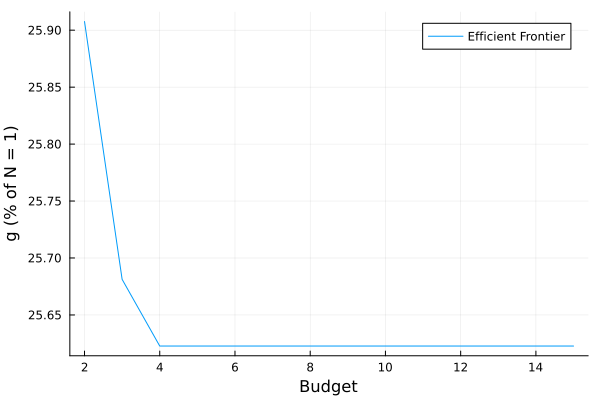

In [393]:
range = 2:NMax
xs = [i for i in range]
StatsPlots.plot(xs, 100 .* out[1][range]./out[1][1], xaxis = "Budget", yaxis = "g (% of N = 1)",label = "Efficient Frontier")
#StatsPlots.plot!(xs, 100 .* gDCPs[range]./out[1][1], label = "Best DCP g")

We can easily see that between 2 and 4 links is optimal. DCP curve suggests that links above 2 links are not always maintained.

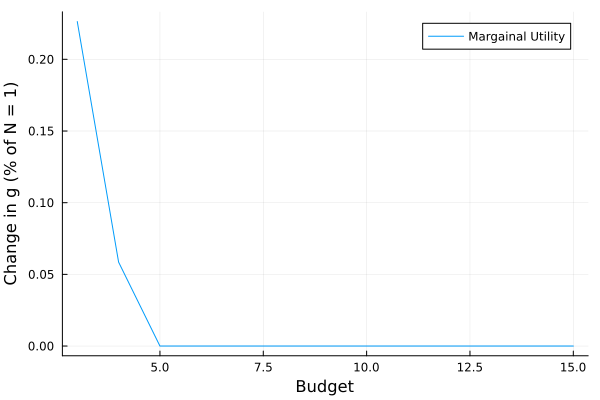

In [395]:
diffRange = 2:(NMax - 1)
xs = [i + 1 for i in diffRange]
StatsPlots.plot(xs, -100 .* (out[1][diffRange .+ 1] - out[1][diffRange])./out[1][1], label = "Marginal Utility", xaxis = "Budget", yaxis = "Change in g (% of N = 1)")

Here, we see that the improvement of having 2 links over 1 link is much better than having 3 links over 2

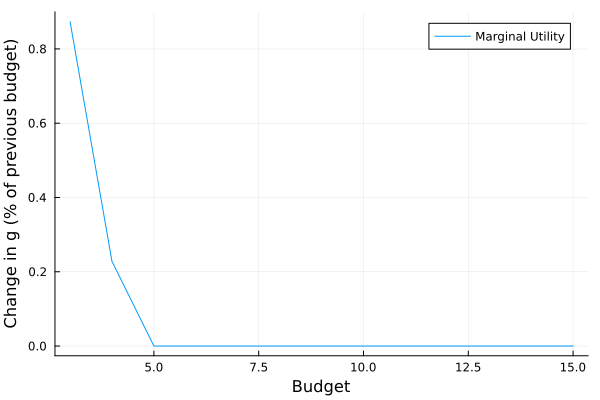

In [397]:
diffRange = 2:(NMax - 1)
xs = [i for i in diffRange .+ 1]
StatsPlots.plot(xs, -100 .*(out[1][diffRange .+ 1] - out[1][diffRange])./out[1][diffRange], label = "Marginal Utility", xaxis = "Budget", yaxis = "Change in g (% of previous budget)")

Test 2

In [210]:
NMax = 15
alpha_r = 0.1
beta = 1.0
tau = 1.0
c0 = 1.0
c1 = 1000.0
r = 100.0
epsilon = 1e-20

out = designProblemHomog(NMax, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1)

----------
1 Link Problem
3 iterations
g: 100.90909
----------
2 Link Problem
15 iterations
g: 27.43977
----------
3 Link Problem
344 iterations
g: 24.84062
----------
4 Link Problem
434 iterations
g: 24.00399
----------
5 Link Problem
173 iterations
g: 23.89031
----------
6 Link Problem
620 iterations
g: 23.88653
----------
7 Link Problem
448 iterations
g: 23.88653
----------
8 Link Problem
520 iterations
g: 23.88653
----------
9 Link Problem
593 iterations
g: 23.88653
----------
10 Link Problem
667 iterations
g: 23.88654
----------
11 Link Problem
742 iterations
g: 23.88654
----------
12 Link Problem
818 iterations
g: 23.88654
----------
13 Link Problem
899 iterations
g: 23.88654
----------
14 Link Problem
978 iterations
g: 23.88654
----------
15 Link Problem
1084 iterations
g: 23.88654


(Any[100.9090909090909, 27.43976638285461, 24.84062064096158, 24.00398979068133, 23.89031268621699, 23.886532211676844, 23.886532351340183, 23.886533580325427, 23.886534960812106, 23.886536417553287, 23.88653788487581, 23.88653931052266, 23.886539570779778, 23.88654049651259, 23.886536326525075], Any[[0.0 999.090909090909; 999.090909090909 0.0], [0.0 132.21557152094638 718.5220521328017; 132.19883191427303 718.5220521328017 0.0; 718.5220521328017 0.0 0.0], [0.0 95.26201587766278 204.05595067936423 629.109077132377; 79.46873546987192 198.67183867467998 629.109077132377 0.0; 198.67183867467998 629.109077132377 0.0 0.0; 629.109077132377 0.0 0.0 0.0], [0.0 91.70395436110135 … 285.45027428760164 629.4492768399314; 57.50997447670332 152.12842816184283 … 629.4492768399314 0.0; … ; 249.20988939904814 629.4492768399314 … 0.0 0.0; 629.4492768399314 0.0 … 0.0 0.0], [0.0 91.1158743395916 … 371.6793709372564 666.9013061467773; 45.78062537243398 137.46514973161052 … 666.9013061467773 0.0; … ; 293.72

In [172]:
N = 1
dsPolicy = fill(1, N)
gDCPs = [calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)]
alpha_d = 0.0
for N in 2:NMax
    dsPolicy = fill(1, N)
    gDCP = calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)
    if gDCP <= gDCPs[N - 1]
        push!(gDCPs, gDCP)
    else
        push!(gDCPs, gDCPs[N - 1])
    end
end

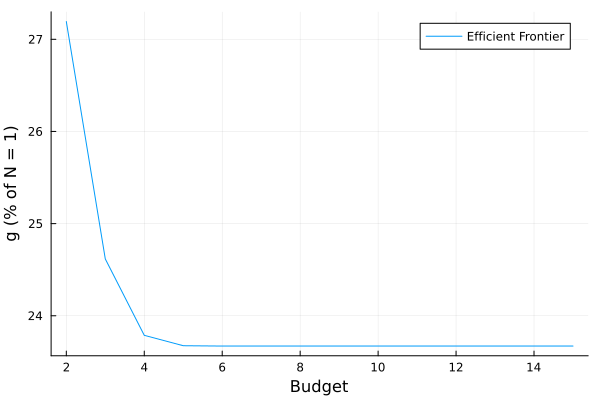

In [211]:
range = 2:NMax
xs = [i for i in range]
StatsPlots.plot(xs, 100 .* out[1][range]./out[1][1], xaxis = "Budget", yaxis = "g (% of N = 1)",label = "Efficient Frontier")

With a larger value of alpha, anywhere from 2 to 6 links could be reasonable. DCP suggests that links above 2 are not always maintained

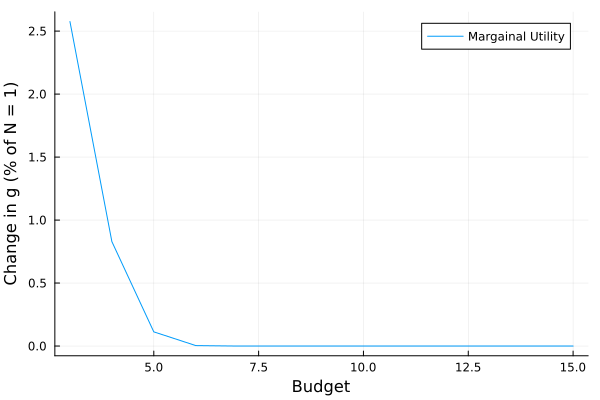

In [212]:
diffRange = 2:(NMax - 1)
xs = [i + 1 for i in diffRange]
StatsPlots.plot(xs, -100 .* (out[1][diffRange .+ 1] - out[1][diffRange])./out[1][1], label = "Margainal Utility", xaxis = "Budget", yaxis = "Change in g (% of N = 1)")

Improvements of each additional link relative to the N = 1 case

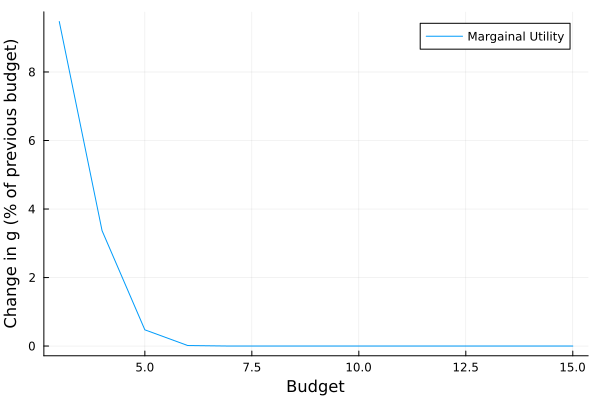

In [213]:
diffRange = 2:(NMax - 1)
xs = [i for i in diffRange .+ 1]
StatsPlots.plot(xs, -100 .*(out[1][diffRange .+ 1] - out[1][diffRange])./out[1][diffRange], label = "Margainal Utility", xaxis = "Budget", yaxis = "Change in g (% of previous budget)")

Improvements of each link relative to the previous link

Test 3

In [400]:
NMax = 15
alpha_r = 0.01
beta = 1.0
tau = 1.0
c0 = 1.0
c1 = 10000.0
r = 100.0
epsilon = 1e-10

out = designProblemHomog(NMax, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1)

----------
1 Link Problem
3 iterations
g: 100.9901
----------
2 Link Problem
44 iterations
g: 3.9604
----------
3 Link Problem
1494 iterations
g: 3.58559
----------
4 Link Problem
3154 iterations
g: 3.47772
----------
5 Link Problem
3924 iterations
g: 3.39093
----------
6 Link Problem
4312 iterations
g: 3.33835
----------
7 Link Problem
5649 iterations
g: 3.30538
----------
8 Link Problem
6488 iterations
g: 3.28472
----------
9 Link Problem
7737 iterations
g: 3.2723
----------
10 Link Problem
9087 iterations
g: 3.26567
----------
11 Link Problem
10279 iterations
g: 3.26328
----------
12 Link Problem
11297 iterations
g: 3.26328
----------
13 Link Problem
12321 iterations
g: 3.26328
----------
14 Link Problem
13350 iterations
g: 3.26328
----------
15 Link Problem
14384 iterations
g: 3.26328


(Any[100.99009900990099, 3.9603960396031894, 3.5855866515112313, 3.477724223947881, 3.390926300644042, 3.3383503096959575, 3.3053833344865873, 3.284720721376731, 3.272298202274953, 3.2656714644082516, 3.263280620142821, 3.2632806200375404, 3.2632806199354927, 3.263280619833643, 3.263280619733778], Any[[0.0 9999.009900990099; 9999.009900990099 0.0], [0.0 148.01980198021343 5246.039603960426; 148.01980198015949 5246.039603960426 0.0; 5246.039603960426 0.0 0.0], [0.0 99.59765694349352 215.46555430665728 3647.6036920894917; 86.18622171704105 215.46555430665728 3647.6036920894917 0.0; 215.46555430665728 3647.6036920894917 0.0 0.0; 3647.6036920894917 0.0 0.0 0.0], [0.0 99.02383469635014 … 305.6830994934374 2904.8136684374513; 61.94310559869702 161.43604173883546 … 2904.8136684374513 0.0; … ; 268.42012429083564 2904.8136684374513 … 0.0 0.0; 2904.8136684374513 0.0 … 0.0 0.0], [0.0 99.01033919374922 … 401.2378630311872 2500.5596777710593; 47.81852601288084 146.8399298487978 … 2500.5596777710593

In [175]:
N = 1
dsPolicy = fill(1, N)
gDCPs = [calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)]
alpha_d = 0.0
for N in 2:NMax
    dsPolicy = fill(1, N)
    gDCP = calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)
    if gDCP <= gDCPs[N - 1]
        push!(gDCPs, gDCP)
    else
        push!(gDCPs, gDCPs[N - 1])
    end
end

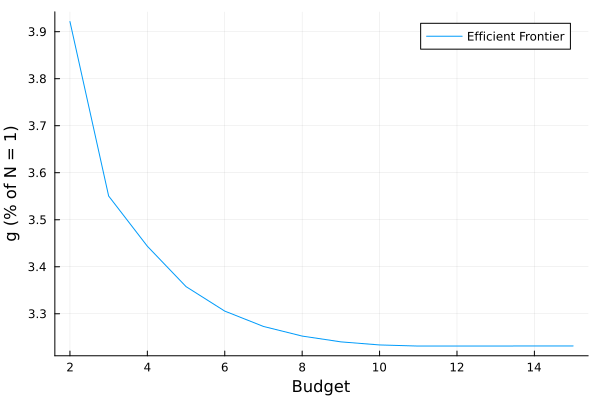

In [215]:
range = 2:NMax
xs = [i for i in range]
StatsPlots.plot(xs, 100 .* out[1][range]./out[1][1], xaxis = "Budget", yaxis = "g (% of N = 1)",label = "Efficient Frontier")

Upwards of 12 links could be reasonable!

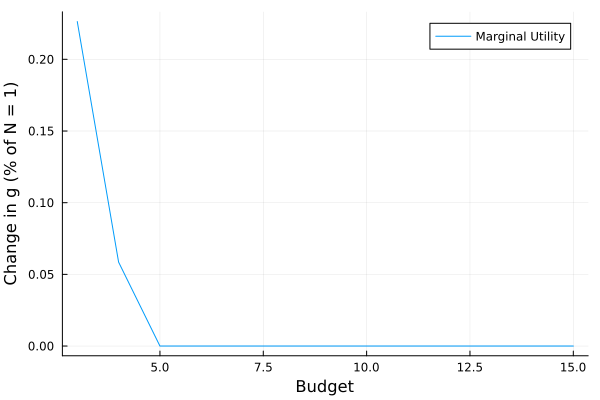

In [398]:
diffRange = 2:(NMax - 1)
xs = [i + 1 for i in diffRange]
StatsPlots.plot(xs, -100 .* (out[1][diffRange .+ 1] - out[1][diffRange])./out[1][1], label = "Marginal Utility", xaxis = "Budget", yaxis = "Change in g (% of N = 1)")

Percentage improvement of each extra link relative to N = 1. Each additional link past 2 gives less than a 0.4% improvement relative to N = 1 

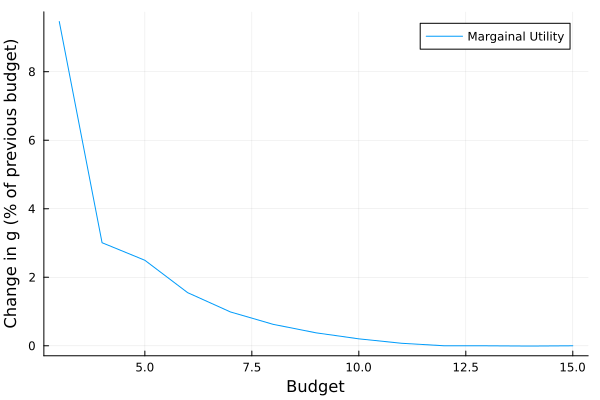

In [220]:
diffRange = 2:(NMax - 1)
xs = [i for i in diffRange .+ 1]
StatsPlots.plot(xs, -100 .*(out[1][diffRange .+ 1] - out[1][diffRange])./out[1][diffRange], label = "Margainal Utility", xaxis = "Budget", yaxis = "Change in g (% of previous budget)")

Percentage improvement of each extra link relative to the previous. From this perspective, the third link gives around an 8% improvement over 2, the 4th around 3% over 3, and down from there.

Test 4

----------
1 Link Problem
4 iterations
g: 919.09091
----------
2 Link Problem
55 iterations
g: 101.81818
----------
3 Link Problem
19 iterations
g: 35.84272
----------
4 Link Problem
309 iterations
g: 32.65918
----------
5 Link Problem
396 iterations
g: 32.00379
----------
6 Link Problem
445 iterations
g: 31.60007
----------
7 Link Problem
652 iterations
g: 31.34087
----------
8 Link Problem
780 iterations
g: 31.17153
----------
9 Link Problem
863 iterations
g: 31.0619
----------
10 Link Problem
1108 iterations
g: 30.98586
----------
11 Link Problem
1229 iterations
g: 30.89685
----------
12 Link Problem
1373 iterations
g: 30.86282
----------
13 Link Problem
1503 iterations
g: 30.86282
----------
14 Link Problem
1634 iterations
g: 30.86282
----------
15 Link Problem
1326 iterations
g: 30.86282


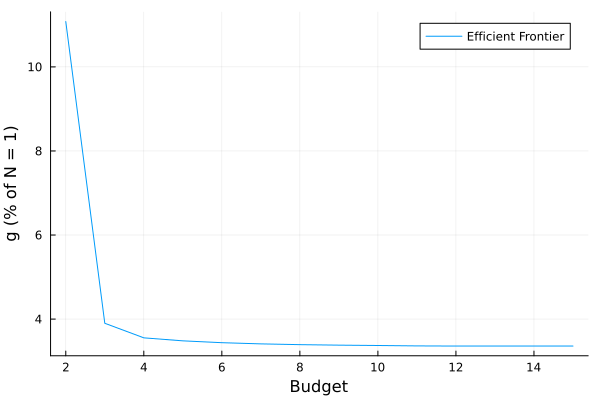

In [221]:
#Dynamic
NMax = 15
alpha_r = 0.1
beta = 1.0
tau = 1.0
c0 = 1.0
c1 = 10000.0
r = 100.0
epsilon = 1e-30

out = designProblemHomog(NMax, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = 0, delScale = 1)

#DCPs
N = 1
dsPolicy = fill(1, N)
gDCPs = [calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)]
alpha_d = 0.0
for N in 2:NMax
    dsPolicy = fill(1, N)
    gDCP = calculateG_DSP(N,fill(alpha_d, N), fill(alpha_r, N), beta, fill(tau, N), fill(c0, N), c1, fill(r, N), dsPolicy)
    if gDCP <= gDCPs[N - 1]
        push!(gDCPs, gDCP)
    else
        push!(gDCPs, gDCPs[N - 1])
    end
end

#Plot
range = 2:NMax
xs = [i for i in range]
StatsPlots.plot(xs, 100 .* out[1][range]./out[1][1], xaxis = "Budget", yaxis = "g (% of N = 1)",label = "Efficient Frontier")

In [227]:
gDCPs

15-element Vector{Float64}:
 919.0909090909091
 101.81818181818181
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145
  35.785123966942145

3 links gets us down to just under 4% of the N = 1 cost. DCP suggests that if 3 links are installed, they are always repaired.

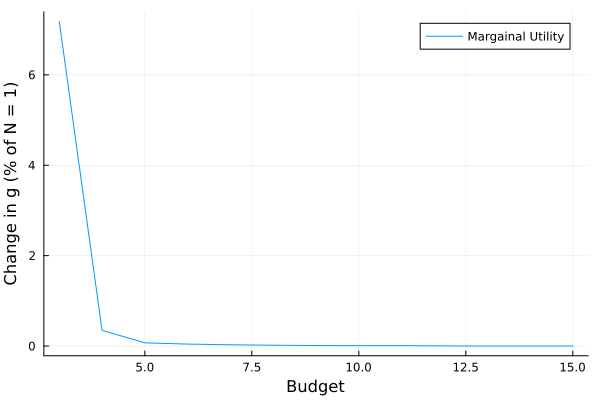

In [222]:
diffRange = 2:(NMax - 1)
xs = [i + 1 for i in diffRange]
StatsPlots.plot(xs, -100 .* (out[1][diffRange .+ 1] - out[1][diffRange])./out[1][1], label = "Margainal Utility", xaxis = "Budget", yaxis = "Change in g (% of N = 1)")

3rd link gives an extra ~6% improvement. Significantly diminishing returns after.

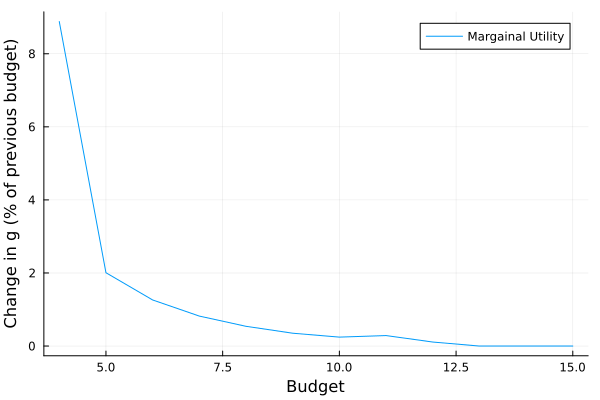

In [226]:
diffRange = 3:(NMax - 1)
xs = [i for i in diffRange .+ 1]
StatsPlots.plot(xs, -100 .*(out[1][diffRange .+ 1] - out[1][diffRange])./out[1][diffRange], label = "Margainal Utility", xaxis = "Budget", yaxis = "Change in g (% of previous budget)")

4th link gives over an 8% improvement over 3. 5th link gives 2% over 4. Down from there.

# Experiments on TLMC Problems

In [415]:
N = [4,1]
alpha = [0.01, 0.001]
beta = 10
tau = [1.0, 1.0]
c = [1.0, 1.0]
p = 1000.0
r = [100.0, 100.0]
epsilon = 1e-10

res = rviaTLMC(N, alpha, beta, tau, c, p, r, epsilon; delScale = 1, maxIter = 50000, printIter = true)

1000
2000
3000
4000
5000


(11.395550073805168, Dict{Any, Any}([3, 1, 0, 0] => 241.15267138842205, [3, 0, 0, 1] => 275.94953244475136, [2, 1, 0, 0] => 173.73637061053319, [3, 0, 1, 0] => 303.2267096302175, [1, 3, 0, 0] => 330.0608821460502, [0, 1, 0, 0] => 99.00995402875397, [2, 0, 0, 1] => 175.30760148627922, [2, 2, 0, 1] => 3334.483683292374, [2, 0, 1, 0] => 195.26738893816383, [0, 0, 0, 1] => 99.90092408906872…), Dict{Any, Any}([3, 1, 0, 0] => [0, 0], [3, 0, 0, 1] => [0, 0], [2, 1, 0, 0] => [0, 0], [3, 0, 1, 0] => [0, 1], [1, 3, 0, 0] => [0, 0], [0, 1, 0, 0] => [0, 0], [2, 0, 0, 1] => [0, 0], [2, 2, 0, 1] => [2, 0], [2, 0, 1, 0] => [0, 1], [0, 0, 0, 1] => [0, 0]…), 5936, 9.99875737761613e-11, Any[2080.9363221583017, 1981.7496528466572, 293.84085216558515, 70.00544663531262, 52.61645411964353, 41.13963956916926, 32.70932112918092, 26.121192169821764, 20.884846264415668, 16.704034333390233  …  1.0453504728502594e-10, 1.0271605788148008e-10, 1.0274447959091049e-10, 1.0271605788148008e-10, 1.0271605788148008e-10,

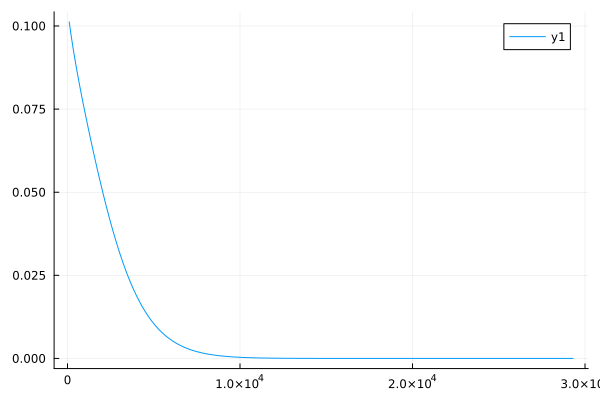

In [349]:
maxRange = resRpe[4]
range = 100:maxRange
xs = [r for r in range]
#StatsPlots.plot(xs, log.(res[6][range])./log(10))
StatsPlots.plot(xs, (resRpe[6][range]))

In [336]:
for (k,v) in res[3]
    if v != [0,0]
        println((k,v))
    end
end

([3, 1, 0, 0], [2, 0])
([3, 0, 0, 1], [2, 0])
([3, 0, 1, 0], [2, 1])
([2, 2, 0, 1], [2, 0])
([2, 0, 1, 0], [0, 1])
([2, 2, 1, 0], [2, 1])
([4, 0, 0, 1], [4, 0])
([4, 0, 1, 0], [4, 1])
([3, 1, 0, 1], [3, 0])
([3, 1, 1, 0], [3, 1])
([2, 1, 0, 1], [1, 0])
([2, 1, 1, 0], [1, 1])
([1, 3, 0, 1], [1, 0])
([1, 3, 1, 0], [1, 1])
([1, 2, 1, 0], [0, 1])
([3, 0, 0, 0], [1, 0])
([0, 4, 1, 0], [0, 1])
([2, 2, 0, 0], [1, 0])
([4, 0, 0, 0], [3, 0])


In [424]:
budget = 1
cInst = [1,2]
resDPTLMC = designProblemTLMC(budget, cInst, alpha, beta, tau, c, p, r, epsilon; delScale = 1, maxIter = Inf, printInfo = true)

-----------
N: [0, 0]
g: 10000.0
Iterations: 

LoadError: UndefVarError: `res` not defined

In [453]:
alpha = [0.01, 0.001]
beta = 10
tau = [1.0, 1.0]
c = [1.0, 1.0]
p = 1000.0
r = [100.0, 100.0]
epsilon = 1e-10

gs = []
sols = []
cInst = [1,2]
for b in 1:10
    println(b)
    res = designProblemTLMC(b, cInst, alpha, beta, tau, c, p, r, epsilon; delScale = 1, maxIter = Inf, printInfo = false)
    push!(gs, res[1])
    push!(sols, res[2])
end

1
2
3
4
5
6
7
8
9
10


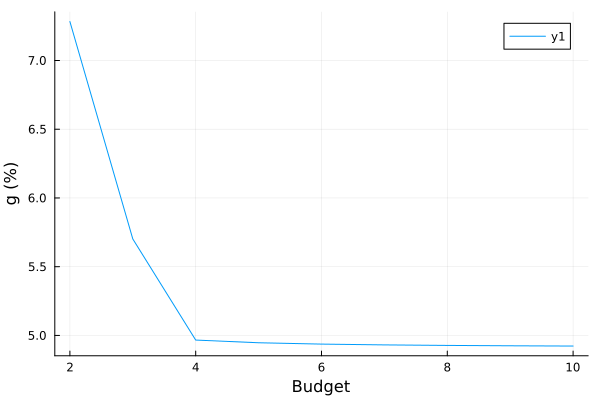

In [454]:
range = 2:10
xs = [b for b in range]
StatsPlots.plot(xs, 100 .* gs[range]./gs[1], xaxis = "Budget", yaxis = "g (%)")

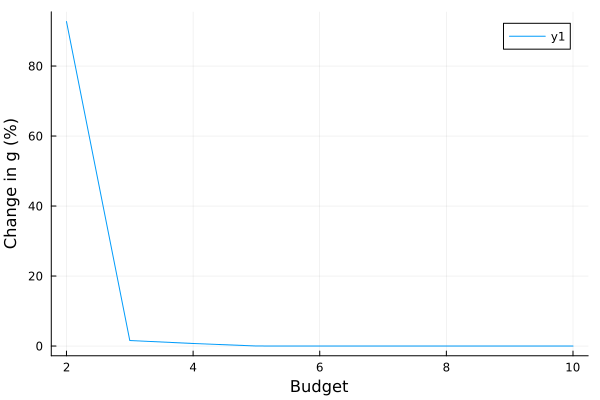

In [450]:
range = 2:10
xs = [b for b in range]
StatsPlots.plot(xs, -100 .* (gs[range] - gs[range .- 1])./gs[1], xaxis = "Budget", yaxis = "Change in g (%)")

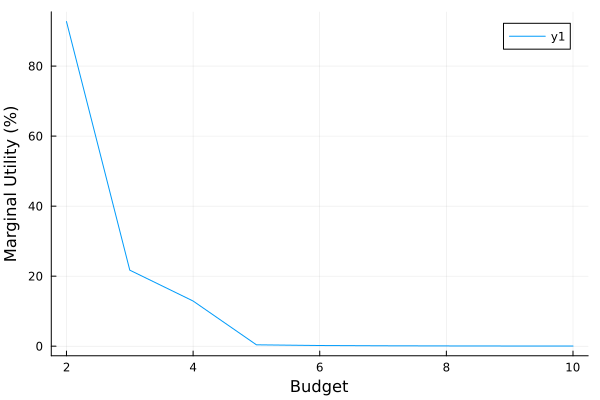

In [457]:
range = 2:10
xs = [b for b in range]
StatsPlots.plot(xs, -100 .* (gs[range] - gs[range .- 1])./gs[range .- 1], xaxis = "Budget", yaxis = "Marginal Utility (%)")

In [440]:
xs

9-element Vector{Int64}:
  2
  3
  4
  5
  6
  7
  8
  9
 10

In [455]:
sols

10-element Vector{Any}:
 [1, 0]
 [2, 0]
 [1, 1]
 [0, 2]
 [1, 2]
 [2, 2]
 [3, 2]
 [4, 2]
 [5, 2]
 [6, 2]

# Experiments for Unconstrained DCP Problems

In [165]:
#Generate Problems
Random.seed!(12345)
N = 20
beta = 1.0
alpha_d = fill(0.0, N)
taus = []
alphas = []
cs = []
rs = []
TAU_MAX = 1.0
C0_MAX = 1.0
C1_MAX = 1000.0
R_MAX = 100.0
numRuns = 50

for i in 1:numRuns
    tau = rand(N).*TAU_MAX 
    push!(taus, tau)
    alpha = [sampleTruncExp(minimum(tau)/2, minimum(tau)) for i in 1:N]
    push!(alphas, alpha)
    c = rand(N).*C0_MAX
    c = sort(c)
    push!(cs, c)
    r = rand(N).*R_MAX
    push!(rs, r)
end

In [158]:
ps = [10.0^i for i in 0:2:38]
optDcps = []
optDcpGs = []
heurDcps = []
heurDcpGs = []
FRAME_LEN = 40
dcpUnconstrainedExp = Dict()
dcpUnconstrainedExp["optDcps"] = optDcps
dcpUnconstrainedExp["optDcpGs"] = optDcpGs
dcpUnconstrainedExp["heurDcpGs"] = heurDcpGs
dcpUnconstrainedExp["heurDcps"] = heurDcps

f = serialize("dcpUnconstrainedExp.dat", dcpUnconstrainedExp)

for i in 1:numRuns
    println("----------------------------------------------------")
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    print("tau: ")
    println(tau)

    print("alpha: ")
    println(alpha)

    print("c: ")
    println(c)

    print("r: ")
    println(r)


    optDcpsNew = []
    optDcpGsNew = []
    heurDcpGsNew = []
    heurDcpsNew = []

    for p in ps
        print("p: ")
        println(p)

        bruteRes = bruteForceDCP(N, alpha_d, alpha, beta, tau, c, p, r)
        heurRes = jointHeuristic(N, alpha_d, alpha, beta, tau, c, p, r)

        println(bruteRes)
        println(heurRes)

        push!(optDcpGsNew, bruteRes[2])
        push!(optDcpsNew, bruteRes[1])

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end

    push!(optDcpGs, optDcpGsNew)
    push!(optDcps, optDcpsNew)

    push!(heurDcpGs, heurDcpGsNew)
    push!(heurDcps, heurDcpsNew)

    dcpUnconstrainedExp["optDcps"] = optDcps
    dcpUnconstrainedExp["optDcpGs"] = optDcpGs
    dcpUnconstrainedExp["heurDcpGs"] = heurDcpGs
    dcpUnconstrainedExp["heurDcps"] = heurDcps

    f = serialize("dcpUnconstrainedExp.dat", dcpUnconstrainedExp)
    println("----------------------------------------------------")
end



----------------------------------------------------
tau: 

[0.7918054038647908, 0.1595789996994108, 0.33419142747606, 0.8113922657011057, 0.7966292033537833, 0.9178138221831842, 0.31132682723725014, 0.7529056805990061, 0.19990730668728796, 0.5411071027988436, 0.8462977195417882, 0.1651740535548888, 0.9029629954884405, 0.2793803248565804, 0.7807696928842626, 0.32692136718889286, 0.6338479453532103, 0.8999510969166794, 0.47502901483951, 0.031060918612698662]
alpha: [0.015579695934342204, 0.0003380887670059596, 0.007455266795004079, 0.011335553650339517, 0.006905922330418497, 0.004832081346475746, 0.0016896537864099224, 0.014317689393306538, 0.0025302242766136805, 0.021795796861157388, 0.001416102257149622, 0.013983281869789945, 0.030464201293461092, 0.004025736381524657, 0.021149394185572507, 0.011906649349979483, 0.0027820765665818176, 0.002660095152813167, 0.00613218756543087, 0.012559378861995332]
c: [0.00970527453228287, 0.013146100895414126, 0.03409594928904802, 0.07867325397244984, 0.12704348213092465, 0.2504800005295461, 0.485725271962423

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2131610160629794)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2131610160629794, 2)


p: 100.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2862597712337084)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2862597712337084, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.321223392941765)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.321223392941765, 2)
p: 1.0e6
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.4427779080543513)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.4427779080543513, 2)
p: 1.0e8
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 0.5937418904661617)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 0.5937418904661617, 3)
p: 1.0e10
(

[0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 0.7645761670798024)
([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 0.7645761670798024, 4)
p: 1.0e12
(

[0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.0076428053459094)
([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.0076428053459094, 4)
p: 1.0e14
(

[0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.354859565375966)
([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.354859565375966, 7)
p: 1.0e16
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.6804692872810734)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.6804692872810734, 6)
p: 1.0e18
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 2.1632650400124183)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 2.1632650400124183, 9)
p: 1.0e20
(

[0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 2.858334951733531)
([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 2.858334951733531, 10)
p: 1.0e22
(

[0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 3.5408458018239948)
([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 3.5408458018239948, 13)
p: 1.0e24
(

[0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], 4.371378637827757)
([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], 4.371378637827757, 12)
p: 1.0e26
(

[0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 5.205723334465046)
([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 5.205723334465046, 12)
p: 1.0e28
(

[0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 7.0525708500697695)
([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 7.0525708500697695, 13)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 8.953963638771167)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 8.953963638771167, 14)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 11.063736767758028)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 11.063736767758028, 17)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 14.0091542574563)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 14.0091542574563, 16)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 18.262665380275507)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 18.262665380275507, 18)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36.88775285997971)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36.88775285997971, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.5563555427068574, 0.0911852256043274, 0.4361533332528097, 0.19419113364114238, 0.35047293013467407, 0.8008914915954327, 0.08717654531082253, 0.663498979465801, 0.30536713023527606, 0.26432054450027487, 0.3600117557368794, 0.8844606525994927, 0.5264970975288532, 0.3821991159766418, 0.8393367773244623, 0.6875798544327945, 0.6438278988273823, 0.30707213452019777, 0.606623172832839, 0.22682668576626408]
alpha: [0.013065960614329469, 0.0610482289437988, 0.06203180574851761, 0.00013029519841078102, 0.06311944649832055, 0.023443596580036197, 0.02224489443932495, 0.002065100446521828, 0.0028143011003293954, 0.067620575182818, 0.02539164203310605, 0.013219977021771565, 0.011343935479753027, 0.017300652991871744, 0.0062

([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1631086465674526)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1631086465674526, 2)
p: 100.0
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22948951212458024)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22948951212458024, 2)
p: 10000.0
(

[0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3213292604713524)
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3213292604713524, 2)
p: 1.0e6
(

[0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6719857584921817)
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6719857584921817, 2)
p: 1.0e8
(

[0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], 1.0368041474756489)
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], 1.0368041474756489, 3)
p: 1.0e10
(

[0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], 1.6555424780246146)
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], 1.6555424780246146, 6)
p: 1.0e12
(

[0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], 2.4731005959890617)
([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], 2.4731005959890617, 7)
p: 1.0e14
(

[0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0], 3.8980056449145484)
([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0], 3.8980056449145484, 6)
p: 1.0e16
(

[0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0], 5.692625258687367)
([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0], 5.692625258687367, 9)
p: 1.0e18
(

[1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], 7.798853642921388)
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], 7.798853642921388, 9)
p: 1.0e20
(

[1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], 10.368194937536252)
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], 10.368194937536252, 10)
p: 1.0e22
(

[1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], 13.524979041361327)
([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], 13.524979041361327, 11)
p: 1.0e24
(

[1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0], 22.009606372500766)
([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0], 22.009606372500766, 12)
p: 1.0e26
(

[1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 38.20166475527494)
([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 38.20166475527494, 15)
p: 1.0e28
(

[1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 64.68684713209493)
([1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 64.68684713209493, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 128.07326611065946)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 128.07326611065946, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3727.193148766988)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3727.193148766988, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 363639.1814143999)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 363639.1814143999, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.635483800797769e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.635483800797769e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.635474720664306e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.635474720664306e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.11630531462020532, 0.8137385751108941, 0.389265718820641, 0.2902799248729121, 0.33699073821916414, 0.24693455101206618, 0.3646739853195585, 0.05488713024444425, 0.38996586645489417, 0.19625846060926067, 0.5978762938362605, 0.524074090073091, 0.9693703316844615, 0.7252967671367907, 0.20292420269648836, 0.5880373753967753, 0.05989283694137626, 0.3050206643822412, 0.13402864443546647, 0.3319133742772675]
alpha: [0.0016941795430034773, 0.02016074521033701, 0.011450054683642706, 0.012531852947407105, 0.008973717590708936, 0.011586543651509264, 0.006547952131026437, 0.008750871742585929, 0.05319100149098549, 0.01678858060284074, 0.023270868328878452, 0.02353524002480114, 0.04582144378737981, 0.014411653677346413

([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6024607474866174)
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6024607474866174, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], 0.7278253218966193)
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], 0.7278253218966193, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], 0.8263096729287768)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], 0.8263096729287768, 2)
p: 1.0e6
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 1.1242046127934802)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 1.1242046127934802, 3)
p: 1.0e8
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 1.8187380318892938)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 1.8187380318892938, 6)
p: 1.0e10
(

[0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 2.9548365126728653)
([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 2.9548365126728653, 9)
p: 1.0e12
(

[1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 4.306890698288636)
([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 4.306890698288636, 8)
p: 1.0e14
(

[1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 5.91074692224044)
([1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 5.91074692224044, 9)
p: 1.0e16
(

[1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0], 8.236789008566216)
([1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0], 8.236789008566216, 8)
p: 1.0e18
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0], 11.397955503838979)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0], 11.397955503838979, 10)
p: 1.0e20
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], 14.597589412014402)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], 14.597589412014402, 11)
p: 1.0e22
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], 19.71419822660978)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], 19.71419822660978, 14)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], 24.329943453816238)
([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], 24.329943453816238, 14)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], 33.39936506855812)
([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], 33.39936506855812, 15)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], 52.989901127686586)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], 52.989901127686586, 17)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 112.96954338857802)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 112.96954338857802, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3438.1567854439277)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3438.1567854439277, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 335956.88099097897)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 335956.88099097897, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.358782930154448e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.358782930154448e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.3587750713568945e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.3587750713568945e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.5878470583786521, 0.661917389215475, 0.22469244667223298, 0.6233503701140761, 0.12956685467358142, 0.4082053515523629, 0.7695236812574098, 0.8450222315948539, 0.8770603812237295, 0.7267335848789629, 0.45359767556241815, 0.463986169377388, 0.33872368332981595, 0.1079563065545629, 0.5306825308105877, 0.2631289721587715, 0.9677017791038149, 0.5082378074686141, 0.3632041849764117, 0.3551296900094527]
alpha: [0.08660174170877577, 0.10204143934148778, 0.041660472274839475, 0.018549254946452803, 0.03986812225761016, 0.03742899021181568, 0.019815705605776193, 0.06813037311404149, 0.06634831585235716, 0.0269587113148465, 0.07224905350028124, 0.05107460616079139, 0.04591638620788536, 0.0014685654229957637, 0.01911

([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.9791717952733148)
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.9791717952733148, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 1.2184884815897246)
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 1.2184884815897246, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 1.5784235458896319)
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 1.5784235458896319, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 2.6310988279733043)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 2.6310988279733043, 2)
p: 1.0e8
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], 5.107461271201869)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], 5.107461271201869, 3)
p: 1.0e10
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], 8.163374357215725)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], 8.163374357215725, 5)
p: 1.0e12
(

[0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], 11.394036594820161)
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], 11.394036594820161, 6)
p: 1.0e14
(

[1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1], 15.613037122288599)
([0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], 15.79703928773942, 7)
p: 1.0e16
(

[0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], 19.67291845576883)
([0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], 19.67291845576883, 9)
p: 1.0e18
(

[1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 24.805874746061598)
([1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 24.805874746061598, 15)
p: 1.0e20
(

[1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 30.962916953672725)
([1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 30.962916953672725, 17)
p: 1.0e22
(

[1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 40.703136997688375)
([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 40.703136997688375, 15)
p: 1.0e24
(

[1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 57.01834117162787)
([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 57.01834117162787, 17)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 82.48584869427586)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 82.48584869427586, 19)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 566.6579404539228)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 566.6579404539228, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 48983.86711641863)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 48983.86711641863, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.890704784712889e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.890704784712889e6, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.8906279654436e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.8906279654436e8, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.890627197250906e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.890627197250906e10, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.8906271895689795e12)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.8906271895689795e12, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.04065107672638435, 0.5218825940340526, 0.9058169822604593, 0.2708771092441531, 0.6651211905306693, 0.5774799094995329, 0.844705288802868, 0.41358279138252163, 0.30914189808918857, 0.37273392679336903, 0.7430063505109048, 0.4047326401413751, 0.14164549459974063, 0.4847807700668946, 0.35887444065632257, 0.2641452328593098, 0.22324872339048318, 0.02976382630854235, 0.1111681335402891, 0.18962109226559032]
alpha: [0.005847208964160541, 0.01098276438651898, 0.012929096535508017, 0.014708700075279578, 3.989291564941722e-5, 0.012718395849063917, 0.00125599905598843, 0.0284796694659367, 0.01759381999376311, 0.013497616822363522, 0.0074339595367936455, 0.007408697428393554, 0.028406397841183567, 0.0010338280018

([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.18550417165371605)
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.18550417165371605, 2)
p: 100.0
(

[0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.18562654823607)
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.18562654823607, 2)
p: 10000.0
(

[0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.19786420647146685)
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.19786420647146685, 2)
p: 1.0e6
(

[0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3255214472086952)
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3255214472086952, 2)
p: 1.0e8
(

[0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.49707277370855435)
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.49707277370855435, 3)
p: 1.0e10
(

[0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5357374941242652)
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5357374941242652, 3)
p: 1.0e12
(

[0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 0.8462444177244453)
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 0.8462444177244453, 4)
p: 1.0e14
(

[0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.157783195753678)
([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.157783195753678, 7)
p: 1.0e16
(

[0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], 1.6313080137948788)
([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], 1.6313080137948788, 8)
p: 1.0e18
(

[0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], 2.3206110474249018)
([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], 2.3206110474249018, 9)
p: 1.0e20
(

[0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], 3.506149355420603)
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], 3.506149355420603, 10)
p: 1.0e22
(

[0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], 4.814579164452922)
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], 4.814579164452922, 11)
p: 1.0e24
(

[0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], 6.4524996909080246)
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], 6.4524996909080246, 10)
p: 1.0e26
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 9.133581354057652)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 9.133581354057652, 14)
p: 1.0e28
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 12.315902056302583)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 12.315902056302583, 13)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 17.046769505512227)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 17.046769505512227, 15)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 22.311839395906578)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 22.311839395906578, 16)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 36.09932588255813)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 36.09932588255813, 18)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 148.54889550864996)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 148.54889550864996, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 10389.426850922475)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 10389.426850922475, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.7984567541403947, 0.17606828698836108, 0.923927753088034, 0.7340082148697975, 0.13072103473014685, 0.779278645157629, 0.9534331117526668, 0.5319566193135808, 0.5733913314962393, 0.5175957154540686, 0.8695174527163584, 0.7379209699974116, 0.09196062494931412, 0.36295628003237723, 0.8725686818944461, 0.3201307261467512, 0.21567009184878982, 0.5899280786790819, 0.4473096519952734, 0.4562996404551398]
alpha: [0.025029229984776847, 0.025814031462173655, 0.035215577130825765, 0.05647694500984755, 0.08335761873687084, 0.0049904409734281485, 0.04005050974333151, 0.011753728377828041, 0.04024536367016599, 0.07326025440815667, 0.03118175207374524, 0.0035756611849336838, 0.03170293218880623, 0.025272860259813238, 0.043

([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6100816308408211)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6100816308408211, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 1.0879038360473203)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 1.0879038360473203, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 1.3916817524798688)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 1.3916817524798688, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 2.603374668537269)
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 2.7618561032496487, 2)
p: 1.0e8
(

[0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 3.7286550687737776)
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 3.7286550687737776, 6)
p: 1.0e10
(

[0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 5.202174817192797)
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 5.202174817192797, 5)
p: 1.0e12
(

[0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], 7.373552440394973)
([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 7.491207349603617, 6)
p: 1.0e14
(

[0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1], 9.20509590220063)
([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1], 9.20509590220063, 12)
p: 1.0e16
(

[1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 11.76917758537241)
([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 11.76917758537241, 12)
p: 1.0e18
(

[1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 15.160870347027718)
([1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 15.160870347027718, 13)
p: 1.0e20
(

[1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 21.381552902518248)
([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 21.381552902518248, 14)
p: 1.0e22
(

[1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 29.35522629419194)
([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 29.35522629419194, 16)
p: 1.0e24
(

[1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 43.574453336426565)
([1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 43.574453336426565, 15)
p: 1.0e26
(

[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 67.6694383105999)
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 67.6694383105999, 18)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 319.6020487991616)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 319.6020487991616, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 23819.161266338248)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 23819.161266338248, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.3737750830202466e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.3737750830202466e6, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.373693672584111e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.373693672584111e8, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.3736928584797497e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.3736928584797497e10, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.373692850338706e12)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.373692850338706e12, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.6629607330298358, 0.10704881638607755, 0.7098274335724652, 0.943187993127068, 0.689326208553264, 0.25399376983118993, 0.45432135441458243, 0.945556597231368, 0.5594321736895935, 0.024702426546413414, 0.46858270097702137, 0.7540051048450971, 0.6045725635018867, 0.8488236554092745, 0.7547473179779387, 0.30547621484719434, 0.38857903356850576, 0.5009075948421147, 0.9923195443744153, 0.6557403590909577]
alpha: [0.01253852722722994, 0.002633527752888207, 0.014919100013211737, 0.010405702717608729, 0.0016483813588269902, 0.023304202838766747, 0.014464871063653701, 0.0073562572258924885, 0.0030047669428673427, 0.0016180239843621212, 0.01071136527363407, 0.006391317694015813, 0.019458549678920543, 0.002553537226

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2955181294290832)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2955181294290832, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3330811280788098)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3330811280788098, 2)
p: 10000.0
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.4053269482719045)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.4053269482719045, 2)
p: 1.0e6
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], 0.5110545055907998)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.5769483395108007, 2)
p: 1.0e8
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.6448015069395137)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.6448015069395137, 5)
p: 1.0e10
(

[0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.8260000855517309)
([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.8260000855517309, 6)
p: 1.0e12
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], 0.9890094676743167)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], 0.9890094676743167, 7)
p: 1.0e14
(

[0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], 1.1710918275952564)
([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], 1.1710918275952564, 8)
p: 1.0e16
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], 1.3671324941783212)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], 1.3671324941783212, 9)
p: 1.0e18
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], 1.5822833708136719)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], 1.5822833708136719, 10)
p: 1.0e20
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], 1.833315460198797)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], 1.833315460198797, 11)
p: 1.0e22
(

[0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1], 2.1379842116324803)
([0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1], 2.1379842116324803, 12)
p: 1.0e24
(

[0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 2.473776276205041)
([0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 2.473776276205041, 15)
p: 1.0e26
(

[0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 2.835033585340349)
([0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 2.835033585340349, 16)
p: 1.0e28
(

[1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 3.565673424461828)
([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 3.565673424461828, 17)
p: 1.0e30
(

[1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], 4.408831027412647)
([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], 4.408831027412647, 16)
p: 1.0e32
(

[1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 5.777428075943489)
([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 5.777428075943489, 17)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.6587899426982595)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.6587899426982595, 17)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 10.391065894969726)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 10.391065894969726, 18)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 17.07436828223692)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 17.07436828223692, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.9844331989453724, 0.3344616821035322, 0.9634768914588812, 0.7591708822027786, 0.6127348113496074, 0.3331913980089657, 0.9594871714269945, 0.6030541376713816, 0.7246248297182348, 0.04648675553251058, 0.6322503108638302, 0.31569441612869664, 0.47214666280049067, 0.5328653884240233, 0.46780617819926273, 0.5977231759181234, 0.5245087897088798, 0.9041137374729123, 0.04447681410901616, 0.7612555269203104]
alpha: [0.03309902189604748, 0.009450831815858105, 0.021711423176969627, 0.003091174003033152, 0.02635973676494109, 0.02227346993020938, 0.00377910748536673, 0.004937975666692474, 0.008028051793352671, 0.008627807760282229, 0.01030773635782402, 0.0005265497311691387, 0.03085273582321994, 0.012107579942268087, 0.032

([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.32660351786150166)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.32660351786150166, 2)
p: 100.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3993206215222327)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3993206215222327, 2)
p: 10000.0
(

[0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5002899980934599)
([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5002899980934599, 2)
p: 1.0e6
(

[0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.6845860176911618)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.7043978499023273, 2)
p: 1.0e8
(

[0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.812893796961518)
([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.812893796961518, 3)
p: 1.0e10
(

[0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 1.0427439601716808)
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 1.0427439601716808, 4)
p: 1.0e12
(

[0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 1.2741782924546023)
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 1.2741782924546023, 7)
p: 1.0e14
(

[0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 1.7424208348870414)
([0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 1.7424208348870414, 8)
p: 1.0e16
(

[1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 2.4718046977909007)
([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 2.4718046977909007, 9)
p: 1.0e18
(

[1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 3.3877869770513)
([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 3.3877869770513, 10)
p: 1.0e20
(

[1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], 4.316987670663225)
([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 4.459976115252097, 11)
p: 1.0e22
(

[1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], 5.356305302279283)
([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], 5.356305302279283, 13)
p: 1.0e24
(

[1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], 6.688221577210804)
([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], 6.688221577210804, 12)
p: 1.0e26
(

[1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1], 8.738137716070652)
([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1], 8.738137716070652, 15)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], 11.360238428216357)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], 11.360238428216357, 17)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], 14.384279932532536)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], 14.384279932532536, 18)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 19.687919668799356)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 19.687919668799356, 17)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36.3398612618732)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36.3398612618732, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 300.4123536889494)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 300.4123536889494, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26707.66159639657)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26707.66159639657, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.08324550272770315, 0.6367868633946647, 0.5444529898923867, 0.2688646789193061, 0.10001213177132218, 0.3580125986844297, 0.08816092201886183, 0.3567918197924379, 0.25981349750296356, 0.5152422784409797, 0.20383591560205727, 0.118997742725654, 0.6769302454227529, 0.5106532061248321, 0.7352763268889968, 0.92644957742896, 0.9341812950747908, 0.09160492808216791, 0.9432571237218061, 0.2904545219840853]
alpha: [0.04814917462701287, 0.04524531030442965, 0.0024497477154098854, 0.013455482250035788, 0.011023719213587498, 0.028215430658585398, 0.05572681273834021, 0.001522093560539897, 0.0007564585348399812, 0.06280227961934301, 0.006017265951976707, 0.05679266948613324, 0.0018640116303388526, 0.03407983717585408, 0.033

([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.35918407071352865)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.35918407071352865, 2)
p: 100.0
(

[0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.44068200600316754)
([0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.44068200600316754, 2)
p: 10000.0
(

[0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.6769146152355934)
([0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.6769146152355934, 2)
p: 1.0e6
(

[0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 0.9054830410458901)
([0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 0.9054830410458901, 5)
p: 1.0e8
(

[0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.1254905182111141)
([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.243685191599798, 3)
p: 1.0e10
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.4424512574670267)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.4424512574670267, 4)
p: 1.0e12
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.8699394903540338)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.8699394903540338, 8)
p: 1.0e14
(

[0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], 2.7314399584904816)
([0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], 2.7314399584904816, 9)
p: 1.0e16
(

[0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1], 3.818061006850217)
([0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1], 3.818061006850217, 10)
p: 1.0e18
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], 5.67449529307965)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], 5.67449529307965, 12)
p: 1.0e20
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 8.12226925954629)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 8.12226925954629, 13)
p: 1.0e22
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], 15.994464993834235)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], 15.994464993834235, 12)
p: 1.0e24
(

[1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 23.945712731994455)
([1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 23.945712731994455, 14)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 34.836817815852726)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 34.836817815852726, 16)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 65.35289278695318)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 65.35289278695318, 18)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 666.5887591424091)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 666.5887591424091, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 58767.27863546062)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 58767.27863546062, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.868836266267282e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.868836266267282e6, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.868757350294493e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.868757350294493e8, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.868756561134766e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.868756561134766e10, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.353019792506318, 0.20192511613058595, 0.04282530343497026, 0.031199959878229544, 0.4525887082169766, 0.06854665073717459, 0.9338863346503187, 0.5261322812630987, 0.3009391141260067, 0.17014712387288244, 0.4743240725430049, 0.5276772467157742, 0.9863713442551088, 0.12516930839132112, 0.8797640982622694, 0.7780897473286261, 0.3934660437212143, 0.10004071633096556, 0.0891518971717491, 0.426090141800052]
alpha: [0.009944757555697742, 0.0007025947454814775, 0.028091733880393748, 0.0006714925667636217, 0.026414712034098124, 0.011878626414667037, 0.02562152052040368, 0.019303402275788677, 0.014602800265314811, 0.002656023919277451, 0.01075749125270612, 0.005271059586524195, 0.008280629031161096, 0.0011683276674

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2388993989780249)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2388993989780249, 2)
p: 100.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.2747752997972633)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.2747752997972633, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.3326477848535831)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.3326477848535831, 2)
p: 1.0e6
(

[0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.416343553133994)
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.416343553133994, 3)
p: 1.0e8
(

[0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], 0.7346021012367284)
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], 0.7346021012367284, 6)
p: 1.0e10
(

[0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], 1.1469115442731095)
([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], 1.1469115442731095, 7)
p: 1.0e12
(

[0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], 1.6919290446063635)
([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], 1.6919290446063635, 8)
p: 1.0e14
(

[0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], 2.3745440268372073)
([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 2.4065915018367474, 9)
p: 1.0e16
(

[0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 3.089526762328667)
([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 3.089526762328667, 13)
p: 1.0e18
(

[0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 3.8650282651763765)
([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 3.8650282651763765, 16)
p: 1.0e20
(

[0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], 4.878199590380489)
([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], 4.878199590380489, 15)
p: 1.0e22
(

[0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], 6.327309319272961)
([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], 6.327309319272961, 16)
p: 1.0e24
(

[0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], 8.032391637859316)
([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], 8.032391637859316, 17)
p: 1.0e26
(

[0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 9.969700092273747)
([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 9.969700092273747, 19)
p: 1.0e28
(

[0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 12.058316032962352)
([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 12.058316032962352, 18)
p: 1.0e30
(

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 14.656418272856396)
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 14.656418272856396, 17)
p: 1.0e32
(

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26.37208642838478)
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26.37208642838478, 18)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 268.65803320976215)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 268.65803320976215, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 24065.42503848211)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 24065.42503848211, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.4037421255657165e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.4037421255657165e6, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.11584454267910349, 0.6988557666551289, 0.24836117968082871, 0.07863890245617455, 0.8925179296025894, 0.2512371047984222, 0.6361210965994104, 0.25390447659477833, 0.08835115047313247, 0.4208372461753941, 0.5241207147398615, 0.2054301295623946, 0.9963807400066268, 0.21373047277146084, 0.1467042581474184, 0.535395921345202, 0.4950524116736297, 0.10381985082198142, 0.28260083422915205, 0.7210260478133627]
alpha: [0.022839083645889758, 0.021766375986301743, 0.0019483546901602267, 0.0021778758995644634, 0.01026648856784315, 0.06860704316981323, 0.016466741592295536, 0.044998875411146076, 0.03513338001219977, 0.03574829167455747, 0.05937229071639435, 0.009283478151628543, 0.0014226112722274988, 0.00095540965674

([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8252042046328275)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8252042046328275, 2)
p: 100.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.872558101828489)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.872558101828489, 2)
p: 10000.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.0036949845010095)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.0036949845010095, 2)
p: 1.0e6
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.0751282485657414)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.0751282485657414, 2)
p: 1.0e8
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.5086036688032145)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.5086036688032145, 3)
p: 1.0e10
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0], 2.2329756616403538)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0], 2.2329756616403538, 4)
p: 1.0e12
(

[0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], 3.5333196599428867)
([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], 3.5333196599428867, 7)
p: 1.0e14
(

[0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 4.701871791937458)
([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 4.701871791937458, 7)
p: 1.0e16
(

[0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 6.870573507511188)
([0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 6.870573507511188, 8)
p: 1.0e18
(

[0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 9.745393490425517)
([0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 9.745393490425517, 9)
p: 1.0e20
(

[0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], 14.85282376388284)
([0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], 14.85282376388284, 10)
p: 1.0e22
(

[1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], 23.22425727113863)
([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], 23.22425727113863, 12)
p: 1.0e24
(

[1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], 34.16423053682596)
([1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], 34.16423053682596, 18)
p: 1.0e26
(

[1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 46.500294226053974)
([1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 46.500294226053974, 16)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 80.81826537528015)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 80.81826537528015, 18)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 356.7336581227487)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 356.7336581227487, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26801.18263477902)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26801.18263477902, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.671246080300406e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.671246080300406e6, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.671157358468631e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.671157358468631e8, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.671156471250313e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.671156471250313e10, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.10840572960682049, 0.41286353253628727, 0.4116583404285731, 0.0794339350694051, 0.6940455872324514, 0.9538272258775926, 0.12463049540624482, 0.461863354321397, 0.4813822420202908, 0.8101080179843163, 0.9518544368411955, 0.6274585128570902, 0.7818228482807388, 0.976854327431618, 0.9088656408277865, 0.20015199916350068, 0.39045923067479793, 0.3106613342724287, 0.8734834203348099, 0.8519679012405902]
alpha: [0.016801648830190283, 0.004602984007191777, 0.06935328727884194, 0.0036036308731102386, 0.003561316508042655, 0.032759342447824136, 0.01776686793861498, 0.008347187566824434, 0.009768576937892829, 0.042514875894125434, 0.011964668988090864, 0.03513675329717901, 0.012894528363795277, 0.030911313343564437

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22904530612875207)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22904530612875207, 2)
p: 100.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.34178059799582683)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.34178059799582683, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5118689457871202)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5118689457871202, 2)
p: 1.0e6
(

[0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.9103342905398994)
([0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.9103342905398994, 3)
p: 1.0e8
(

[0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.286945445364582)
([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.286945445364582, 6)
p: 1.0e10
(

[0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.8518576768756816)
([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.8518576768756816, 7)
p: 1.0e12
(

[0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 3.0005227095284726)
([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 3.0005227095284726, 10)
p: 1.0e14
(

[0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], 4.292926861491539)
([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], 4.292926861491539, 12)
p: 1.0e16
(

[0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], 5.641992406928514)
([0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], 5.641992406928514, 11)
p: 1.0e18
(

[0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], 7.228373630362358)
([0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], 7.228373630362358, 12)
p: 1.0e20
(

[0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 9.224588780258964)
([0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 9.224588780258964, 11)
p: 1.0e22
(

[0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 12.630163650377945)
([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 12.630163650377945, 12)
p: 1.0e24
(

[0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], 16.329871742130013)
([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], 16.329871742130013, 16)
p: 1.0e26
(

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], 24.5048955220734)
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], 24.5048955220734, 16)
p: 1.0e28
(

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 35.714542245400814)
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 35.714542245400814, 17)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 57.34546785208164)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 57.34546785208164, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1099.3075383440937)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1099.3075383440937, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 105295.5145875453)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 105295.5145875453, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.0524916219507666e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.0524916219507666e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.0524869867115197e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.0524869867115197e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.16456788844270864, 0.6047443044928736, 0.7414698805454513, 0.08897474997063914, 0.5782203061357948, 0.8506742152056637, 0.6613682171589104, 0.04320592518743971, 0.1355283963757452, 0.0006951942956795465, 0.4047000590253409, 0.34973810744801015, 0.9463568843991397, 0.5026894566437365, 0.3266058721964312, 0.5366418692061903, 0.2695454899413693, 0.9254556090151227, 0.6080628336494103, 0.02355132075350419]
alpha: [0.0006169636997334938, 1.6026260700463836e-5, 0.00035609511977440297, 0.0005673816022217091, 0.00029533871866594676, 0.00033893143467332587, 0.0002369525959828468, 9.942241614891368e-5, 5.888673548991937e-6, 0.0001674880127528437, 2.457027488012707e-5, 0.0006080764201459249, 0.0002469442553293261, 

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09157238248068392)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09157238248068392, 2)
p: 100.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09419590080466014)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09419590080466014, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09475929717723384)
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09475929717723384, 2)
p: 1.0e6
(

[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0958991595341331)
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0958991595341331, 2)
p: 1.0e8
(

[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.09789679583942115)
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.09789679583942115, 2)
p: 1.0e10
(

[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09864387938028837)
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09864387938028837, 2)
p: 1.0e12
(

[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10107965872229784)
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10107965872229784, 3)
p: 1.0e14
(

[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10325900593918365)
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10325900593918365, 3)
p: 1.0e16
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10458949385869894)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10458949385869894, 6)
p: 1.0e18
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.10809382955440143)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.10809382955440143, 7)
p: 1.0e20
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.10888825752429404)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.10888825752429404, 9)
p: 1.0e22
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0], 0.11504327028157679)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0], 0.11504327028157679, 8)
p: 1.0e24
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0], 0.11711572570061703)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0], 0.11711572570061703, 8)
p: 1.0e26
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], 0.12533501387482116)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], 0.12533501387482116, 7)
p: 1.0e28
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], 0.12978676333562797)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], 0.12978676333562797, 9)
p: 1.0e30
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.14573680773638184)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.14573680773638184, 10)
p: 1.0e32
(

[0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.16220386319225957)
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.16220386319225957, 10)
p: 1.0000000000000001e34
(

[0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.1688274561940707)
([0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.1688274561940707, 11)
p: 1.0e36
(

[0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], 0.1981778836148119)
([0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], 0.1981778836148119, 10)
p: 1.0e38
(

[0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], 0.20036252506433516)
([0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], 0.20036252506433516, 10)
----------------------------------------------------
----------------------------------------------------
tau: [0.1711369180651935, 0.4629284023144882, 0.48632948636399465, 0.6930588478276144, 0.6651968117743989, 0.2762165783462296, 0.31516947892151026, 0.07466582767733076, 0.6570433112291627, 0.6133009757174613, 0.08546260728283495, 0.9151120121058625, 0.3372548312793563, 0.05343919541801312, 0.662362607610098, 0.2736153558450444, 0.5501459312309278, 0.10615951579303085, 0.9606248838520771, 0.4974955088779468]
alpha: [0.006561983871522249, 0.017701703092947434, 0.023516154348202454, 0.03856165675608058, 0.012974857741672521, 0.004951473216305052, 0.007251835694001597, 0.016490414085070914, 0.040483893713298115, 0.016138295521480033, 0.01646402429618338, 0.03619953825126011, 0.007268619345153723, 0.0160981449356845, 0

([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3045655688177217)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3045655688177217, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3923986014240898)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3923986014240898, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.4475106547218947)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.4475106547218947, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0], 0.5924008901183148)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0], 0.5924008901183148, 3)
p: 1.0e8
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0], 0.9292946805877202)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0], 0.9292946805877202, 8)
p: 1.0e10
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 1.3543195422876426)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 1.3543195422876426, 11)
p: 1.0e12
(

[0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 2.705679977208799)
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 2.705679977208799, 10)
p: 1.0e14
(

[0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], 4.494264905276)
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], 4.494264905276, 9)
p: 1.0e16
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], 6.018945789895116)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], 6.018945789895116, 13)
p: 1.0e18
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 7.7720669154430135)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 7.7720669154430135, 14)
p: 1.0e20
(

[1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 9.78586765992204)
([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 9.78586765992204, 13)
p: 1.0e22
(

[1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 12.371376520934781)
([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 12.371376520934781, 15)
p: 1.0e24
(

[1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 15.550499729243242)
([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 15.550499729243242, 14)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 20.562797240393788)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 20.562797240393788, 15)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], 32.3187199183375)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], 32.3187199183375, 17)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 54.29815039278257)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 54.29815039278257, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1285.5959861675497)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1285.5959861675497, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 124415.37956364425)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 124415.37956364425, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.2437393737311313e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.2437393737311313e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.2437352295120783e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.2437352295120783e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.8880241108555643, 0.8838003224292262, 0.9222271145016341, 0.6160650703709754, 0.8616592869546912, 0.6136348127115901, 0.6844004834193896, 0.5859237350525537, 0.09025933810987774, 0.7897616409507788, 0.9565685572017787, 0.4852004549553004, 0.9838834426664296, 0.8306521274679738, 0.45501734113625847, 0.7394282954131154, 0.4270854121639517, 0.5256738495251958, 0.5564408319890166, 0.22378313415202145]
alpha: [0.010031377019936715, 0.015468044000652903, 0.003087493802707242, 0.049352928777406206, 0.008345178823469695, 0.01993666000601232, 0.007330377745556169, 0.035958802117619544, 0.0059593510976259185, 0.03644716605275726, 0.043749187265327505, 0.0041852556697817385, 0.05438341119705242, 0.07799888103852189

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1491465699356598)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1491465699356598, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.3166325680410214)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.3166325680410214, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.5108685106914034)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.5108685106914034, 2)
p: 1.0e6
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 0.7459972705018845)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 0.7459972705018845, 5)
p: 1.0e8
(

[0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 1.2025542351507341)
([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 1.2025542351507341, 8)
p: 1.0e10
(

[0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 1.68057631329788)
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 1.68057631329788, 7)
p: 1.0e12
(

[1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 2.3273238067652304)
([1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 2.3273238067652304, 8)
p: 1.0e14
(

[1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 3.0548744039817732)
([1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 3.0548744039817732, 7)
p: 1.0e16
(

[1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 3.9388505059522685)
([1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 3.9388505059522685, 10)
p: 1.0e18
(

[1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], 5.368347302391805)
([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 5.671891696814701, 11)
p: 1.0e20
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], 7.017759084005893)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], 7.017759084005893, 13)
p: 1.0e22
(

[1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], 9.41268380896174)
([1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], 9.41268380896174, 12)
p: 1.0e24
(

[1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], 13.804750362152685)
([1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], 13.804750362152685, 16)
p: 1.0e26
(

[1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], 17.869081515134997)
([1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], 17.869081515134997, 17)
p: 1.0e28
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 23.073761685179388)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 23.073761685179388, 17)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 30.890456649989737)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 30.890456649989737, 18)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 57.92033638465931)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 57.92033638465931, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2495.693011848785)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2495.693011848785, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 246272.96055826134)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 246272.96055826134, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.4623999715199515e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.4623999715199515e7, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.44772425060630816, 0.7924672260120226, 0.1651273126894358, 0.3014457337006422, 0.8427457168148784, 0.5128761140577882, 0.13453126635627832, 0.9479437179360177, 0.7144979259573467, 0.4188923676780876, 0.2278591092743668, 0.7699812035209449, 0.18929622781731814, 0.31734024639428937, 0.47089216378940124, 0.12433022596978949, 0.25537779526199644, 0.7371111911699638, 0.2761214460432342, 0.6610954779376145]
alpha: [0.006021483824176719, 0.06744715962811337, 0.02599745264260561, 0.041466013070755064, 0.05250376737544281, 0.010110050357467404, 0.03657078755654425, 0.10233395513010768, 0.0018358999471254597, 0.0332567442680026, 0.02523286188555441, 0.024623696166346732, 0.06681748092221956, 0.008282271040735043, 

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.03967559029696034)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.03967559029696034, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.08368652863820492)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.08368652863820492, 2)
p: 10000.0
(

[1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3845945156683082)
([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3845945156683082, 2)
p: 1.0e6
(

[1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.7621586632208446)
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.7621586632208446, 3)
p: 1.0e8
(

[1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 3.3164708508214162)
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 3.3164708508214162, 4)
p: 1.0e10
(

[1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 6.568349397864367)
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 6.568349397864367, 5)
p: 1.0e12
(

[1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0], 10.487713712732809)
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0], 10.487713712732809, 7)
p: 1.0e14
(

[1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], 15.96625153660349)
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], 15.96625153660349, 10)
p: 1.0e16
(

[1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 22.728332689860636)
([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 22.728332689860636, 12)
p: 1.0e18
(

[1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 31.533838659294883)
([1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 31.533838659294883, 12)
p: 1.0e20
(

[1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], 41.926469268522105)
([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], 41.926469268522105, 16)
p: 1.0e22
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 57.07909963924576)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 57.07909963924576, 16)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 94.16603033440819)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 94.16603033440819, 18)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 606.0431110013785)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 606.0431110013785, 19)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 51057.74735782412)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 51057.74735782412, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096228172040098e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096228172040098e6, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.0961327064026755e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.0961327064026755e8, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096131751746302e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096131751746302e10, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096131742199737e12)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096131742199737e12, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096131742104272e14)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5.096131742104272e14, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.4902421126498753, 0.6916055190295591, 0.8428887299769555, 0.584056639625449, 0.3127435622019895, 0.45897950372575513, 0.25483765493438815, 0.18566355898775067, 0.11560426306924576, 0.12927725239462529, 0.9153734922282784, 0.14768332034029596, 0.258177876916743, 0.2253898113307744, 0.6702339372092918, 0.5575259145493753, 0.2687842026921028, 0.557242097875948, 0.3789454936031589, 0.9406147863941288]
alpha: [0.06968813573146306, 0.052433124246957404, 0.020919920180027658, 0.06490399052555468, 0.03426475114928888, 0.051405189635214406, 0.0808416389095336, 0.0695827409353926, 0.0001441993365081793, 0.04523016324807915, 0.06187521636963454, 0.0126015953577604, 0.022768180064333822, 0.03287870073902197, 0.05765

([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5749244407184619)
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5749244407184619, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6916859481191874)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6916859481191874, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.9903793990667451)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.9903793990667451, 2)
p: 1.0e6
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 2.1662021162927823)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 2.1662021162927823, 3)
p: 1.0e8
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 4.825098757548329)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 4.825098757548329, 4)
p: 1.0e10
(

[0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], 10.578491788381182)
([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], 10.578491788381182, 8)
p: 1.0e12
(

[0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], 16.680214597143014)
([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], 16.680214597143014, 10)
p: 1.0e14
(

[0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], 23.91856968386768)
([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], 23.91856968386768, 14)
p: 1.0e16
(

[0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], 34.600531507635296)
([0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], 34.600531507635296, 18)
p: 1.0e18
(

[0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], 47.789780887838674)
([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], 47.789780887838674, 20)
p: 1.0e20
(

[0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 62.552339719664026)
([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 62.552339719664026, 18)
p: 1.0e22
(

[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 81.58901741444659)
([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 81.58901741444659, 20)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 183.62336504220872)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 183.62336504220872, 19)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9960.860491537444)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9960.860491537444, 19)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 987684.5731410607)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 987684.5731410607, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.87600558380934e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.87600558380934e7, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997182333326e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997182333326e9, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997098318567e11)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997098318567e11, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997097478419e13)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997097478419e13, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997097470016e15)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.875997097470016e15, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.1767963099421711, 0.4990303844759878, 0.8323895900448903, 0.13998106047573866, 0.891949423750462, 0.5211523458757157, 0.4296227674790041, 0.8232468325504018, 0.9807197191131333, 0.4868492492438554, 0.1158339175474129, 0.8831726226015373, 0.9527796755886545, 0.7271414254523801, 0.5870857397205068, 0.258263880327961, 0.23502613909574277, 0.2437585408683829, 0.5987761157761055, 0.9729517724475517]
alpha: [0.038577753099137996, 0.01931757247086895, 0.026467491914506792, 0.05991015609789771, 0.0023143645802707544, 0.050019466390027134, 0.0031444946737921994, 0.054333377007960336, 0.01624630550144573, 0.06560618082091475, 0.033741147837553186, 0.0032439573904030333, 0.09235391673684952, 0.01123302718493342, 0.

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2274167650413424)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2274167650413424, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3098946560864431)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3098946560864431, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.41183836136446317)
([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.41183836136446317, 2)
p: 1.0e6
(

[0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.596143766294216)
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.596143766294216, 5)
p: 1.0e8
(

[0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], 0.848216270669157)
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], 0.848216270669157, 6)
p: 1.0e10
(

[0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 1.08044522669829)
([0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 1.08044522669829, 7)
p: 1.0e12
(

[0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], 1.3445940397473857)
([0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], 1.3445940397473857, 8)
p: 1.0e14
(

[0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 1.7406828823769174)
([0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 1.7406828823769174, 9)
p: 1.0e16
(

[0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 2.868445576311958)
([0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 2.868445576311958, 8)
p: 1.0e18
(

[0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 4.799633509472015)
([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 4.799633509472015, 11)
p: 1.0e20
(

[0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 8.868045765626142)
([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 8.868045765626142, 15)
p: 1.0e22
(

[0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], 12.439998425505317)
([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], 12.439998425505317, 12)
p: 1.0e24
(

[0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], 19.18671769455271)
([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], 19.18671769455271, 15)
p: 1.0e26
(

[0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 33.176690712422186)
([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 33.176690712422186, 15)
p: 1.0e28
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 56.19290502548317)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 56.19290502548317, 17)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 156.31263175657736)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 156.31263175657736, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7070.730459836021)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7070.730459836021, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 698512.5132677804)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 698512.5132677804, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.984269079406221e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.984269079406221e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.984260518873505e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.984260518873505e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.5538754896738833, 0.770350186367292, 0.20866239981538204, 0.03923778131642397, 0.46366527736161334, 0.8612181211721542, 0.7023048651421517, 0.296111620557454, 0.8411410743643097, 0.39416661370374306, 0.011678605673043463, 0.6111544614168103, 0.4624355808004402, 0.9689966290813727, 0.34613124793442496, 0.7462035183534064, 0.040952242452090726, 0.46728414391015716, 0.6878866325917566, 0.04324172490663114]
alpha: [0.00022999070684777615, 0.00842723156591251, 0.0007191342750731085, 0.0011407081539776352, 0.0033179275417580117, 0.008132527569597774, 0.0007101218513858294, 0.000602099267263272, 0.005381595433682603, 0.0025214902024806468, 0.008231514699627967, 0.005045696288426049, 0.006515786180288816, 0.001596

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.07731425459002907)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.07731425459002907, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.10392171052314939)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.10392171052314939, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.14271557108928393)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.14271557108928393, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.17055308927250334)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.17055308927250334, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 0.2364048440827387)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 0.2364048440827387, 3)
p: 1.0e10
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 0.2997178802950224)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 0.2997178802950224, 3)
p: 1.0e12
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.33034982891016657)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.33034982891016657, 4)
p: 1.0e14
(

[1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.39138403581627057)
([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.39138403581627057, 7)
p: 1.0e16
(

[1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.5151085893439868)
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.5151085893439868, 6)
p: 1.0e18
(

[1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.6241002899690656)
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.6241002899690656, 6)
p: 1.0e20
(

[1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], 0.8608153228298996)
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], 0.8608153228298996, 7)
p: 1.0e22
(

[1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], 1.1557272633489755)
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], 1.1557272633489755, 10)
p: 1.0e24
(

[1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 1.4988330941793238)
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 1.4988330941793238, 13)
p: 1.0e26
(

[1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 1.8464171067120685)
([1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 1.8464171067120685, 14)
p: 1.0e28
(

[1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 2.2078795518400645)
([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 2.2078795518400645, 13)
p: 1.0e30
(

[1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 2.527740842532)
([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 2.527740842532, 14)
p: 1.0e32
(

[1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 2.886862396608174)
([1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 2.886862396608174, 15)
p: 1.0000000000000001e34
(

[1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 3.4382696409096627)
([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 3.4382696409096627, 16)
p: 1.0e36
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 4.12316537221989)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 4.12316537221989, 15)
p: 1.0e38
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], 4.820009735206022)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], 4.820009735206022, 16)
----------------------------------------------------
----------------------------------------------------
tau: [0.955994234707054, 0.994619503997357, 0.5397712962360531, 0.01657516314990759, 0.7587213362345192, 0.10700086636166561, 0.06956259101006224, 0.8651336342921017, 0.6392821396986036, 0.4975470147165516, 0.7182356527835602, 0.22363544467686902, 0.893807888599671, 0.06288274483728395, 0.4981963857592515, 0.03315375327276304, 0.9204614036560077, 0.9391550211300238, 0.9023329259489423, 0.4460902368077113]
alpha: [0.011156650035240015, 0.001933327299565841, 0.008993220044638218, 0.00345386292397291, 0.0006807777350091115, 0.014209345571802468, 0.014734383540010514, 8.575622961341805e-5, 0.0029589551471895436, 0.0042550121294582495, 0.005151466385219148, 0.0007922543736658387, 0.01346512253646621, 0.0034216193980021806,

([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2522503463911936)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2522503463911936, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2523635379930353)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2523635379930353, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2536123338469461)
([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2536123338469461, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.25882733605680325)
([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.25882733605680325, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.28796270344129316)
([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.28796270344129316, 7)
p: 1.0e10
(

[0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3249771499177332)
([0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3249771499177332, 3)
p: 1.0e12
(

[0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3528721231802056)
([0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3528721231802056, 4)
p: 1.0e14
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.45066674530933765)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.45066674530933765, 7)
p: 1.0e16
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.5594070819836745)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.5594070819836745, 8)
p: 1.0e18
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.7463076804121351)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.7463076804121351, 11)
p: 1.0e20
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.9762251340117801)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.9762251340117801, 10)
p: 1.0e22
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 1.1155845671709763)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 1.1155845671709763, 10)
p: 1.0e24
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], 1.3703603846095727)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], 1.3703603846095727, 9)
p: 1.0e26
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 1.8021501759010965)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 1.8021501759010965, 12)
p: 1.0e28
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], 2.499457244207699)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], 2.499457244207699, 11)
p: 1.0e30
(

[1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], 3.4633573657575374)
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], 3.4633573657575374, 12)
p: 1.0e32
(

[1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], 4.754491396976096)
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], 4.754491396976096, 13)
p: 1.0000000000000001e34
(

[1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], 6.444565021757543)
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], 6.444565021757543, 14)
p: 1.0e36
(

[1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 12.057128564715438)
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 12.057128564715438, 15)
p: 1.0e38
(

[1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 25.11744994740474)
([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 25.11744994740474, 17)
----------------------------------------------------
----------------------------------------------------
tau: [0.8593120740067505, 0.43347347871398556, 0.801478666989267, 0.6172214436274917, 0.4561341426445231, 0.7078917007028631, 0.013211404794984283, 0.8418882377326321, 0.9938348677710271, 0.28482475290468745, 0.11604505453281133, 0.7412630775384109, 0.6055893089389853, 0.16372235259068524, 0.4108630217581286, 0.8391068908742487, 0.5667029696112856, 0.45012267368795844, 0.32815721838367307, 0.3912726938264245]
alpha: [0.0018294011128052944, 0.010057260820382809, 0.004971063590145061, 0.0018549981474533022, 0.0008783079492482998, 0.010286492808790654, 0.006676967248677838, 0.0061399664468937834, 0.0007472984824961216, 0.0003609361531496605, 0.009494026658413635, 0.008828910073954198, 0.007884776324379577, 0.001237233177

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.061303754485415335)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.061303754485415335, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.06461482311399143)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.06461482311399143, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.07397385741292245)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.07397385741292245, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.07747111006785734)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.07747111006785734, 2)
p: 1.0e8
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.0853487722532332)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.0853487722532332, 5)
p: 1.0e10
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], 0.10557263528928187)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], 0.10557263528928187, 8)
p: 1.0e12
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], 0.11341467028877628)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], 0.11341467028877628, 8)
p: 1.0e14
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.14037349998502788)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.14037349998502788, 7)
p: 1.0e16
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.18265724360104885)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.18265724360104885, 10)
p: 1.0e18
(

[1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.19185369081303888)
([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.19185369081303888, 8)
p: 1.0e20
(

[1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.2295376935600744)
([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.2295376935600744, 7)
p: 1.0e22
(

[1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.2740299651809821)
([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.2740299651809821, 8)
p: 1.0e24
(

[1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.29684157702731495)
([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.29684157702731495, 8)
p: 1.0e26
(

[1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.33748851388572454)
([1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.33748851388572454, 9)
p: 1.0e28
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.48251079928756985)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.48251079928756985, 10)
p: 1.0e30
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 0.7851063847240921)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 0.7851063847240921, 11)
p: 1.0e32
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 1.3294758686955652)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 1.3294758686955652, 12)
p: 1.0000000000000001e34
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 1.863719043280581)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 1.863719043280581, 12)
p: 1.0e36
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], 2.518036921482571)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], 2.518036921482571, 13)
p: 1.0e38
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 3.55619911873222)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 3.55619911873222, 14)
----------------------------------------------------
----------------------------------------------------
tau: [0.21542764311612972, 0.6163612682437617, 0.9359960118469711, 0.4692969818974495, 0.9664425020821389, 0.9035214487221012, 0.8101029626422246, 0.08949600509805, 0.3835846959799094, 0.33681338574791486, 0.9246582603660962, 0.7488678004065796, 0.7980784529089316, 0.49969361283638136, 0.27027152953287503, 0.8373262705702971, 0.5100537145418917, 0.7602386475220168, 0.9005612711010438, 0.2839936678848942]
alpha: [0.015982189703538645, 0.047943874801881316, 0.019860612556340328, 0.07569272879833336, 0.032144662264853574, 0.019080947940966774, 0.016852607388009044, 0.00012347097461865288, 0.026433746852800744, 0.0001429679567166028, 0.028419299845244148, 0.029315125482820597, 0.0016185253702160637, 0.029567740311650083, 0.

([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3980615222318858)
([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3980615222318858, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.40820349528256306)
([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.40820349528256306, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4139906185176452)
([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4139906185176452, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.48135807235844125)
([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.48135807235844125, 2)
p: 1.0e8
(

[0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5984850095728733)
([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5984850095728733, 2)
p: 1.0e10
(

[0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], 0.8496438360589775)
([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], 0.8496438360589775, 3)
p: 1.0e12
(

[0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], 1.3613016414824934)
([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], 1.3613016414824934, 6)
p: 1.0e14
(

[0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 2.393294379680409)
([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 2.393294379680409, 5)
p: 1.0e16
(

[0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 3.766392374730666)
([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 3.766392374730666, 7)
p: 1.0e18
(

[0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 4.938923056608304)
([0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 4.938923056608304, 10)
p: 1.0e20
(

[0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 6.692993462702714)
([0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 6.692993462702714, 9)
p: 1.0e22
(

[0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], 9.726899044441229)
([0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], 9.726899044441229, 10)
p: 1.0e24
(

[1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], 14.13552906959339)
([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], 14.13552906959339, 12)
p: 1.0e26
(

[1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], 20.516045821564862)
([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], 20.516045821564862, 13)
p: 1.0e28
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 27.749768267780635)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 27.749768267780635, 15)
p: 1.0e30
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 45.61769644022279)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 45.61769644022279, 17)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 69.49418488738627)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 69.49418488738627, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 856.0434182141413)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 856.0434182141413, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 79510.96675088965)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 79510.96675088965, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.94500330001844e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.94500330001844e6, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.825125690032733, 0.0010396869034154932, 0.028348208932781005, 0.58876487338045, 0.45160447603330856, 0.24425260928079584, 0.3860188113119557, 0.7112489464705875, 0.9551699010876328, 0.9397936686707097, 0.033449408223718224, 0.7714117580385814, 0.6401580000900304, 0.8836396910293408, 0.1592903233353612, 0.059240574188546, 0.8786589095256774, 0.988386840473871, 0.3910947132823368, 0.9131439871411637]
alpha: [0.0005389280142469781, 0.00032567284181818417, 0.0002732166676108733, 0.0008068359845731658, 2.3059303971946556e-6, 0.0002917983150598174, 0.000267676913750845, 0.00031140271921315156, 0.0005086287811385678, 0.0009922223466499562, 0.0009710917279627413, 0.00034615666715854425, 5.9870741871211904e-5, 0.0010

([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.05144527349237875)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.05144527349237875, 2)
p: 100.0
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.05144560344229217)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.05144560344229217, 2)
p: 10000.0
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0514785984336343)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0514785984336343, 2)
p: 1.0e6
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.05232398179731377)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.05232398179731377, 2)
p: 1.0e8
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.0524696171887847)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.0524696171887847, 2)
p: 1.0e10
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.053930298406242395)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.053930298406242395, 5)
p: 1.0e12
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.05446305145622435)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.05446305145622435, 5)
p: 1.0e14
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], 0.058734637873772054)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], 0.058734637873772054, 6)
p: 1.0e16
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], 0.05923284827666387)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], 0.05923284827666387, 6)
p: 1.0e18
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], 0.06912516637582028)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], 0.06912516637582028, 5)
p: 1.0e20
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], 0.06993695498116262)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], 0.06993695498116262, 5)
p: 1.0e22
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.09003407968385203)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.09003407968385203, 8)
p: 1.0e24
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.09367519605866409)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.09367519605866409, 8)
p: 1.0e26
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.11172594134103173)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.11172594134103173, 9)
p: 1.0e28
(

[1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.13695351169508083)
([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.13764757960384463, 9)
p: 1.0e30
(

[1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.14052809871341687)
([1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.14052809871341687, 12)
p: 1.0e32
(

[1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.1651854513540293)
([1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.1651854513540293, 11)
p: 1.0000000000000001e34
(

[1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.17825576674949056)
([1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.17825576674949056, 9)
p: 1.0e36
(

[1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.19840677897480186)
([1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.19840677897480186, 10)
p: 1.0e38
(

[1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 0.24365218346088133)
([1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 0.24365218346088133, 13)
----------------------------------------------------
----------------------------------------------------
tau: [0.9654136988133546, 0.1469060847549336, 0.276905281008905, 0.5495044697709822, 0.8279956772242419, 0.26833640318439156, 0.5007941667485134, 0.47491278784852786, 0.3439834645694334, 0.873039873706492, 0.06003453134481462, 0.7739194080118821, 0.5971415928062589, 0.9313288257865704, 0.29774462560042314, 0.003680503499870813, 0.07784115044904105, 0.9400249865175258, 0.655034816289195, 0.7587923566230109]
alpha: [0.00010883203550445645, 0.002210844067140258, 0.0021990233669998286, 0.001741853843810068, 0.000588167871043118, 0.0010122951316508422, 0.0004225030843947233, 0.0023217252440122836, 0.0014817736324882036, 0.00276049260743271, 0.002573432588374513, 4.9760975697265425e-5, 0.0006420638324983657, 0.001003662

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.01132577592867513)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.01132577592867513, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.01628291939047347)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.01628291939047347, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.016354664905941587)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.016354664905941587, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.02352921645275338)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.02352921645275338, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.03121624128345014)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.03121624128345014, 2)
p: 1.0e10
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.046362759230879465)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.046362759230879465, 3)
p: 1.0e12
(

[1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.05950164895143378)
([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.05950164895143378, 3)
p: 1.0e14
(

[1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.06919916189073955)
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.06919916189073955, 4)
p: 1.0e16
(

[1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.09232108478498341)
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.09232108478498341, 5)
p: 1.0e18
(

[1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.1068878171461855)
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.1068878171461855, 7)
p: 1.0e20
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.13332082664975792)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.13332082664975792, 8)
p: 1.0e22
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], 0.16653236963822643)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], 0.16653236963822643, 11)
p: 1.0e24
(

[1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], 0.2093185783061235)
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], 0.2093185783061235, 9)
p: 1.0e26
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], 0.22550452794795203)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], 0.22550452794795203, 10)
p: 1.0e28
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0], 0.28957907645444425)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0], 0.28957907645444425, 11)
p: 1.0e30
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.38799952347293376)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.38799952347293376, 10)
p: 1.0e32
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.41270042204281143)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.41270042204281143, 10)
p: 1.0000000000000001e34
(

[1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.5810905009096884)
([1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.5810905009096884, 11)
p: 1.0e36
(

[1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.7652191756006054)
([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.7652191756006054, 12)
p: 1.0e38
(

[1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], 0.9680263611771248)
([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], 0.9680263611771248, 13)
----------------------------------------------------
----------------------------------------------------
tau: [0.1547663068166757, 0.5757232009165064, 0.6362814538228072, 0.0382654867775839, 0.9712644490797824, 0.7536128291798999, 0.06589050076858494, 0.38521649947096215, 0.10532232997300783, 0.7477202922593011, 0.37194325510416015, 0.6134184604992969, 0.33045504405822446, 0.33098745669387597, 0.37508738310191114, 0.46793181983335175, 0.022411380275799808, 0.07145820201572939, 0.9093096464531928, 0.44653025741818464]
alpha: [0.009169906812647937, 0.012036740533332639, 0.015301277927659354, 0.014802485651557755, 0.002714805086320313, 0.005819155727340479, 0.009987109995945705, 0.009668059775386128, 0.004383014591007069, 0.004629881805441208, 0.004659511361597556, 0.012787520391306744, 0.013193995753896171, 0.00078134933

([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5812022368057845)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5812022368057845, 2)
p: 100.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6025226876531226)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6025226876531226, 2)
p: 10000.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6675107877544758)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6675107877544758, 2)
p: 1.0e6
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 0.7956625443096715)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 0.7956625443096715, 2)
p: 1.0e8
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 1.2474519124912389)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 1.2474519124912389, 3)
p: 1.0e10
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 1.8117367428625528)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 1.8117367428625528, 4)
p: 1.0e12
(

[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 2.557806740441005)
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 2.557806740441005, 5)
p: 1.0e14
(

[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], 3.30838530517558)
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], 3.30838530517558, 6)
p: 1.0e16
(

[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0], 4.092728622171062)
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0], 4.092728622171062, 9)
p: 1.0e18
(

[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 5.260216440439582)
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 5.260216440439582, 10)
p: 1.0e20
(

[0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], 6.486438925808752)
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], 6.486438925808752, 9)
p: 1.0e22
(

[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], 7.794902433380247)
([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], 7.794902433380247, 10)
p: 1.0e24
(

[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], 9.406512526011678)
([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], 9.406512526011678, 11)
p: 1.0e26
(

[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 11.494704858559766)
([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 11.494704858559766, 12)
p: 1.0e28
(

[0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 15.596073273279385)
([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 15.596073273279385, 13)
p: 1.0e30
(

[0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 20.074317525331786)
([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 20.074317525331786, 15)
p: 1.0e32
(

[0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26.204829604102958)
([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26.204829604102958, 16)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 35.64280538710515)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 35.64280538710515, 18)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 90.75640819577306)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 90.75640819577306, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5120.935844529513)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 5120.935844529513, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.6331004183848821, 0.453875558468558, 0.2525406402296031, 0.3303159835781001, 0.6105755358429233, 0.23149635868636775, 0.5036866016465814, 0.7157796914549391, 0.1334855563237829, 0.801906454876425, 0.8560915681193283, 0.7713256764192257, 0.3513594731020284, 0.49595156021143905, 0.9688803212948772, 0.8253208438643791, 0.9608174326219002, 0.8119099551507949, 0.5500744179075872, 0.05427665141405402]
alpha: [0.0034506152666351035, 0.008773539823235614, 0.011731904241215951, 0.0036206080395723935, 0.0012251028057561222, 0.028216214578530997, 2.275513523358664e-5, 0.03396987677202747, 0.0013546901909971764, 0.038416375832481704, 0.04915127212631835, 0.050341260840247176, 0.02468897525974607, 0.021672051924610344, 0.0

([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2840789914291796)
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2840789914291796, 2)
p: 100.0
(

[0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2841274814196157)
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2841274814196157, 2)
p: 10000.0
(

[0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.28897648046322827)
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.28897648046322827, 2)
p: 1.0e6
(

[0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3803613029008852)
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3803613029008852, 2)
p: 1.0e8
(

[0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.47746029165904796)
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.47746029165904796, 2)
p: 1.0e10
(

[1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5737002800741002)
([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5737002800741002, 3)
p: 1.0e12
(

[1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 1.2757475952634452)
([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 1.2757475952634452, 6)
p: 1.0e14
(

[1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 2.0195296750361975)
([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 2.0195296750361975, 5)
p: 1.0e16
(

[1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 2.8493548066920518)
([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 2.8493548066920518, 8)
p: 1.0e18
(

[1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 3.697940254581512)
([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 3.697940254581512, 7)
p: 1.0e20
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 5.219207426381282)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 5.219207426381282, 9)
p: 1.0e22
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], 7.367041420745331)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], 7.367041420745331, 12)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], 10.116697741433082)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], 10.116697741433082, 15)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], 14.458761178422135)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 14.597237210895873, 12)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 17.449434942161428)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 17.449434942161428, 14)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 22.42415086596182)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 22.42415086596182, 17)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], 28.671915191813746)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], 28.671915191813746, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 36.53996446487601)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 36.53996446487601, 18)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 81.70901512999347)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 81.70901512999347, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4552.97516159273)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4552.97516159273, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.3510041992872277, 0.8315108642450866, 0.9572452698545283, 0.7936389105330943, 0.05826898623843013, 0.9114142865195095, 0.9521200352154399, 0.5759195778895941, 0.5396537721451161, 0.36553173853400234, 0.10520460552115363, 0.1962322839945525, 0.9677794484709706, 0.3531122209285157, 0.2820973834058902, 0.4661164353351023, 0.223471375334666, 0.4436371917568105, 0.2743355081819334, 0.9460268145567703]
alpha: [0.033570565890766804, 0.02106144722911133, 0.049609828507372944, 0.0030998435132822207, 0.018709389400386363, 0.008097386936374058, 0.03890986966623813, 0.04408904167133663, 0.01173142054869974, 0.03354444696661357, 0.02633647293375741, 0.016180915396933112, 0.030478836673698818, 0.0076395806350033615, 0.0057768

([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.20050553739652371)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.20050553739652371, 2)
p: 100.0
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.22534871799247427)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.22534871799247427, 2)
p: 10000.0
(

[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.4144518379724402)
([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.4144518379724402, 2)
p: 1.0e6
(

[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.0220655456768786)
([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.0220655456768786, 5)
p: 1.0e8
(

[0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.7728377210376136)
([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.7728377210376136, 6)
p: 1.0e10
(

[0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 2.562959572129017)
([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 2.562959572129017, 7)
p: 1.0e12
(

[0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], 3.6857529328519107)
([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], 3.6857529328519107, 10)
p: 1.0e14
(

[0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], 5.055415846546627)
([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], 5.055415846546627, 12)
p: 1.0e16
(

[0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], 6.597455387560434)
([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], 6.597455387560434, 13)
p: 1.0e18
(

[0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 8.396454992698363)
([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 8.396454992698363, 14)
p: 1.0e20
(

[0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], 11.005438764281825)
([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], 11.005438764281825, 13)
p: 1.0e22
(

[0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 13.746359466763826)
([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 13.746359466763826, 13)
p: 1.0e24
(

[0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 18.261232166542474)
([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 18.261232166542474, 16)
p: 1.0e26
(

[0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 26.09154796302676)
([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 26.09154796302676, 18)
p: 1.0e28
(

[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 38.110036863720566)
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 38.110036863720566, 18)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 86.11286914716624)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 86.11286914716624, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3548.5334567681275)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3548.5334567681275, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 349790.59221886424)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 349790.59221886424, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.497399646842848e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.497399646842848e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.4973945840893893e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.4973945840893893e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.7907778055734233, 0.9993653857376359, 0.4176500742501711, 0.41434816493456383, 0.20779710605039836, 0.3538629705882569, 0.7647179816267714, 0.5746967136222941, 0.3188853808962221, 0.1715446984484743, 0.6500789397668321, 0.7370675890272826, 0.12401045983855907, 0.8306155840258909, 0.2717568499232219, 0.3205252892265249, 0.9168092645799204, 0.6234961509413827, 0.11915484806151222, 0.08454488493200862]
alpha: [0.03031804712580692, 0.016727190643129063, 0.018026130211992984, 0.004216912781580699, 0.0825717885798863, 0.0011956352744146243, 0.0010648731027918551, 0.021732408876270648, 0.05717370794838276, 0.046486226581495274, 0.02358524488659421, 0.07227361926173297, 0.009812351990959438, 0.015159893141510469

([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6106434549699449)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6106434549699449, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.7483096830988362)
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.7483096830988362, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8016498157037995)
([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8016498157037995, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 1.1420927164657382)
([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 1.1420927164657382, 2)
p: 1.0e8
(

[0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 1.5585326808350868)
([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 1.5585326808350868, 5)
p: 1.0e10
(

[0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 2.1739007420116634)
([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 2.1739007420116634, 6)
p: 1.0e12
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 3.1025124777709316)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 3.1025124777709316, 7)
p: 1.0e14
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], 4.149007305434741)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], 4.149007305434741, 8)
p: 1.0e16
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], 5.260270952652328)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], 5.260270952652328, 7)
p: 1.0e18
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], 8.373106657781827)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], 8.373106657781827, 8)
p: 1.0e20
(

[0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 11.936942703063979)
([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 11.936942703063979, 10)
p: 1.0e22
(

[1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 15.992474498600064)
([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 15.992474498600064, 11)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 22.31592991678712)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 22.31592991678712, 13)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], 34.40723860142527)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], 34.40723860142527, 14)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], 56.55205147341141)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], 56.55205147341141, 16)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 144.80811667459577)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 144.80811667459577, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3427.041503573906)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3427.041503573906, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 331650.3801935049)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 331650.3801935049, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.3153984249186605e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.3153984249186605e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.315387371148496e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.315387371148496e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.38041295855378887, 0.4201482072176408, 0.1472390614132253, 0.5772898978720188, 0.1557594980023178, 0.6409809421922698, 0.2600586942409673, 0.3624229984589533, 0.6315816584978244, 0.16212521960134296, 0.2662740658252587, 0.7912522479375216, 0.8195073187732723, 0.009615128973177955, 0.4333068869204989, 0.05705950603160581, 0.6918520448831573, 0.6228689836886158, 0.4349787844755668, 0.399495705990638]
alpha: [0.0022663027609564628, 0.002014675144494086, 0.00546979010126588, 0.0037155092281497765, 0.008576651221333718, 0.004472662145055602, 0.004154281747973603, 0.007257879470506374, 0.008196494982991898, 0.0030196385927012633, 0.00025665600190751756, 0.0009500046145828027, 0.005381492432512655, 0.000858412721

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3279926609324442)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3279926609324442, 2)
p: 100.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3285592260322182)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3285592260322182, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3299362974892016)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3299362974892016, 2)
p: 1.0e6
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], 0.3319054579640206)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], 0.3319054579640206, 3)
p: 1.0e8
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], 0.3327269273499391)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], 0.3327269273499391, 3)
p: 1.0e10
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], 0.4094451128795306)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], 0.4094451128795306, 6)
p: 1.0e12
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], 0.4205627552758681)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], 0.4205627552758681, 6)
p: 1.0e14
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], 0.49786737219977184)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], 0.49786737219977184, 5)
p: 1.0e16
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], 0.6228526878305586)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], 0.6228526878305586, 5)
p: 1.0e18
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1], 0.7470578331968685)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1], 0.7470578331968685, 8)
p: 1.0e20
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 0.8903858028298237)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 0.8903858028298237, 9)
p: 1.0e22
(

[1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 1.1458892469529507)
([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 1.1458892469529507, 10)
p: 1.0e24
(

[1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1], 1.4246187233038228)
([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1], 1.4246187233038228, 11)
p: 1.0e26
(

[1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 1.7436368012339873)
([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 1.7436368012339873, 10)
p: 1.0e28
(

[1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 2.270615490486233)
([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 2.270615490486233, 11)
p: 1.0e30
(

[1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 2.74351803333417)
([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 2.74351803333417, 11)
p: 1.0e32
(

[1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.1544901922442006)
([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.1544901922442006, 12)
p: 1.0000000000000001e34
(

[1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.933297506459003)
([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.933297506459003, 13)
p: 1.0e36
(

[1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 4.953165840135351)
([1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 4.953165840135351, 14)
p: 1.0e38
(

[1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 6.618782298654175)
([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 6.618782298654175, 16)
----------------------------------------------------
----------------------------------------------------
tau: [0.7532868212035952, 0.28503676867492267, 0.2401477972417594, 0.8495031063988163, 0.39449173634012547, 0.004862259810068492, 0.7799092405487427, 0.6226762876308558, 0.10671905046823449, 0.16527343174773967, 0.5867172485277345, 0.16457595071769693, 0.3249836486205563, 0.4235685164761751, 0.6269688480870736, 0.12529189111369898, 0.13359024789726304, 0.010994747569766816, 0.7848853373972585, 0.5094798399235126]
alpha: [0.002261180849459351, 0.0038538097670244276, 0.0005752123275106478, 0.0003036599914824077, 8.692816834743528e-5, 0.0019839206425179812, 0.0003235849767893418, 0.0009729782147604826, 0.004254071064663155, 0.0003411864786543806, 0.0037762931214416376, 0.0005536532526247424, 0.004484358756161729, 0.00364

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10760188776703376)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10760188776703376, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.11097170821852047)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.11097170821852047, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.12027934213747402)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.12027934213747402, 2)
p: 1.0e6
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.12949734983305347)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.12949734983305347, 2)
p: 1.0e8
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.13938551928229925)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.13938551928229925, 5)
p: 1.0e10
(

[0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.15119479644913253)
([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.15119479644913253, 5)
p: 1.0e12
(

[0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.16193414239496068)
([0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.16193414239496068, 6)
p: 1.0e14
(

[0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.19059052112200772)
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.19059052112200772, 5)
p: 1.0e16
(

[0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.19402954782429838)
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.19402954782429838, 7)
p: 1.0e18
(

[0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], 0.2217177827335253)
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], 0.2217177827335253, 6)
p: 1.0e20
(

[0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.2530055663092725)
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.2530055663092725, 9)
p: 1.0e22
(

[0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.26416661772872496)
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.26416661772872496, 11)
p: 1.0e24
(

[1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.30034464983195264)
([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.30034464983195264, 12)
p: 1.0e26
(

[1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.34914627072773935)
([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.34914627072773935, 11)
p: 1.0e28
(

[1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.40296280220436265)
([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.40296280220436265, 12)
p: 1.0e30
(

[1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.4469698297776771)
([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.4469698297776771, 12)
p: 1.0e32
(

[1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.5504908829148718)
([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.5504908829148718, 11)
p: 1.0000000000000001e34
(

[1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.6260501328961707)
([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.6260501328961707, 12)
p: 1.0e36
(

[1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], 0.7750834030755142)
([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], 0.7750834030755142, 15)
p: 1.0e38
(

[1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 1.0904281151837345)
([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 1.0904281151837345, 16)
----------------------------------------------------
----------------------------------------------------
tau: [0.7669624944146799, 0.15566686763817061, 0.423064542116833, 0.13037285945459254, 0.2958080060689574, 0.10292791413731239, 0.6907344495940596, 0.5949823672533158, 0.8562907811357526, 0.686896324405429, 0.23700705860419236, 0.2964873019428158, 0.12438059941878865, 0.42788157855420217, 0.7427499580727143, 0.9480381844570517, 0.6389987041779176, 0.30195360092412815, 0.9171173164963925, 0.0444331420264642]
alpha: [0.0024272454146426906, 0.026288055213347504, 0.03306371519767255, 0.0005502511834005602, 0.013895078379554471, 0.003221492871221289, 0.004679210468617254, 0.0025006051372312025, 0.0012368730294742508, 0.017262602177163723, 0.00045404619425858664, 0.003325043689125696, 0.003878374630892487, 0.0119171156412

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2424738380725102)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2424738380725102, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.2457215026497876)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.2457215026497876, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.2497235889426616)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.2497235889426616, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.3012518784732733)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.3012518784732733, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.3280674962931166)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.3280674962931166, 2)
p: 1.0e10
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], 0.37796702893919526)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], 0.37796702893919526, 5)
p: 1.0e12
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], 0.4557459001269156)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], 0.4557459001269156, 4)
p: 1.0e14
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], 0.5030065115876444)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], 0.5030065115876444, 4)
p: 1.0e16
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.6049894174965116)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.6049894174965116, 7)
p: 1.0e18
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.7049648587411753)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.7049648587411753, 6)
p: 1.0e20
(

[1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.8467895019639896)
([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.8467895019639896, 7)
p: 1.0e22
(

[1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 1.0393185769514468)
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 1.0393185769514468, 8)
p: 1.0e24
(

[1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 1.2683038165967895)
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 1.2683038165967895, 8)
p: 1.0e26
(

[1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 1.6807394068664134)
([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 1.6807394068664134, 9)
p: 1.0e28
(

[1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 2.2694227052322686)
([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 2.2694227052322686, 12)
p: 1.0e30
(

[1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 2.978756480679175)
([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 3.1067302569015, 11)
p: 1.0e32
(

[1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 3.776340889623729)
([1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 3.776340889623729, 15)
p: 1.0000000000000001e34
(

[1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 4.749614229354092)
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 4.749614229354092, 14)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 7.070524628264548)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 7.070524628264548, 18)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], 10.309283056262567)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], 10.309283056262567, 17)
----------------------------------------------------
----------------------------------------------------
tau: [0.4061781859509441, 0.7301199118037762, 0.35642341145610157, 0.757578217444703, 0.4927039371049151, 0.5489148840478038, 0.11493759321406383, 0.8780103733384967, 0.5194021974788108, 0.2899801834557727, 0.25746178941508824, 0.21705208370850437, 0.8892378630732207, 0.145630697045806, 0.4630369780697614, 0.87623078690298, 0.016300882862586463, 0.9606401011094131, 0.8912330401415837, 0.4537404281565568]
alpha: [0.0004476500015523269, 0.007801437188396013, 0.0023527306549259077, 0.00941030082613606, 0.004479516994628744, 0.012283771484467965, 0.01595420791832323, 0.0001740475881627708, 0.0061115848527314685, 0.005036294819852698, 0.0021273811658711725, 0.001130174351656143, 0.0005251779839170338, 0.00038574492260798

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09203737227190675)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09203737227190675, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10316424801950622)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10316424801950622, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10532428455445994)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10532428455445994, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.11458911686847517)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.11458911686847517, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.12998643137723742)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.12998643137723742, 2)
p: 1.0e10
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], 0.13808602421367328)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], 0.13808602421367328, 5)
p: 1.0e12
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], 0.18673389289485529)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], 0.18673389289485529, 4)
p: 1.0e14
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], 0.19362745400812817)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], 0.19362745400812817, 4)
p: 1.0e16
(

[1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.2650981113179072)
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.2650981113179072, 5)
p: 1.0e18
(

[1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.433170537622408)
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.433170537622408, 6)
p: 1.0e20
(

[1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.5525942980933873)
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.5525942980933873, 6)
p: 1.0e22
(

[1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], 0.704272893672944)
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], 0.704272893672944, 7)
p: 1.0e24
(

[1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], 0.9626986145584517)
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], 0.9626986145584517, 8)
p: 1.0e26
(

[1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 1.3069500241346037)
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 1.3069500241346037, 9)
p: 1.0e28
(

[1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 1.841953677073088)
([1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 1.841953677073088, 12)
p: 1.0e30
(

[1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 2.4058282701513702)
([1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 2.4058282701513702, 11)
p: 1.0e32
(

[1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 3.07326188348405)
([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 3.07326188348405, 14)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 3.7892009714513817)
([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 3.7892009714513817, 15)
p: 1.0e36
(

[1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 4.510911544506641)
([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 4.510911544506641, 16)
p: 1.0e38
(

[1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 5.318040410724436)
([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 5.318040410724436, 15)
----------------------------------------------------
----------------------------------------------------
tau: [0.9003006383784543, 0.16573288940773911, 0.4626112829794363, 0.1335048004862266, 0.5389608771154336, 0.43667880469115505, 0.8757819410500596, 0.8633673160259436, 0.9125772527832353, 0.18705798063931145, 0.4244529162013345, 0.3946660665073055, 0.029122915541437644, 0.3166415725913089, 0.24495570791701038, 0.1772275037305321, 0.009143812080255942, 0.42417484969395336, 0.7167237418691409, 0.17586909889274305]
alpha: [0.003702872573257262, 0.0012706216754586792, 0.006393651794165372, 3.30170543721345e-5, 0.005172666431990506, 0.008532534836657021, 0.0035640395220752907, 0.0011476212405224903, 0.008528456856125662, 0.004776440372252274, 0.007845232056571496, 0.0015338634018464408, 0.006000581871188631, 0.009074797945

([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.15557128355668898)
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.15557128355668898, 2)
p: 100.0
(

[1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1556715459102826)
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1556715459102826, 2)
p: 10000.0
(

[1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.16569778126964624)
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.16569778126964624, 2)
p: 1.0e6
(

[1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2143339944432253)
([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2143339944432253, 2)
p: 1.0e8
(

[1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2645697904959028)
([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2645697904959028, 3)
p: 1.0e10
(

[1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3569211052986908)
([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3569211052986908, 8)
p: 1.0e12
(

[1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.4841997425311276)
([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.4841997425311276, 6)
p: 1.0e14
(

[1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5736533224530964)
([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5736533224530964, 7)
p: 1.0e16
(

[1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.6813094412403529)
([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.6813094412403529, 10)
p: 1.0e18
(

[1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.8241962989980225)
([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.8241962989980225, 11)
p: 1.0e20
(

[1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.0286180343133597)
([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.0286180343133597, 10)
p: 1.0e22
(

[1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.2912013398901807)
([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.2912013398901807, 11)
p: 1.0e24
(

[1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], 1.5572035329122942)
([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], 1.5572035329122942, 12)
p: 1.0e26
(

[1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], 1.9354663934963316)
([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], 1.9354663934963316, 10)
p: 1.0e28
(

[1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], 2.3571844669968005)
([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], 2.3571844669968005, 13)
p: 1.0e30
(

[1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], 2.8883856360099713)
([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], 2.8883856360099713, 14)
p: 1.0e32
(

[1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 3.7418112394913954)
([1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 3.7418112394913954, 16)
p: 1.0000000000000001e34
(

[1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 4.508878234732802)
([1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 4.508878234732802, 17)
p: 1.0e36
(

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 5.673310032898146)
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 5.673310032898146, 18)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 6.860649652636792)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 6.860649652636792, 17)
----------------------------------------------------
----------------------------------------------------
tau: [0.4952088661298031, 0.3683113471276882, 0.10074184300423428, 0.4147517476150946, 0.5085020256448005, 0.9633967108688444, 0.5965372733143187, 0.47200430705106433, 0.36696447275298394, 0.4715083621243188, 0.6096971021739188, 0.6868044801399968, 0.592938140304682, 0.971504850755689, 0.19911560644451087, 0.4041542117568213, 0.34098774770343654, 0.9590413288786499, 0.48360945450183324, 0.08128979045238915]
alpha: [0.042298394159114176, 0.012382013803398461, 0.04024018239910448, 0.03674362807611669, 0.015887557233863855, 0.026049093685347725, 0.049898511042312264, 0.07135431613582124, 0.05093097556382536, 0.015646431208158708, 0.020624000903939996, 0.011963563341642346, 0.0077128252986678305, 0.01801838649425311, 0.06

([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6584220756805944)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6584220756805944, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.9460266999848383)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.9460266999848383, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.3600924985463843)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.3600924985463843, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 2.459728585702975)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 2.459728585702975, 3)
p: 1.0e8
(

[0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 3.80329635654714)
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 3.80329635654714, 8)
p: 1.0e10
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0], 5.314641898510246)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0], 5.314641898510246, 7)
p: 1.0e12
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 6.937195964278667)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 6.937195964278667, 6)
p: 1.0e14
(

[0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 8.970284263946773)
([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 8.970284263946773, 8)
p: 1.0e16
(

[0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 11.944088957319021)
([0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 11.944088957319021, 11)
p: 1.0e18
(

[0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 16.156296549024905)
([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 16.156296549024905, 10)
p: 1.0e20
(

[0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 20.47989787303277)
([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 20.47989787303277, 12)
p: 1.0e22
(

[1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 33.96230710840736)
([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 33.96230710840736, 14)
p: 1.0e24
(

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], 51.59060031170804)
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], 51.59060031170804, 16)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 88.6938373067199)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 88.6938373067199, 18)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 310.30800353395716)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 310.30800353395716, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 21257.15035600223)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 21257.15035600223, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1159413856028295e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1159413856028295e6, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1158436491028556e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1158436491028556e8, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1158426717378555e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1158426717378555e10, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1158426619642056e12)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.1158426619642056e12, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.7214948333969593, 0.5916535947991775, 0.7034899652038291, 0.7748820704856464, 0.33141699017785287, 0.9030539856708883, 0.030034631045414928, 0.8040902014909863, 0.46217858445842697, 0.11417472279989238, 0.5319630779449053, 0.46723347416464533, 0.3194563796453268, 0.20406971417386588, 0.6031468244109147, 0.1163602127418657, 0.9342129109348918, 0.32825957097659864, 0.595952702725287, 0.434408461884637]
alpha: [0.0066129848150839506, 0.006033379152485052, 0.012337647594500994, 0.0006823056298643312, 0.02866055299030501, 0.02985016625017482, 0.01283483164938391, 0.006919637644783356, 0.00336825304376593, 0.019556765133476376, 0.004028387892994078, 0.02608219091964451, 0.021988378055324005, 0.00374261916693

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1502667787892897)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1502667787892897, 2)
p: 100.0
(

[0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.16127485739268752)
([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.16127485739268752, 2)
p: 10000.0
(

[0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.24919393524747355)
([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.24919393524747355, 2)
p: 1.0e6
(

[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.42484504036340337)
([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.42484504036340337, 2)
p: 1.0e8
(

[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.7318170159304618)
([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.7318170159304618, 3)
p: 1.0e10
(

[0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.0748068067603684)
([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.0748068067603684, 6)
p: 1.0e12
(

[0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.48229051759873)
([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.48229051759873, 7)
p: 1.0e14
(

[1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.9264628400044137)
([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.9264628400044137, 8)
p: 1.0e16
(

[1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 2.4249117305978243)
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], 2.4249117305978243, 9)
p: 1.0e18
(

[1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 3.0613441825201337)
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 3.0613441825201337, 12)
p: 1.0e20
(

[1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], 3.900351785926575)
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], 3.900351785926575, 11)
p: 1.0e22
(

[1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], 5.213652460368499)
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1], 5.273238953875991, 12)
p: 1.0e24
(

[1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], 6.375957483537195)
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], 6.375957483537195, 12)
p: 1.0e26
(

[1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1], 8.108655606075779)
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1], 8.108655606075779, 13)
p: 1.0e28
(

[1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], 11.167947228525287)
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], 11.167947228525287, 14)
p: 1.0e30
(

[1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 18.689982362919345)
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 18.689982362919345, 15)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 28.425506981177936)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 28.425506981177936, 17)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 60.09551811726597)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 60.09551811726597, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 991.9185428401094)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 991.9185428401094, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 94174.22101512445)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 94174.22101512445, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.6840816139038224, 0.34584368829308887, 0.5474646386558373, 0.7005925964901758, 0.505635021824898, 0.08845956728256943, 0.2246107294463755, 0.6596170468258348, 0.05790551672572253, 0.7744767704324473, 0.38149774021369875, 0.21666015713194242, 0.1960513498840294, 0.9474165754746671, 0.5231702110197292, 0.2726728228965999, 0.3166836678514354, 0.6603868466950981, 0.03539348531692199, 0.8225090327804352]
alpha: [0.006798401665385917, 0.0031925531521782386, 0.016982316219628923, 0.003790150446429701, 0.0019476618561783449, 0.011031368542421127, 0.013695237734419998, 0.01773219697006458, 0.01723594714930962, 0.003594475585088618, 0.0025682855198483566, 0.0039698170359703374, 0.009928211717853653, 0.003252302731649455

([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.19179685443488637)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.19179685443488637, 2)
p: 100.0
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.33146596945146334)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.33146596945146334, 2)
p: 10000.0
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5044083054440816)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5044083054440816, 2)
p: 1.0e6
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5885983604208541)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5885983604208541, 2)
p: 1.0e8
(

[0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 0.7784186126325945)
([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 0.7784186126325945, 5)
p: 1.0e10
(

[0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.0468661455326476)
([0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.0468661455326476, 4)
p: 1.0e12
(

[1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.4179918515186427)
([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.4179918515186427, 5)
p: 1.0e14
(

[1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.9142927025945136)
([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.9142927025945136, 6)
p: 1.0e16
(

[1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 2.5166067016957996)
([1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 2.5166067016957996, 7)
p: 1.0e18
(

[1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 3.1006768147878168)
([1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 3.1006768147878168, 7)
p: 1.0e20
(

[1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 5.0133295381382466)
([1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 5.0133295381382466, 8)
p: 1.0e22
(

[1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1], 6.957961940804263)
([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1], 6.957961940804263, 10)
p: 1.0e24
(

[1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], 8.828565103661376)
([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], 8.828565103661376, 11)
p: 1.0e26
(

[1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], 11.370184024166507)
([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], 11.370184024166507, 12)
p: 1.0e28
(

[1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], 14.557342883591422)
([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], 14.557342883591422, 16)
p: 1.0e30
(

[1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 18.463977104541883)
([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 18.463977104541883, 15)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 26.72474024850009)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 26.72474024850009, 17)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 60.75583517406761)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 60.75583517406761, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 828.2607734388679)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 828.2607734388679, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 77578.75459991889)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 77578.75459991889, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.7382855258086379, 0.6195504043327356, 0.5397882076861773, 0.8501426259238507, 0.32861193193488136, 0.7934451632512599, 0.891453980105495, 0.5106691758458539, 0.32548533232810684, 0.36375838017889983, 0.8314796979236179, 0.6708817686150285, 0.9018345925940563, 0.6321064918039669, 0.1732476241964681, 0.41940323734707285, 0.07785562292961645, 0.5381208953820891, 0.4591429123559452, 0.030008399177926193]
alpha: [0.0027443547874314335, 0.005529872718818853, 0.0038428219575071918, 0.006348378387573013, 0.001331492712757806, 0.01402762017473779, 0.029686322848695934, 0.013356448862894122, 0.02508225648822544, 0.0021339719944016844, 0.00029106015970476433, 0.00815918304133269, 0.010534178236229695, 0.02036663295707987

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.11574071850393079)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.11574071850393079, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.13843807616800102)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.13843807616800102, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1629264719468676)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1629264719468676, 2)
p: 1.0e6
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.18801683754499332)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.18801683754499332, 2)
p: 1.0e8
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.3181769950106061)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.3181769950106061, 5)
p: 1.0e10
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.44311260449368567)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.44311260449368567, 6)
p: 1.0e12
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0], 0.6772020414694433)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0], 0.6772020414694433, 7)
p: 1.0e14
(

[0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 0.9269590115129885)
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 0.9269590115129885, 10)
p: 1.0e16
(

[0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 1.1861811471640735)
([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 1.1861811471640735, 9)
p: 1.0e18
(

[1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 1.4775419646404426)
([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 1.4775419646404426, 10)
p: 1.0e20
(

[1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 1.9917526990964691)
([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 1.9917526990964691, 11)
p: 1.0e22
(

[1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 2.5683448768835655)
([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 2.5683448768835655, 10)
p: 1.0e24
(

[1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 3.302874254157809)
([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 3.302874254157809, 10)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 4.49926636758783)
([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 4.49926636758783, 12)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 5.833927257527328)
([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 5.833927257527328, 15)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 8.155320450688563)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 8.155320450688563, 14)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], 11.482768024688514)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], 11.482768024688514, 16)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 15.088108982871706)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 15.088108982871706, 17)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 28.337440517579097)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 28.337440517579097, 18)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 410.84503877256213)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 410.84503877256213, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.5090476483427853, 0.7692434250593474, 0.43337199715569874, 0.9448485619812114, 0.19765470065144009, 0.1859194457571567, 0.4807408632381358, 0.5612562470397405, 0.4795555619333979, 0.6931084178983407, 0.05824897637221804, 0.2247260766145993, 0.21282105746457747, 0.5670339525826671, 0.23462590140489648, 0.7249479810984019, 0.1420920243001651, 0.21715694388708695, 0.47990063564102636, 0.2071983698107034]
alpha: [0.0011082474039877804, 0.007820788559564414, 0.01737380613768748, 0.0037107829622572575, 0.05584779351040052, 0.023330918582608523, 0.016283170683654452, 0.012970471086315612, 0.00825186118050252, 0.04755263409725483, 0.00012594443819839262, 0.009349089583290804, 0.010134021493681797, 0.0161808329262651

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22704807650622408)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22704807650622408, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.2526435163803081)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.2526435163803081, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3392759464062899)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.3392759464062899, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5246016583081987)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5246016583081987, 2)
p: 1.0e8
(

[1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.6704818058170663)
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.6704818058170663, 3)
p: 1.0e10
(

[1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.9333320678415991)
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.9333320678415991, 6)
p: 1.0e12
(

[1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 1.4918791347167637)
([1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 1.4918791347167637, 9)
p: 1.0e14
(

[1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 2.1422880776777458)
([1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 2.1422880776777458, 8)
p: 1.0e16
(

[1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 2.978406037117245)
([1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 2.978406037117245, 9)
p: 1.0e18
(

[1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 4.212081180764578)
([1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 4.212081180764578, 10)
p: 1.0e20
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 5.752010326971324)
([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 5.752010326971324, 12)
p: 1.0e22
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1], 7.240229052625237)
([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1], 7.240229052625237, 15)
p: 1.0e24
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1], 10.122401479894394)
([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1], 10.122401479894394, 14)
p: 1.0e26
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], 13.936537626557566)
([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], 13.936537626557566, 13)
p: 1.0e28
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], 17.364870641142836)
([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], 17.364870641142836, 15)
p: 1.0e30
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 23.110472570740626)
([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 23.110472570740626, 16)
p: 1.0e32
(

[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36.329802779790114)
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36.329802779790114, 18)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 89.9544873658443)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 89.9544873658443, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3459.3154787941676)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3459.3154787941676, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 340395.41462162643)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 340395.41462162643, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.37401045702346203, 0.010232004507396142, 0.8527821417769272, 0.3370460586204167, 0.06179105373049221, 0.0858736725406335, 0.27820652824203806, 0.21442488896647016, 0.7987285669088462, 0.5239775688518795, 0.8630888145686612, 0.390942291155959, 0.006359457706349603, 0.2507259388733427, 0.37608053898556726, 0.6255673997700256, 0.6933685216992003, 0.504357291641047, 0.7896723454527441, 0.1774712252852183]
alpha: [0.00048062075083500064, 0.0018100779287813056, 0.00033742223218718526, 0.002227594485199244, 0.004796870677556772, 0.0010460842972684927, 0.006347049744770614, 0.0031036304583515026, 0.00038567231168386404, 0.0018556732865739197, 0.003124074938614783, 0.0005141658757915578, 0.0025998753779086243, 0.0005

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.08043925691403153)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.08043925691403153, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.0872646756871469)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.0872646756871469, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.09877304929968052)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.09877304929968052, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.10345041219258556)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.10345041219258556, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.12114176601550654)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.12114176601550654, 5)
p: 1.0e10
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.1227615528846141)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.1227615528846141, 5)
p: 1.0e12
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.139899440159607)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.139899440159607, 6)
p: 1.0e14
(

[1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.14640319323510895)
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.14640319323510895, 4)
p: 1.0e16
(

[1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.15951918843762652)
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.15951918843762652, 5)
p: 1.0e18
(

[1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.19770055084555313)
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.19770055084555313, 6)
p: 1.0e20
(

[1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.23656066309700477)
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.23656066309700477, 6)
p: 1.0e22
(

[1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.2681954733618403)
([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 0.2681954733618403, 9)
p: 1.0e24
(

[1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0], 0.3280527669875754)
([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0], 0.3280527669875754, 10)
p: 1.0e26
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0], 0.43257756450467816)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0], 0.43257756450467816, 11)
p: 1.0e28
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], 0.582521906358942)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], 0.582521906358942, 10)
p: 1.0e30
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], 0.6597163697338628)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], 0.6597163697338628, 10)
p: 1.0e32
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 0.8505056933729982)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 0.8505056933729982, 11)
p: 1.0000000000000001e34
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 1.2780313227483149)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 1.2780313227483149, 12)
p: 1.0e36
(

[1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 2.101908416251968)
([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 2.101908416251968, 13)
p: 1.0e38
(

[1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 3.0545067205787197)
([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 3.0545067205787197, 16)
----------------------------------------------------
----------------------------------------------------
tau: [0.954104374922823, 0.08903404189805353, 0.2584514837293308, 0.060303220667413227, 0.16634939890333367, 0.49387919290956683, 0.7095735700138721, 0.7770489888644688, 0.5523596820421585, 0.22437192955383, 0.7883992434772034, 0.8405637100579645, 0.30300532219779386, 0.9124092672102755, 0.3970620050494631, 0.911507661193877, 0.32005753188717356, 0.4933265353540578, 0.4409349165529379, 0.6645932450956884]
alpha: [0.011796813709036447, 0.05820767298266854, 0.014901729222552418, 0.003938963703913958, 0.00022624232157478788, 0.04518745955282847, 0.01322735218429795, 0.03223180888926573, 0.0161549073068173, 0.021872033626337977, 0.025435606033907734, 0.00793436101727748, 0.05484689137169516, 0.007897051336743987, 0.0293

([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.20718445569477267)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.20718445569477267, 2)
p: 100.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.24216599911429537)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.24216599911429537, 2)
p: 10000.0
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.30713837329783483)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.30713837329783483, 2)
p: 1.0e6
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.4150308604980066)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], 0.4150308604980066, 2)
p: 1.0e8
(

[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], 0.7547901456824382)
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], 0.7547901456824382, 3)
p: 1.0e10
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], 1.657983005789194)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], 1.657983005789194, 4)
p: 1.0e12
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], 3.026383768359148)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], 3.026383768359148, 5)
p: 1.0e14
(

[1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 4.360070765334451)
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 4.360070765334451, 9)
p: 1.0e16
(

[1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 5.637160791643092)
([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 5.637160791643092, 12)
p: 1.0e18
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 7.58790618516979)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 7.58790618516979, 11)
p: 1.0e20
(

[1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 9.832535238054453)
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 9.832535238054453, 11)
p: 1.0e22
(

[1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 11.83633231100479)
([1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 11.83633231100479, 12)
p: 1.0e24
(

[1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 15.753636169923485)
([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 15.753636169923485, 14)
p: 1.0e26
(

[1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 20.251399252794172)
([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 20.251399252794172, 17)
p: 1.0e28
(

[1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 30.840252501445548)
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 30.840252501445548, 17)
p: 1.0e30
(

[1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 51.56707336626748)
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 51.56707336626748, 18)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 388.9796653805405)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 388.9796653805405, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 32047.612623981306)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 32047.612623981306, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.197910908484058e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.197910908484058e6, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.197842404944917e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.197842404944917e8, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.6053648183378739, 0.3895379389629533, 0.31706480618166777, 0.33829476841557704, 0.18928504371076194, 0.4170867206578035, 0.09690419603847289, 0.5440059217567834, 0.8641142035528561, 0.5597337788967535, 0.7672652156231229, 0.72999636809676, 0.3723516104503106, 0.6801215433937496, 0.9506022993674356, 0.20003160408635512, 0.15250697175622474, 0.21995595724036732, 0.5481052784157234, 0.6213847637811473]
alpha: [0.007692662602953136, 0.023477944708469575, 0.002362406186567321, 0.04080437745151998, 0.010418970649924128, 0.07472267216773583, 0.07462455612376835, 0.028823460663354287, 0.05139116228124518, 0.031995080198081685, 0.01863401240276157, 0.05802696160087522, 4.0180024960093256e-5, 0.017246233066705377, 0

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.16644724585788215)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.16644724585788215, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.16652624601561783)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.16652624601561783, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.17442626178918677)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.17442626178918677, 2)
p: 1.0e6
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 0.31179971569336623)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 0.31179971569336623, 2)
p: 1.0e8
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.564570605732447)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 0.564570605732447, 3)
p: 1.0e10
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1], 1.1507986614245687)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1], 1.1507986614245687, 4)
p: 1.0e12
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 1.865505632613246)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 1.865505632613246, 7)
p: 1.0e14
(

[1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 2.945173038701451)
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 2.945173038701451, 6)
p: 1.0e16
(

[1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 4.405364443798863)
([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 4.405364443798863, 7)
p: 1.0e18
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 6.357295974423254)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 6.357295974423254, 11)
p: 1.0e20
(

[1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 9.148779205368479)
([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 9.148779205368479, 12)
p: 1.0e22
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1], 14.002910120456225)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1], 14.002910120456225, 14)
p: 1.0e24
(

[1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1], 20.82770138464317)
([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1], 20.82770138464317, 16)
p: 1.0e26
(

[1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1], 29.939531727404173)
([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1], 29.939531727404173, 16)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 42.47339237527944)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 42.47339237527944, 18)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 118.7996441957352)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 118.7996441957352, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6967.2711023852935)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6967.2711023852935, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 691814.4169213412)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 691814.4169213412, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.917652899881692e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.917652899881692e7, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.9176479871883745e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.9176479871883745e9, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.8134955521573064, 0.8278222964623256, 0.5403339644928764, 0.8553930544896977, 0.17405590761318657, 0.17147007016025606, 0.19754618659060774, 0.06796553850772313, 0.9314062787996211, 0.7902278430882721, 0.6022284076366426, 0.8703124557195554, 0.24949210856794013, 0.5856160954185897, 0.42678024440324946, 0.42445766878505564, 0.5134630346963568, 0.765358643328577, 0.8484750409657866, 0.9569155605330205]
alpha: [0.005426325457103596, 0.020998192787750582, 0.01055365749198808, 0.013476263843508245, 0.017972733378460743, 0.016606344006450318, 0.01782680360918092, 0.01918067336836511, 0.01138687696664528, 0.01853814475307739, 0.024930867283412084, 0.038961526966188126, 0.03499753650012876, 0.050631074466208494,

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4845323232356829)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4845323232356829, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.867015350341328)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.867015350341328, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.2206203213206854)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.2206203213206854, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 2.070433630878493)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 2.070433630878493, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], 3.121560222681111)
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], 3.121560222681111, 3)
p: 1.0e10
(

[1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], 4.253237679922634)
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], 4.253237679922634, 4)
p: 1.0e12
(

[1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0], 5.5121561467386435)
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0], 5.5121561467386435, 5)
p: 1.0e14
(

[1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 6.856342459469656)
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 6.856342459469656, 9)
p: 1.0e16
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 8.2104289158228)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 8.2104289158228, 8)
p: 1.0e18
(

[1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 9.732354270810015)
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 9.732354270810015, 9)
p: 1.0e20
(

[1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 11.872493514298368)
([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 11.872493514298368, 10)
p: 1.0e22
(

[1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 13.938394953127462)
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 13.938394953127462, 14)
p: 1.0e24
(

[1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 17.518106014388685)
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 17.518106014388685, 15)
p: 1.0e26
(

[1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 22.723581923773757)
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 22.723581923773757, 15)
p: 1.0e28
(

[1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 30.359226776223252)
([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 30.359226776223252, 16)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 43.572871127949014)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 43.572871127949014, 18)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 144.92388214271875)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 144.92388214271875, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9934.126436021177)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9934.126436021177, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 988854.381823867)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 988854.381823867, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.888087992060843e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.888087992060843e7, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.23822643919550457, 0.7001879384897873, 0.8722954424451721, 0.2895336372634646, 0.601218257462338, 0.6696790910818796, 0.9744116704869326, 0.6703427020390413, 0.2441118315487728, 0.2965654970747943, 0.9098399965571485, 0.23494406929905876, 0.8794371342396907, 0.3946232857651659, 0.8115970773854636, 0.34808515011320185, 0.5963522650209413, 0.9306973809690675, 0.4419349383939356, 0.18244669271155434]
alpha: [0.026055330421544284, 0.1305454794093939, 0.03172565519441468, 0.08298460974334645, 0.15107221538824692, 0.13574323015719147, 0.042808006950748205, 0.10406327137983937, 0.0620404588834636, 0.018130691427334495, 0.014351343793064462, 0.09509858851727636, 0.0705944402596794, 0.12179320313693542, 0.090859166

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4930094118117708)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4930094118117708, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.9500466337046074)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.9500466337046074, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 3.741244160859253)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 3.741244160859253, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0], 7.608774546098301)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0], 7.608774546098301, 6)
p: 1.0e8
(

[1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], 12.080962616753501)
([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], 12.080962616753501, 5)
p: 1.0e10
(

[1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 17.09294096188599)
([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 17.09294096188599, 9)
p: 1.0e12
(

[1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], 26.752952357158037)
([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], 26.752952357158037, 13)
p: 1.0e14
(

[1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], 37.29511936668534)
([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], 37.29511936668534, 13)
p: 1.0e16
(

[1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 51.3942672746984)
([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 51.3942672746984, 15)
p: 1.0e18
(

[1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 79.57346269212812)
([1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 79.57346269212812, 18)
p: 1.0e20
(

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 114.84940099548072)
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 114.84940099548072, 20)
p: 1.0e22
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 425.8597577526438)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 425.8597577526438, 19)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 31327.178549514076)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 31327.178549514076, 19)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1214590577256572e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1214590577256572e6, 19)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213464697533995e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213464697533995e8, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453438736774e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453438736774e10, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453326148804e12)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453326148804e12, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453325022925e14)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453325022925e14, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453325011664e16)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1213453325011664e16, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.121345332501155e18)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.121345332501155e18, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.9285288536309674, 0.5771613613751565, 0.7004103931844057, 0.4306433552508284, 0.604449210313502, 0.6845544663033658, 0.5327477113860819, 0.5924027465423436, 0.28054432526813633, 0.5992007138411906, 0.09503370637357444, 0.6625929365740257, 0.42923420602906637, 0.5003895087782133, 0.16640850368620586, 0.07982323565276928, 0.05443189511387059, 0.2868674221141658, 0.6911466330767586, 0.9395158541618822]
alpha: [0.002602142829410261, 0.011392132127618049, 0.017421648244536056, 0.030720305759334533, 0.009258922062020952, 0.0041562538430714585, 0.0008649150708925613, 0.005826863437627853, 0.016393747406813968, 0.024226628325994707, 0.013174399418120935, 0.03426603298872593, 0.017586935925881782, 0.0297747468266

([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1638972926198099)
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1638972926198099, 2)
p: 100.0
(

[1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1679364258192667)
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1679364258192667, 2)
p: 10000.0
(

[1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.17144780820552616)
([1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.17144780820552616, 2)
p: 1.0e6
(

[1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.21512652221192083)
([1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.21512652221192083, 2)
p: 1.0e8
(

[1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.46325621173421494)
([1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.46325621173421494, 5)
p: 1.0e10
(

[1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6449812008506242)
([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6449812008506242, 4)
p: 1.0e12
(

[1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 1.0680754951764913)
([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 1.0680754951764913, 5)
p: 1.0e14
(

[1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], 2.138390124426394)
([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], 2.138390124426394, 9)
p: 1.0e16
(

[1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 3.1685885640719693)
([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 3.1685885640719693, 10)
p: 1.0e18
(

[1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], 4.449496275383679)
([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], 4.449496275383679, 11)
p: 1.0e20
(

[1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], 6.017269338400823)
([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], 6.017269338400823, 12)
p: 1.0e22
(

[1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], 8.753432877580114)
([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], 8.753432877580114, 18)
p: 1.0e24
(

[1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], 11.480918543317534)
([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], 11.480918543317534, 15)
p: 1.0e26
(

[1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], 17.007967865303193)
([1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], 17.007967865303193, 16)
p: 1.0e28
(

[1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], 21.67681931625631)
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], 21.67681931625631, 18)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 29.42765846441796)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 29.42765846441796, 18)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 54.858700241625144)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 54.858700241625144, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1469.1032841009119)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1469.1032841009119, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 142893.5616700296)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 142893.5616700296, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.4285339400262896e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.4285339400262896e7, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.6988689052525917, 0.5538084080551903, 0.8355808839942866, 0.8894741026445458, 0.05166952199147623, 0.8812622194047612, 0.1588005687947709, 0.26870494324711003, 0.1922888455839339, 0.6775540192112163, 0.9282382470267218, 0.15251240809652533, 0.8303658475049805, 0.932923507522156, 0.9631761426131903, 0.7780851499768215, 0.896157771306478, 0.2563764016546255, 0.844038142792739, 0.5339931024507533]
alpha: [0.0462693872061594, 0.002779190907188041, 0.04319722386219022, 0.009881859520721832, 0.02951291972339654, 0.005108801695973988, 0.0030343002335139414, 0.014425215524589764, 0.03295373442656303, 0.03846680709749483, 0.01871746690016081, 0.0318027241161651, 0.03758916612812879, 0.004905047385858104, 0.033348

([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6649473652747652)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6649473652747652, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6753256875499959)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6753256875499959, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 0.6936356127441919)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 0.6936356127441919, 2)
p: 1.0e6
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 0.7680221539406337)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 0.7680221539406337, 2)
p: 1.0e8
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 1.0363569433992985)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 1.0363569433992985, 3)
p: 1.0e10
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], 1.4736302122292715)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], 1.4736302122292715, 4)
p: 1.0e12
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 2.030208646433108)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 2.030208646433108, 5)
p: 1.0e14
(

[0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 2.8291880875516187)
([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 2.8291880875516187, 6)
p: 1.0e16
(

[0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 3.639667292569286)
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], 3.639667292569286, 9)
p: 1.0e18
(

[0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], 4.989658162280519)
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], 4.989658162280519, 11)
p: 1.0e20
(

[0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], 6.051310017580185)
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], 6.051310017580185, 14)
p: 1.0e22
(

[0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], 7.518385391805138)
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], 7.518385391805138, 13)
p: 1.0e24
(

[0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], 9.559895468752796)
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], 9.559895468752796, 12)
p: 1.0e26
(

[1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], 12.760598283487257)
([1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], 12.760598283487257, 14)
p: 1.0e28
(

[1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 16.54957346726865)
([1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 16.54957346726865, 15)
p: 1.0e30
(

[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 22.554162118140876)
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 22.554162118140876, 17)
p: 1.0e32
(

[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 42.77625024450384)
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 42.77625024450384, 18)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 360.34738395292703)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 360.34738395292703, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 31831.099982689953)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 31831.099982689953, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1789063598563923e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.1789063598563923e6, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.5580804589289452, 0.8171115146893039, 0.709948479398373, 0.8084737226775438, 0.10972074557307665, 0.7438942687187031, 0.27195853948283033, 0.1184606008697926, 0.9939693191478414, 0.6156839056468404, 0.785539479512117, 0.7585037936722954, 0.5163902777655697, 0.5206136774967132, 0.8258677339803828, 0.2778840957843939, 0.606393361459842, 0.8985679218534053, 0.4890584686284083, 0.6749602104223484]
alpha: [0.005232651019311909, 0.07954574547643464, 0.007237971822729845, 0.0430558273298663, 0.0060359485013176525, 0.07108122850131471, 0.04385288071226068, 0.00533023338426109, 0.04957817678309531, 0.022026034741312334, 0.006455204818908306, 0.05048406092499346, 0.07273051396593251, 0.026021384248677306, 0.003121

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2043448155627824)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2043448155627824, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.2735302828171874)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.2735302828171874, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 0.6426660189689738)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 0.6426660189689738, 2)
p: 1.0e6
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 0.9543955575721501)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 0.9543955575721501, 2)
p: 1.0e8
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.4225291177450756)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.4225291177450756, 3)
p: 1.0e10
(

[1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], 2.167810995866829)
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], 2.167810995866829, 4)
p: 1.0e12
(

[1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 4.4165223005924545)
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 4.4165223005924545, 5)
p: 1.0e14
(

[1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 7.077330609761317)
([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 7.077330609761317, 7)
p: 1.0e16
(

[1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 10.358850743381675)
([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 10.358850743381675, 10)
p: 1.0e18
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 15.547496774187751)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 15.547496774187751, 12)
p: 1.0e20
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], 20.848510680807856)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], 20.848510680807856, 11)
p: 1.0e22
(

[1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], 28.157295910327356)
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], 28.157295910327356, 15)
p: 1.0e24
(

[1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], 37.16576263540758)
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], 37.16576263540758, 15)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], 53.29531385453341)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], 53.29531385453341, 17)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 71.59979116202518)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 71.59979116202518, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 324.0243269345424)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 324.0243269345424, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 25566.477904186264)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 25566.477904186264, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.5498118356293584e6)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.5498118356293584e6, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.5497434760814658e8)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.5497434760814658e8, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.5497427924859867e10)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.5497427924859867e10, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.9772082403064529, 0.38850894510475764, 0.8528391538994523, 0.4200095156852176, 0.6834185714291923, 0.9718806643480656, 0.08418385362092595, 0.5651894468153728, 0.8419957575382995, 0.8126337378683984, 0.5541355730404003, 0.9783207291955286, 0.3751707374797395, 0.8284019236533883, 0.3430261497729796, 0.004229278912127543, 0.46250757154919964, 0.798905828936175, 0.8020690024294304, 0.4926674132427826]
alpha: [0.0013080297389279256, 0.0008283194767539153, 0.0008504856035739675, 0.0003713266404325089, 0.001355639551234778, 0.0009620517645729039, 0.001158388390977163, 0.002291875656795688, 0.0011241649971441231, 7.071766950292849e-5, 0.000827116966725943, 0.0005603719863281168, 0.0022367962202924575, 0.00068

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0999775303101934)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0999775303101934, 2)
p: 100.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1039941361093367)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1039941361093367, 2)
p: 10000.0
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10582688258902175)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10582688258902175, 2)
p: 1.0e6
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.11519244809726525)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.11519244809726525, 2)
p: 1.0e8
(

[0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.12410533769937508)
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.12410533769937508, 2)
p: 1.0e10
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.12765991433189738)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.12765991433189738, 7)
p: 1.0e12
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.13913905298769386)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.13913905298769386, 6)
p: 1.0e14
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.14342408418435687)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.14342408418435687, 6)
p: 1.0e16
(

[0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.17113486336399866)
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.17113486336399866, 7)
p: 1.0e18
(

[1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.19915955441662847)
([1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.19915955441662847, 9)
p: 1.0e20
(

[0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.21961814685855666)
([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.21961814685855666, 10)
p: 1.0e22
(

[0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.26586505707394403)
([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.26586505707394403, 13)
p: 1.0e24
(

[0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.2992348287995614)
([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.2992348287995614, 9)
p: 1.0e26
(

[1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.32758356291916424)
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.32758356291916424, 10)
p: 1.0e28
(

[1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.3735724062436679)
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.3735724062436679, 11)
p: 1.0e30
(

[1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0], 0.42187897064850066)
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0], 0.42187897064850066, 9)
p: 1.0e32
(

[1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.45569276112119567)
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.45569276112119567, 12)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.5058731851057052)
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.5058731851057052, 13)
p: 1.0e36
(

[1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.5895563582875745)
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.5895563582875745, 12)
p: 1.0e38
(

[1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.6164451815236137)
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.6164451815236137, 14)
----------------------------------------------------
----------------------------------------------------
tau: [0.5552068833356852, 0.8168484351507287, 0.15604004390965465, 0.8433732771957633, 0.8873573066703753, 0.21536706242060977, 0.8434455949689216, 0.3862267923511977, 0.929692088328793, 0.7262685598524483, 0.6386222684020926, 0.3624974568614119, 0.6979243303091669, 0.14429932568417758, 0.9830625949108275, 0.8462423756372203, 0.9518932722275557, 0.6094482873635615, 0.09796879948516146, 0.2593508548340441]
alpha: [0.08929050087725283, 0.01964106700339726, 0.025748422003075613, 0.026803314435706105, 0.024039437623780278, 0.0038923645868012232, 0.04169341611680329, 0.09212507073555704, 0.03628372460540276, 0.0020363709737999183, 0.09113630530771316, 0.07937842499045285, 0.01028236596123716, 0.009659992932950378, 0.0244

([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.42253432055228196)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.42253432055228196, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5871087953753187)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5871087953753187, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.8111961620409912)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.8111961620409912, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.0294765627795635)
([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.0294765627795635, 3)
p: 1.0e8
(

[0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 1.3837790656091817)
([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 1.3837790656091817, 4)
p: 1.0e10
(

[0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 1.9183646977832842)
([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 1.9183646977832842, 7)
p: 1.0e12
(

[0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 2.913711095016598)
([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 2.913711095016598, 10)
p: 1.0e14
(

[0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], 4.240285073857751)
([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0], 4.37081694633936, 9)
p: 1.0e16
(

[0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], 5.371831548494983)
([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], 5.371831548494983, 11)
p: 1.0e18
(

[0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], 6.918727598362808)
([0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], 6.918727598362808, 12)
p: 1.0e20
(

[0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], 9.336928804934413)
([0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], 9.336928804934413, 11)
p: 1.0e22
(

[0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], 14.516931857663554)
([0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], 14.516931857663554, 13)
p: 1.0e24
(

[0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 29.214783062548186)
([0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 29.214783062548186, 15)
p: 1.0e26
(

[1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 55.90511380637419)
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 55.90511380637419, 17)
p: 1.0e28
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 104.50538026767214)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 104.50538026767214, 19)
p: 1.0e30
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3650.811839267672)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3650.811839267672, 19)
p: 1.0e32
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 358281.45773926773)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 358281.45773926773, 19)
p: 1.0000000000000001e34
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.582134604773927e7)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.582134604773927e7, 19)
p: 1.0e36
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.5821278050477395e9)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.5821278050477395e9, 19)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.582127737050477e11)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.582127737050477e11, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.01495745347632993, 0.12201024918146952, 0.9987527965007611, 0.14794719688248326, 0.5110931260711115, 0.49389946409838337, 0.7340276033796574, 0.5444794614450719, 0.38696522424691215, 0.5979754018866799, 0.6268925660716211, 0.7501382651354573, 0.1957563183696608, 0.17434262551481772, 0.7963476724926473, 0.8115337741914925, 0.07195672265396424, 0.16046716098746872, 0.2921206099182493, 0.2527961735803629]
alpha: [0.002255387778764051, 0.007608770236249548, 0.008368623637671001, 0.01161714587451149, 0.0032528099099178812, 0.012699057336946018, 0.014620681033967955, 0.00899734719020252, 0.0010230013544067767, 0.0073263147948388575, 0.004692284091996998, 0.007862420812400829, 0.0017717335186838122, 0.004302042

([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.16367327698801046)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.16367327698801046, 2)
p: 100.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.16395392399951728)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.16395392399951728, 2)
p: 10000.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.192018625150198)
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.192018625150198, 2)
p: 1.0e6
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.22327181765425963)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.22327181765425963, 2)
p: 1.0e8
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.37186598625123257)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.37186598625123257, 3)
p: 1.0e10
(

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.5290690501594407)
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.5290690501594407, 6)
p: 1.0e12
(

[0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.6918353083049492)
([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.6918353083049492, 7)
p: 1.0e14
(

[0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.8624308957507794)
([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.8624308957507794, 8)
p: 1.0e16
(

[0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 1.1735904967644906)
([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 1.1735904967644906, 11)
p: 1.0e18
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 1.6394699051139365)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 1.6394699051139365, 12)
p: 1.0e20
(

[0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], 2.2413951183675325)
([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], 2.2413951183675325, 11)
p: 1.0e22
(

[0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], 3.0546831061887803)
([0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], 3.0546831061887803, 12)
p: 1.0e24
(

[0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0], 3.993006131603946)
([0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0], 3.993006131603946, 15)
p: 1.0e26
(

[0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], 4.988397675819236)
([0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], 4.988397675819236, 16)
p: 1.0e28
(

[0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], 6.116613724884)
([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], 6.116613724884, 15)
p: 1.0e30
(

[0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], 7.884880773053641)
([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], 7.884880773053641, 14)
p: 1.0e32
(

[0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 11.436164804421743)
([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 11.436164804421743, 16)
p: 1.0000000000000001e34
(

[0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 14.827412710225572)
([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 14.827412710225572, 17)
p: 1.0e36
(

[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 21.83754345001544)
([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 21.83754345001544, 18)
p: 1.0e38
(

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 93.90885006250177)
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 93.90885006250177, 19)
----------------------------------------------------
----------------------------------------------------
tau: [0.4285312597415335, 0.16103445700817742, 0.0802951642596973, 0.9627909200340843, 0.07194413347240225, 0.733434392762394, 0.5596879875882245, 0.631046315663624, 0.46018714258285487, 0.4583807396453965, 0.0065529996389213085, 0.5191509944285312, 0.6170078858477175, 0.49430142932880283, 0.949695779945834, 0.4286143246281723, 0.1027116829020357, 0.41551799095678743, 0.22835862041877708, 0.5222667614175445]
alpha: [0.002847418219118305, 0.004111750010244995, 0.0031843479796206556, 0.0016885105973917542, 0.0009647745010982805, 0.00038315183593554315, 0.005434680741711582, 0.004109434833707632, 0.0021321077787503705, 0.0025623312324156077, 0.001016241424429253, 0.0019443949822436205, 0.004850178819486645, 0.00480899734

([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3611480520445916)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3611480520445916, 2)
p: 100.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.3692273925925234)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.3692273925925234, 2)
p: 10000.0
(

[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.37477053167181135)
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.37477053167181135, 2)
p: 1.0e6
(

[0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.40964608207938363)
([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.40964608207938363, 2)
p: 1.0e8
(

[0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.45778473720488433)
([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.45778473720488433, 5)
p: 1.0e10
(

[0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.5410494108362113)
([0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.5410494108362113, 3)
p: 1.0e12
(

[0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.5702589464601815)
([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.5702589464601815, 6)
p: 1.0e14
(

[0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.7259695224129722)
([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.7259695224129722, 9)
p: 1.0e16
(

[0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], 0.9121595566311885)
([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], 0.9121595566311885, 8)
p: 1.0e18
(

[0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], 1.1140579774899524)
([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], 1.126442992098524, 8)
p: 1.0e20
(

[0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], 1.236490613036023)
([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], 1.236490613036023, 11)
p: 1.0e22
(

[0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.3885750321208596)
([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.3885750321208596, 10)
p: 1.0e24
(

[0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.6012343348166838)
([0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.6012343348166838, 11)
p: 1.0e26
(

[0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.8609869017571297)
([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.8609869017571297, 12)
p: 1.0e28
(

[0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], 2.127910536845414)
([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], 2.127910536845414, 13)
p: 1.0e30
(

[0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], 2.522836024914814)
([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], 2.522836024914814, 14)
p: 1.0e32
(

[0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], 2.9460534305455806)
([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], 2.9460534305455806, 15)
p: 1.0000000000000001e34
(

[1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], 3.3954444957400893)
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], 3.3954444957400893, 14)
p: 1.0e36
(

[1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.8820634751344523)
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.8820634751344523, 17)
p: 1.0e38
(

[1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.508643810634516)
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.508643810634516, 16)
----------------------------------------------------


In [166]:
dcpUnconstrainedExp = deserialize("dcpUnconstrainedExp.dat")

Dict{Any, Any} with 4 entries:
  "optDcpGs"  => Any[Any[0.213161, 0.28626, 0.321223, 0.442778, 0.593742, 0.764…
  "optDcps"   => Any[Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…
  "heurDcpGs" => Any[Any[0.213161, 0.28626, 0.321223, 0.442778, 0.593742, 0.764…
  "heurDcps"  => Any[Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…

In [167]:
heurDcpGs = dcpUnconstrainedExp["heurDcpGs"]
optDcpGs = dcpUnconstrainedExp["optDcpGs"]

50-element Vector{Any}:
 Any[0.2131610160629794, 0.2862597712337084, 0.321223392941765, 0.4427779080543513, 0.5937418904661617, 0.7645761670798024, 1.0076428053459094, 1.354859565375966, 1.6804692872810734, 2.1632650400124183, 2.858334951733531, 3.5408458018239948, 4.371378637827757, 5.205723334465046, 7.0525708500697695, 8.953963638771167, 11.063736767758028, 14.0091542574563, 18.262665380275507, 36.88775285997971]
 Any[0.1631086465674526, 0.22948951212458024, 0.3213292604713524, 0.6719857584921817, 1.0368041474756489, 1.6555424780246146, 2.4731005959890617, 3.8980056449145484, 5.692625258687367, 7.798853642921388, 10.368194937536252, 13.524979041361327, 22.009606372500766, 38.20166475527494, 64.68684713209493, 128.07326611065946, 3727.193148766988, 363639.1814143999, 3.635483800797769e7, 3.635474720664306e9]
 Any[0.6024607474866174, 0.7278253218966193, 0.8263096729287768, 1.1242046127934802, 1.8187380318892938, 2.9548365126728653, 4.306890698288636, 5.91074692224044, 8.23678900856621

In [208]:
gaps = []

P = length(ps)
for i in 1:numRuns
    for j in 1:P
        push!(gaps, 100*(heurDcpGs[i][j]/optDcpGs[i][j] - 1))
    end
end

In [209]:
sum(gaps .== 0.0)

985

In [210]:
sum(gaps .<= 0.1)

985

In [211]:
sum(gaps .<= 1)

987

In [212]:
sum(gaps .<= 10)

998

In [162]:
posGaps = [g for g in gaps if g > 0.0]

15-element Vector{Float64}:
  1.1785161593457438
  6.0875384794853105
  1.595633992701928
 12.893699830280326
  2.893987271020082
  3.3122273098108
 10.501614316266817
  1.3496264814355063
  5.6543360055645975
  0.5067908812072641
  0.9577309616289664
  4.296214781315255
  1.142893469797568
  3.0783749254587933
  1.1117028789180194

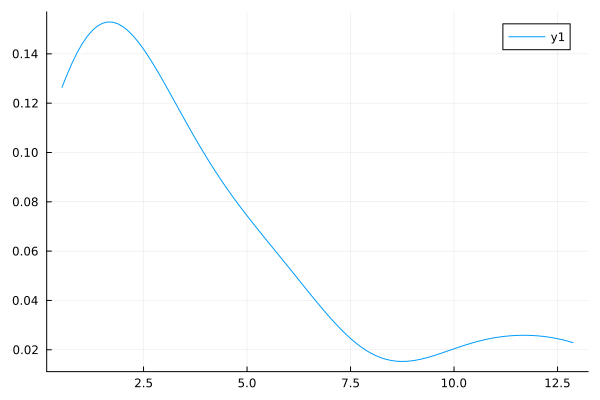

In [164]:
density(posGaps, trim = true)

In [166]:
mean(posGaps)

3.770725849615799

# Experiments on Constrained DCP Problems

## Cardinality Constraint B - 1

In [215]:
Bs = []
for i in 1:numRuns
    Bi = []
    for j in 1:length(ps)
        push!(Bi, max(1, sum(optDcps[i][j]) - 1))
    end
    push!(Bs, Bi)
end

In [216]:
Bs

50-element Vector{Any}:
 Any[1, 1, 1, 2, 3, 4, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15, 16, 18, 19]
 Any[1, 1, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 15, 17, 19, 19, 19, 19, 19]
 Any[1, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15, 17, 19, 19, 19, 19, 19]
 Any[1, 1, 1, 2, 3, 5, 6, 8, 9, 11, 13, 15, 17, 19, 19, 19, 19, 19, 19, 19]
 Any[1, 1, 1, 2, 3, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 16, 18, 19, 19]
 Any[1, 1, 1, 3, 4, 5, 7, 8, 10, 11, 12, 14, 15, 18, 19, 19, 19, 19, 19, 19]
 Any[1, 1, 2, 3, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19]
 Any[1, 1, 2, 3, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 15, 16, 17, 19, 19, 19]
 Any[1, 1, 2, 3, 4, 4, 6, 7, 8, 10, 11, 12, 14, 16, 18, 19, 19, 19, 19, 19]
 Any[1, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 19, 19]
 ⋮
 Any[1, 1, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 15, 16, 18, 19, 19, 19, 19]
 Any[1, 1, 2, 4, 5, 7, 9, 11, 13, 16, 18, 19, 19, 19, 19, 19, 19, 19, 19, 19]
 Any[1, 1, 2, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 16, 18, 19, 19, 19

In [228]:
ps = [10.0^i for i in 0:2:38]
optDcps_K = []
optDcpGs_K = []
heurDcps_K = []
heurDcpGs_K = []
FRAME_LEN = 40
dcpConstrainedExp = Dict()
dcpConstrainedExp["optDcps"] = optDcps_K
dcpConstrainedExp["optDcpGs"] = optDcpGs_K
dcpConstrainedExp["heurDcpGs"] = heurDcpGs_K
dcpConstrainedExp["heurDcps"] = heurDcps_K

f = serialize("dcpConstrainedCardinalityExp.dat", dcpConstrainedExp)

for i in 1:numRuns
    println("----------------------------------------------------")
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    #print("tau: ")
    #println(tau)

    #print("alpha: ")
    #println(alpha)

    #print("c: ")
    #println(c)

    #print("r: ")
    #println(r)


    optDcpsNew = []
    optDcpGsNew = []
    heurDcpGsNew = []
    heurDcpsNew = []

    for j in 1:length(ps)
        p = ps[j]
        print("p: ")
        println(p)

        C = fill(1, N)
        B = Bs[i][j]
        bruteRes = bruteForceDCP_K(N, alpha_d, alpha, beta, tau, c, p, r, C, B)
        heurRes = jointHeuristic_K(N, alpha_d, alpha, beta, tau, c, p, r, C, B)

        println(bruteRes)
        println(heurRes)

        push!(optDcpGsNew, bruteRes[2])
        push!(optDcpsNew, bruteRes[1])

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end

    push!(optDcpGs_K, optDcpGsNew)
    push!(optDcps_K, optDcpsNew)

    push!(heurDcpGs_K, heurDcpGsNew)
    push!(heurDcps_K, heurDcpsNew)

    dcpConstrainedExp["optDcps"] = optDcps_K
    dcpConstrainedExp["optDcpGs"] = optDcpGs_K
    dcpConstrainedExp["heurDcpGs"] = heurDcpGs_K
    dcpConstrainedExp["heurDcps"] = heurDcps_K

    f = serialize("dcpConstrainedCardinalityExp.dat", dcpConstrainedExp)
    println("----------------------------------------------------")
end

In [168]:
dcpConstrainedCardinalityExp = deserialize("dcpConstrainedCardinalityExp.dat")

Dict{Any, Any} with 4 entries:
  "optDcpGs"  => Any[Any[0.213161, 0.422462, 17.3896, 3.81759, 1.48858, 1.04403…
  "optDcps"   => Any[Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…
  "heurDcpGs" => Any[Any[0.213161, 0.422462, 17.3896, 3.81759, 1.48858, 1.04403…
  "heurDcps"  => Any[Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…

In [ ]:
heur

In [229]:
gaps = []

P = length(ps)
L = length(heurDcpGs)
for i in 1:numRuns
    for j in 1:P
        push!(gaps, 100*(heurDcpGs_K[i][j]/optDcpGs_K[i][j] - 1))
    end
end

In [230]:
gaps

1000-element Vector{Any}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 ⋮
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0

In [231]:
maximum(gaps)

0.0

## Cardinality Constraint B - 2

In [232]:
Bs = []
for i in 1:numRuns
    Bi = []
    for j in 1:length(ps)
        push!(Bi, max(1, sum(optDcps[i][j]) - 2))
    end
    push!(Bs, Bi)
end

In [233]:
ps = [10.0^i for i in 0:2:38]
optDcps_K2 = []
optDcpGs_K2 = []
heurDcps_K2 = []
heurDcpGs_K2 = []
FRAME_LEN = 40
dcpConstrainedExp2 = Dict()
dcpConstrainedExp2["optDcps"] = optDcps_K2
dcpConstrainedExp2["optDcpGs"] = optDcpGs_K2
dcpConstrainedExp2["heurDcpGs"] = heurDcpGs_K2
dcpConstrainedExp2["heurDcps"] = heurDcps_K2

f = serialize("dcpConstrainedCardinalityExp2.dat", dcpConstrainedExp2)

for i in 1:numRuns
    println("----------------------------------------------------")
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    #print("tau: ")
    #println(tau)

    #print("alpha: ")
    #println(alpha)

    #print("c: ")
    #println(c)

    #print("r: ")
    #println(r)


    optDcpsNew = []
    optDcpGsNew = []
    heurDcpGsNew = []
    heurDcpsNew = []

    for j in 1:length(ps)
        p = ps[j]
        print("p: ")
        println(p)

        C = fill(1, N)
        B = Bs[i][j]
        bruteRes = bruteForceDCP_K(N, alpha_d, alpha, beta, tau, c, p, r, C, B)
        heurRes = jointHeuristic_K(N, alpha_d, alpha, beta, tau, c, p, r, C, B)

        println(bruteRes)
        println(heurRes)

        push!(optDcpGsNew, bruteRes[2])
        push!(optDcpsNew, bruteRes[1])

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end

    push!(optDcpGs_K2, optDcpGsNew)
    push!(optDcps_K2, optDcpsNew)

    push!(heurDcpGs_K2, heurDcpGsNew)
    push!(heurDcps_K2, heurDcpsNew)

    dcpConstrainedExp2["optDcps"] = optDcps_K2
    dcpConstrainedExp2["optDcpGs"] = optDcpGs_K2
    dcpConstrainedExp2["heurDcpGs"] = heurDcpGs_K2
    dcpConstrainedExp2["heurDcps"] = heurDcps_K2

    f = serialize("dcpConstrainedCardinalityExp2.dat", dcpConstrainedExp2)
    println("----------------------------------------------------")
end

In [234]:
gaps = []

P = length(ps)
L = length(heurDcpGs_K2)
for i in 1:L
    for j in 1:P
        push!(gaps, 100*(heurDcpGs_K2[i][j]/optDcpGs_K2[i][j] - 1))
    end
end

In [236]:
maximum(gaps)

0.0

## g-index based Knapsack constraints

In [238]:
N = 20
alpha_d = fill(0.0, N)
alpha_r = alphas[1]
beta = 1.0
tau = taus[1]
c0 = cs[1]
p = 1000
r = rs[1]

gIndicies = []
for i in 1:N
    dcp = fill(0, N)
    dcp[i] = 1
    push!(gIndicies, calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dcp))
end


In [241]:
sortperm(gIndicies, rev = true)

20-element Vector{Int64}:
 20
 12
 10
 16
 13
 15
  3
  1
  8
 14
 19
  4
  9
  5
  7
  6
 17
 18
 11
  2

In [252]:
optDcps_K3 = []
optDcpGs_K3 = []
heurDcps_K3 = []
heurDcpGs_K3 = []
FRAME_LEN = 40
dcpConstrainedExp3 = Dict()
dcpConstrainedExp3["optDcps"] = optDcps_K3
dcpConstrainedExp3["optDcpGs"] = optDcpGs_K3
dcpConstrainedExp3["heurDcpGs"] = heurDcpGs_K3
dcpConstrainedExp3["heurDcps"] = heurDcps_K3

f = serialize("dcpConstrainedCardinalityExp3.dat", dcpConstrainedExp3)
N = 20
alpha_d = fill(0.0, N)

for i in 1:50
    println("----------------------------------------------------")
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    #print("tau: ")
    #println(tau)

    #print("alpha: ")
    #println(alpha)

    #print("c: ")
    #println(c)

    #print("r: ")
    #println(r)


    optDcpsNew = []
    optDcpGsNew = []
    heurDcpGsNew = []
    heurDcpsNew = []

    #calculate g indices
    gIndicies = []
    for j in 1:N
        dcp = fill(0, N)
        dcp[j] = 1
        push!(gIndicies, calculateG_DSP(N,alpha_d, alpha, beta, tau, c, 1000.0, r, dcp))
    end

    #create cost vector
    C = sortperm(gIndicies, rev = true)

    for j in 1:length(ps)
        p = ps[j]
        print("p: ")
        println(p)

        #generate budget that cuts off optimal solution
        B = sum(optDcps[i][j] .* C) - 1

        bruteRes = bruteForceDCP_K(N, alpha_d, alpha, beta, tau, c, p, r, C, B)
        heurRes = jointHeuristic_K(N, alpha_d, alpha, beta, tau, c, p, r, C, B)

        println(bruteRes)
        println(heurRes)

        push!(optDcpGsNew, bruteRes[2])
        push!(optDcpsNew, bruteRes[1])

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end

    push!(optDcpGs_K3, optDcpGsNew)
    push!(optDcps_K3, optDcpsNew)

    push!(heurDcpGs_K3, heurDcpGsNew)
    push!(heurDcps_K3, heurDcpsNew)

    dcpConstrainedExp3["optDcps"] = optDcps_K3
    dcpConstrainedExp3["optDcpGs"] = optDcpGs_K3
    dcpConstrainedExp3["heurDcpGs"] = heurDcpGs_K3
    dcpConstrainedExp3["heurDcps"] = heurDcps_K3

    f = serialize("dcpConstrainedCardinalityExp3.dat", dcpConstrainedExp3)
    println("----------------------------------------------------")
end

In [169]:
dcpConstrainedCardinalityExp3 = deserialize("dcpConstrainedCardinalityExp3.dat")

Dict{Any, Any} with 4 entries:
  "optDcpGs"  => Any[Any[0.482094, 0.355022, 0.437089, 0.477901, 0.608603, 0.86…
  "optDcps"   => Any[Any[[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…
  "heurDcpGs" => Any[Any[0.482094, 0.355022, 0.437089, 0.477901, 0.608603, 1.04…
  "heurDcps"  => Any[Any[[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…

In [170]:
optDcps_K3 = dcpConstrainedCardinalityExp3["optDcps"]

50-element Vector{Any}:
 Any[[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1

In [253]:
gaps = []

P = length(ps)
L = length(heurDcpGs_K3)
for i in 1:L
    for j in 1:P
        push!(gaps, 100*(heurDcpGs_K3[i][j]/optDcpGs_K3[i][j] - 1))
    end
end

In [254]:
gaps

1000-element Vector{Any}:
   0.0
   0.0
   0.0
   0.0
   0.0
  20.529222924795
 132.79586446065275
   0.0
   0.0
   0.0
   ⋮
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0

In [255]:
maximum(gaps)

76959.37988935201

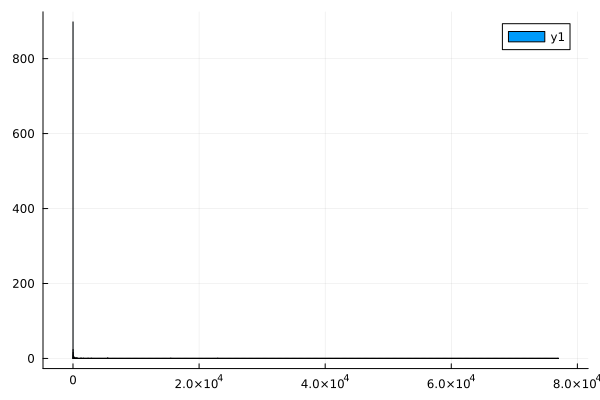

In [256]:
histogram(gaps)

In [257]:
mean(gaps)

145.9511290397459

In [260]:
sum(gaps .< 0.01)

829

## Lagrangian-guided local search attempt

In [168]:
dcpUnconstrainedExp = deserialize("dcpUnconstrainedExp.dat")

Dict{Any, Any} with 4 entries:
  "optDcpGs"  => Any[Any[0.213161, 0.28626, 0.321223, 0.442778, 0.593742, 0.764…
  "optDcps"   => Any[Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…
  "heurDcpGs" => Any[Any[0.213161, 0.28626, 0.321223, 0.442778, 0.593742, 0.764…
  "heurDcps"  => Any[Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,…

In [169]:
optDcps = dcpUnconstrainedExp["optDcps"]

50-element Vector{Any}:
 Any[[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1

In [198]:
ps = [10.0^i for i in 0:2:38]
heurDcps_K4 = []
heurDcpGs_K4 = []
FRAME_LEN = 40
dcpConstrainedExp4 = Dict()
dcpConstrainedExp4["heurDcpGs"] = heurDcpGs_K4
dcpConstrainedExp4["heurDcps"] = heurDcps_K4

f = serialize("dcpConstrainedCardinalityExp4.dat", dcpConstrainedExp4)
N = 20
alpha_d = fill(0.0, N)
epsilon = 0.01

for i in 1:50
    println("----------------------------------------------------")
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    #print("tau: ")
    #println(tau)

    #print("alpha: ")
    #println(alpha)

    #print("c: ")
    #println(c)

    #print("r: ")
    #println(r)

    heurDcpGsNew = []
    heurDcpsNew = []

    #calculate g indices
    gIndicies = []
    for j in 1:N
        dcp = fill(0, N)
        dcp[j] = 1
        push!(gIndicies, calculateG_DSP(N,alpha_d, alpha, beta, tau, c, 1000.0, r, dcp))
    end

    #create cost vector
    C = sortperm(gIndicies, rev = true)

    for j in 1:length(ps)
        p = ps[j]
        print("p: ")
        println(p)

        #generate budget that cuts off optimal solution
        B = sum(optDcps[i][j] .* C) - 1

        heurRes = localSearchLagrangian(N, alpha, beta, tau, c, p, r, C, B, epsilon)

        println(heurRes)

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end


    push!(heurDcpGs_K4, heurDcpGsNew)
    push!(heurDcps_K4, heurDcpsNew)

    dcpConstrainedExp4["heurDcpGs"] = heurDcpGs_K4
    dcpConstrainedExp4["heurDcps"] = heurDcps_K4

    f = serialize("dcpConstrainedCardinalityExp4.dat", dcpConstrainedExp4)
    println("----------------------------------------------------")
end

----------------------------------------------------
p: 1.0
(

[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.48209365868778925)
p: 100.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.3550221110705423)
p: 10000.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.43708875392854435)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.47790067020089)
p: 1.0e8
([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.6086028685510584)
p: 1.0e10
([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.8662086168255222)
p: 1.0e12
([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], 1.4603813971705275)
p: 1.0e14
([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], 1.376942178551213)
p: 1.0e16
([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 1.8393110704500035)
p: 1.0e18


([0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 2.4817050625369204)
p: 1.0e20
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 2.887588248285325)
p: 1.0e22
([0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 3.6302078028932963)
p: 1.0e24
([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], 4.376608795822211)
p: 1.0e26
([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0

, 1, 0, 0, 1, 1, 1, 0], 5.239509743590582)
p: 1.0e28
([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], 7.714668216156459)
p: 1.0e30
([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 9.030707082503339)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 11.45199972804018)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0], 14.907488550733854)
p: 1.0e36


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0], 19.095898618932527)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 42.763056217053844)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.7803416290524294)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 1.395058841296049)
p: 10000.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.6131509946419962)
p: 1.0e6
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 1.062426615637869)
p: 1.0e8
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 1.4395692098524009)
p: 1.0e10
([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0], 2.0070503194973894)
p: 1.0e12


([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0], 2.832064952774689)
p: 1.0e14
([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0], 3.9073341504874746)
p: 1.0e16
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0], 6.1233856738569585)
p: 1.0e18
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], 8.394108198884433)
p: 1.0e20
([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], 10.752127241362844)
p: 1.0e22
([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0], 17.100860229275767)
p: 1.0e24


([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], 24.390880536565014)
p: 1.0e26
([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 40.269045596781744)
p: 1.0e28
([1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 65.93283638356293)
p: 1.0e30
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 163.04832151636163)
p: 1.0e32
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9138.02536096535)
p: 1.0000000000000001e34


([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 906635.7293058642)
p: 1.0e36
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.065640612379575e7)
p: 1.0e38
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.065633445572783e9)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.8634529072250541)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 0.9154318587942889)
p: 10000.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 1.02159836651654)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 1.6794882897193828)
p: 1.0e8


([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 2.1418750299222284)
p: 1.0e10
([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 3.415521232908082)
p: 1.0e12
([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 4.481796973518125)
p: 1.0e14
([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0], 6.2784434836387195)
p: 1.0e16
([1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0], 9.38586403816906)
p: 1.0e18


([1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], 11.865256166288315)
p: 1.0e20
([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], 14.773634370459963)
p: 1.0e22
([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0], 21.78360653120172)
p: 1.0e24
([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], 29.711681614271395)
p: 1.0e26
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], 42.25096807051848)
p: 1.0e28


([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 56.86214720974274)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 180.67906636581387)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 12454.476763433777)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 1.23983424647023e6)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 1.2397781121714985e8)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 1.239777550828511e10)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.9898844893306293)
p: 100.0


([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 1.229774884214251)
p: 10000.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 1.9030501701500422)
p: 1.0e6
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 4.585633563343882)
p: 1.0e8
([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 6.782097053807973)
p: 1.0e10
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0], 8.33406386140178)
p: 1.0e12
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0], 12.20639345449553)
p: 1.0e14
([0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], 15.79703928773942)
p: 1.0e16
([1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], 20.20335418561195)
p: 1.0e18
([1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], 25.006216263696437)
p: 1.0e20


([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], 32.8462154845072)
p: 1.0e22
([1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1], 42.98132063481838)
p: 1.0e24
([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 58.15458884215441)
p: 1.0e26
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 86.41773520200641)
p: 1.0e28
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2144.09395752179)
p: 1.0e30
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 207911.71618950015)
p: 1.0e32


([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.0784673939387336e7)
p: 1.0000000000000001e34
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.078460896259171e9)
p: 1.0e36
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.0784608312823752e11)
p: 1.0e38
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.078460830632607e13)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1995558246072856)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.21764201940889916)
p: 10000.0
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.35073992547911265)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4388941165470912)
p: 1.0e8
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5072140070428509)
p: 1.0e10
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0,

([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], 1.0998119448877204)
p: 1.0e14
([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.536638930594063)
p: 1.0e16
([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.8480212738735526)
p: 1.0e18
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], 2.8173459942425962)
p: 1.0e20
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], 4.126532121943535)
p: 1.0e22
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1], 5.080408692015892)
p: 1.0e24
([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1], 7.575361861035813)
p: 1.0e26


([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 9.606872999832493)
p: 1.0e28
([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 13.493000018140151)
p: 1.0e30
([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 17.46147610224368)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], 24.930035014533836)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], 41.895052089226525)
p: 1.0e36


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 301.41762882714835)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 26029.65782792577)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.240035896674049)
p: 10000.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1], 2.760671630242121)
p: 1.0e6
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 2.7618561032496487)
p: 1.0e8
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], 4.048210913699946)
p: 1.0e10
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 5.502353004936951)
p: 1.0e12
([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], 7.679886578379797)
p: 1.0e14


([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], 9.275570416029927)
p: 1.0e16
([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1], 11.774146351766785)
p: 1.0e18
([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 15.228553619932605)
p: 1.0e20
([1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 22.09649165108826)
p: 1.0e22
([1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 29.45880927662219)
p: 1.0e24


([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], 50.94709974782023)
p: 1.0e26
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 75.36343497530204)
p: 1.0e28
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 671.1840384864329)
p: 1.0e30
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 61022.64405606973)
p: 1.0e32
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.096168645814399e6)
p: 1.0000000000000001e34
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.096107688216474e8)
p: 1.0e36


([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.0961070786404945e10)
p: 1.0e38
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.096107072544734e12)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.33610615283724493)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3667959485176191)
p: 10000.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], 0.4488048598944612)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.5769483395108007)
p: 1.0e8
([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], 0.6966888082241469)
p: 1.0e10
([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], 0.8972335352296922)
p: 1.0e12
([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], 1.001009508562201)
p: 1.0e14
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1

([0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0], 1.4382471139566126)
p: 1.0e18
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0], 1.6226548036224453)
p: 1.0e20
([0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], 1.8575943790018312)
p: 1.0e22
([0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], 2.2395276600812344)
p: 1.0e24
([0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], 2.588626640718273)
p: 1.0e26


([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 3.188694743791484)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], 4.671647421102328)
p: 1.0e30


([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], 4.955002260039619)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], 6.211227153576854)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 7.857066768752813)
p: 1.0e36
([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1

, 1], 12.414196344161432)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 29.979689607375374)
----------------------------------------------------
----------------------------------------------------
p: 1.0


([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3840384537066101)
p: 100.0
([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4272300181132873)
p: 10000.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.5364115196644337)
p: 1.0e6
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.7043978499023273)
p: 1.0e8
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.9007006726025568)
p: 1.0e10
([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 1.1753150520491862)
p: 1.0e12


([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 1.6971564881133292)
p: 1.0e14
([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], 2.0424532938461115)
p: 1.0e16
([0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 2.5567980069891996)
p: 1.0e18
([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 3.437902110572372)
p: 1.0e20


([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 4.597771188245975)
p: 1.0e22
([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], 5.641167124533812)
p: 1.0e24
([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1], 6.95168814223225)
p: 1.0e26


([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], 9.512123199412091)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], 12.082238452224049)
p: 1.0e30
([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 16.227987731732963)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 21.15353078653389)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 37.35796060513901)
p: 1.0e36


([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1724.2569391333245)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 170414.15479195185)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6274260274161878)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5953149428965507)
p: 10000.0
([0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6824461685376088)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.9144955918151769)
p: 1.0e8
([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1

, 0, 0, 0, 0, 0, 0, 0], 1.243685191599798)
p: 1.0e10
([1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 2.0339794542611935)
p: 1.0e12
([1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 2.0546552359923886)
p: 1.0e14
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1], 2.879672658300846)
p: 1.0e16
([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], 4.573347843625791)
p: 1.0e18
([0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], 5.793751284872454)
p: 1.0e20


([0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 9.901267337211653)
p: 1.0e22
([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], 16.571683815834735)
p: 1.0e24
([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 27.521435209295486)
p: 1.0e26
([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 37.613884058789424)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 88.28132337771154)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1565.5242184623653)
p: 1.0e32


([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 151582.6567860036)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.5153295913540127e7)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.5153246215889525e9)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.5153245718913016e11)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.42481393792744454)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.4825894255043468)
p: 10000.0
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.3627637916296705)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.5246852724550686)
p: 1.0e8


([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.7842205173983385)
p: 1.0e10
([0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 1.3148474544597013)
p: 1.0e12
([0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], 1.8541917049849805)
p: 1.0e14
([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 2.4065915018367474)
p: 1.0e16
([0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], 3.1309920463439624)
p: 1.0e18
([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], 4.088859791530002)
p: 1.0e20
([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], 5.332396892610505)
p: 1.0e22


([0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], 7.023695911675963)
p: 1.0e24
([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], 8.602842678992955)
p: 1.0e26
([0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 10.365116960347574)
p: 1.0e28
([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 12.20825319193942)
p: 1.0e30
([1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 19.561347725628423)
p: 1.0e32


([1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 61.07021278102934)
p: 1.0000000000000001e34
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 627.116853868944)
p: 1.0e36
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 60701.59359792486)
p: 1.0e38
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 6.068149268003516e6)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.9078206403321059)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.9606898143714843)
p: 10000.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.0498223384632186)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.3148238080086563)
p: 1.0e8
([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], 1.755154505983967)
p: 1.0e10
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0

([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], 5.139847389484567)
p: 1.0e16
([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], 7.429678923767061)
p: 1.0e18
([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], 11.760192360438072)
p: 1.0e20
([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], 20.491527442207378)
p: 1.0e22
([1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], 24.847927373838413)
p: 1.0e24
([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], 34.595082728612766)
p: 1.0e26
([0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 53.459381700660636)
p: 1.0e28


([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 88.34140046055785)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1010.2706450472085)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 93955.50861224005)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.388479305331524e6)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.3884085897726e8)
p: 1.0e38


([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 9.38840788261701e10)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.39983701696238305)
p: 100.0
([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.526633649434144)
p: 10000.0
([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.6516931521586051)
p: 1.0e6
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.9876029778764774)
p: 1.0e8
([0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.4497385742333249)
p: 1.0e10
([0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1], 2.3404134563389367)
p: 1.0e12
(

[0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], 3.51383095520404)
p: 1.0e14
([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], 4.408909264197945)
p: 1.0e16
([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], 6.152656464948301)
p: 1.0e18
([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], 8.038897617519623)
p: 1.0e20
([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], 9.79286698022263)
p: 1.0e22


([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], 14.867415036529483)
p: 1.0e24
([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], 17.912074975032514)
p: 1.0e26
([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], 24.687462829969647)
p: 1.0e28
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], 39.043173081956965)
p: 1.0e30
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 109.08331596176842)
p: 1.0e32
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7335.790098030252)
p: 1.0000000000000001e34


([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 730006.4683048786)
p: 1.0e36
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.299707428898971e7)
p: 1.0e38
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.299703856357472e9)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.17341955314003454)
p: 100.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1764521853420626)
p: 10000.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.09476544607346443)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.0963690418055211)
p: 1.0e8
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.09792367053553068)
p: 1.0e10
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.10148664372990601)
p: 1.0e12


([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.1015911904268785)
p: 1.0e14
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.10863436267961327)
p: 1.0e16
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.10485685368055392)
p: 1.0e18
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.1123947832396812)
p: 1.0e20
([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0], 0.11215383286187817)
p: 1.0e22
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], 0.11837075247527074)
p: 1.0e24
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], 0.12007722792180028)
p: 1.0e26


([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], 0.13869770274435697)
p: 1.0e28
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], 0.14362955910836944)
p: 1.0e30
([0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], 0.16148240672066227)
p: 1.0e32
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], 0.17742995813281107)
p: 1.0000000000000001e34
([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], 0.17611536517506926)
p: 1.0e36


([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.21062226885055124)
p: 1.0e38
([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], 0.21377041955460052)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.6405844371566483)
p: 10000.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], 0.6140001985364031)
p: 1.0e6
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.7598927986124882)
p: 1.0e8
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0], 0.9585460212873166)
p: 1.0e10
([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0], 2.27880205826433)
p: 1.0e12


([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 3.052004570293212)
p: 1.0e14
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 4.545989419176113)
p: 1.0e16
([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], 6.1804403406011055)
p: 1.0e18
([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], 7.784883673329106)
p: 1.0e20
([0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 10.461300682106446)
p: 1.0e22


([1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 13.520020804365753)
p: 1.0e24
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 16.99437839252585)
p: 1.0e26
([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], 25.98796717909152)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 32.98035964952866)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 88.91447517269307)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 5407.612811230417)
p: 1.0000000000000001e34


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 537277.4464170029)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 5.3724260806994244e7)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 5.372422596864718e9)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.7975958604383928)
p: 100.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4794795007300292)
p: 10000.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.8209845859804833)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 0.9640950377541323)
p: 1.0e8
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 1.22358283968147)
p: 1.0e10
([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 1.930797227473894)
p: 1.0e12
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 

([0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 3.2712516236842917)
p: 1.0e16
([1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 4.345075953183075)
p: 1.0e18
([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 5.6786732716363835)
p: 1.0e20
([1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], 7.830378792439534)
p: 1.0e22
([1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], 10.544564034825866)
p: 1.0e24


([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], 13.857776707423792)
p: 1.0e26
([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], 17.993603226463797)
p: 1.0e28
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0], 24.430476506001455)
p: 1.0e30
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 31.281499285665127)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 168.56404010746468)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 13598.399803096714)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 1.3565819761020215e6)
p: 1.0e38


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 1.356549396059945e8)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5447521070257618)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.798480310543068)
p: 10000.0
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.42039939606262455)
p: 1.0e6
([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 2.0892463264980536)
p: 1.0e8
([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 4.1443835227256205)
p: 1.0e10
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 6.80381149472758)
p: 1.0e12
([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], 10.860456573268516)
p: 1.0e14
([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1], 18.1836812207715)
p: 1.0e16


([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], 24.111102747577146)
p: 1.0e18
([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 32.34430843833638)
p: 1.0e20
([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], 43.46569676115121)
p: 1.0e22
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], 68.78130539283345)
p: 1.0e24
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 108.85061226347209)
p: 1.0e26


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 2027.9972536224395)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 195411.11958242557)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 1.953372335246274e7)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 1.953364946640494e9)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 1.9533648727544363e11)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 1.9533648720155758e13)
p: 1.0e38


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 1.953364872008187e15)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6982585569356299)
p: 10000.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.6735883288277966)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 2.719961939815494)
p: 1.0e8
([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 6.58845778045661)
p: 1.0e10
([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], 10.698564523907459)
p: 1.0e12
([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1], 17.236756966459048)
p: 1.0e14
([0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], 24.722274088460516)
p: 1.0e16


([0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], 35.52013678941691)
p: 1.0e18
([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], 48.40371891586416)
p: 1.0e20
([0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 63.88221289904913)
p: 1.0e22
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 85.09418839485711)
p: 1.0e24
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 443.7649916513661)
p: 1.0e26


([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 36309.032247022325)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.6228357577841175e6)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.6227550831149364e8)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.622754276368244e10)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.622754268300778e12)
p: 1.0e36


([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.622754268220103e14)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3.622754268219296e16)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.361183345478835)
p: 10000.0
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5591636745196101)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], 0.8043541549038425)
p: 1.0e8
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 0.8588903365523651)
p: 1.0e10
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1], 1.2324456951783653)
p: 1.0e12
([0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], 1.4706269710187345)
p: 1.0e14
([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], 2.262261418

([0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], 5.630309229950848)
p: 1.0e20
([0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], 10.146521400445701)
p: 1.0e22
([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], 12.627492302594614)
p: 1.0e24
([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], 24.261888191267932)
p: 1.0e26
([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], 33.29046600426907)
p: 1.0e28


([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 67.506789853744)
p: 1.0e30
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 296.40452876224964)
p: 1.0e32
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 23366.472803909688)
p: 1.0000000000000001e34
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.330373300318653e6)
p: 1.0e36
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.33031056051793e8)
p: 1.0e38
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 2.3303099331199226e10)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.34924205580085543)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.11840585318292692)
p: 10000.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.4446563162710876)
p: 1.0e6


([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.2183213214551442)
p: 1.0e8
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.24479489738119592)
p: 1.0e10
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.3398436343378076)
p: 1.0e12
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1], 0.5321537954640085)
p: 1.0e14
([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1], 0.5265298403250015)
p: 1.0e16
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], 0.5670385475080942)
p: 1.0e18
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], 0.8180091955313338)
p: 1.0e20
([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0], 0.9163311007069765)
p: 1.0e22
([1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], 1.276362272814381)
p: 1.0e24


([1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], 1.5724115948245914)
p: 1.0e26
([1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], 1.8554492123236734)
p: 1.0e28
([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1], 2.221844508157772)
p: 1.0e30
([1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1], 2.5637090534020506)
p: 1.0e32
([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 3.263481993867359)
p: 1.0000000000000001e34
([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 3.5724794046314203)
p: 1.0e36


([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], 4.258369207346035)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], 5.785193726553525)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.25766723169340233)
p: 100.0
([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2673362997817524)
p: 10000.0
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.26368269817720735)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2695129682941321)
p: 1.0e8
([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.3006808259204075)
p: 1.0e10
([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.347703267003978)
p: 1.0e12
([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4332567700219718)
p: 1.0e14
([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 

([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.98438804483079)
p: 1.0e22
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 1.193895424842602)
p: 1.0e24
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 1.6609826730635693)
p: 1.0e26
([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], 2.0716323464010458)
p: 1.0e28
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], 3.2891140302266795)
p: 1.0e30
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], 3.7568286667740187)
p: 1.0e32
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1], 12.742438501180853)
p: 1.0000000000000001e34


([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], 12.312482690271128)
p: 1.0e36
([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], 19.38810869142674)
p: 1.0e38
([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 48.69465111429032)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1977123642998222)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.09515435629226147)
p: 10000.0
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.07433250093742379)
p: 1.0e6
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.09495884280065439)
p: 1.0e8
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], 0.10821529771832038)
p: 1.0e10
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], 0.11881030623485087)
p: 1.0e12
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 

([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], 0.16260822825968008)
p: 1.0e16
([1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.18483659691484713)
p: 1.0e18
([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.1927894339021407)
p: 1.0e20
([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.23065198789849628)
p: 1.0e22
([1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.2768115522409104)
p: 1.0e24
([1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.4273815486550795)
p: 1.0e26
([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], 0.43942465551569304)
p: 1.0e28


([1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 0.6384843873684273)
p: 1.0e30
([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], 1.2845268833890429)
p: 1.0e32
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 1.5486919185614227)
p: 1.0000000000000001e34
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], 2.9228166960052335)
p: 1.0e36
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 3.171759305113952)
p: 1.0e38


([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], 3.80721284177264)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.6080157535528004)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.4697279117057832)
p: 10000.0
([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.4973331643727139)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.693408859355513)
p: 1.0e8
([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.7471912235072347)
p: 1.0e10
([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.999115062883869)
p: 1.0e12
([0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], 2.0050350839443465)
p: 1.0e14
([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], 2.8797762975463668)
p: 1.0e16
([0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], 3.8

([0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0], 11.489109889109471)
p: 1.0e24
([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], 16.423362341128524)
p: 1.0e26
([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 21.290453369735857)
p: 1.0e28
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], 33.133674049448246)
p: 1.0e30
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 47.00123972073559)
p: 1.0e32


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 96.64030560554616)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 4394.260664177244)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 434156.29652134696)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 4.341035988223831e7)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.05148893325837724)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.05231551951150935)
p: 10000.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.05386934241974891)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], 0.053973679866697176)
p: 1.0e8
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], 0.05965720586220891)
p: 1.0e10
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0

([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], 0.05726476737587495)
p: 1.0e14
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], 0.06432104651899087)
p: 1.0e16
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], 0.06518911923069344)
p: 1.0e18
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1], 0.08681729633236279)
p: 1.0e20
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], 0.09058737974393749)
p: 1.0e22
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1], 0.09064058968419042)
p: 1.0e24
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1], 0.09646411062477495)
p: 1.0e26
([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.12273076286453347)
p: 1.0e28


([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], 0.13764757960384463)
p: 1.0e30
([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.1409421860502699)
p: 1.0e32
([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.16964792665967018)
p: 1.0000000000000001e34
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.20667338833786808)
p: 1.0e36
([1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], 0.21906127863597766)
p: 1.0e38
([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], 0.2550290337603225)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1830255126279085)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.022484885292460434)
p: 10000.0


([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.02748107254931287)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.045843057035034274)
p: 1.0e8
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.03849095078945478)
p: 1.0e10
([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.05073968654082626)
p: 1.0e12
([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.06980221931025024)
p: 1.0e14
([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.08799117806711262)
p: 1.0e16
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.10325439129568577)
p: 1.0e18
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 0.13429497427025483)
p: 1.0e20
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], 0.17032003090855327)
p: 1.0e22


([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], 0.20439264727478243)
p: 1.0e24
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0], 0.22960619388195924)
p: 1.0e26
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], 0.25388260446841715)
p: 1.0e28
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], 0.3136874247725639)
p: 1.0e30
([1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.4110843620295817)
p: 1.0e32


([1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 0.5567516365410988)
p: 1.0000000000000001e34
([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], 0.7180703276035453)
p: 1.0e36
([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1], 0.9515133140748652)
p: 1.0e38
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 1.0397048707435643)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8573641021086811)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.7408706179620964)
p: 10000.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.8885800241219822)
p: 1.0e6
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 1.160437586098083)
p: 1.0e8
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], 1.9414805106942266)
p: 1.0e10
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0

([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0], 3.3595849151786803)
p: 1.0e16
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], 4.518718421117962)
p: 1.0e18
([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0], 5.310674554677929)
p: 1.0e20
([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0], 6.573908393510393)
p: 1.0e22
([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1], 8.197485388382722)
p: 1.0e24
([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1], 9.522418481730853)
p: 1.0e26
([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], 12.484213325474856)
p: 1.0e28


([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 22.572987379581747)
p: 1.0e30
([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 20.493918983669815)
p: 1.0e32
([1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], 26.928698118736158)
p: 1.0000000000000001e34
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 38.31436324029628)
p: 1.0e36
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 218.64990277375455)
p: 1.0e38
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 18252.20385611958)
----------------------------------------------------


----------------------------------------------------
p: 1.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.28931269931408116)
p: 100.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.35296666849322217)
p: 10000.0
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3735044466853497)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4630609659247343)
p: 1.0e8
([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 1.2054715695501008)
p: 1.0e10
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 1.202566396903735)
p: 1.0e12
([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 1.3212272515546069)
p: 1.0e14
([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 2.070050182288453)
p: 1.0e16
([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 2.91814808513837)
p: 1.0e18
([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 4.0179858725884845)
p: 1.0e20
([1, 1, 1, 1,

 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], 5.279640992873108)
p: 1.0e22
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], 7.4188390229584344)
p: 1.0e24
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], 10.596026136825486)
p: 1.0e26
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 14.597237210895873)
p: 1.0e28


([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], 18.102141871079827)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], 24.247097329012142)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], 29.5228260277847)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 39.94042453095808)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 393.9912688269446)
p: 1.0e38


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 36139.1217050338)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2422523909516777)
p: 100.0
([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.35021809329558956)
p: 10000.0
([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.904230186250469)
p: 1.0e6
([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 1.1417155176661484)
p: 1.0e8


([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.8317227335182578)
p: 1.0e10
([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], 2.7582037004757005)
p: 1.0e12
([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0], 4.3854461505115765)
p: 1.0e14
([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 5.287319450538014)
p: 1.0e16
([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 6.670071169990763)
p: 1.0e18


([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], 8.519215004010588)
p: 1.0e20
([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 11.026995474910105)
p: 1.0e22


([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], 14.776107047836259)
p: 1.0e24
([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], 19.119614475311764)
p: 1.0e26
([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 26.11796006791438)
p: 1.0e28
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 40.89813711309648)
p: 1.0e30
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 180.56872801050594)
p: 1.0e32
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 14426.437842689043)
p: 1.0000000000000001e34


([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.4390133493105427e6)
p: 1.0e36
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.438977044960959e8)
p: 1.0e38
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.4389766819174633e10)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6347785427521604)
p: 100.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.9681541889485231)
p: 10000.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 1.3966077924162197)
p: 1.0e6
([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 1.383401064356297)
p: 1.0e8
([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 1.7312299258123671)
p: 1.0e10
([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], 2.480227507845372)
p: 1.0e12
([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0,

0], 3.4762456867213722)
p: 1.0e14
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], 4.158151776770377)
p: 1.0e16
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], 6.588424284402262)
p: 1.0e18
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0], 11.995162632098795)
p: 1.0e20
([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], 12.710449255389713)
p: 1.0e22
([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 16.270615836590338)
p: 1.0e24
([1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], 22.439368905251992)
p: 1.0e26


([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], 38.934789295209896)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], 61.216649573902906)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 168.73814324141594)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 8664.123490562128)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 858202.6582226334)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 8.581205613142975e7)
p: 1.0e38


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 8.581197403452142e9)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.32951606902722386)
p: 100.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.5031439822513617)
p: 10000.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3748154320729856)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.33539204128982153)
p: 1.0e8
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.40806267772250027)
p: 1.0e10
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], 0.4148738659417842)
p: 1.0e12
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], 0.5029736047720739)
p: 1.0e14
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1], 0.5824886358704121)
p: 1.0e16
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1,

([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1], 0.7517883341128719)
p: 1.0e20
([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1], 1.2500869358370161)
p: 1.0e22
([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 1.3984220846667785)
p: 1.0e24
([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], 1.457115645538131)
p: 1.0e26
([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1], 1.9468878545933472)
p: 1.0e28
([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 2.2989805759524575)
p: 1.0e30


([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 2.811410570248683)
p: 1.0e32
([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 3.5635616725785466)
p: 1.0000000000000001e34
([1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], 5.059873928340345)
p: 1.0e36
([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 6.182141949201874)
p: 1.0e38
([1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 6.640327873356413)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.11603249449990712)
p: 100.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], 0.11758239097206416)
p: 10000.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.12709554665642145)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.13068614310115878)
p: 1.0e8
([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], 0.1732872659446234)
p: 1.0e14
([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.19168621156856888)
p: 1.0e16
([0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], 0.20421753707317675)
p: 1.0e18
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], 0.22300512304272072)
p: 1.0e20
([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], 0.26655260977049666)
p: 1.0e22
([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.2886854117939488)
p: 1.0e24
([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.3141696810873248)
p: 1.0e26


([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.35319547634619125)
p: 1.0e28
([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.41795942885276066)
p: 1.0e30
([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], 0.5257385878328291)
p: 1.0e32
([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], 0.6024545484471274)
p: 1.0000000000000001e34
([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], 0.6924287405823986)
p: 1.0e36


([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 1.0137608527541837)
p: 1.0e38
([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], 1.0924903970363713)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.41388422734102215)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.3162831823994745)
p: 10000.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.3544457017093492)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], 0.31985174859296966)
p: 1.0e8
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], 0.3687531147606746)
p: 1.0e10
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], 0.38515215417497034)
p: 1.0e12
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], 0.4603758666176372)
p: 1.0e14
([0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 

([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0], 0.9581998734626221)
p: 1.0e20
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 1.0500476237312295)
p: 1.0e22
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0], 1.1166144085347949)
p: 1.0e24
([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0], 1.5521909609542555)
p: 1.0e26
([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], 1.9863500793711877)
p: 1.0e28
([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], 2.882741483283063)
p: 1.0e30
([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 3.1067302569015)
p: 1.0e32


([1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 4.094684304152431)
p: 1.0000000000000001e34
([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 5.273183377854711)
p: 1.0e36
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 7.357527941257502)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 10.854886104750202)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.28764064588681365)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.11454206993383916)
p: 10000.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.12280902001964157)
p: 1.0e6


([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.12578085815065948)
p: 1.0e8
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.14216514702676658)
p: 1.0e10
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], 0.1763501251543543)
p: 1.0e12
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], 0.2522256642829963)
p: 1.0e14
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], 0.27777374048327597)
p: 1.0e16
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], 0.359936139450794)
p: 1.0e18
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], 0.4472115885596051)
p: 1.0e20
([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0], 0.6370479968990923)
p: 1.0e22
([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0], 0.772952669274166)
p: 1.0e24


([1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0], 1.3181230190683488)
p: 1.0e26
([1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], 1.4985858925495992)
p: 1.0e28
([1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 2.029235113383832)
p: 1.0e30
([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 2.5155189030115412)
p: 1.0e32
([1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 3.128576657119061)
p: 1.0000000000000001e34


([1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 3.7950983940018284)
p: 1.0e36
([1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 4.602286376794787)
p: 1.0e38
([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 5.486725104559622)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1573809452466954)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.21215430308871136)
p: 10000.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2877896544422565)
p: 1.0e6
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.22309038874600523)
p: 1.0e8
([1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3146544763989721)
p: 1.0e10
([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.39233516070548513)
p: 1.0e12


([1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.5763702022664327)
p: 1.0e14
([1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], 0.8422823659057211)
p: 1.0e16
([1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], 1.4027514821239635)
p: 1.0e18
([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.9192135539551443)
p: 1.0e20
([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 1.069409840853841)
p: 1.0e22
([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], 1.298453273943472)
p: 1.0e24


([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.6881485490883157)
p: 1.0e26
([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], 2.2127744053709675)
p: 1.0e28
([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], 2.47840073211437)
p: 1.0e30
([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 4.5225915287536855)
p: 1.0e32
([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 3.8567085122607194)
p: 1.0000000000000001e34


([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 4.881644566272181)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 6.050300093386645)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], 9.937000851178183)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8367548689995874)
p: 100.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.1116753972021989)
p: 10000.0
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.5378798884522218)
p: 1.0e6
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 2.48777710947304)
p: 1.0e8
([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 4.491084339382069)
p: 1.0e10


([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], 5.3519783536060155)
p: 1.0e12
([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], 7.485557216943352)
p: 1.0e14
([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 9.654957669275982)
p: 1.0e16
([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 12.114802084561642)
p: 1.0e18
([1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 22.585475726092486)
p: 1.0e20
([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], 24.450075154575508)
p: 1.0e22
([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 34.743415794373945)
p: 1.0e24


([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], 53.42755594717721)
p: 1.0e26
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 91.58114783299396)
p: 1.0e28
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 825.4566137456768)
p: 1.0e30
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 74213.00320501397)
p: 1.0e32


([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.412967662331844e6)
p: 1.0000000000000001e34
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.412884335750148e8)
p: 1.0e36
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.41288350248433e10)
p: 1.0e38
([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 7.412883494151672e12)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.1784665097541307)
p: 100.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.26556212610372476)
p: 10000.0
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6546677582117726)
p: 1.0e6
([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5500709440960556)
p: 1.0e8
([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], 0.7898895803892821)
p: 1.0e10
([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 

1.0e16
([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 2.584063265519025)
p: 1.0e18
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], 3.1881860442709216)
p: 1.0e20
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], 4.385328667158703)
p: 1.0e22
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1], 5.273238953875991)
p: 1.0e24
([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], 6.81894577419604)
p: 1.0e26
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], 9.17436125553477)
p: 1.0e28


([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], 12.645866210813137)
p: 1.0e30
([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 34.81401722181675)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 37.225742145783435)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 69.61660191883006)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 3181.9871797150763)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 314419.04495933966)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5100218620216719)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6497515097133592)
p: 10000.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.5137063531386077)
p: 1.0e6
([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0

([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.296309742501587)
p: 1.0e12
([0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 1.5431150861078167)
p: 1.0e14
([1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], 2.020033202882852)
p: 1.0e16
([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], 2.5528463218977904)
p: 1.0e18
([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], 4.577450303939491)
p: 1.0e20
([1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1], 5.426596535170621)
p: 1.0e22
([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], 7.2995326173041555)
p: 1.0e24
([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], 9.09122316879266)
p: 1.0e26


([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], 11.85096756629157)
p: 1.0e28
([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 15.369983837367462)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], 21.4717819209698)
p: 1.0e32
([1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 30.208225961363368)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 61.426975336390655)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 2120.553523804254)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 208033.20837059058)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.39319102517236826)
p: 100.0


([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.15327841687432)
p: 10000.0
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.2683304354808157)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.2903963958558714)
p: 1.0e8
([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.42037105553104254)
p: 1.0e10
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 0.5532511801536102)
p: 1.0e12
([0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], 0.9260828708819684)
p: 1.0e14
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], 1.8885983196484675)
p: 1.0e16
([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 1.4441376933968875)
p: 1.0e18
([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 1.5940007754339864)
p: 1.0e20
([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], 2.1430641082656052)
p: 1.0e22


([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], 2.689635436139323)
p: 1.0e24
([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], 4.467709974819263)
p: 1.0e26
([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], 4.5871254253198925)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0], 6.812371209194671)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0], 8.463872683028457)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0], 11.496765741795915)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 18.620630226248636)
p: 1.0e36


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], 83.89411648144547)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 924.9438089096075)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6854036033991318)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.44174333084851114)
p: 10000.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.36624152760485756)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.6107846663563996)
p: 1.0e8
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.8224381098091458)
p: 1.0e10
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.4577812466784144)
p: 1.0e12
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], 1.5724077354929722)
p: 1.0e14
([1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],

([1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 3.3749036681348006)
p: 1.0e18
([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 4.89878096907783)
p: 1.0e20
([1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 6.17450790308986)
p: 1.0e22
([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], 8.20562747649765)
p: 1.0e24
([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1], 10.306550730962057)
p: 1.0e26
(

[1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], 15.167806540431293)
p: 1.0e28
([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], 19.413670711181666)
p: 1.0e30
([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 24.253622027397633)
p: 1.0e32
([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 38.94502539010615)
p: 1.0000000000000001e34
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 189.27074482428208)
p: 1.0e36
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 15483.364949273478)
p: 1.0e38
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.544892785394193e6)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10308981835839913)
p: 100.0


([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.09782612280733022)
p: 10000.0
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.10344512916101035)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.10592501181735269)
p: 1.0e8
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.12459183563100631)
p: 1.0e10
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.12713577922306046)
p: 1.0e12
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], 0.13999668089968298)
p: 1.0e14
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], 0.22024602769416993)
p: 1.0e16
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0], 0.21073393284483044)
p: 1.0e18
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], 0.22711231353956288)
p: 1.0e20
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], 0.2695574515749485)
p: 1.0e22
([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0],

([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], 0.47653094304515853)
p: 1.0e28
([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], 0.5941019271841076)
p: 1.0e30
([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 0.7605203636117154)
p: 1.0e32
([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 1.1822428608005053)
p: 1.0000000000000001e34
([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], 1.6880352664224594)
p: 1.0e36
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 2.4910875307501206)
p: 1.0e38


([1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 3.062836747416614)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.6535305499211715)
p: 100.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], 0.2730823511314821)
p: 10000.0
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.35754588550150235)
p: 1.0e6
([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 0.7038651825187388)
p: 1.0e8
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], 1.6100230215530247)
p: 1.0e10
([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], 3.253378513071074)
p: 1.0e12
([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], 3.187691844888279)
p: 1.0e14
([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0], 4.946230596392362)
p: 1.0e16
([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0], 6.

([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], 10.237426220737216)
p: 1.0e22
([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 12.306273027781526)
p: 1.0e24
([1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 16.13153984980683)
p: 1.0e26
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 22.59666533851677)
p: 1.0e28
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], 32.342536596632854)
p: 1.0e30
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 83.09123699416799)
p: 1.0e32


([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 852.4015971912779)
p: 1.0000000000000001e34
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 80935.85397969233)
p: 1.0e36
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 8.0892810922297975e6)
p: 1.0e38
([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 8.089238049172403e8)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.16754579826381039)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 0.7647357946489608)
p: 10000.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.7539354650004935)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], 0.4236102211783853)
p: 1.0e8
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1], 1.0067912018872363)
p: 1.0e10
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1

([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 4.581292297121429)
p: 1.0e18
([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 7.165250270807785)
p: 1.0e20
([1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], 10.72745037937478)
p: 1.0e22
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1], 14.25793753258355)
p: 1.0e24
([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1], 21.53344541401621)
p: 1.0e26
([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1], 31.855844677812843)
p: 1.0e28


([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], 47.78371753210454)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 207.590812236664)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 15949.188812413284)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.5901089888300754e6)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.590060889905963e8)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.5900604089167215e10)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.9865514614515577)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.1405243475520732)
p: 10000.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 2.200897099172648)
p: 1.0e6
([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 3.1909984588013707)
p: 1.0e10
([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0], 4.311643483857036)
p: 1.0e12
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0], 6.005970419983297)
p: 1.0e14
([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 6.936571867431728)
p: 1.0e16
([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], 8.363111817002444)
p: 1.0e18
([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], 10.07650802919533)
p: 1.0e20
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 12.458930590642735)
p: 1.0e22
([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], 14.266703235061557)
p: 1.0e24


([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 18.126127608970837)
p: 1.0e26
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 23.924625364751066)
p: 1.0e28
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 32.52420867947459)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], 49.60806532581395)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 488.3392792068487)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 44964.98008709682)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.492629060876094e6)
p: 1.0e38


([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 4.4925903713977575e8)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 3.507443020352593)
p: 10000.0
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 5.249577130085168)
p: 1.0e6
([1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0], 8.074436829882675)
p: 1.0e8
([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], 13.044089463726955)
p: 1.0e10
([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], 18.00127219709936)
p: 1.0e12


([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0], 27.61570520646867)
p: 1.0e14
([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], 37.404311696967774)
p: 1.0e16
([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1], 58.039314092241554)
p: 1.0e18
([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], 82.1418340506556)
p: 1.0e20


([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 116.07451155787385)
p: 1.0e22
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1193.206983075895)
p: 1.0e24
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 108437.21073829486)
p: 1.0e26
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.0832837586260192e7)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.08327287513845e9)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.0832727663035742e11)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.0832727652152254e13)
p: 1.0000000000000001e34


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.0832727652043419e15)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.0832727652042331e17)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 1.083272765204232e19)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.3287977781819267)
p: 100.0
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.22293647720865178)
p: 10000.0
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.21278027761736173)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.46634541447279526)
p: 1.0e8
([1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], 0.6454484644800831)
p: 1.0e10
([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], 1.4826450792830665)
p: 1.0e12
([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0

([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], 3.329702108861688)
p: 1.0e18
([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], 5.478434199158762)
p: 1.0e20
([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], 8.35476788134459)
p: 1.0e22
([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1], 9.124837984825861)
p: 1.0e24
([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1], 12.909455149732052)
p: 1.0e26
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 17.4615822472467)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], 28.454560444596034)
p: 1.0e30


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], 33.3497725302754)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 130.28285175134735)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 10215.802180444287)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 1.0187677350497381e6)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], 1.0187396102197912e8)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.6863071321718379)
p: 10000.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.8270151074986363)
p: 1.0e6
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], 0.7778223042588519)
p: 1.0e8
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0

([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], 1.6061120908621354)
p: 1.0e12
([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], 2.267539840172348)
p: 1.0e14
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], 3.238734829111683)
p: 1.0e16
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0], 4.553294093070934)
p: 1.0e18
([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], 5.018200591345654)
p: 1.0e20
([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], 6.874869641119168)
p: 1.0e22
([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1], 8.027463472962323)
p: 1.0e24


([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], 10.0363268528696)
p: 1.0e26
([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], 12.845039454165178)
p: 1.0e28
([1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], 19.186669055681076)
p: 1.0e30
([1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 22.752260734103128)
p: 1.0e32
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], 72.72527471170493)
p: 1.0000000000000001e34
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 908.4556077988018)
p: 1.0e36
([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 87476.39136322861)
p: 1.0e38


([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 8.744269966906209e6)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.6312441434790521)
p: 100.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.5780492223054696)
p: 10000.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], 0.6497845260338324)
p: 1.0e6
([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.6005731173790303)
p: 1.0e8
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], 1.6933642039655936)
p: 1.0e10
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 3.7668398419945017)
p: 1.0e12
([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0], 7.672350094172378)
p: 1.0e14
([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0], 8.293138222524192)
p: 1.0e16
([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], 

([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0], 21.47816927092297)
p: 1.0e22
([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], 31.93294060633625)
p: 1.0e24
([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], 40.3576299700894)
p: 1.0e26
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], 54.321927075467904)
p: 1.0e28
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 79.59285549283288)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1897.527111157206)
p: 1.0e32


([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 183683.8769235584)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.8362318858163677e7)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.8362258169821754e9)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 1.8362257562938336e11)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.5130047423454064)
p: 100.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.11216780123611476)
p: 10000.0
([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.1208665423814236)
p: 1.0e6
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], 0.11653610761562556)
p: 1.0e8
([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.21402025909864011)
p: 1.0e10
([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 

([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.1622028460632699)
p: 1.0e16
([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], 0.18545945903518962)
p: 1.0e18
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.19931117744107676)
p: 1.0e20
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.2326554286164154)
p: 1.0e22
([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.28244186155168044)
p: 1.0e24
([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], 0.30473122881844567)
p: 1.0e26


([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.3333216707370662)
p: 1.0e28
([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.37911917601013057)
p: 1.0e30
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.43396893325185903)
p: 1.0e32
([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.45849506226707654)
p: 1.0000000000000001e34


([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], 0.5224729836486809)
p: 1.0e36
([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0], 0.5963148897590648)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], 0.6835184416121919)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.0)
p: 100.0
([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 1.2491041102051976)
p: 10000.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 0.9406936122853714)
p: 1.0e6
([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 1.1624472662759746)
p: 1.0e8
([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], 1.8779475127634366)
p: 1.0e10
([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 2.238595089345458)
p: 1.0e12
([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], 3.3386188075020

([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], 4.563199708661303)
p: 1.0e16
([0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], 5.636766834422429)
p: 1.0e18
([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], 9.148788259143174)
p: 1.0e20
([0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], 12.046680706765901)
p: 1.0e22
([0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], 20.950689833502796)
p: 1.0e24
([0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 32.02924116605047)
p: 1.0e26
([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 58.31465973192742)
p: 1.0e28


([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 232.43488177234372)
p: 1.0e30
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 17474.219024841517)
p: 1.0e32
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 1.741652633331759e6)
p: 1.0000000000000001e34
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 1.7415949406402352e8)
p: 1.0e36
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 1.7415943637133198e10)
p: 1.0e38
([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], 1.7415943579440505e12)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.16458608339393133)
p: 100.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.8192178865354023)
p: 10000.0
([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 4.196662362757579)
p: 1.0e6
([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,


p: 1.0e8
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.9632485848273256)
p: 1.0e10
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0], 0.9335629929398728)
p: 1.0e12
([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 0.8283922699155892)
p: 1.0e14
([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 0.9988116723917784)
p: 1.0e16
([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], 1.4647933024223274)
p: 1.0e18
([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], 1.773472604505656)
p: 1.0e20
([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], 2.617626595425269)
p: 1.0e22


([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0], 3.114801147732155)
p: 1.0e24
([0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0], 4.04605075128401)
p: 1.0e26
([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0], 5.067512702350817)
p: 1.0e28
([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], 6.706995923457758)
p: 1.0e30
([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], 9.316584065928692)
p: 1.0e32


([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 11.913223678392486)
p: 1.0000000000000001e34
([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], 15.057341560619848)
p: 1.0e36
([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 31.45445552439874)
p: 1.0e38
([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 550.8186937956018)
----------------------------------------------------
----------------------------------------------------
p: 1.0
([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.41881584441619046)
p: 100.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4105085967244044)
p: 10000.0
([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.4392432521734607)
p: 1.0e6
([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.42141678436910135)
p: 1.0e8
([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.5076224116818498)
p: 1.0e10
([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 

([0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], 0.7069139746705293)
p: 1.0e14
([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], 0.7497642653215798)
p: 1.0e16
([0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.0880831470118624)
p: 1.0e18
([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], 1.126442992098524)
p: 1.0e20
([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], 1.2724025135314)
p: 1.0e22
([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], 1.4809231653630601)
p: 1.0e24
([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 1.648789474390637)
p: 1.0e26
([0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], 1.8670757020063564)
p: 1.0e28


([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], 2.299540443046706)
p: 1.0e30
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], 2.5756970865277786)
p: 1.0e32
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], 2.9721409353757573)
p: 1.0000000000000001e34
([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], 3.572427980643012)
p: 1.0e36
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], 4.022012260503583)
p: 1.0e38
([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], 4.865968323141881)
----------------------------------------------------

In [169]:
dcpConstrainedCardinalityExp3 = deserialize("dcpConstrainedCardinalityExp3.dat")
optDcpGs_K3 = dcpConstrainedCardinalityExp3["optDcpGs"]
optDcps_K3 = dcpConstrainedCardinalityExp3["optDcps"]

50-element Vector{Any}:
 Any[[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], [0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], [0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], [0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1

In [214]:
gaps = []

P = length(ps)
L = length(heurDcpGs_K4)
for i in 1:L
    for j in 1:P
        push!(gaps, 100*(heurDcpGs_K4[i][j]/optDcpGs_K3[i][j] - 1))
    end
end

In [215]:
sum(gaps .== 0.0)

951

In [216]:
sum(gaps .<= 0.1)

953

In [217]:
sum(gaps .<= 1)

963

In [218]:
sum(gaps .<= 10)

986

In [203]:
maximum(gaps)

96.16102782625818

In [204]:
mean(gaps)

0.5084314319579946

In [205]:
sum(gaps .< 1)

963

## Knapsack Constraints 2

In [178]:
ps = [10.0^i for i in 0:2:38]
heurDcps_K5 = []
heurDcpGs_K5 = []
optDcps_K5 = []
optDcpGs_K5 = []
FRAME_LEN = 40
dcpConstrainedExp5 = Dict()
dcpConstrainedExp5["heurDcpGs"] = heurDcpGs_K5
dcpConstrainedExp5["heurDcps"] = heurDcps_K5
dcpConstrainedExp5["optDcpGs"] = optDcpGs_K5
dcpConstrainedExp5["optDcps"] = optDcps_K5

f = serialize("dcpConstrainedExp5.dat", dcpConstrainedExp5)
N = 20
alpha_d = fill(0.0, N)
epsilon = 0.01

for i in 1:50
    println("----------------------------------------------------")
    print("Run: ")
    println(i)
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    #print("tau: ")
    #println(tau)

    #print("alpha: ")
    #println(alpha)

    #print("c: ")
    #println(c)

    #print("r: ")
    #println(r)

    optDcpGsNew = []
    optDcpsNew = []

    heurDcpGsNew = []
    heurDcpsNew = []

    #calculate g indices
    gIndicies = []
    for j in 1:N
        dcp = fill(0, N)
        dcp[j] = 1
        push!(gIndicies, calculateG_DSP(N,alpha_d, alpha, beta, tau, c, 1000.0, r, dcp))
    end

    #create cost vector
    C = sortperm(gIndicies, rev = true)

    for j in 1:length(ps)
        print(j)
        print(": ")
        p = ps[j]
        #print("p: ")
        #println(p)

        #generate budget that cuts off optimal solution
        B = max(sum(optDcps_K3[i][j] .* C) - 1, 1)

        bruteRes = bruteForceDCP_k(N, alpha_d, alpha, beta, tau, c, p, r, C, B)
        print("Brute Force Done, ")
        heurRes = localSearchLagrangian(N, alpha, beta, tau, c, p, r, C, B, epsilon)
        println("Heuristic Done")
        #println(heurRes)

        push!(optDcpGsNew, bruteRes[2])
        push!(optDcpsNew, bruteRes[1])

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end
    push!(optDcpGs_K5, optDcpGsNew)
    push!(optDcps_K5, optDcpsNew)

    push!(heurDcpGs_K5, heurDcpGsNew)
    push!(heurDcps_K5, heurDcpsNew)

    dcpConstrainedExp5["optDcpGs"] = optDcpGs_K5
    dcpConstrainedExp5["optDcps"] = optDcps_K5

    dcpConstrainedExp5["heurDcpGs"] = heurDcpGs_K5
    dcpConstrainedExp5["heurDcps"] = heurDcps_K5

    f = serialize("dcpConstrainedExp5.dat", dcpConstrainedExp5)
    println("----------------------------------------------------")
end

In [179]:
gaps = []
for i in 1:50
    for j in 1:20
        push!(gaps, 100*(heurDcpGs_K5[i][j]/optDcpGs_K5[i][j] - 1))
    end
end 


In [181]:
maximum(gaps)

111.19400695858003

In [182]:
sum(gaps .== 0.0)

887

In [183]:
sum(gaps .<= 0.1)

887

In [184]:
sum(gaps .<= 1.0)

893

In [185]:
sum(gaps .<= 10.0)

945

In [186]:
mean(gaps)

2.487974381579548

In [187]:
mean([g for g in gaps if g > 0.0])

22.017472403358834

In [189]:
median([g for g in gaps if g > 0.0])

9.868079708166078

## Knapsack Constraints 2 with Half-Lagrangian

In [204]:
ps = [10.0^i for i in 0:2:38]
heurDcps_K6 = []
heurDcpGs_K6 = []
FRAME_LEN = 40
dcpConstrainedExp6 = Dict()
dcpConstrainedExp6["heurDcpGs"] = heurDcpGs_K6
dcpConstrainedExp6["heurDcps"] = heurDcps_K6


f = serialize("dcpConstrainedExp6.dat", dcpConstrainedExp6)
N = 20
alpha_d = fill(0.0, N)
epsilon = 0.01

for i in 1:50
    println("----------------------------------------------------")
    print("Run: ")
    println(i)
    #get parameters
    tau = taus[i]
    alpha = alphas[i]
    c = cs[i]
    r = rs[i]

    #print parameters
    #print("tau: ")
    #println(tau)

    #print("alpha: ")
    #println(alpha)

    #print("c: ")
    #println(c)

    #print("r: ")
    #println(r)

    heurDcpGsNew = []
    heurDcpsNew = []

    #calculate g indices
    gIndicies = []
    for j in 1:N
        dcp = fill(0, N)
        dcp[j] = 1
        push!(gIndicies, calculateG_DSP(N,alpha_d, alpha, beta, tau, c, 1000.0, r, dcp))
    end

    #create cost vector
    C = sortperm(gIndicies, rev = true)

    for j in 1:length(ps)
        print(j)
        print(": ")
        p = ps[j]
        #print("p: ")
        #println(p)

        #generate budget that cuts off optimal solution
        B = max(sum(optDcps_K3[i][j] .* C) - 1, 1)

        heurRes = localSearchHalfLagrangian(N, alpha, beta, tau, c, p, r, C, B, epsilon)
        #println(heurRes)

        push!(heurDcpGsNew, heurRes[2])
        push!(heurDcpsNew, heurRes[1])
    end

    push!(heurDcpGs_K6, heurDcpGsNew)
    push!(heurDcps_K6, heurDcpsNew)

    dcpConstrainedExp6["heurDcpGs"] = heurDcpGs_K6
    dcpConstrainedExp6["heurDcps"] = heurDcps_K6

    f = serialize("dcpConstrainedExp6.dat", dcpConstrainedExp6)
    println("----------------------------------------------------")
end

In [205]:
gaps = []
for i in 1:50
    for j in 1:20
        push!(gaps, 100*(heurDcpGs_K6[i][j]/optDcpGs_K5[i][j] - 1))
    end
end 

In [206]:
gaps

1000-element Vector{Any}:
   0.0
   0.0
   0.0
   0.0
 111.67131496149341
   8.385340374927797
   0.0
   0.0
  50.56829487120067
   0.0
   ⋮
   0.0
   0.0
   0.0
   0.0
   0.5375110071971445
   1.3673189446911094
   0.0
   2.4225484299039035
   0.0

In [207]:
maximum(gaps)

2551.70993362352

In [208]:
#WORSE!

# Experiments on Small Problems

## Instance Investigation 

In [463]:
oddRuns = [i for i in 1:1000 if dspGaps[i] <= exactPIFromVFA_gap[i] && dspGaps[i] > 1]

46-element Vector{Int64}:
  12
  30
  93
 101
 107
 146
 162
 201
 207
 228
 244
 249
 261
   ⋮
 661
 687
 715
 736
 783
 801
 817
 853
 869
 890
 901
 984

In [469]:
exactPIFromVFA_gap[93]

73.37048128450272

In [478]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 1000000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0

run = 6

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

println()

#print rvi result 
print("RVI: ")
print(round(rviGs[run], digits = 5))

#print exact heuristic result
print(", PI Heuristic: ")
print(round(optPiGs[run], digits = 5))

print(", Gap: ")
println(round(optGaps[run], digits = 2))

#find PE of best DSP
policy = staticPolicyToDynamicPolicy(N, optDsps[run])
resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE Iterations: ")
println(resPE[3])

#simulate g of exact dsp
dsp = optDsps[run]
mcp = Array{Any}(nothing, N)
for i in 1:N
    if dsp[i] == 1
        mcp[i] = -1
    else
        mcp[i] = alpha_r[i]*(1000/999 - 1.0)
    end
end

Random.seed!(12345)
gsExact = optDspGs[run]
print("SP g: ")
print(round(gsExact[1], digits = 5))

#find smarpe vfa of dsp
Random.seed!(12345)
resSMARPE = smarpeNewVFA_ST_DCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxSmarpe, stepsize, mcp; ve = Dict(), vn = Dict(), veStep = Dict(), vnStep = Dict(), vfaProvided = false, g = optDspGs[run], gFixed = true, s = fill(1, N), stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
ve = resSMARPE["ve"]
vn = resSMARPE["vn"]

#evaluate PI policy from smarpe vfa
h = hFromNewVFA(ve, vn, N,alpha_d, alpha_r, beta, tau, c0, c1, r)
resPI = rpiExact(N, h, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)

Random.seed!(12345)
#gsPI = gEvaluationNewVFA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxgEval, ve, vn, optDspGs[run], printProgress = false, modCounter = 100000)

#print("Simulated PI g: ")
#print(round(gsPI[1], digits = 5))
print(", Exact PI g: ")
print(round(resPI[1], digits = 5))
#print(", Optimality Gap: ")
#gap = (resPI[1]/rviGs[run] - 1)*100
#println(round(gap, digits = 2))
#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 6
tau: [0.3152421869370332, 0.0775328897574149, 0.8668001780368776, 0.635247162882394, 0.37101097421566187]
alpha: [0.02209608772152969, 0.03497173817099469, 0.006111187881283514, 0.04762558624167467, 0.006563205112644]
c0: [0.1876429469318034, 0.484814030223487, 0.5136160809618052, 0.6045241487477916, 0.8827443952651307]
c1: 297.3222012571138
r: [25.844439089895545, 32.364983460388174, 54.91785936768554, 55.003683540638825, 40.79891902418276]

RVI: 1.64593, PI Heuristic: 1.64594, Gap: 0.0
PE Iterations: 2272
SP g: 1.64594, Exact PI g: 1.64594---------------------------------------------------------------------------


In [469]:
stateSpace = enumerateStates(N)


243-element Vector{Any}:
 [1, 1, 1, 1, 1]
 [2, 1, 1, 1, 1]
 [3, 1, 1, 1, 1]
 [1, 2, 1, 1, 1]
 [2, 2, 1, 1, 1]
 [3, 2, 1, 1, 1]
 [1, 3, 1, 1, 1]
 [2, 3, 1, 1, 1]
 [3, 3, 1, 1, 1]
 [1, 1, 2, 1, 1]
 [2, 1, 2, 1, 1]
 [3, 1, 2, 1, 1]
 [1, 2, 2, 1, 1]
 ⋮
 [1, 3, 2, 3, 3]
 [2, 3, 2, 3, 3]
 [3, 3, 2, 3, 3]
 [1, 1, 3, 3, 3]
 [2, 1, 3, 3, 3]
 [3, 1, 3, 3, 3]
 [1, 2, 3, 3, 3]
 [2, 2, 3, 3, 3]
 [3, 2, 3, 3, 3]
 [1, 3, 3, 3, 3]
 [2, 3, 3, 3, 3]
 [3, 3, 3, 3, 3]

In [474]:
trueValues = []
approxValues = []
for s in stateSpace
    push!(trueValues, resPE[2][s])
    push!(approxValues, v(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r, resSMARPE["ve"], resSMARPE["vn"]))
end

In [475]:
p = sortperm(trueValues); trueValues .= trueValues[p]; approxValues .= approxValues[p]; stateSpace .= stateSpace[p] 

243-element Vector{Any}:
 [1, 1, 1, 1, 1]
 [1, 1, 1, 3, 1]
 [1, 3, 1, 1, 1]
 [1, 3, 1, 3, 1]
 [3, 1, 1, 1, 1]
 [3, 1, 1, 3, 1]
 [3, 3, 1, 1, 1]
 [3, 3, 1, 3, 1]
 [1, 1, 2, 1, 1]
 [1, 1, 3, 1, 1]
 [1, 1, 2, 3, 1]
 [1, 1, 3, 3, 1]
 [1, 3, 2, 1, 1]
 ⋮
 [3, 2, 2, 2, 2]
 [3, 2, 3, 2, 2]
 [3, 2, 2, 2, 3]
 [3, 2, 3, 2, 3]
 [2, 2, 2, 3, 2]
 [2, 2, 3, 3, 2]
 [2, 2, 2, 3, 3]
 [2, 2, 3, 3, 3]
 [2, 2, 2, 2, 2]
 [2, 2, 3, 2, 2]
 [2, 2, 2, 2, 3]
 [2, 2, 3, 2, 3]

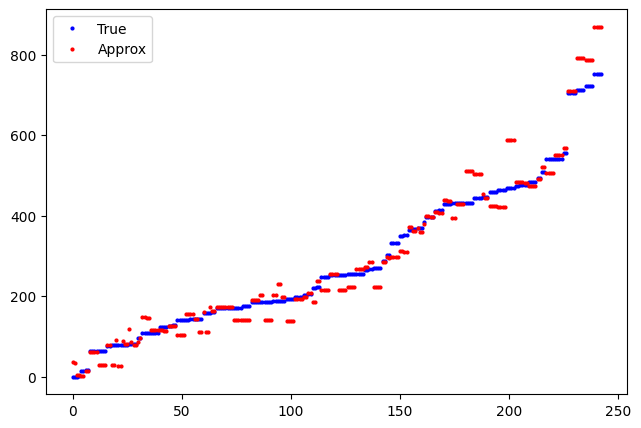

PyObject <matplotlib.legend.Legend object at 0x7fb6f3fd0040>

In [476]:
figure(figsize=((3/2)*5, 5))
gap = mean(trueValues - approxValues)
ptSize = 2
PyPlot.plot(trueValues , "bo", label = "True", ms = ptSize)
PyPlot.plot(approxValues.+ gap, "ro", label = "Approx", ms = ptSize)
legend()
#PyPlot.savefig("vfaVsTrue.pdf", bbox_inches="tight")

In [791]:
optDsps[run]

5-element Vector{Int64}:
 1
 0
 0
 0
 0

In [795]:
stateSpace[100]

5-element Vector{Int64}:
 2
 1
 2
 1
 2

## Usage Costs Only

In [473]:
run = 100

100

In [157]:
resultExp10 = deserialize("resultExp10_update.big")

Dict{Any, Any} with 18 entries:
  "taus_FAS"      => Any[[0.944791, 0.866895, 0.339612, 0.136117, 0.322501], [0…
  "rviIter"       => Any[1464, 4813, 4527, 904, 3246, 2546, 10362, 885, 6902, 5…
  "c0s_FAS"       => Any[[0.0926115, 0.118489, 0.26755, 0.810495, 0.868154], [0…
  "optDspGs_FAS"  => Any[4.70822, 0.97105, 0.615976, 10.982, 0.551766, 1.64594,…
  "optDsps_FAS"   => Any[[1, 1, 0, 0, 0], [1, 0, 0, 1, 0], [0, 1, 1, 0, 0], [1,…
  "rs_FAS"        => Any[[99.5615, 82.0005, 83.4463, 73.4694, 38.3613], [2.2917…
  "heurPiGs_FAS"  => Any[4.70822, 0.94362, 0.589639, 9.17702, 0.551766, 1.64594…
  "rpiIter"       => Any[1541, 4939, 4439, 867, 2952, 2335, 10365, 800, 6109, 4…
  "heurDsps_FAS"  => Any[[1, 1, 0, 0, 0], [1, 0, 0, 1, 0], [0, 1, 1, 0, 0], [1,…
  "heurGaps_FAS"  => Any[1.61204e-11, 0.0, 0.0, 5.41783, -6.53178e-10, 0.000438…
  "optGaps_FAS"   => Any[1.61204e-11, 0.0, 0.0, 5.41783, -6.53178e-10, 0.000438…
  "alphas_FAS"    => Any[[0.00897018, 0.0369358, 0.059888, 0.0366322, 0.07370

In [745]:
for run in 1:1000
    if sum(optDsps[run]) == 1
        print(run)
        break
    end
end

21

In [1146]:
run = 100

N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 1000000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0
N = 5



taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

dsp = optDsps[run]
#dsp = fill(1, N)
gUsage = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dsp)
print("Exact usage g: ")
println(round(gUsage, digits = 5))

#find PE of DSP
policy = staticPolicyToDynamicPolicy(N, dsp)
resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE usage g: ")
println(round(resPE[1], digits = 5))

print("PE Iterations: ")
println(resPE[3])

#simulate g of exact dsp


mcp = Array{Any}(nothing, N)
for i in 1:N
    if dsp[i] == 1
        mcp[i] = -1
    else
        mcp[i] = alpha_r[i]/1000
    end
end


#find smarpe vfa of dsp
Random.seed!(12345)
resSMARPE = smarpeNewVFA_ST_MCP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), nMaxSmarpe, 0.0, mcp; ve = Dict(), vn = Dict(), veStep = Dict(), vnStep = Dict(), vfaProvided = false, g = gUsage, gFixed = true, s = fill(1, N), stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
ve = resSMARPE["ve"]
vn = resSMARPE["vn"]
println("SMARPE Complete")

#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 100
tau: [0.2471073047119835, 0.9468640485415448, 0.037827463220004964, 0.04139334607085687, 0.7320616554118029]
alpha: [0.00539088714021297, 0.0007845164968817274, 0.0049829360503505955, 0.02580901707708836, 0.013774843928487858]
c0: [0.16097122017749166, 0.2493202759633123, 0.4585005045840095, 0.516210849121674, 0.8976777148987641]
c1: 604.3743498466794
r: [68.02880059602833, 58.23191726253334, 44.441635785486845, 75.53704124213228, 84.3455733189013]
Exact usage g: 0.24911
PE usage g: 0.24911
PE Iterations: 7579
SMARPE Complete
---------------------------------------------------------------------------


In [1114]:
dsp

5-element Vector{Int64}:
 0
 1
 0
 0
 0

In [488]:
function hFromAggUsageH_FA(s, hVec)
    if s[1] == 1
        hs = 0.0
    else
        assigned = false
        for i in 2:N
            if s[i] == 1
                hs = hVec[i - 1]
                assigned = true
                break
            end
        end

        if !assigned
            hs = hVec[N]
        end
    end

    return hs
end

hFromAggUsageH_FA (generic function with 1 method)

In [531]:
function constructAggUsageH_DCP(N, alpha_r, beta, tau, c0, dcp)
    alphaDCP = []
    tauDCP = []
    c0DCP = []
    M = sum(dcp)
    for i in 1:N
        if dcp[i] == 1
            push!(alphaDCP, alpha_r[i])
            push!(tauDCP, tau[i])
            push!(c0DCP, c0[i])
        end
    end

    hVecDCP_FA = append!([0.0], constructAggUsageH(M, alphaDCP, beta, tauDCP, c0DCP))
    hVec = []
    pointer = 1
    for i in 1:N
        push!(hVec, hVecDCP_FA[min(pointer,M)])
        if dcp[i] == 1
            pointer += 1
        end
    end
    push!(hVec, hVecDCP_FA[min(pointer,M)])
    return hVec
end



constructAggUsageH_DCP (generic function with 1 method)

In [1102]:
stateSpace = enumerateStates(N)

hAggVec = append!([0.0],constructAggUsageH(N, alpha_r, beta, tau, c0))
hAgg = Dict()
for s in stateSpace
    assigned = false
    for i in 1:N
        if s[i] == 1
            hAgg[s] = hAggVec[i]
            assigned = true
            break
        end
    end

    if !assigned
        hAgg[s] = hAggVec[N+1]
    end
end
            

In [655]:
hAggVec = constructAggUsageH_DCP(N, alpha_r, beta, tau, c0, dsp)
hAgg = Dict()
for s in stateSpace
    assigned = false
    for i in 1:N
        if s[i] == 1
            hAgg[s] = hAggVec[i]
            assigned = true
            break
        end
    end

    if !assigned
        hAgg[s] = hAggVec[N+1]
    end

end

In [689]:
function used(s)
    for i in 1:N 
        if s[i] == 1
            return i
        end
    end

    return 0
end

used (generic function with 1 method)

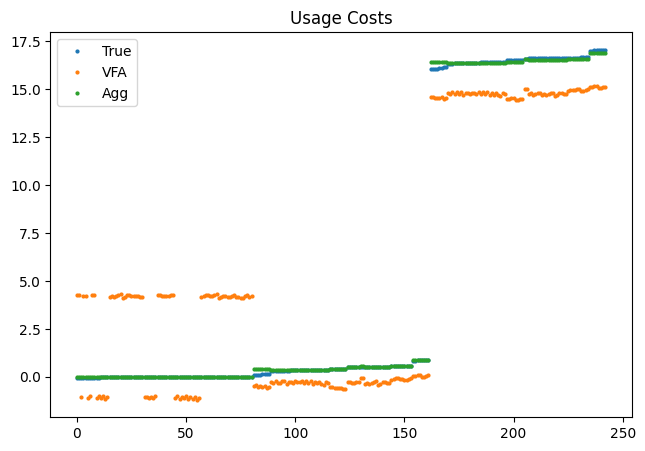

PyObject <matplotlib.legend.Legend object at 0x7f9ddd760070>

In [1147]:
stateSpace = enumerateStates(N)

trueValues = []
vfaValues = []
aggValues = []
lastS = []
for s in stateSpace
    push!(trueValues, resPE[2][s])
end

p = sortperm(trueValues)
trueValues .= trueValues[p]
stateSpace .= stateSpace[p] 

#for s in stateSpace
#    if sum(s[i] == 3 && dsp[i] == 0 for i in 1:N) != 0
#        push!(aggValues, -0.0)
#    else
#        push!(aggValues, hAgg[s])
#        lastS = s
#    end
#end

for s in stateSpace
    push!(aggValues, hAgg[s] + 16*(s[1] == 3))
    push!(vfaValues, v(s,N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), resSMARPE["ve"], resSMARPE["vn"]) )
end

figure(figsize=((3/2)*5, 5))
gapVFA = mean(trueValues - vfaValues)
gapAgg = mean(trueValues - aggValues)
ptSize = 2
PyPlot.plot(trueValues , "o", label = "True", ms = ptSize)
PyPlot.plot(vfaValues .+ gapVFA, "o", label = "VFA", ms = ptSize)
PyPlot.plot(aggValues, "o", label = "Agg", ms = ptSize)
#PyPlot.plot(trueValues - aggValues, "o", label = "Diff", ms = ptSize)

title("Usage Costs")
legend()
#PyPlot.savefig("vfaVsTrue.pdf", bbox_inches="tight")

In [1118]:
    stateSpace[1:75] 

75-element Vector{Any}:
 [1, 2, 3, 3, 3]
 [1, 3, 3, 3, 3]
 [1, 1, 3, 3, 3]
 [1, 2, 3, 2, 3]
 [1, 3, 3, 2, 3]
 [1, 1, 3, 2, 3]
 [1, 1, 3, 1, 3]
 [1, 2, 3, 1, 3]
 [1, 3, 3, 1, 3]
 [1, 1, 3, 3, 2]
 [1, 1, 3, 3, 1]
 [1, 1, 3, 1, 2]
 [1, 1, 3, 1, 1]
 ⋮
 [1, 2, 1, 1, 1]
 [1, 3, 1, 1, 1]
 [1, 2, 1, 2, 2]
 [1, 3, 1, 2, 2]
 [1, 2, 1, 2, 1]
 [1, 3, 1, 2, 1]
 [1, 2, 2, 1, 2]
 [1, 3, 2, 1, 2]
 [1, 2, 2, 1, 1]
 [1, 3, 2, 1, 1]
 [1, 2, 2, 3, 2]
 [1, 3, 2, 3, 2]

In [1127]:
[stateSpace[i] for i in 1:243 if 2.5 < vfaValues[i] + gapVFA && vfaValues[i] + gapVFA < 5.0]

54-element Vector{Vector{Int64}}:
 [1, 2, 3, 3, 3]
 [1, 3, 3, 3, 3]
 [1, 2, 3, 2, 3]
 [1, 3, 3, 2, 3]
 [1, 2, 3, 1, 3]
 [1, 3, 3, 1, 3]
 [1, 2, 3, 3, 2]
 [1, 3, 3, 3, 2]
 [1, 2, 3, 1, 2]
 [1, 3, 3, 1, 2]
 [1, 2, 3, 1, 1]
 [1, 3, 3, 1, 1]
 [1, 2, 3, 2, 2]
 ⋮
 [1, 2, 2, 1, 2]
 [1, 3, 2, 1, 2]
 [1, 2, 2, 1, 1]
 [1, 3, 2, 1, 1]
 [1, 2, 2, 3, 2]
 [1, 3, 2, 3, 2]
 [1, 2, 2, 2, 2]
 [1, 3, 2, 2, 2]
 [1, 2, 2, 3, 1]
 [1, 3, 2, 3, 1]
 [1, 2, 2, 2, 1]
 [1, 3, 2, 2, 1]

In [632]:
s0 = [1,3,3,1,3]
s1 = [3,3,3,1,3]
s2 = [1,3,3,3,3]
s3 = [3,3,3,3,3]

println(resPE[2][s0])
println(resPE[2][s1])
println(resPE[2][s2])
println(resPE[2][s3])

1.0494744190193168
1.9446920637281633
0.9134235275671505
1.0257148896627954


## Repair Costs only

In [398]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-15
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 2000000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0

run = 21



taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

dsp = optDsps[run]
gRepair = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), 0.0, r, dsp)
print("Exact repair g: ")
println(round(gRepair, digits = 5))

#find PE of DSP
policy = staticPolicyToDynamicPolicy(N, optDsps[run])
resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, fill(0.0, N), 0.0, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE repair g: ")
println(round(resPE[1], digits = 5))

print("PE Iterations: ")
println(resPE[3])

#simulate g of exact dsp


mcp = Array{Any}(nothing, N)
for i in 1:N
    if dsp[i] == 1
        mcp[i] = -1
    else
        mcp[i] = alpha_r[i]*(1/10)
    end
end


#find smarpe vfa of dsp
Random.seed!(12345)
#resSMARPE = smarpeNewVFA_ST_DCP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), 0.0, r, nMaxSmarpe, stepsize, mcp; ve = Dict(), vn = Dict(), veStep = Dict(), vnStep = Dict(), vfaProvided = false, g = gRepair, gFixed = true, s = fill(1, N), stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
#ve = resSMARPE["ve"]
#vn = resSMARPE["vn"]
println("SMARPE Complete")

#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 21
tau: [0.011621419540158495, 0.1391171897478627, 0.514080044224977, 0.2563623067497941, 0.9855933760757034]
alpha: [0.0010442990873694071, 0.0021034540121505586, 0.0010784948563221405, 0.002306954498408524, 0.007712381271183721]
c0: [0.19754044626185052, 0.39413046851249367, 0.5250322727173794, 0.8628625399573912, 0.9277304666970809]
c1: 25.966811597781383
r: [83.4526919764657, 98.62693541694621, 18.477742834711574, 64.1956807714162, 79.09710753035259]
Exact repair g: 0.03868
PE repair g: 0.03868
PE Iterations: 4857
SMARPE Complete
---------------------------------------------------------------------------


In [231]:
dsp

5-element Vector{Int64}:
 0
 0
 1
 1
 0

In [1456]:
function hRepairDCP(s, N, dcp, alpha_r, beta, tau, r)
    sPrime = copy(s)
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
    end

    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == []
        return 0.0
    else 
        return sum(r[i]/(tau[i] + alpha_r[i]) for i in reps)
    end
end

function hRepairDCP(s, dcp, probParams::problemParams)
    (; N, alpha, beta, tau, r) = probParams
    return hRepairDCP(s, N, dcp, alpha, beta, tau, r)
end

hRepairDCP (generic function with 2 methods)

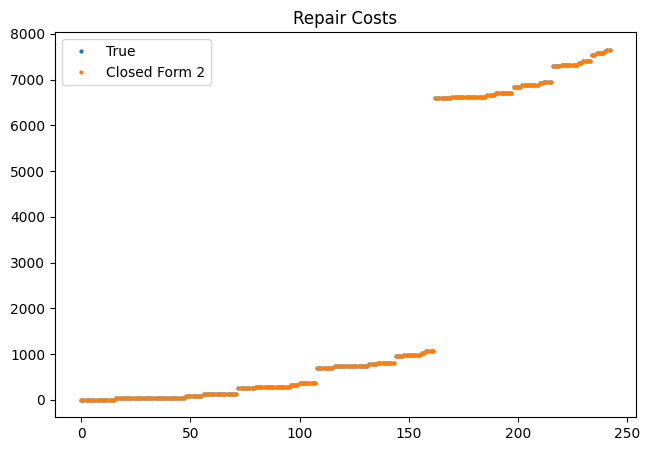

PyObject <matplotlib.legend.Legend object at 0x7fb7023d5c90>

In [402]:
stateSpace = enumerateStates(N)

trueValues = []
closedFormValues = []
for s in stateSpace
    push!(trueValues, resPE[2][s])
    push!(closedFormValues, hRepairDCP(s, N, dsp, alpha_r, beta, tau, r))
end

p = sortperm(trueValues)
trueValues .= trueValues[p]
stateSpace .= stateSpace[p]
closedFormValues .= closedFormValues[p]  

figure(figsize=((3/2)*5, 5))
gapClosed = mean(trueValues - closedFormValues)

ptSize = 2
PyPlot.plot(trueValues , "o", label = "True", ms = ptSize)
PyPlot.plot(closedFormValues .+ (gapClosed), "o", label = "Closed Form 2", ms = ptSize)
title("Repair Costs")
legend()
#PyPlot.savefig("vfaVsTrue.pdf", bbox_inches="tight")

In [1088]:
closedFormValues_2

972-element Vector{Any}:
    0.0
    0.0
    0.0
    0.0
    0.0
    0.0
    0.0
    0.0
   19.64379127914972
   19.64379127914972
   19.64379127914972
   19.64379127914972
   19.64379127914972
    ⋮
   35.86807057039878
 6624.731634544425
   35.86807057039878
   35.86807057039878
 6624.731634544425
   35.86807057039878
  734.257008554213
 7323.12057252824
  734.257008554213
   35.86807057039878
 6624.731634544425
   35.86807057039878

## Penalty Costs only

In [1029]:
run = 12

N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 2000000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

dsp = optDsps[run]
#dsp = fill(1, N)
gPenalty = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dsp)
print("Exact penalty g: ")
println(round(gPenalty, digits = 5))

#find PE of DSP
policy = staticPolicyToDynamicPolicy(N, dsp)
resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE penalty g: ")
println(round(resPE[1], digits = 5))

print("PE Iterations: ")
println(resPE[3])

#find DMTTF function
#resPE_DMTTF = rpe_dmttf(N, policy, alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
#print("Availability: ")
#println(round(resPE_DMTTF[1], digits = 5))

#print("PE Iterations: ")
#println(resPE_DMTTF[3])

mcp = Array{Any}(nothing, N)
for i in 1:N
    if dsp[i] == 1
        mcp[i] = -1
    else
        mcp[i] = alpha_r[i]*(1/10)
    end
end


#find smarpe vfa of dsp
Random.seed!(12345)
#resSMARPE = smarpeNewVFA_ST_DCP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), nMaxSmarpe, stepsize, mcp; ve = Dict(), vn = Dict(), veStep = Dict(), vnStep = Dict(), vfaProvided = false, g = gPenalty, gFixed = true, s = fill(1, N), stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000, printStates = false)
#ve = resSMARPE["ve"]
#vn = resSMARPE["vn"]
println("SMARPE Complete")

#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 12
tau: [0.8763009354407805, 0.09666793114371419, 0.01716394912744612, 0.9554234779552365, 0.8335794351441661]
alpha: [0.012467424247993217, 0.004582024237921025, 0.00010471305025101067, 0.007858772294963373, 0.009917450927074748]
c0: [0.03787651388389923, 0.6490543410114491, 0.6684007817958, 0.7257436179206141, 0.8683824599817607]
c1: 755.9929493970288
r: [59.65736199917402, 51.02785241964363, 19.558318467781255, 18.922515466824596, 31.07250858324475]
Exact penalty g: 0.0374
PE penalty g: 0.0374
PE Iterations: 11481
SMARPE Complete
---------------------------------------------------------------------------


In [779]:
dsp

5-element Vector{Int64}:
 1
 0
 0
 1
 0

In [157]:
function hPenaltyDCP(s, N, dcp, alpha_r, beta, tau, p)
    
    g = calculateG_DSP(N,fill(0.0, N), alpha_r, beta, tau, fill(0.0, N), p, fill(0.0, N), dcp)
    sPrime = copy(s)
    healthFlag = false
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
        if sPrime[i] == 1
            healthFlag = true
        end
    end

    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == [] || healthFlag
        return 0.0
    end

    return (beta*p - g)/(sum(tau[i] for i in reps))
end

hPenaltyDCP (generic function with 1 method)

In [486]:
function hPenaltyDCP_2(s, N, dcp, alpha_r, beta, tau, p)
    alpha_d = fill(0.0, N)
    g = calculateG_DSP(N,fill(0.0, N), alpha_r, beta, tau, fill(0.0, N), p, fill(0.0, N), dcp)
    sPrime = copy(s)
    healthStates = []
    for i in 1:N
        if dcp[i] == 1 && sPrime[i] == 3
            sPrime[i] = 2
        end
        if sPrime[i] == 1
            push!(healthStates, i)
        end
    end
    lenHealthStates = length(healthStates)
    reps = [i for i in 1:N if sPrime[i] == 2]
    if reps == [] || lenHealthStates >= 2
        return 0.0
    elseif length(reps) == 1 && lenHealthStates == 0
        return (beta*p - g)/tau[reps[1]]
    else 
        sumAlphas = sum(alpha_r[i] for i in reps)
        sumAlphasLess = fill(sumAlphas, N) .- alpha_r 
        flows = calculateFlows(sPrime,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
        t = sojournTime(sPrime, fill(0, N), flows, N, alpha_d, alpha_r, beta, tau)
        tLess = fill(0.0, N)

        for i in reps
            ei = fill(0, N)
            ei[i] = 1
            flows = calculateFlows(sPrime - ei, N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
            tLess[i] = sojournTime(sPrime - ei, fill(0, N), flows, N, alpha_d, alpha_r, beta, tau)
        end

        numer = beta*p - g - g*sum(tau[i]*tLess[i]/(1 - tLess[i]*sumAlphasLess[i]) for i in reps)
        denom = (1 - t*sumAlphas)/t - sum(tau[i]*tLess[i]*alpha_r[i]/(1 - tLess[i]*sumAlphasLess[i]) for i in reps)

        h = numer/denom
        if lenHealthStates == 0
            return h
        else
            i = healthStates[1]
            if dcp[i] == 1
                return (tLess[i]*(-g + alpha_r[i]*h))/(1 - tLess[i]*sumAlphasLess[i])
            else
                h = hPenaltyDCP_2(fill(3, N) - dcp, N, dcp, alpha_r, beta, tau, p)
                return (tLess[i]*(-g + alpha_r[i]*h))/(1 - tLess[i]*sumAlphasLess[i])
            end
        end
    end
end

hPenaltyDCP_2 (generic function with 1 method)

In [1035]:
g = calculateG_DSP(N,fill(0.0, N), alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dsp)
h = Dict()
for s in stateSpace
    h[s] = hPenaltyDCP(s, N, dsp, alpha_r, beta, tau, c1)
end
h2 = Dict()
for s in stateSpace
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    optA = policy[s]
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), flows; del = t) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), flows, h) - g*t
    h2[s] = optV
end


In [1023]:
h = Dict()
for s in stateSpace
    h[s] = hPenaltyDCP_2(s, N, dsp, alpha_r, beta, tau, c1)
end
h3 = Dict()
for s in stateSpace
    flows = calculateFlows(s,N,alpha_d, alpha_r, beta, tau, c0, c1, r)[1]
    optA = policy[s]
    t = sojournTime(s, optA, flows, N, alpha_d, alpha_r, beta, tau)
    optV = instantCostCont(s,optA,N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), flows) + expectedNextValueContTab(s,optA,N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), flows, h) - g*t
    h3[s] = optV
end

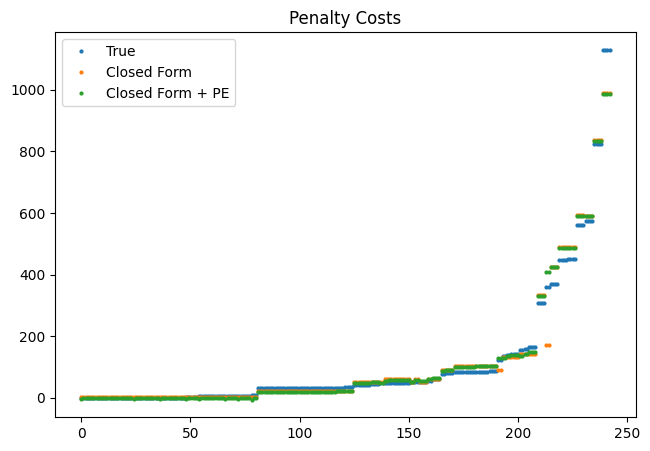

PyObject <matplotlib.legend.Legend object at 0x7f9dda02dc60>

In [1061]:
stateSpace = enumerateStates(N)

trueValues = []
approxValues = []
closedFormValues = []
closedFormValuesPE = []
closedFormValues2 = []
closedFormValues2PE = []

for s in stateSpace
    push!(trueValues, resPE[2][s])
end


p = sortperm(trueValues)
trueValues .= trueValues[p]
stateSpace .= stateSpace[p]

for s in stateSpace
    #push!(approxValues, v(s,N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), resSMARPE["ve"], resSMARPE["vn"]))
    push!(closedFormValues, hPenaltyDCP(s, N, dsp, alpha_r, beta, tau, c1) - (s[3] == 1)*170 - 10*gPenalty*sum(append!([0.0], [1/alpha_r[i] for i in 1:N if dsp[i] == 0 && s[i] != 3 && s[3] != 1])) + 40*prod(s[i] != 1 for i in 1:N))
    push!(closedFormValuesPE, h2[s] - (s[3] == 1)*170 - 10*gPenalty*sum(append!([0.0], [1/alpha_r[i] for i in 1:N if dsp[i] == 0 && s[i] != 3 && s[3] != 1])) + 40*prod(s[i] != 1 for i in 1:N))
    push!(closedFormValues2, hPenaltyDCP_2(s, N, dsp, alpha_r, beta, tau, c1))
    push!(closedFormValues2PE, h3[s])
end

figure(figsize=((3/2)*5, 5))
#gap = mean(trueValues - approxValues)
gapClosed = mean(trueValues - closedFormValues)
gapClosedPE = mean(trueValues - closedFormValuesPE)
gapClosed2 = mean(trueValues[i] - closedFormValues2[i] for i in 1:243 if closedFormValues2[i] != NaN)
gapClosed2PE = mean(trueValues[i] - closedFormValues2PE[i] for i in 1:243 if closedFormValues2PE[i] != NaN)

ptSize = 2
PyPlot.plot(trueValues , "o", label = "True", ms = ptSize)
#PyPlot.plot(approxValues .+ gap, "o", label = "Linear VFA", ms = ptSize)
PyPlot.plot(closedFormValues .+ (gapClosed), "o", label = "Closed Form", ms = ptSize)
PyPlot.plot(closedFormValuesPE .+ (gapClosedPE), "o", label = "Closed Form + PE", ms = ptSize)
#PyPlot.plot(closedFormValues2, "o", label = "Closed Form 2", ms = ptSize)
#PyPlot.plot(closedFormValues2PE, "o", label = "Closed Form 2 + PE", ms = ptSize)
title("Penalty Costs")
legend()
#PyPlot.savefig("vfaVsTrue.pdf", bbox_inches="tight")

In [1054]:
stateSpace[1:75]

75-element Vector{Any}:
 [1, 1, 1, 1, 1]
 [2, 1, 1, 1, 1]
 [1, 1, 1, 1, 2]
 [1, 1, 1, 2, 1]
 [1, 1, 1, 3, 1]
 [2, 1, 1, 1, 2]
 [2, 1, 1, 2, 1]
 [2, 1, 1, 3, 1]
 [1, 1, 1, 2, 2]
 [1, 1, 1, 3, 2]
 [2, 1, 1, 2, 2]
 [2, 1, 1, 3, 2]
 [1, 2, 1, 1, 1]
 ⋮
 [1, 3, 1, 3, 2]
 [2, 3, 1, 2, 2]
 [2, 3, 1, 3, 2]
 [3, 3, 1, 1, 1]
 [3, 3, 1, 1, 2]
 [3, 3, 1, 2, 1]
 [3, 3, 1, 3, 1]
 [3, 3, 1, 2, 2]
 [3, 3, 1, 3, 2]
 [1, 3, 1, 1, 3]
 [2, 3, 1, 1, 3]
 [1, 3, 1, 2, 3]

In [817]:
sum(s[3]!=1 for s in stateSpace[130:200])

71

In [1053]:
dsp

5-element Vector{Int64}:
 0
 0
 1
 1
 0

In [735]:
closedFormValues2

243-element Vector{Any}:
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   ⋮
 489.27721370016206
 489.27721370016206
 505.92240146120406
 505.92240146120406
 588.7560132358993
 588.7560132358993
 612.8790405094234
 612.8790405094234
 611.23434352232
 611.23434352232
 637.7621115504695
 637.7621115504695

In [736]:
trueValues

243-element Vector{Any}:
   0.0
   5.874821838725008e-6
   0.0001593348041417919
   0.0001593348041417919
   0.000458216629627306
   0.000458216629627306
   0.0009395897890601412
   0.0010519812783267857
   0.003977103878603561
   0.003977103878603561
   0.024986290809729472
   0.024986290809729472
   0.029054149501582915
   ⋮
 546.429290786247
 546.429290786247
 565.8192388093388
 565.8192388093388
 645.3055949787287
 645.3055949787287
 674.1794542374532
 674.1794542374532
 749.8687230343406
 749.8687230343406
 787.1117347628423
 787.1117347628423

In [621]:
dsp

5-element Vector{Int64}:
 0
 1
 0
 0
 0

In [623]:
stateSpace[243]

5-element Vector{Int64}:
 3
 3
 3
 3
 3

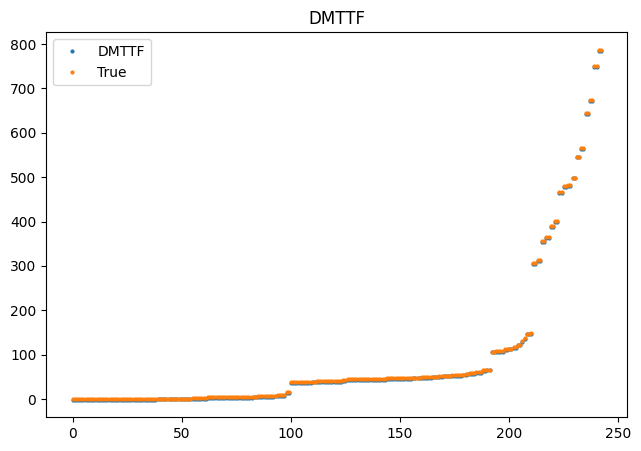

PyObject <matplotlib.legend.Legend object at 0x7f0237f5a350>

In [666]:
stateSpace = enumerateStates(N)

DMTTFValues = []
for s in stateSpace
    push!(DMTTFValues, resPE_DMTTF[2][s])
end

p = sortperm(DMTTFValues)
DMTTFValues .= DMTTFValues[p]
stateSpace .= stateSpace[p]

figure(figsize=((3/2)*5, 5))

ptSize = 2
PyPlot.plot(-604 .* DMTTFValues[243:-1:1] .+ 785 , "o", label = "DMTTF", ms = ptSize)
PyPlot.plot(trueValues , "o", label = "True", ms = ptSize)
title("DMTTF")
legend()
#PyPlot.savefig("vfaVsTrue.pdf", bbox_inches="tight")

In [654]:
stateSpace

243-element Vector{Any}:
 [3, 2, 3, 3, 3]
 [3, 3, 3, 3, 3]
 [3, 2, 3, 2, 3]
 [3, 3, 3, 2, 3]
 [3, 2, 2, 3, 3]
 [3, 3, 2, 3, 3]
 [3, 2, 2, 2, 3]
 [3, 3, 2, 2, 3]
 [2, 2, 3, 3, 3]
 [2, 3, 3, 3, 3]
 [2, 2, 3, 2, 3]
 [2, 3, 3, 2, 3]
 [2, 2, 2, 3, 3]
 ⋮
 [2, 2, 1, 1, 2]
 [2, 3, 1, 1, 2]
 [2, 2, 1, 1, 1]
 [2, 3, 1, 1, 1]
 [2, 1, 1, 1, 2]
 [2, 1, 1, 1, 1]
 [1, 2, 1, 1, 2]
 [1, 3, 1, 1, 2]
 [1, 2, 1, 1, 1]
 [1, 3, 1, 1, 1]
 [1, 1, 1, 1, 2]
 [1, 1, 1, 1, 1]

In [655]:
DMTTFValues

243-element Vector{Any}:
 -1.3023579021109264
 -1.3023579021109264
 -1.24073547928979
 -1.24073547928979
 -1.1154997715654424
 -1.1154997715654424
 -1.0677249788958834
 -1.0677249788958834
 -0.93620654084589
 -0.93620654084589
 -0.9041238622411301
 -0.9041238622411301
 -0.8259483092091049
  ⋮
 -4.134240775782727e-5
 -4.134240775782727e-5
 -6.580530559630038e-6
 -6.580530559630038e-6
 -1.740612053768853e-6
 -1.5546486863970976e-6
 -7.581669039247174e-7
 -7.581669039247174e-7
 -2.636359471286376e-7
 -2.636359471286376e-7
 -9.720501625842815e-9
  0.0

## Usage+Penalty Costs with new VFA

In [442]:
run = 1

N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 100000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

dcp = optDsps[run]
#dcp = fill(1, N)

gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
gup = gp + gu
print("Exact u+p g: ")
println(round(gup, digits = 5))

#find PE of DSP
policy = staticPolicyToDynamicPolicy(N, dcp)
resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, fill(0.0, N), epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE u+p g: ")
println(round(resPE[1], digits = 5))

print("PE Iterations: ")
println(resPE[3])

#find DMTTF function
#resPE_DMTTF = rpe_dmttf(N, policy, alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
#print("Availability: ")
#println(round(resPE_DMTTF[1], digits = 5))

#print("PE Iterations: ")
#println(resPE_DMTTF[3])



---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
Exact u+p g: 0.42082
PE u+p g: 0.42082
PE Iterations: 1601


In [443]:
nMaxSmarpe = 1000000

mcp = Array{Any}(nothing, N)
for i in 1:N
    if dcp[i] == 1
        mcp[i] = -1
    else
        mcp[i] = alpha_r[i]/10
    end
end


#find smarpe vfa of dsp
probParams = problemParams()
probParams.N = N 
probParams.alpha = alpha_r
probParams.beta = beta
probParams.tau = tau
probParams.c = c0
probParams.p = c1
probParams.r = fill(0.0, N)

hUAggVec = append!([0.0], constructAggUsageH(N, alpha_r, beta, tau, c0, gu))


features = [one, penaltyFeature, costFeature]
params = [0.0, 0.0, 0.0]

# features = [penaltyFeature, costFeature]
# params = [0.0, 0.0]

for i in 1:N
    if dcp[i] == 0
        append!(features, [indicator(i,1), indicator(i,2)])
        append!(params, [0.0, 0.0])
    else
        append!(features, [indicator(i,2), indicator(i, 3)])
        append!(params, [0.0, 0.0])
    end
end


stepsizes = fill(1.0, length(params))

Random.seed!(12345)
resSMARPE = smarpeVFA_UP_DCP(probParams, nMaxSmarpe, mcp; hUAggVec = hUAggVec, params = params, features = features, stepsizes = stepsizes, vfaProvided = true, gu = gu, gp = gp, s = [1 + 2*(1 - dcp[i]) for i in 1:N], stateTrace = [], printProgress = false, modCounter = 100000, printStates = false, rate = 0.1)
#ve = resSMARPE["ve"]
#vn = resSMARPE["vn"]
println("SMARPE Complete")

#end frame
println(join(fill("-",LEN_FRAME)))

SMARPE Complete
---------------------------------------------------------------------------


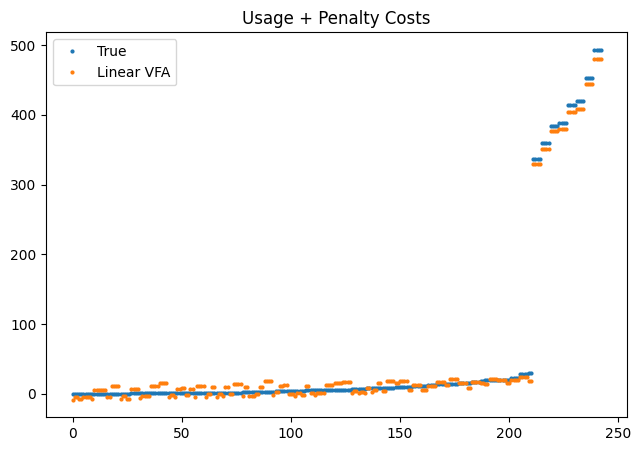

PyObject <matplotlib.legend.Legend object at 0x7fb6ff5f46a0>

In [444]:
stateSpace = enumerateStates(N)

trueValues = []
approxValues = []

for s in stateSpace
    push!(trueValues, resPE[2][s])
end


p = sortperm(trueValues)
trueValues .= trueValues[p]
stateSpace .= stateSpace[p]

for s in stateSpace
    used = calculateUsedOrdered(s, N)
    featureIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
    push!(approxValues, hUP(featureIn, params, features))
end

figure(figsize=((3/2)*5, 5))
gap = mean(trueValues - approxValues)

ptSize = 2
PyPlot.plot(trueValues , "o", label = "True", ms = ptSize)
PyPlot.plot(approxValues .+ gap, "o", label = "Linear VFA", ms = ptSize)
title("Usage + Penalty Costs")
legend()
#PyPlot.savefig("vfaVsTrue.pdf", bbox_inches="tight")

In [393]:
dcp

5-element Vector{Int64}:
 0
 0
 1
 0
 0

In [244]:
stateSpace[1:130]

130-element Vector{Any}:
 [1, 1, 1, 1, 1]
 [1, 1, 1, 2, 1]
 [1, 1, 1, 3, 1]
 [1, 1, 2, 1, 1]
 [1, 1, 3, 1, 1]
 [1, 1, 2, 2, 1]
 [1, 1, 3, 2, 1]
 [1, 1, 2, 3, 1]
 [1, 1, 3, 3, 1]
 [1, 1, 1, 1, 2]
 [1, 1, 1, 2, 2]
 [1, 1, 1, 3, 2]
 [1, 1, 2, 1, 2]
 ⋮
 [1, 2, 3, 2, 2]
 [1, 2, 2, 3, 2]
 [1, 2, 3, 3, 2]
 [2, 2, 2, 1, 3]
 [2, 2, 3, 1, 3]
 [1, 2, 2, 2, 3]
 [1, 2, 3, 2, 3]
 [1, 2, 2, 3, 3]
 [1, 2, 3, 3, 3]
 [3, 2, 1, 1, 1]
 [3, 2, 1, 2, 1]
 [3, 2, 1, 3, 1]

In [201]:
stateSpace[150:200]

51-element Vector{Any}:
 [1, 3, 2, 1, 1]
 [1, 3, 3, 1, 1]
 [1, 3, 2, 2, 1]
 [1, 3, 3, 2, 1]
 [1, 3, 2, 3, 1]
 [1, 3, 3, 3, 1]
 [1, 3, 1, 1, 2]
 [2, 3, 1, 1, 1]
 [1, 3, 1, 2, 2]
 [1, 3, 1, 3, 2]
 [2, 3, 1, 2, 1]
 [2, 3, 1, 3, 1]
 [1, 3, 2, 1, 2]
 ⋮
 [1, 3, 2, 2, 3]
 [1, 3, 3, 2, 3]
 [1, 3, 2, 3, 3]
 [1, 3, 3, 3, 3]
 [3, 3, 1, 1, 1]
 [3, 3, 1, 2, 1]
 [3, 3, 1, 3, 1]
 [3, 3, 2, 1, 1]
 [3, 3, 3, 1, 1]
 [3, 3, 1, 1, 2]
 [3, 3, 2, 2, 1]
 [3, 3, 3, 2, 1]

In [387]:
hUAggVec

6-element Vector{Float64}:
  0.0
 -8.494366634970952
 -7.8255877078782525
 -7.318712330050823
 -7.2525085574004375
 -7.737092997925247

In [423]:
params

13-element Vector{Float64}:
  605.4149029644988
   39.95769908972477
 -579.103724869525
  278.620686869127
 -237.61374430766804
  -99.20481147596011
  -56.54433930111483
   15.990144817624218
   15.679895653742058
  -17.262185816479093
  -17.297589329652
   -6.427996143960788
   -6.434979807598869

In [344]:
stepsizes

3-element Vector{Float64}:
 1.1632546469115938e-5
 7.124435388495458e-5
 4.556369120575194e-5

# Experiment 10

Redo Experiment 7 and 8 using the full action space 

In [239]:
Random.seed!(12345)
numRuns = 1000
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
TAU_MAX = 1.0
C0_MAX = 1.0
C1_MAX = 1000
R_MAX = 100
nMax = 50000
delScale = 1

taus_FAS = []
alphas_FAS = []
c0s_FAS = []
c1s_FAS = []
rs_FAS = []

rviGs_FAS = []
optDsps_FAS = []
optDspGs_FAS = []
heurDsps_FAS = []
heurDspGs_FAS = []
optPiGs_FAS = []
heurPiGs_FAS = []
optGaps_FAS = []
heurGaps_FAS = []

rviIter = []
rviPEIter = []
rpeIter = []
rpiIter = []
for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #generate parameters
    tau = rand(N).*TAU_MAX #
    print("tau: ")
    println([round(tau[i], digits = 5) for i in 1:N])
    push!(taus_FAS, tau)

    alpha_r = [sampleTruncExp(minimum(tau)/2, minimum(tau)) for i in 1:N]
    print("alpha_r: ")
    println([round(alpha_r[i], digits = 5) for i in 1:N])
    push!(alphas_FAS, alpha_r)

    c0 = rand(N).*C0_MAX
    c0 = sort(c0)
    print("c0: ")
    println([round(c0[i], digits = 5) for i in 1:N])
    push!(c0s_FAS, c0)

    c1 = C0_MAX + rand()*(C1_MAX - C0_MAX)
    print("c1: ")
    println(round(c1, digits = 5))
    push!(c1s_FAS, c1)

    r = rand(N).*R_MAX
    print("r: ")
    println([round(r[i], digits = 5) for i in 1:N])
    push!(rs_FAS, r)

    #find true optimal solution
    resRVI= rvi(N, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")

    #evaluate true optimal solution
    resRVI_PE = rpe(N, resRVI[4], alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000)
    push!(rviGs_FAS, resRVI_PE[1])
    print("RVI: ")
    print(round(resRVI_PE[1], digits = 5))
    print(" (RVI Iterations: ")
    print(resRVI[3])
    print(", PE Iterations: ")
    print(resRVI_PE[3])
    println(")    ")

    push!(rviIter, resRVI[3])
    push!(rviPEIter, resRVI_PE[3])

    #find best DSP solution
    dsps = enumerateActions(N)
    bestDSP = dsps[1]
    bestDSP_G = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, bestDSP)
    for i in 2:(2^N)
        thisDSP = dsps[i]
        thisDSP_G = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, thisDSP)
        if thisDSP_G < bestDSP_G
            bestDSP = thisDSP
            bestDSP_G = thisDSP_G
        end
    end
    push!(optDsps_FAS, bestDSP)
    push!(optDspGs_FAS, bestDSP_G)
    print("Optimal DSP: ")
    print(bestDSP)
    print(" ")
    print(round(bestDSP_G, digits = 5))
    print(",    ")

    #find PE of best DSP
    policy = staticPolicyToDynamicPolicy(N, bestDSP)
    resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000)
    print("PE Iterations: ")
    print(resPE[3])
    print(",   ")
    push!(rpeIter, resPE[3])

    #do PI on best DSP
    resPI = rpiExact(N, resPE[2], alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000, actionType = "full")
    push!(optPiGs_FAS, resPI[1])
    print("PIH: ")
    print(round(resPI[1], digits = 5))
    print(" (Iterations: ")
    print(resPI[3])
    println(").")
    push!(rpiIter, resPI[3])
    
    #Print optimality gap
    print("Optimality Gap: ")
    gap = (resPI[1]/resRVI_PE[1] - 1)*100
    push!(optGaps_FAS, gap)
    print(round(gap, digits = 2))
    println("%.")

    #find heuristic DSP solution
    heurDsp, heurDspG, counter = jointHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    push!(heurDsps_FAS, heurDsp)
    push!(heurDspGs_FAS, heurDspG)
    if heurDsp == bestDSP
        println("Heuristic DSP same as Optimal DSP.")
        push!(heurGaps_FAS, gap)
        push!(heurPiGs_FAS, resPI[1])
    else
        #print heuristic DSP and g
        print("Heuristic DSP: ")
        print(heurDsp)
        print(" ")
        print(round(heurDspG, digits = 5))

        #find PE of heuristic DSP
        policy = staticPolicyToDynamicPolicy(N, heurDsp)
        resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000)
        print("PE Iterations: ")
        print(resPE[3])
        print("),   ")

        #do PI on heuristic DSP
        resPI = rpiExact(N, resPE[2], alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000, actionType = "full")
        push!(heurPiGs_FAS, resPI[1])
        print("PIH: ")
        print(round(resPI[1], digits = 5))
        print(" (Iterations: ")
        print(resPI[3])
        println(").")

        #Print optimality gap
        print("Optimality Gap: ")
        gap = (resPI[1]/resRVI_PE[1] - 1)*100
        push!(heurGaps_FAS, gap)
        print(round(gap, digits = 2))
        println("%.")
    end
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.94479, 0.86689, 0.33961, 0.13612, 0.3225]
alpha_r: [0.00897, 0.03694, 0.05989, 0.03663, 0.07371]
c0: [0.09261, 0.11849, 0.26755, 0.81049, 0.86815]
c1: 853.419
r: [99.56147, 82.00052, 83.44631, 73.46937, 38.36129]
RVI: 4.70822 (RVI Iterations: 1464, PE Iterations: 1404)    
Optimal DSP: [1, 1, 0, 0, 0] 4.70822,    PE Iterations: 1601,   PIH: 4.70822 (Iterations: 1541).
Optimality Gap: 0.0%.
Heuristic DSP same as Optimal DSP.
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.90261, 0.3308, 0.13162, 0.17352, 0.13883]
alpha_r: [0.03063, 0.04597, 0.00777, 0.00274, 0.01401]
c0: [0.03106, 0.47503, 0.63385, 0.86866, 0.89995]
c1: 886.40529
r: [2.29172, 74.74304, 92.61106, 24.71874, 49.33693]
RVI: 0.94362 (RVI Iterations: 4813, PE Iterations: 4939)    
Optimal DSP: [1, 0, 0, 1, 0] 0.97105,  

Excessive output truncated after 524290 bytes.

0.45608 (Iterations: 14674).
Optimality Gap: 0.0%.
Heuristic DSP same as Optimal DSP.
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 878
tau: [0.01919, 0.67638, 0.0259, 0.95214, 0.63597]
alpha_r: [0.00511, 0.01276, 0.00181, 0.0052, 0.00122]
c0: 

In [240]:
resultExp10 = Dict()
resultExp10["taus_FAS"] = taus_FAS
resultExp10["alphas_FAS"] = alphas_FAS
resultExp10["c0s_FAS"] = c0s_FAS 
resultExp10["c1s_FAS"] = c1s_FAS
resultExp10["rs_FAS"] = rs_FAS

resultExp10["rviGs_FAS"] = rviGs_FAS
resultExp10["optDsps_FAS"] = optDsps_FAS
resultExp10["optDspGs_FAS"] = optDspGs_FAS
resultExp10["heurDsps_FAS"] = heurDsps_FAS
resultExp10["heurDspGs_FAS"] = heurDspGs_FAS
resultExp10["optPiGs_FAS"] = optPiGs_FAS
resultExp10["heurPiGs_FAS"] = heurPiGs_FAS
resultExp10["optGaps_FAS"] = optGaps_FAS
resultExp10["heurGaps_FAS"] = heurGaps_FAS

resultExp10["rviIter"] = rviIter
resultExp10["rviPEIter"] = rviPEIter
resultExp10["rpeIter"] = rpeIter
resultExp10["rpiIter"] = rpiIter

f = serialize("resultExp10_update.big", resultExp10)

In [134]:
resultExp10 = deserialize("resultExp10_update.big")

Dict{Any, Any} with 18 entries:
  "taus_FAS"      => Any[[0.944791, 0.866895, 0.339612, 0.136117, 0.322501], [0…
  "rviIter"       => Any[1464, 4813, 4527, 904, 3246, 2546, 10362, 885, 6902, 5…
  "c0s_FAS"       => Any[[0.0926115, 0.118489, 0.26755, 0.810495, 0.868154], [0…
  "optDspGs_FAS"  => Any[4.70822, 0.97105, 0.615976, 10.982, 0.551766, 1.64594,…
  "optDsps_FAS"   => Any[[1, 1, 0, 0, 0], [1, 0, 0, 1, 0], [0, 1, 1, 0, 0], [1,…
  "rs_FAS"        => Any[[99.5615, 82.0005, 83.4463, 73.4694, 38.3613], [2.2917…
  "heurPiGs_FAS"  => Any[4.70822, 0.94362, 0.589639, 9.17702, 0.551766, 1.64594…
  "rpiIter"       => Any[1541, 4939, 4439, 867, 2952, 2335, 10365, 800, 6109, 4…
  "heurDsps_FAS"  => Any[[1, 1, 0, 0, 0], [1, 0, 0, 1, 0], [0, 1, 1, 0, 0], [1,…
  "heurGaps_FAS"  => Any[1.61204e-11, 0.0, 0.0, 5.41783, -6.53178e-10, 0.000438…
  "optGaps_FAS"   => Any[1.61204e-11, 0.0, 0.0, 5.41783, -6.53178e-10, 0.000438…
  "alphas_FAS"    => Any[[0.00897018, 0.0369358, 0.059888, 0.0366322, 0.07370

In [248]:
sum(i == 50000 for i in rpiIter)

46

In [242]:
dcpGs = resultExp10["optDspGs_FAS"]
piGs = resultExp10["optPiGs_FAS"]
improvement = 100*( (dcpGs - piGs)./dcpGs )

1000-element Vector{Float64}:
  5.86606130198773e-9
  2.824772039890423
  4.275726384191076
 16.435602350109217
 -6.232215287781644e-8
 -1.4190254379304646e-8
  1.9496960792272995
  8.411152336055688
  1.2165235045280103
  9.885681297959417
  0.5753539348115912
 15.435675647118217
  0.1720925376625406
  ⋮
  0.9508656434499505
 24.605963626804943
 29.40131034884533
  0.7018238590544333
 -2.33838640884831e-8
  3.683589676034
  1.3998476035815162
  0.6437981268745513
 29.82596999405269
  1.9580268829197696
  0.005307549940446821
  8.590338305916694

In [249]:
mean(improvement)

7.8690912655828145

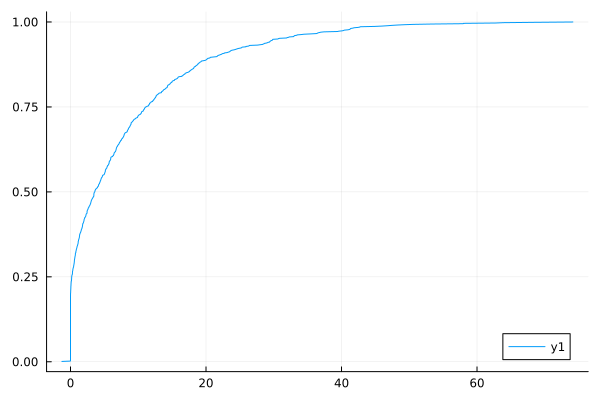

In [250]:
StatsPlots.plot(sort(improvement),(1:1000)./1000)

In [252]:
succImp = [i for i in improvement if i >= 0]

937-element Vector{Float64}:
  5.86606130198773e-9
  2.824772039890423
  4.275726384191076
 16.435602350109217
  1.9496960792272995
  8.411152336055688
  1.2165235045280103
  9.885681297959417
  0.5753539348115912
 15.435675647118217
  0.1720925376625406
 33.07824365444486
 14.351108622888011
  ⋮
  0.27092788046041066
  0.9508656434499505
 24.605963626804943
 29.40131034884533
  0.7018238590544333
  3.683589676034
  1.3998476035815162
  0.6437981268745513
 29.82596999405269
  1.9580268829197696
  0.005307549940446821
  8.590338305916694

In [253]:
badImp = [i for i in improvement if i <= 0]

63-element Vector{Float64}:
 -6.232215287781644e-8
 -1.4190254379304646e-8
 -4.78535208774333e-8
 -5.691628501987761e-9
 -5.0438214923653536e-8
 -1.7042509229304436e-8
 -1.2296802062186545e-7
 -1.8224028323281527e-8
 -7.1132070124203e-8
 -2.9434646888775682e-8
 -7.92391521146717e-9
 -2.093357670364027e-9
 -1.0656901958708243e-8
  ⋮
 -3.220627289255502e-8
 -6.802210070377426e-9
 -2.053148979283928e-8
 -7.694752810303479e-9
 -2.5610683092639026e-9
 -5.906528353116976e-8
 -7.189143684632252e-9
 -4.844114580466275e-9
 -6.854750060670926e-9
 -5.3369934347275e-9
 -7.2084494647792196e-9
 -2.33838640884831e-8

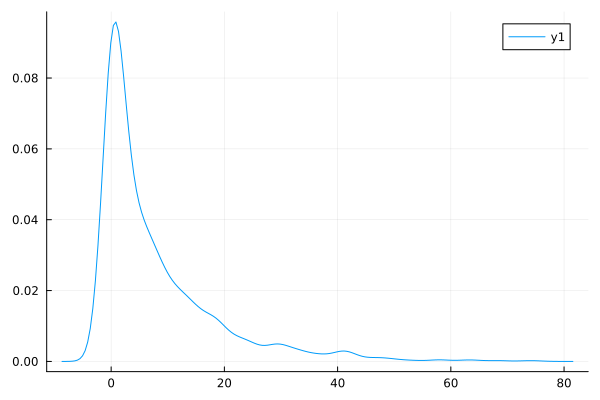

In [254]:
density(improvement)

In [256]:
minimum(badImp)

-1.2700246477617134

## Experiment 11

In [587]:
exactPIGFromVFA_FAS = []
exactPIFromVFA_gap_FAS = []
resRpis_FAS = []

epsilon = 1e-10
delScale = 1
nMax = 50000
for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    print("RVI: ")
    print(round(rviGs[run], digits = 5))

    #print exact heuristic result
    print(", Exact PI Heuristic: ")
    print(round(optPiGs[run], digits = 5))

    print(", Gap: ")
    println(round(optGaps[run], digits = 2))

    ve = ves[run]
    vn = vns[run]
    h = hFromNewVFA(ve, vn, N,alpha_d, alpha_r, beta, tau, c0, c1, r)
    resRpi = rpiExact(N, h, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")
    g = resRpi[1]
    print("Approx PI Heuristic: ")
    print(round(g, digits = 5))

    gap = (g/rviGs_FAS[run] - 1.0)*100.0
    push!(exactPIFromVFA_gap_FAS, gap)
    print(", Optimality Gap: ")
    println(round(gap, digits = 2))
    push!(exactPIGFromVFA_FAS, resRpi[1])
    push!(resRpis_FAS, resRpi)
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
RVI: 4.70822, Exact PI Heuristic: 4.70822, Gap: -0.0
Approx PI Heuristic: 4.70822, Optimality Gap: 0.0
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.007767668179646831, 0.002744059925049017, 0.01

Excessive output truncated after 524293 bytes.

1.01224, Optimality Gap: -1.23
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 732
tau: [0.6910561670985239, 0.8691441341453169, 0.28032350539167294, 0.6755484860658209, 0.8743258801674478]
alpha: [0.12404115066773745, 0.19500620903442237, 0.03618455131722486, 0.07439460309819045, 0.016477262727263374]
c0: [0.3367955299163383, 0.4477289997472347, 0.5610815201104473, 0.7862879516033425, 0.9197445477831403]
c1: 871.9678063771609
r: [95.24834582124345, 33.86490904922228, 57.38992027927012, 

In [599]:
for run in 1:numRuns
    exactPIFromVFA_gap_FAS[run] = (exactPIGFromVFA_FAS[run]/rviGs_FAS[run] - 1)*100
end

In [600]:
resultExp11 = Dict()
resultExp11["exactPIGFromVFA_FAS"] = exactPIGFromVFA_FAS
resultExp11["exactPIFromVFA_gap_FAS"] = exactPIFromVFA_gap_FAS
resultExp11["resRpis_FAS"] = resRpis_FAS

f = serialize("resultExp11.big", resultExp11)

In [659]:
resultExp11 = deserialize("resultExp11.big")

Dict{Any, Any} with 3 entries:
  "exactPIGFromVFA_FAS"    => Any[4.70822, 0.97105, 0.589835, 8.82121, 0.551766…
  "exactPIFromVFA_gap_FAS" => Any[3.58824e-11, 2.90688, 0.0333175, 1.33058, -1.…
  "resRpis_FAS"            => Any[(4.70822, Dict{Any, Any}([3, 3, 1, 3, 3]=>218…

In [660]:
exactPIGFromVFA_FAS = resultExp11["exactPIGFromVFA_FAS"]
exactPIFromVFA_gap_FAS = resultExp11["exactPIFromVFA_gap_FAS"]

1000-element Vector{Any}:
  3.588240815588506e-11
  2.9068848934637126
  0.0333175089707094
  1.3305808386019802
 -1.8284889935493709e-6
  0.00043608902702274577
  2.220446049250313e-13
 -2.8976820942716586e-12
  0.03405068683599577
  0.8245309096063691
  0.037170704604894134
 28.636322845056327
  5.744917921379766e-5
  ⋮
  0.0
  2.4424906541753444e-13
  8.762187419295287
  0.00023464836138575862
 -6.06914783984891e-6
 12.304190604086829
  0.1470215908315975
  0.6479697403590778
  4.243272400117348e-11
 -3.9968028886505635e-13
  0.005307793772679759
  1.4654943925052066e-12

In [189]:
optDspGs = resultExp10["optDspGs_FAS"]
vfaImp = 100*( (optDspGs - exactPIGFromVFA_FAS)./optDspGs )

1000-element Vector{Float64}:
  5.846291389412493e-9
  1.8129069025087056e-8
  4.2438334407419775
 19.67555338955179
  6.449287432741529e-8
 -9.894447692788105e-7
  1.9496960792272373
 13.423295588623704
  1.1907671195769682
 19.78187317108603
  0.550102951671923
 -8.428957249359488
  0.17203075309207302
  ⋮
  0.9508656434499505
 24.60596362702349
 23.21532084604453
  0.701562831284114
  2.325852934961634e-8
  3.6835896760543894
  1.6878347181453721
  3.5508827873502976e-9
 29.825969994082378
  1.9580268829201597
  3.7986766881846e-8
  8.59033830593189

In [190]:
mean(vfaImp)

5.545291402128639

In [658]:
dspGaps = [(optDspGs[i]/rviGs[i] - 1)*100 for i in 1:1000]

1000-element Vector{Float64}:
  5.882161424608512e-9
  2.906884912119767
  4.466710712636779
 26.151607778921694
 -6.297532495480596e-8
  0.00043825658349039287
  1.9884651053878377
 15.50451207387027
  1.2395982639587855
 25.687964672062
  0.59052228526284
 18.636502746228455
  0.17238937315053882
  ⋮
  0.9599938955822562
 32.63648533857149
 41.64568845983456
  0.7067844386892785
 -2.3404223004064306e-8
 16.59922771869171
  1.866357336059643
  0.6479697439329746
 42.50286037664803
  1.9971312496755989
  0.005307831656264916
  9.39762618822908

In [744]:
mean(optGaps_FAS[i] < 1e-2 for i in 1:1000)

0.524

In [764]:
mean(dspGaps[i] < 1e-2 for i in 1:1000)

0.173

In [592]:
mean(optGaps_FAS)

1.3785583639770735

In [765]:
mean(dspGaps)

12.490127169785017

In [593]:
median(optGaps_FAS)

0.005911872321273659

In [766]:
median(dspGaps)

4.627495156466299

In [768]:
quantile(optGaps_FAS, 0.9)

4.498998444625582

In [767]:
quantile(dspGaps, 0.9)

31.949286822138617

In [606]:
quantile(optGaps_FAS, 0.99)

21.73081866793912

In [769]:
quantile(dspGaps, 0.99)

95.72587814407996

In [770]:
maximum(optGaps_FAS)

42.83074769222086

In [771]:
maximum(dspGaps)

333.4094211222235

In [781]:
sum(gap > 42.83 for gap in exactPIFromVFA_gap_FAS)

10

In [782]:
[i for i in 1:1000 if dspGaps[i] > 300]

1-element Vector{Int64}:
 984

In [783]:
exactPIFromVFA_gap_FAS[984]

344.17773434186074

In [747]:
mean(gap < 0.01 for gap in exactPIFromVFA_gap_FAS)

0.358

In [603]:
mean(exactPIFromVFA_gap_FAS)

4.1861161902709085

In [604]:
median(exactPIFromVFA_gap_FAS)

0.12971059818376318

In [608]:
quantile(exactPIFromVFA_gap_FAS, 0.9)

8.292287859893522

In [609]:
quantile(exactPIFromVFA_gap_FAS, 0.99)

42.13691088542402

In [780]:
maximum(exactPIFromVFA_gap_FAS)

699.8178538990456

In [641]:
sum(optPiGs_FAS[i] - optDspGs[i] > 1e-10 for i in 1:numRuns)

63

In [640]:
sum(exactPIGFromVFA_FAS[i] - optDspGs[i] > 1e-10 for i in 1:numRuns)

80

In [639]:
[exactPIGFromVFA_FAS[i] - optDspGs[i] for i in 1:numRuns if exactPIGFromVFA_FAS[i] - optDspGs[i] > 1e-5 ]

49-element Vector{Float64}:
 0.08252663442420849
 1.1448216125450916
 3.258650075055325e-5
 2.0983678497545633
 1.8289222474962266
 0.0032832412172382197
 0.1978669823109621
 0.00108499081141894
 0.10383908339682135
 2.326066561796946
 0.03304250576636508
 0.40336073986490506
 0.007432279918634155
 ⋮
 1.5212769983666785
 0.20936978764510616
 0.1427008417793756
 0.12732507825655237
 0.8088630155683307
 0.11525843663075208
 0.17637718463934116
 0.017894177997775984
 0.26638290944635745
 0.02095957435279594
 2.6365049094360025
 0.01590229774145957

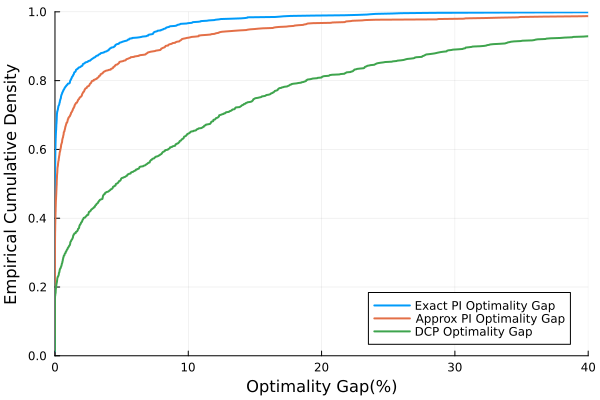

In [661]:
StatsPlots.plot(sort(optGaps), (1:1000)./1000, label = "Exact PI Optimality Gap", ylim = (0,1), xlabel = "Optimality Gap(%)", ylabel = "Empirical Cumulative Density", linewidth = 2, size = (600,400))
StatsPlots.plot!(sort(exactPIFromVFA_gap_FAS),(1:1000)./1000, label = "Approx PI Optimality Gap", xlim = (0,40), linewidth = 2)
StatsPlots.plot!(sort(dspGaps), (1:1000)./1000, label = "DCP Optimality Gap", linewidth = 2)
#StatsPlots.savefig("threeDensities.pdf")

## Experiment 12

In [1364]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
LEN_FRAME = 75
nMaxSmarpe = 1000000
numRuns = 1000

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

featuresList = []
paramsList = []
for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    #prepare smarpe

    sStart = fill(1, N)
    #sStart = [1 + 2*(1 - dcp[i]) for i in 1:N]

    #create mcp
    dcp = optDsps[run]

    mcp = Array{Any}(nothing, N)
    for i in 1:N
        if dcp[i] == 1
            mcp[i] = -1
        else
            mcp[i] = alpha_r[i]/1000
        end
    end


    #construct problemParams struct
    probParams = problemParams()
    probParams.N = N 
    probParams.alpha = alpha_r
    probParams.beta = beta
    probParams.tau = tau
    probParams.c = c0
    probParams.p = c1
    probParams.r = fill(0.0, N)

    #precalculate FA usage costs
    hUAggVec = append!([0.0], constructAggUsageH(N, alpha_r, beta, tau, c0, gu))
    
    gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)

    #create lists of features and parameters
    features = []
    push!(features, one)

    # for i in 1:N
    #     if dcp[i] == 0
    #         append!(features, [negIndicator(i, 3)])
    #         append!(params, [0.0])
    #     else
    #         append!(features, [negIndicator(i, 1)])
    #         append!(params, [0.0])
    #     end
    # end

    for i in 1:N
        append!(features, [indicator(i,1), indicator(i,2), indicator(i, 3)])
    end 

    append!(features, [usedIndictor(i) for i in 1:(N+1)])

    params = fill(0.0, length(features))
    stepsizes = fill(1.0, length(features))

    #perform SMARPE
    Random.seed!(12345)
    resSMARPE = smarpeVFA_UP_MCP(probParams, nMaxSmarpe, mcp; hUAggVec = hUAggVec, params = params, features = features, stepsizes = stepsizes, vfaProvided = true, gu = gu, gp = gp, s = copy(sStart), stateTrace = [], printProgress = false, modCounter = 100000, printStates = false, rate = 0.1)
    println("SMARPE Complete")

    push!(featuresList, features)
    push!(paramsList, params)
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
SMARPE Complete
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.007767668179646831, 0.002744059925049017, 0.014014082661568152]
c0: [0.031060918612698662, 0.47502901483951, 0.6338479453532103, 0.86

Excessive output truncated after 524303 bytes.

SMARPE Complete
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 835
tau: [0.06884410278667707, 0.21742775709110063,

In [1365]:
resultExp12_VFAs = Dict()
resultExp12_VFAs["features"] = featuresList
resultExp12_VFAs["params"] = paramsList

f = serialize("resultExp12_VFAs_0.1.dat", resultExp12_VFAs)

In [1366]:
exactPIGFromVFA_FAS_12 = []
exactPIFromVFA_gap_FAS_12 = []
resRpis_FAS_12 = []

epsilon = 1e-10
delScale = 1
nMax = 50000
alpha_d = fill(0.0, N)
stateSpace = enumerateStates(N)

for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    print("RVI: ")
    print(round(rviGs[run], digits = 5))

    #print exact heuristic result
    print(", Exact PI Heuristic: ")
    print(round(optPiGs[run], digits = 5))

    print(", Gap: ")
    println(round(optGaps[run], digits = 2))

    #print dcp g 
    print("DCP g: ")
    println(round(optDspGs[run], digits = 5))

    #prepare hUAggVec, gu, gp
    dcp = optDsps[run]
    gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
    hUAggVec = append!([0.0], constructAggUsageH(N, alpha_r, beta, tau, c0, gu))
    
    #construct h table
    h = Dict()
    for s in stateSpace
        used = calculateUsedOrdered(s, N)
        featureIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
        h[s] = hUP(featureIn, paramsList[run], featuresList[run]) + hRepairDCP(s, N, dcp, alpha_r, beta, tau, r)
    end

    #Evaluate API policy
    resRpi = rpiExact(N, h, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")
    g = resRpi[1]
    print("Approx PI Heuristic: ")
    print(round(g, digits = 5))

    gap = (g/rviGs[run] - 1.0)*100.0
    push!(exactPIFromVFA_gap_FAS_12, gap)
    print(", Optimality Gap: ")
    println(round(gap, digits = 2))
    push!(exactPIGFromVFA_FAS_12, resRpi[1])
    push!(resRpis_FAS_12, resRpi)
    
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
RVI: 4.70822, Exact PI Heuristic: 4.70822, Gap: 0.0
DCP g: 4.70822
Approx PI Heuristic: 4.70822, Optimality Gap: 0.0
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.007767668179646831, 0.0027440599

Excessive output truncated after 524305 bytes.

Approx PI Heuristic: 1.07582, Optimality Gap: 0.0
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 718
tau: [0.9800718526973807, 0.8132808340033919, 0.1878892025608292, 0.5590363975187868, 0.6986331136426668]
alpha: [0.003171986419168546, 0.05850547833952775, 0.021869538801463338, 0.056931473699977315, 0.024027733750935382]
c0: [0.08686614756076982, 0.11748412388094054,

In [1367]:
resultExp12_PI = Dict()
resultExp12_PI["exactPIGFromVFA_FAS_12"] = exactPIGFromVFA_FAS_12 
resultExp12_PI["exactPIFromVFA_gap_FAS_12"] = exactPIFromVFA_gap_FAS_12 
resultExp12_PI["resRpis_FAS_12"] = resRpis_FAS_12 

f = serialize("resultExp12_PI_0.1.dat", resultExp12_PI)

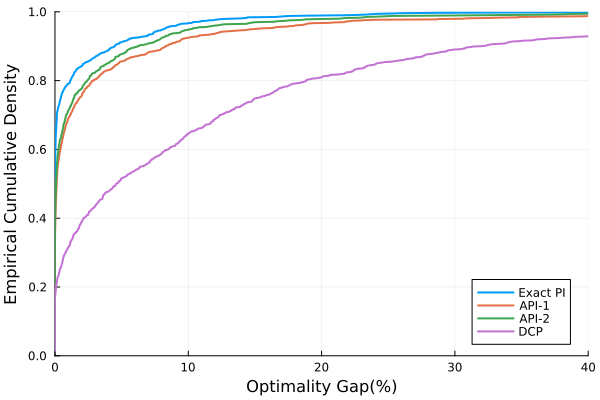

In [1375]:
StatsPlots.plot(sort(optGaps), (1:1000)./1000, label = "Exact PI", ylim = (0,1), xlabel = "Optimality Gap(%)", ylabel = "Empirical Cumulative Density", linewidth = 2, size = (600,400))
StatsPlots.plot!(sort(exactPIFromVFA_gap_FAS),(1:1000)./1000, label = "API-1", xlim = (0,40), linewidth = 2)
StatsPlots.plot!(sort(exactPIFromVFA_gap_FAS_12),(1:1000)./1000, label = "API-2", linewidth = 2)
StatsPlots.plot!(sort(dspGaps), (1:1000)./1000, label = "DCP", linewidth = 2)

In [1376]:
piPower = 100 .* ((optDspGs - exactPIGFromVFA_FAS_12) ./ optDspGs)

1000-element Vector{Float64}:
  5.846291389412493e-9
  1.8129069025087056e-8
  4.2438334407419775
 17.45020215962884
 -6.094434980351969e-8
  1.42666102578899e-8
  1.949696079191789
 13.423295588623704
  1.1907671199625307
 -4.7977123421723045
  0.5699807945611349
  3.4396225130027704
  0.1720307520445817
  ⋮
  0.9508656434499505
 24.605963626910018
 23.21532084604453
  0.7015628311912087
 -2.3014338207721194e-8
  3.6835896760543894
  1.6878347181273925
  3.5471177013422525e-9
 29.825969994082413
  1.9580268829201597
  3.7986766881846e-8
  8.590338305927004

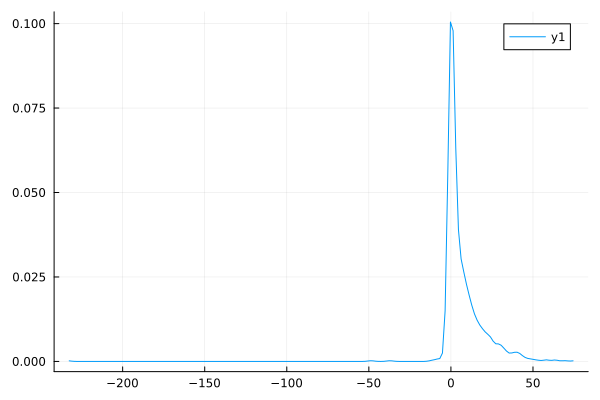

In [1399]:
density(piPower, trim = true)

In [1385]:
sum(p < - 0.01 for p in piPower)

14

In [1386]:
mean(piPower)

6.959677368572239

In [1391]:
piPowerSucc = [p for p in piPower if p > 0.0]

956-element Vector{Float64}:
  5.846291389412493e-9
  1.8129069025087056e-8
  4.2438334407419775
 17.45020215962884
  1.42666102578899e-8
  1.949696079191789
 13.423295588623704
  1.1907671199625307
  0.5699807945611349
  3.4396225130027704
  0.1720307520445817
 33.28509814343098
  9.754581504549819
  ⋮
  1.0536251029619457e-8
  0.9508656434499505
 24.605963626910018
 23.21532084604453
  0.7015628311912087
  3.6835896760543894
  1.6878347181273925
  3.5471177013422525e-9
 29.825969994082413
  1.9580268829201597
  3.7986766881846e-8
  8.590338305927004

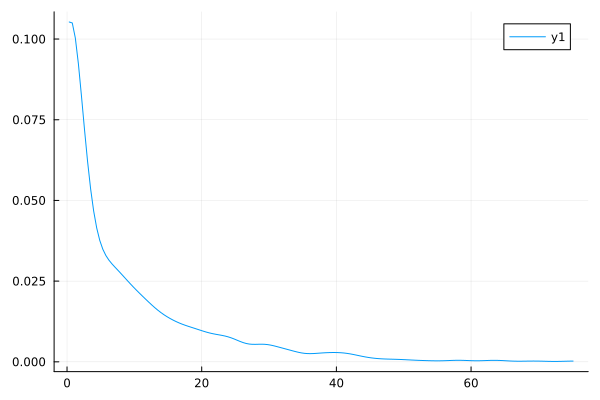

In [1401]:
density(piPowerSucc, trim = true)

In [1390]:
mean(piPowerSucc)

10.640265935594343

In [1395]:
piPowerWithoutOptDCPs = [piPower[i] for i in 1:1000 if dspGaps[i] > 0.01]

827-element Vector{Float64}:
  1.8129069025087056e-8
  4.2438334407419775
 17.45020215962884
  1.949696079191789
 13.423295588623704
  1.1907671199625307
 -4.7977123421723045
  0.5699807945611349
  3.4396225130027704
  0.1720307520445817
 33.28509814343098
  9.754581504549819
  7.212986166425832
  ⋮
 48.52942451153698
  1.0536251029619457e-8
  0.9508656434499505
 24.605963626910018
 23.21532084604453
  0.7015628311912087
  3.6835896760543894
  1.6878347181273925
  3.5471177013422525e-9
 29.825969994082413
  1.9580268829201597
  8.590338305927004

In [1394]:
mean(piPowerWithoutOptimalDCPs)

8.418769010049667

In [1396]:
piPowerWithoutOptDCPsSucc = [p for p in piPowerWithoutOptDCPs if p > 0.0]

807-element Vector{Float64}:
  1.8129069025087056e-8
  4.2438334407419775
 17.45020215962884
  1.949696079191789
 13.423295588623704
  1.1907671199625307
  0.5699807945611349
  3.4396225130027704
  0.1720307520445817
 33.28509814343098
  9.754581504549819
  7.212986166425832
  0.05379783270791223
  ⋮
 48.52942451153698
  1.0536251029619457e-8
  0.9508656434499505
 24.605963626910018
 23.21532084604453
  0.7015628311912087
  3.6835896760543894
  1.6878347181273925
  3.5471177013422525e-9
 29.825969994082413
  1.9580268829201597
  8.590338305927004

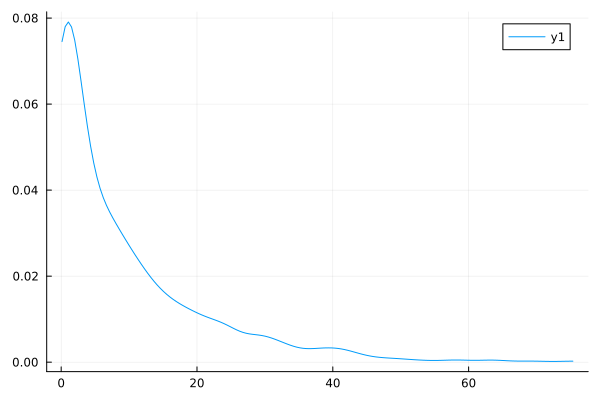

In [1403]:
density(piPowerWithoutOptDCPsSucc, trim = true)

In [1397]:
mean(piPowerWithoutOptDCPsSucc)

9.084418724944443

In [1398]:
minimum(piPower)

-233.5963252830977

### Linear Action Space

In [1404]:
exactPIGFromVFA_LAS_12 = []
exactPIFromVFA_gap_LAS_12 = []
resRpis_LAS_12 = []

epsilon = 1e-10
delScale = N
nMax = 50000
alpha_d = fill(0.0, N)
stateSpace = enumerateStates(N)

for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    print("RVI: ")
    print(round(rviGs[run], digits = 5))

    #print exact heuristic result
    print(", Exact PI Heuristic: ")
    print(round(optPiGs[run], digits = 5))

    print(", Gap: ")
    println(round(optGaps[run], digits = 2))

    #print dcp g 
    print("DCP g: ")
    println(round(optDspGs[run], digits = 5))

    #prepare hUAggVec, gu, gp
    dcp = optDsps[run]
    gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
    hUAggVec = append!([0.0], constructAggUsageH(N, alpha_r, beta, tau, c0, gu))
    
    #construct h table
    h = Dict()
    for s in stateSpace
        used = calculateUsedOrdered(s, N)
        featureIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
        h[s] = hUP(featureIn, paramsList[run], featuresList[run]) + hRepairDCP(s, N, dcp, alpha_r, beta, tau, r)
    end

    #Evaluate API policy
    resRpi = rpiExact(N, h, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "restricted")
    g = resRpi[1]
    print("Approx LAS PI Heuristic: ")
    print(round(g, digits = 5))

    gap = (g/rviGs[run] - 1.0)*100.0
    push!(exactPIFromVFA_gap_LAS_12, gap)
    print(", Optimality Gap: ")
    println(round(gap, digits = 2))
    push!(exactPIGFromVFA_LAS_12, resRpi[1])
    push!(resRpis_LAS_12, resRpi)
    
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
RVI: 4.70822, Exact PI Heuristic: 4.70822, Gap: 0.0
DCP g: 4.70822
Approx LAS PI Heuristic: 4.70822, Optimality Gap: -0.0
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.007767668179646831, 0.00274

Excessive output truncated after 524295 bytes.

Approx LAS PI Heuristic: 1.63665, Optimality Gap: 0.73
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 714
tau: [0.7420129017043658, 0.802770354445969, 0.6530958905421744, 

In [1468]:
resultExp12_PI_LAS = Dict()
resultExp12_PI_LAS["exactPIGFromVFA_LAS_12"] = exactPIGFromVFA_LAS_12 
resultExp12_PI_LAS["exactPIFromVFA_gap_LAS_12"] = exactPIFromVFA_gap_LAS_12 
resultExp12_PI_LAS["resRpis_LAS_12"] = resRpis_LAS_12 

f = serialize("resultExp12_PI_LAS_0.1.dat", resultExp12_PI_LAS)

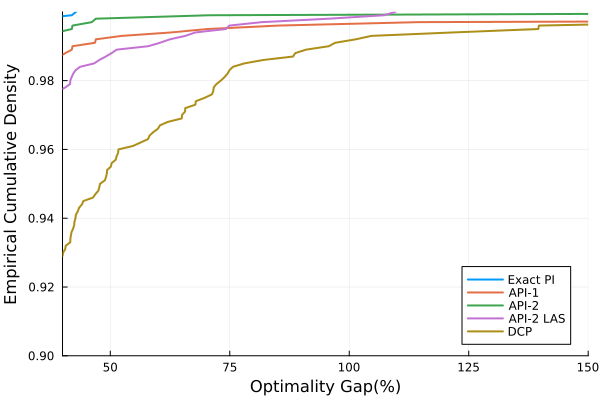

In [1422]:
StatsPlots.plot(sort(optGaps), (1:1000)./1000, label = "Exact PI", ylim = (0.9,1), xlabel = "Optimality Gap(%)", ylabel = "Empirical Cumulative Density", linewidth = 2, size = (600,400))
StatsPlots.plot!(sort(exactPIFromVFA_gap_FAS),(1:1000)./1000, label = "API-1", xlim = (40,150), linewidth = 2)
StatsPlots.plot!(sort(exactPIFromVFA_gap_FAS_12),(1:1000)./1000, label = "API-2", linewidth = 2)
StatsPlots.plot!(sort(exactPIFromVFA_gap_LAS_12),(1:1000)./1000, label = "API-2 LAS", linewidth = 2)
StatsPlots.plot!(sort(dspGaps), (1:1000)./1000, label = "DCP", linewidth = 2)

In [1408]:
maximum(exactPIFromVFA_gap_LAS_12)

109.68774006710204

In [1410]:
minimum(exactPIFromVFA_gap_LAS_12)

-22.224358817037903

In [1418]:
[i for i in 1:1000 if exactPIFromVFA_gap_LAS_12[i] < -0.01]

35-element Vector{Int64}:
  17
  21
  50
  66
  70
 143
 169
 184
 218
 228
 250
 276
 291
   ⋮
 582
 591
 600
 673
 690
 746
 758
 824
 874
 920
 932
 998

In [1412]:
rviGs[758]

0.1694004987415952

In [1414]:
exactPIGFromVFA_LAS_12[758]

0.1317523240634113

In [1420]:
resultExp10["rviPEIter"][998]

50000

In [1444]:
validRuns = [i for i in 1:1000 if resultExp10["rviPEIter"][i] < 50000]

956-element Vector{Int64}:
    1
    2
    3
    4
    5
    6
    7
    8
    9
   10
   11
   12
   13
    ⋮
  988
  989
  990
  991
  992
  993
  994
  995
  996
  997
  999
 1000

In [1423]:
piPowerLAS = 100 .* ((optDspGs - exactPIGFromVFA_LAS_12) ./ optDspGs)

1000-element Vector{Float64}:
  2.9835382501627e-8
  9.110027311481768e-8
  1.5860292218085195e-7
 18.857128775309096
 -3.0441546324327287e-7
  7.203338039280574e-8
 -1.968602610374236
 12.592127981339276
  1.0466033677840312
 -3.9338222713560604
  1.410195082007254e-7
  2.4064011429393353
  0.15490980209533908
  ⋮
  2.3575465089016504e-7
 23.645075499368815
 27.874545820692997
  0.6524625828542312
 -1.1537659401512259e-7
  3.582962218369197
  0.3427767292589332
  1.778104503290595e-8
 27.33702955008599
 15.316798836814927
  1.9075368967279742e-7
  1.8498316975538112e-8

In [1445]:
piPowerLAS = [piPowerLAS[i] for i in validRuns]

956-element Vector{Float64}:
  2.9835382501627e-8
  9.110027311481768e-8
  1.5860292218085195e-7
 18.857128775309096
 -3.0441546324327287e-7
  7.203338039280574e-8
 -1.968602610374236
 12.592127981339276
  1.0466033677840312
 -3.9338222713560604
  1.410195082007254e-7
  2.4064011429393353
  0.15490980209533908
  ⋮
  5.3147821112420204e-8
  2.3575465089016504e-7
 23.645075499368815
 27.874545820692997
  0.6524625828542312
 -1.1537659401512259e-7
  3.582962218369197
  0.3427767292589332
  1.778104503290595e-8
 27.33702955008599
  1.9075368967279742e-7
  1.8498316975538112e-8

In [1446]:
maximum(piPowerLAS)

75.7184644174521

In [1447]:
minimum(piPowerLAS)

-89.11752889117888

In [1448]:
piPowerLAS_Succ = [p for p in piPowerLAS if p > 0.0]

887-element Vector{Float64}:
  2.9835382501627e-8
  9.110027311481768e-8
  1.5860292218085195e-7
 18.857128775309096
  7.203338039280574e-8
 12.592127981339276
  1.0466033677840312
  1.410195082007254e-7
  2.4064011429393353
  0.15490980209533908
 11.218160382368312
  6.865800786836619
  8.038022177304718e-8
  ⋮
  2.6895076924558797e-8
  5.3147821112420204e-8
  2.3575465089016504e-7
 23.645075499368815
 27.874545820692997
  0.6524625828542312
  3.582962218369197
  0.3427767292589332
  1.778104503290595e-8
 27.33702955008599
  1.9075368967279742e-7
  1.8498316975538112e-8

In [1450]:
succProp = 887/956

0.9278242677824268

In [1449]:
mean(piPowerLAS_Succ)

4.234418443463208

In [1452]:
piPowerLASWithoutOptDCPs = [piPowerLAS[i] for i in 1:length(piPowerLAS) if dspGaps[validRuns[i]] > 1e-10]

902-element Vector{Float64}:
  2.9835382501627e-8
  9.110027311481768e-8
  1.5860292218085195e-7
 18.857128775309096
  7.203338039280574e-8
 -1.968602610374236
 12.592127981339276
  1.0466033677840312
 -3.9338222713560604
  1.410195082007254e-7
  2.4064011429393353
  0.15490980209533908
 11.218160382368312
  ⋮
  2.6895076924558797e-8
  5.3147821112420204e-8
  2.3575465089016504e-7
 23.645075499368815
 27.874545820692997
  0.6524625828542312
  3.582962218369197
  0.3427767292589332
  1.778104503290595e-8
 27.33702955008599
  1.9075368967279742e-7
  1.8498316975538112e-8

In [1455]:
mean(piPowerLASWithoutOptDCPs)

3.8094081738123178

In [1453]:
piPowerLASWithoutOptDCPsSucc = [p for p in piPowerLASWithoutOptDCPs if p > 0.0]

852-element Vector{Float64}:
  2.9835382501627e-8
  9.110027311481768e-8
  1.5860292218085195e-7
 18.857128775309096
  7.203338039280574e-8
 12.592127981339276
  1.0466033677840312
  1.410195082007254e-7
  2.4064011429393353
  0.15490980209533908
 11.218160382368312
  6.865800786836619
  8.038022177304718e-8
  ⋮
  2.6895076924558797e-8
  5.3147821112420204e-8
  2.3575465089016504e-7
 23.645075499368815
 27.874545820692997
  0.6524625828542312
  3.582962218369197
  0.3427767292589332
  1.778104503290595e-8
 27.33702955008599
  1.9075368967279742e-7
  1.8498316975538112e-8

In [1454]:
mean(piPowerLASWithoutOptDCPsSucc)

4.408363584230881

## Instance Investigation

In [159]:
resultExp10 = deserialize("resultExp10_update.big")

Dict{Any, Any} with 18 entries:
  "taus_FAS"      => Any[[0.944791, 0.866895, 0.339612, 0.136117, 0.322501], [0…
  "rviIter"       => Any[1464, 4813, 4527, 904, 3246, 2546, 10362, 885, 6902, 5…
  "c0s_FAS"       => Any[[0.0926115, 0.118489, 0.26755, 0.810495, 0.868154], [0…
  "optDspGs_FAS"  => Any[4.70822, 0.97105, 0.615976, 10.982, 0.551766, 1.64594,…
  "optDsps_FAS"   => Any[[1, 1, 0, 0, 0], [1, 0, 0, 1, 0], [0, 1, 1, 0, 0], [1,…
  "rs_FAS"        => Any[[99.5615, 82.0005, 83.4463, 73.4694, 38.3613], [2.2917…
  "heurPiGs_FAS"  => Any[4.70822, 0.94362, 0.589639, 9.17702, 0.551766, 1.64594…
  "rpiIter"       => Any[1541, 4939, 4439, 867, 2952, 2335, 10365, 800, 6109, 4…
  "heurDsps_FAS"  => Any[[1, 1, 0, 0, 0], [1, 0, 0, 1, 0], [0, 1, 1, 0, 0], [1,…
  "heurGaps_FAS"  => Any[1.61204e-11, 0.0, 0.0, 5.41783, -6.53178e-10, 0.000438…
  "optGaps_FAS"   => Any[1.61204e-11, 0.0, 0.0, 5.41783, -6.53178e-10, 0.000438…
  "alphas_FAS"    => Any[[0.00897018, 0.0369358, 0.059888, 0.0366322, 0.07370

In [160]:
resultExp12_VFAs = deserialize("resultExp12_VFAs_0.1.dat")
featuresList = resultExp12_VFAs["features"]
paramsList = resultExp12_VFAs["params"]

1000-element Vector{Any}:
 [-102.28608176214969, -85.92535339937447, -31.775609286565352, -31.77554757746056, -75.18159550935485, -70.62515968372453, -70.62082945522116, -128.97129452300973, -128.49823090150247, -123.98233323419092  …  -105.1755968743338, -105.49157080825574, -105.07428932476674, -101.32459002437393, -85.92535339937447, -122.29463531168425, -118.42073423872573, -123.46884466368118, -114.86427938952787, 337.05058469254067]
 [-110.56599882282386, -106.15933713442932, -43.40754289002588, -43.39646769175353, -124.67752086029832, -124.32181720141725, -114.93692645850872, -151.53479149361067, -146.8313369237714, -116.29566523272592  …  24.905381510608567, -143.53481954006574, -142.1761927509426, -108.611326616257, -106.15933713442932, -167.74880017327803, -168.39118213094602, -165.6571727447133, -179.22061148114565, 632.4432351124184]
 [-44.233195153823665, -72.74535754412229, -75.65712484081727, -63.727868442917426, -46.22163981166337, -15.561496888068724, -15.5547384943131

In [182]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 1000000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0

run = 2

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

println()

#print rvi result 
print("RVI: ")
print(round(rviGs[run], digits = 5))

#print exact heuristic result
print(", PI Heuristic: ")
print(round(optPiGs[run], digits = 5))

print(", Gap: ")
println(round(optGaps[run], digits = 2))

#find PE of best DSP
dsp = optDsps[run]
policy = staticPolicyToDynamicPolicy(N, optDsps[run])
r = fill(0.0, N)
resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE Iterations: ")
println(resPE[3])


print("DSP g: ")
print(round(optDspGs[run], digits = 5))

features = featuresList[run]
params = paramsList[run]

#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.007767668179646831, 0.002744059925049017, 0.014014082661568152]
c0: [0.031060918612698662, 0.47502901483951, 0.6338479453532103, 0.8686618392461037, 0.8999510969166794]
c1: 886.4052903510224
r: [2.2917203156524124, 74.74303803715054, 92.61105979360987, 24.71873940882312, 49.33692564620821]

RVI: 0.94362, PI Heuristic: 0.94362, Gap: 0.0


PE Iterations: 4953
DSP g: 0.97105---------------------------------------------------------------------------


In [193]:
dsp

5-element Vector{Int64}:
 1
 1
 0
 0
 0

In [183]:
probParams.r

5-element Vector{Float64}:
 99.56147215735662
 82.000516419209
 83.4463081073842
 73.46937216084547
 38.36128790136257

In [184]:
nMax = 100000

probParams = problemParams()
probParams.N = N 
probParams.alpha = alpha_r 
probParams.beta = beta 
probParams.tau = tau 
probParams.c = c0
probParams.p = c1
probParams.r = rs[run]

gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dsp)
gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dsp)

test = gEvaluationUP(probParams, dsp, nMax; hUAggVec = [], params = paramsList[run], features = featuresList[run], stepsizes = [], gDCP = optDspGs[run], gu = gu, gp = gp, s = [1 for i in 1:N], timePassed = 0.0, s0 = [], stateTrace = [], printProgress = true, modCounter = 100000, printStates = false)

100000


(0.9696611463004128, Any[0.03106091861269866, 0.03106091861269866, 0.2814471513102045, 0.16225799766077045, 0.11556225104394226, 0.11556225104394226, 0.19609040114986173, 0.1537494065001034, 0.11056257352141875, 0.11056257352141875  …  0.9697378894100359, 0.9697402115629847, 0.969712306798333, 0.969712306798333, 0.9697146289069056, 0.9696867257618405, 0.9696867257618405, 0.969689047826038, 0.9696611463004128, 0.9696611463004128])

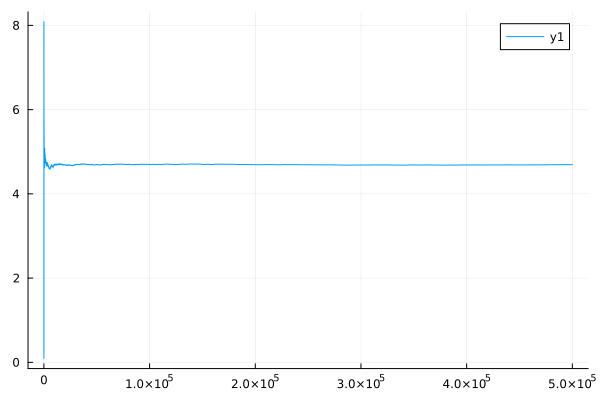

In [181]:
StatsPlots.plot(test[2])

In [164]:
stateSpace = enumerateStates(N)

trueValues = []
approxValues = []

for s in stateSpace
    push!(trueValues, resPE[2][s])
end


p = sortperm(trueValues)
trueValues .= trueValues[p]
stateSpace .= stateSpace[p]

#prepare hUAggVec, gu, gp
dcp = optDsps[run]
gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
hUAggVec = append!([0.0], constructAggUsageH(N, alpha_r, beta, tau, c0, gu))

for s in stateSpace
    used = calculateUsedOrdered(s, N)
    featureIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
    push!(approxValues, hUP(featureIn, params, features))
    #push!(approxValues, hUP(featureIn, params, features) + hRepairDCP(s, N, dcp, alpha_r, beta, tau, r))
end

figure(figsize=((3/2)*5, 5))
gap = mean(trueValues - approxValues)

ptSize = 2
PyPlot.plot(trueValues , "o", label = "True", ms = ptSize)
PyPlot.plot(approxValues .+ gap, "o", label = "Linear VFA", ms = ptSize)
title("Costs-to-go")
legend()

PyObject <matplotlib.legend.Legend object at 0x7f6e37f9efe0>

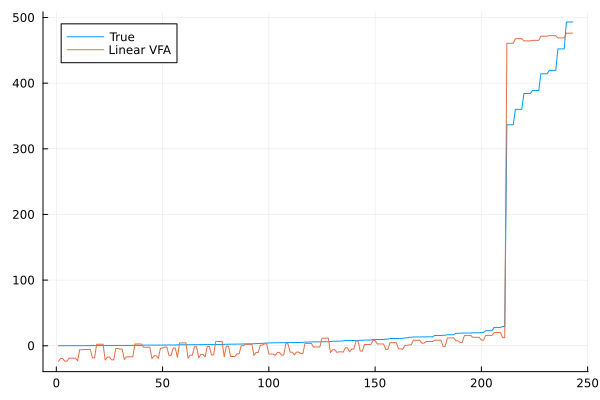

In [165]:
StatsPlots.plot(trueValues , label = "True", ms = ptSize)
StatsPlots.plot!(approxValues .+ gap, label = "Linear VFA", ms = ptSize)

In [602]:
dcp

5-element Vector{Int64}:
 1
 1
 0
 0
 0

In [595]:
resultExp12_PI = Dict()
resultExp12_PI["exactPIGFromVFA_FAS"] = exactPIGFromVFA_FAS_12
resultExp12_PI["exactPIFromVFA_gap_FAS"] = exactPIFromVFA_gap_FAS_12
resultExp12_PI["resRpis_FAS"] = resRpis_FAS_12
#f = serialize("resultExp12_PI.big", resultExp12_PI)

In [180]:
resultExp12_PI = deserialize("resultExp12_PI_LAS_0.1.dat")

Dict{Any, Any} with 3 entries:
  "resRpis_LAS_12"            => Any[(4.70822, Dict{Any, Any}([3, 3, 1, 3, 3]=>…
  "exactPIFromVFA_gap_LAS_12" => Any[-2.39532e-8, 2.90688, 4.46671, 2.36304, 2.…
  "exactPIGFromVFA_LAS_12"    => Any[4.70822, 0.97105, 0.615976, 8.91109, 0.551…

In [612]:
    imp = exactPIGFromVFA_FAS_12 .< (1.01.*optDspGs)

1000-element BitVector:
 0
 1
 1
 1
 1
 0
 1
 1
 1
 1
 0
 0
 0
 ⋮
 1
 1
 1
 1
 0
 1
 1
 0
 1
 1
 1
 0

In [613]:
sum(imp)

762

## Experiment 12.1 - FA Policy

In [737]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
LEN_FRAME = 75
nMaxSmarpe = 1000000
numRuns = 10

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

featuresListFA = []
paramsListFA = []
for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    #prepare smarpe

    sStart = fill(1, N)

    #create mcp
    dcp = fill(1, N)

    mcp = fill(-1, N)


    #construct problemParams struct
    probParams = problemParams()
    probParams.N = N 
    probParams.alpha = alpha_r
    probParams.beta = beta
    probParams.tau = tau
    probParams.c = c0
    probParams.p = c1
    probParams.r = fill(0.0, N)

    #precalculate FA usage costs
    gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
    gup = gu + gp
    hUAggVec = append!([0.0], constructAggUPH(probParams, gup))
    
    #create lists of features and parameters
    features = [costFeature]
    params = [0.0]

    # for i in 1:N
    #     if dcp[i] == 0
    #         append!(features, [negIndicator(i, 3)])
    #         append!(params, [0.0])
    #     else
    #         append!(features, [negIndicator(i, 1)])
    #         append!(params, [0.0])
    #     end
    # end

    # for i in 1:N
    #     append!(features, [indicator(i,1), negIndicator(i,1)])
    #     append!(params, [0.0, 0.0])
    # end 

    # append!(features, [usedIndictor(i) for i in 1:N])
    # append!(params, fill(0.0, N))

    stepsizes = fill(1.0, length(params))

    #perform SMARPE
    Random.seed!(12345)
    resSMARPE = smarpeVFA_UP_MCP(probParams, nMaxSmarpe, mcp; hUAggVec = hUAggVec, params = params, features = features, stepsizes = stepsizes, vfaProvided = true, gu = gu, gp = gp, s = copy(sStart), stateTrace = [], printProgress = false, modCounter = 100000, printStates = false, rate = 0.1)
    println("SMARPE Complete")

    push!(featuresListFA, features)
    push!(paramsListFA, params)
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
SMARPE Complete
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.007767668179646831, 0.002744059925049017, 0.014014082661568152]
c0: [0.031060918612698662, 0.47502901483951, 0.6338479453532103, 0.86

In [ ]:
resultExp12_1_VFAs = Dict()
resultExp12_1_VFAs["features"] = featuresListFA
resultExp12_1_VFAs["params"] = paramsListFA

f = serialize("resultExp12.1_VFAs.dat", resultExp12_1_VFAs)

In [745]:
exactPIGFromVFA_FAS_12_FA = []
exactPIFromVFA_gap_FAS_12_FA = []
resRpis_FAS_12_FA = []

epsilon = 1e-10
delScale = 1
nMax = 50000
alpha_d = fill(0.0, N)
stateSpace = enumerateStates(N)

for run in 11:1000
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    #construct problemParams struct
    probParams = problemParams()
    probParams.N = N 
    probParams.alpha = alpha_r
    probParams.beta = beta
    probParams.tau = tau
    probParams.c = c0
    probParams.p = c1
    probParams.r = fill(0.0, N)
    
    print("RVI: ")
    print(round(rviGs[run], digits = 5))

    #print exact heuristic result
    print(", Exact DCP PI Heuristic: ")
    print(round(optPiGs[run], digits = 5))

    print(", Gap: ")
    println(round(optGaps[run], digits = 2))

    #print dcp g 
    print("DCP g: ")
    println(round(optDspGs[run], digits = 5))

    #prepare hUAggVec, gu, gp
    dcp = fill(1, N)
    gFA = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, dcp)
    gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
    gup = gu + gp
    hUAggVec = append!([0.0], constructAggUPH(probParams, gup))
    
    #print FA g 
    print("FA g: ")
    println(round(gFA, digits = 5))

    #construct h table
    h = Dict()
    for s in stateSpace
        used = calculateUsedOrdered(s, N)
        featureIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
        h[s] = hUP(featureIn, [(beta*c1 - gu - gp)/sum(tau)], [costFeature]) + hRepairDCP(s, N, dcp, alpha_r, beta, tau, r)
    end

    #Evaluate API policy
    resRpi = rpiExact(N, h, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")
    g = resRpi[1]
    print("Approx FA PI Heuristic: ")
    print(round(g, digits = 5))

    gap = (g/rviGs[run] - 1.0)*100.0
    push!(exactPIFromVFA_gap_FAS_12_FA, gap)
    print(", Optimality Gap: ")
    println(round(gap, digits = 2))
    push!(exactPIGFromVFA_FAS_12_FA, resRpi[1])
    push!(resRpis_FAS_12_FA, resRpi)
    
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 11
tau: [0.022522076981925765, 0.8228275977023196, 0.8693865393448893, 0.12311714526487239, 0.012322728543585404]
alpha: [0.008910573509950405, 0.0026667237295539908, 0.0030445495105178165, 0.0007028947516503511, 0.003795975923588317]
c0: [0.2337230656462589, 0.3225747463161558, 0.5681099185151535, 0.8105455050815257, 0.9314719369533632]
c1: 725.1320617048058
r: [68.40749403376859, 99.58718455087417, 92.94873577891161, 34.380836023438455, 29.013577427125238]
RVI: 0.8493, Exact DCP PI Heuristic: 0.8494, Gap: 0.01
DCP g: 0.85432
FA g: 27.32538
Approx FA PI Heuristic: 1.07291, Optimality Gap: 26.33
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 12
tau: [0.8763009354407805, 0.09666793114371419, 0.01716394912744612, 0.9554234779552365, 0.8335794351441661]
alpha: [0.012467424247993217, 0.0045820242379210

LoadError: InterruptException:

In [ ]:
resultExp12_1_PI = Dict()
resultExp12_1_PI["exactPIGFromVFA_FAS_12"] = exactPIGFromVFA_FAS_12_FA
resultExp12_1_PI["exactPIFromVFA_gap_FAS_12"] = exactPIFromVFA_gap_FAS_12_FA 
resultExp12_1_PI["resRpis_FAS_12"] = resRpis_FAS_12_FA

f = serialize("resultExp12.1_PI.big", resultExp12_1_PI)

### Instance Investigation

In [1123]:
for run in 1:1000
    if sum(optDsps[run]) > 2
        print(run)
        break
    end
end

15

In [1339]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxgEval = 1000000
nMaxSmarpe = 1000000
nMaxPE = 50000
delScale = 1
stepsize = 0.0
esoft = -1.0

run = 12

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)

#get parameters
tau = taus[run]
print("tau: ")
println(tau)

alpha_r = alphas[run]
print("alpha: ")
println(alpha_r)

c0 = c0s[run]
print("c0: ")
println(c0)

c1 = c1s[run]
print("c1: ")
println(c1)

r = rs[run]
print("r: ")
println(r)

#construct problemParams struct
probParams = problemParams()
probParams.N = N 
probParams.alpha = alpha_r
probParams.beta = beta
probParams.tau = tau
probParams.c = c0
probParams.p = c1
probParams.r = r


#find PE of FA
dsp = fill(1, N)
#dsp = optDsps[run]
policy = staticPolicyToDynamicPolicy(N, dsp)

resPE_UP = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, fill(0.0, N), epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE Iterations: ")
println(resPE_UP[3])

resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE Iterations: ")
println(resPE[3])

#features = featuresListFA[run]
#params = paramsListFA[run]

#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 12
tau: [0.8763009354407805, 0.09666793114371419, 0.01716394912744612, 0.9554234779552365, 0.8335794351441661]
alpha: [0.012467424247993217, 0.004582024237921025, 0.00010471305025101067, 0.007858772294963373, 0.009917450927074748]
c0: [0.03787651388389923, 0.6490543410114491, 0.6684007817958, 0.7257436179206141, 0.8683824599817607]
c1: 755.9929493970288
r: [59.65736199917402, 51.02785241964363, 19.558318467781255, 18.922515466824596, 31.07250858324475]
PE Iterations: 2048
PE Iterations: 4058
---------------------------------------------------------------------------


In [1341]:
resVI = rvi(N, alpha_d, alpha_r, beta, tau, c0, c1, r, 1e-5; nMax = 0, delScale = 1, printProgress = true, modCounter = 1000, actionType = "full")

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000


(0.8253091114396048, Dict{Any, Any}([2, 1, 3, 1, 1] => 1207.8930323524621, [2, 3, 1, 2, 3] => 95.58688389606364, [2, 1, 2, 2, 2] => 1264.8704730294294, [3, 2, 1, 3, 3] => 556.8373432417778, [3, 2, 2, 2, 1] => 1721.8085261488052, [3, 2, 2, 1, 3] => 1720.588506470889, [1, 2, 3, 2, 3] => 1673.4617560824056, [1, 2, 1, 1, 2] => 540.8403191611906, [1, 2, 2, 3, 1] => 1651.9408765388282, [3, 1, 3, 3, 3] => 1219.984832238464…), 12409, Dict{Any, Any}([2, 1, 3, 1, 1] => [0, 0, 1, 0, 0], [2, 3, 1, 2, 3] => [0, 0, 0, 0, 0], [2, 1, 2, 2, 2] => [0, 0, 0, 0, 0], [3, 2, 1, 3, 3] => [0, 0, 0, 0, 0], [3, 2, 2, 2, 1] => [0, 0, 0, 0, 0], [3, 2, 2, 1, 3] => [1, 0, 0, 0, 0], [1, 2, 3, 2, 3] => [0, 0, 1, 0, 0], [1, 2, 1, 1, 2] => [0, 0, 0, 0, 0], [1, 2, 2, 3, 1] => [0, 0, 0, 0, 0], [3, 1, 3, 3, 3] => [0, 0, 1, 1, 0]…), 9.999871963373153e-6)

In [1340]:
optDsps[run]

5-element Vector{Int64}:
 0
 0
 1
 1
 0

In [1342]:
resVI[4][[3,3,3,3,3]]

5-element Vector{Int64}:
 1
 0
 1
 1
 1

In [1343]:
h = resPE[2]
resRpi = rpiExact(N, h, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")

(0.8938911768182818, Dict{Any, Any}([2, 1, 3, 1, 1] => 5419.364603242755, [2, 3, 1, 2, 3] => 44.21308129017613, [2, 1, 2, 2, 2] => 1282.3112092368606, [3, 2, 1, 3, 3] => 523.9954488375113, [3, 2, 2, 2, 1] => 1750.933042699517, [3, 2, 2, 1, 3] => 1767.788092947254, [1, 2, 3, 2, 3] => 5886.300048870709, [1, 2, 1, 1, 2] => 540.8243035523467, [1, 2, 2, 3, 1] => 1668.8571157508297, [3, 1, 3, 3, 3] => 5470.103562647466…), 50000, Dict{Any, Any}([2, 1, 3, 1, 1] => [0, 0, 0, 0, 0], [2, 3, 1, 2, 3] => [0, 0, 0, 0, 0], [2, 1, 2, 2, 2] => [0, 0, 0, 0, 0], [3, 2, 1, 3, 3] => [0, 0, 0, 0, 0], [3, 2, 2, 2, 1] => [1, 0, 0, 0, 0], [3, 2, 2, 1, 3] => [1, 0, 0, 0, 1], [1, 2, 3, 2, 3] => [0, 0, 0, 0, 1], [1, 2, 1, 1, 2] => [0, 0, 0, 0, 0], [1, 2, 2, 3, 1] => [0, 0, 0, 0, 0], [3, 1, 3, 3, 3] => [1, 0, 0, 1, 1]…))

In [1344]:
s = [3,3,3,3,3]
resRpi[4][s]

5-element Vector{Int64}:
 1
 1
 1
 1
 1

In [1324]:
i = 1
ei = fill(0, N)
ei[i] = 1 

s = [2,2,1,2,2]

resPE_UP[2][s] - resPE_UP[2][s - [0,0,0,0,0] - ei] - r[i]/tau[i] 

-26.792972558722262

In [1346]:
#Start frame
println(join(fill("-",LEN_FRAME)))
print("Run: ")
println(run)


#construct problemParams struct
probParams2 = problemParamsSubset(probParams, [1,0,1,1,1])
probParams2_UP = copy(probParams2)
probParams2_UP.r = fill(0.0, probParams2.N)


#dsp = fill(1, probParams2.N) #FA on subset of links
dsp = [1,1,1,1] #dcp on subset
policy = staticPolicyToDynamicPolicy(probParams2.N, dsp)

resPE_UP = rpe(probParams2_UP, policy, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE Iterations: ")
println(resPE_UP[3])

resPE = rpe(probParams2, policy, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
print("PE Iterations: ")
println(resPE[3])


#end frame
println(join(fill("-",LEN_FRAME)))

---------------------------------------------------------------------------
Run: 12
PE Iterations: 2464
PE Iterations: 3917
---------------------------------------------------------------------------


In [1347]:
resPE[1]

1.5219007314428916

In [1348]:
rviGs[run]

0.8252811911650326

In [1349]:
optDspGs[run]

0.9790847430206108

In [1350]:
h = resPE[2]
resRpi = rpiExact(probParams2, h, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")

(0.8408378970401541, Dict{Any, Any}([1, 1, 3, 3] => -47.170316978860505, [1, 2, 2, 1] => 1197.8697843558734, [3, 1, 3, 2] => 48.379009394530485, [1, 2, 1, 3] => 1192.8999925527844, [3, 2, 1, 2] => 1284.4206448020725, [2, 3, 3, 3] => 1585.8850512945855, [3, 3, 1, 1] => 5746.80000183345, [1, 2, 2, 3] => 1236.7956501209014, [3, 2, 2, 2] => 1585.8850512945855, [2, 1, 3, 2] => 81.1217088633974…), 50000, Dict{Any, Any}([1, 1, 3, 3] => [0, 0, 0, 0], [1, 2, 2, 1] => [0, 0, 0, 0], [3, 1, 3, 2] => [0, 0, 0, 0], [1, 2, 1, 3] => [0, 0, 0, 0], [3, 2, 1, 2] => [1, 0, 0, 0], [2, 3, 3, 3] => [0, 1, 1, 1], [3, 3, 1, 1] => [0, 0, 0, 0], [1, 2, 2, 3] => [0, 0, 0, 1], [3, 2, 2, 2] => [1, 0, 0, 0], [2, 1, 3, 2] => [0, 0, 0, 0]…))

In [1351]:
resRvi = rvi(probParams2, epsilon; nMax = nMax, delScale = delScale, printProgress = true, modCounter = 1000, actionType = "full")

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000


(0.8252811912987633, Dict{Any, Any}([1, 1, 3, 3] => 3.9607093188519378, [1, 2, 2, 1] => 1167.3057396604424, [3, 1, 3, 2] => 90.71105176597882, [1, 2, 1, 3] => 1156.8366370820897, [3, 2, 1, 2] => 1246.612642127649, [2, 3, 3, 3] => 1555.4307201613751, [3, 3, 1, 1] => 1207.1639406681404, [1, 2, 2, 3] => 1180.3529897212024, [3, 2, 2, 2] => 1555.4307201613751, [2, 1, 3, 2] => 106.66748847651638…), 13992, Dict{Any, Any}([1, 1, 3, 3] => [0, 0, 0, 0], [1, 2, 2, 1] => [0, 0, 0, 0], [3, 1, 3, 2] => [0, 0, 0, 0], [1, 2, 1, 3] => [0, 0, 0, 0], [3, 2, 1, 2] => [0, 0, 0, 0], [2, 3, 3, 3] => [0, 1, 1, 1], [3, 3, 1, 1] => [0, 1, 0, 0], [1, 2, 2, 3] => [0, 0, 0, 0], [3, 2, 2, 2] => [1, 0, 0, 0], [2, 1, 3, 2] => [0, 0, 0, 0]…), 9.972467296393006e-11)

In [1352]:
rpiExact(probParams2, resRvi[2], epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")

(0.8252811913000011, Dict{Any, Any}([1, 1, 3, 3] => 3.960709318923869, [1, 2, 2, 1] => 1167.3057396606582, [3, 1, 3, 2] => 90.71105176567762, [1, 2, 1, 3] => 1156.8366370827066, [3, 2, 1, 2] => 1246.6126421278882, [2, 3, 3, 3] => 1555.4307201615893, [3, 3, 1, 1] => 1207.1639406683798, [1, 2, 2, 3] => 1180.352989721814, [3, 2, 2, 2] => 1555.4307201615893, [2, 1, 3, 2] => 106.66748847622614…), 6596, Dict{Any, Any}([1, 1, 3, 3] => [0, 0, 0, 0], [1, 2, 2, 1] => [0, 0, 0, 0], [3, 1, 3, 2] => [0, 0, 0, 0], [1, 2, 1, 3] => [0, 0, 0, 0], [3, 2, 1, 2] => [0, 0, 0, 0], [2, 3, 3, 3] => [0, 1, 1, 1], [3, 3, 1, 1] => [0, 1, 0, 0], [1, 2, 2, 3] => [0, 0, 0, 0], [3, 2, 2, 2] => [1, 0, 0, 0], [2, 1, 3, 2] => [0, 0, 0, 0]…))

In [1278]:
s = [1,1,1]
resRpi[4][s]

3-element Vector{Int64}:
 1
 0
 0

In [1172]:
optDsps[run]

5-element Vector{Int64}:
 1
 0
 0
 1
 0

In [1185]:
s = [1,1,1]
resRpi[4][s]

3-element Vector{Int64}:
 0
 0
 0

In [1160]:
probParams2

problemParams(5, 1.0, [0.03063031765318111, 0.045966658334234294, 0.002744059925049017], [0.9026092458595942, 0.33079891601205613, 0.1735229272258466], [0.031060918612698662, 0.47502901483951, 0.8686618392461037], [2.2917203156524124, 74.74303803715054, 24.71873940882312], 886.4052903510224)

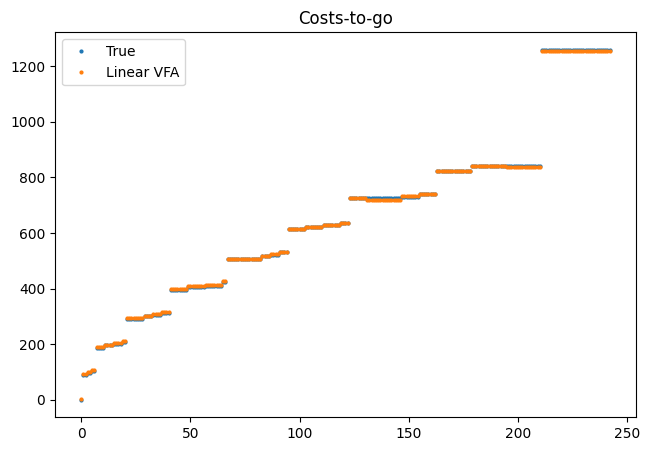

PyObject <matplotlib.legend.Legend object at 0x7fb64af4ead0>

In [780]:
stateSpace = enumerateStates(N)

trueValues = []
approxValues = []

for s in stateSpace
    push!(trueValues, resPE[2][s])
end


p = sortperm(trueValues)
trueValues .= trueValues[p]
stateSpace .= stateSpace[p]

#prepare hUAggVec, gu, gp
dcp = fill(1, N)
gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
gup = gu + gp
hUAggVec = append!([0.0], constructAggUPH(probParams, gup))

for s in stateSpace
    used = calculateUsedOrdered(s, N)
    featureIn = featureInput(s, N, used, hUAggVec, dcp, gu, gp, tau)
    #push!(approxValues, hUP(featureIn, [(beta*c1 - gup)/sum(tau)], features))
    push!(approxValues, hUP(featureIn, [(beta*c1 - gup)/sum(tau)], features) + hRepairDCP(s, N, dcp, alpha_r, beta, tau, r))
end

figure(figsize=((3/2)*5, 5))
gap = mean(trueValues - approxValues)

ptSize = 2
PyPlot.plot(trueValues, "o", label = "True", ms = ptSize)
PyPlot.plot(approxValues.+ gap, "o", label = "Linear VFA", ms = ptSize)
title("Costs-to-go")
legend()

In [748]:
hUAggVec

6-element Vector{Float64}:
   0.0
   0.13651760665530496
   0.6717132384805303
   1.6561446645760487
  10.824671456160836
 328.511515595571

In [741]:
paramsListFA[1]

1-element Vector{Float64}:
 3.145914133516588

## Experiment 13 - Myopic Policy

In [765]:
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
nMaxPE = 50000
delScale = 1
numRuns = 1000

taus = resultExp10["taus_FAS"]
alphas = resultExp10["alphas_FAS"]
c0s = resultExp10["c0s_FAS"]
c1s = resultExp10["c1s_FAS"]
rs = resultExp10["rs_FAS"]
rviGs = resultExp10["rviGs_FAS"]
optPiGs = resultExp10["optPiGs_FAS"]
optGaps = resultExp10["optGaps_FAS"]
optDsps = resultExp10["optDsps_FAS"]
optDspGs = resultExp10["optDspGs_FAS"]

myopicGs = []
myopicGaps = []

for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #get parameters
    tau = taus[run]
    print("tau: ")
    println(tau)

    alpha_r = alphas[run]
    print("alpha: ")
    println(alpha_r)

    c0 = c0s[run]
    print("c0: ")
    println(c0)

    c1 = c1s[run]
    print("c1: ")
    println(c1)

    r = rs[run]
    print("r: ")
    println(r)

    print("RVI g: ")
    println(round(rviGs[run], digits = 5))

    #construct problemParams struct
    probParams = problemParams()
    probParams.N = N 
    probParams.alpha = alpha_r
    probParams.beta = beta
    probParams.tau = tau
    probParams.c = c0
    probParams.p = c1
    probParams.r = fill(0.0, N)

    #find PE of myopic policy
    dsp = fill(1, N)
    policy = myopicPolicy(probParams; forceThreshold = 0)
    resPE = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, c1, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
    gMyo = resPE[1]

    print("Myopic g: ")
    println(round(gMyo, digits = 5))
    push!(myopicGs, gMyo)

    gap = (gMyo/rviGs[run] - 1.0)*100.0
    push!(myopicGaps, gap)
    print("Optimality Gap: ")
    println(round(gap, digits = 2))
    
    print("PE Iterations: ")
    println(resPE[3])

    resPE_UR = rpe(N, policy, alpha_d, alpha_r, beta, tau, c0, 0.0, r, epsilon; nMax = nMaxPE, delScale = delScale, printProgress = false, modCounter = 1000)
    gMyoWP = resPE_UR[1]
    print("Myopic g without penalty: ")
    print(round(gMyoWP, digits = 5))
    print(", Ratio: ")
    println(gMyoWP/gMyo)
    
    #end frame
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.9447905649425166, 0.866894886438913, 0.3396115028483221, 0.13611651795784874, 0.3225010866963668]
alpha: [0.008970179158651559, 0.036935810010869013, 0.059888020871150055, 0.03663215704203369, 0.0737056992956364]
c0: [0.09261145157968753, 0.11848853125656122, 0.26755021483368013, 0.8104947638539546, 0.8681535487443706]
c1: 853.4190042384113
r: [99.56147215735662, 82.000516419209, 83.4463081073842, 73.46937216084547, 38.36128790136257]
RVI g: 4.70822
Myopic g: 39.60733
Optimality Gap: 741.24
PE Iterations: 422
Myopic g without penalty: 39.60539, Ratio: 0.9999510266760002
---------------------------------------------------------------------------
---------------------------------------------------------------------------
Run: 2
tau: [0.9026092458595942, 0.33079891601205613, 0.13162494417125792, 0.1735229272258466, 0.13882745373884087]
alpha: [0.03063031765318111, 0.045966658334234294, 0.00776766817

LoadError: InterruptException:

## Small Experiment varying p

In [164]:
Random.seed!(12345)
N = 5
numRuns = 100
TAU_MAX = 1.0
C_MAX = 1.0
R_MAX = 100

taus = []
alphas = []
cs = []
rs = []

for i in 1:numRuns
    tau = rand(N).*TAU_MAX 
    push!(taus, tau)

    alpha = [sampleTruncExp(minimum(tau)/2, minimum(tau)) for i in 1:N]
    push!(alphas, alpha)

    c = rand(N).*C_MAX
    c = sort(c)
    push!(cs, c)

    r = rand(N).*R_MAX
    push!(rs, r)
end

In [166]:
Random.seed!(12345)
numRuns = 1000
N = 5
alpha_d = fill(0.0, N)
beta = 1.0
epsilon = 1e-10
LEN_FRAME = 75
ps = [10^i for i in 0:2:10]
nMax = 50000
delScale = 1

rviGs = []
optDsps = []
optDspGs = []
optPiGs = []
optGaps = []

rviIter = []
rviPEIter = []
rpeIter = []
rpiIter = []

resultSmallExp1 = Dict()
f = serialize("resultSmallExp1.big", resultSmallExp1)

for run in 1:numRuns
    #Start frame
    println(join(fill("-",LEN_FRAME)))
    print("Run: ")
    println(run)

    #load parameters
    tau = taus[run]
    print("tau: ")
    println([round(tau[i], digits = 5) for i in 1:N])

    alpha = alphas[run]
    print("alpha: ")
    println([round(alpha[i], digits = 5) for i in 1:N])

    c = cs[run]
    print("c: ")
    println([round(c[i], digits = 5) for i in 1:N])

    r = rs[run]
    print("r: ")
    println([round(r[i], digits = 5) for i in 1:N])


    rviGs_i = []
    optDsps_i = []
    optDspGs_i = []
    optPiGs_i = []
    optGaps_i = []

    rviIter_i = []
    rviPEIter_i = []
    rpeIter_i = []
    rpiIter_i = []

    for j in 1:length(ps)
        p = ps[j]
        print("p: 10^")
        println(j-1)

        #find true optimal solution
        resRVI= rvi(N, alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 100, actionType = "full")

        #evaluate true optimal solution
        resRVI_PE = rpe(N, resRVI[4], alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000)
        push!(rviGs_i, resRVI_PE[1])
        print("RVI: ")
        print(round(resRVI_PE[1], digits = 5))
        print(" (RVI Iterations: ")
        print(resRVI[3])
        print(", PE Iterations: ")
        print(resRVI_PE[3])
        println(")    ")

        push!(rviIter_i, resRVI[3])
        push!(rviPEIter_i, resRVI_PE[3])

        #find best DSP solution
        dsps = enumerateActions(N)
        bestDSP = dsps[1]
        bestDSP_G = calculateG_DSP(N,alpha_d, alpha, beta, tau, c, p, r, bestDSP)
        for i in 2:(2^N)
            thisDSP = dsps[i]
            thisDSP_G = calculateG_DSP(N,alpha_d, alpha, beta, tau, c, p, r, thisDSP)
            if thisDSP_G < bestDSP_G
                bestDSP = thisDSP
                bestDSP_G = thisDSP_G
            end
        end

        push!(optDsps_i, bestDSP)
        push!(optDspGs_i, bestDSP_G)
        print("Optimal DSP: ")
        print(bestDSP)
        print(" ")
        print(round(bestDSP_G, digits = 5))
        print(",    ")

        #find PE of best DSP
        policy = staticPolicyToDynamicPolicy(N, bestDSP)
        resPE = rpe(N, policy, alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000)
        print("PE Iterations: ")
        print(resPE[3])
        print(",   ")
        push!(rpeIter_i, resPE[3])

        #do PI on best DSP
        resPI = rpiExact(N, resPE[2], alpha_d, alpha, beta, tau, c, p, r, epsilon; nMax = nMax, delScale = delScale, printProgress = false, modCounter = 1000, actionType = "full")
        push!(optPiGs_i, resPI[1])
        print("PIH: ")
        print(round(resPI[1], digits = 5))
        print(" (Iterations: ")
        print(resPI[3])
        println(").")
        push!(rpiIter_i, resPI[3])
        
        #Print optimality gap
        print("Optimality Gap: ")
        gap = (resPI[1]/resRVI_PE[1] - 1)*100
        push!(optGaps_i, gap)
        print(round(gap, digits = 2))
        println("%.")
        println("")
    end

    #push
    push!(rviGs, rviGs_i)
    push!(optDsps, optDsps_i)
    push!(optDspGs, optDspGs_i)
    push!(optPiGs, optPiGs_i)
    push!(optGaps, optGaps_i)

    push!(rviIter, rviIter_i) 
    push!(rviPEIter, rviPEIter_i) 
    push!(rpeIter, rpeIter_i) 
    push!(rpiIter, rpiIter_i) 

    #save
    resultSmallExp1["rviGs"] = rviGs
    resultSmallExp1["optDsps"] = optDsps
    resultSmallExp1["optDspGs"] = optDspGs
    resultSmallExp1["optPiGs"] = optPiGs
    resultSmallExp1["optGaps"] = optGaps

    resultSmallExp1["rviIter"] = rviIter
    resultSmallExp1["rviPEIter"] = rviPEIter
    resultSmallExp1["rpeIter"] = rpeIter
    resultSmallExp1["rpiIter"] = rpiIter

    f = serialize("resultSmallExp1.big", resultSmallExp1)
    println(join(fill("-",LEN_FRAME)))
end

---------------------------------------------------------------------------
Run: 1
tau: [0.94479, 0.86689, 0.33961, 0.13612, 0.3225]
alpha: [0.00897, 0.03694, 0.05989, 0.03663, 0.07371]
c: 

[0.09261, 0.11849, 0.26755, 0.81049, 0.86815]
r: [85.32723, 99.56147, 82.00052, 83.44631, 73.46937]
p: 10^0
RVI: 

0.90365 (RVI Iterations: 2260, PE Iterations: 1817)    
Optimal DSP: 

[1, 0, 0, 0, 0] 0.90365,    

PE Iterations: 1326,   PIH: 

0.90365 (Iterations: 1817).
Optimality Gap: 0.0%.

p: 10^1


RVI: 1.83475 (RVI Iterations: 1697, PE Iterations: 1728)    
Optimal DSP: [1, 0, 0, 0, 0] 1.83475,    

PE Iterations: 1728,   PIH: 

1.83475 (Iterations: 1728).
Optimality Gap: 0.0%.

p: 10^2


RVI: 7.9968 (RVI Iterations: 1700, PE Iterations: 1703)    
Optimal DSP: [1, 1, 0, 0, 0] 8.80744,    

PE Iterations: 1791,   PIH: 

7.9989 (Iterations: 1701).
Optimality Gap: 0.03%.

p: 10^3


RVI: 40.45367 (RVI Iterations: 1888, PE Iterations: 1869)    
Optimal DSP: [1, 1, 1, 0, 1] 41.64228,    

PE Iterations: 1871,   PIH: 

40.49467 (Iterations: 1847).
Optimality Gap: 0.1%.

p: 10^4


RVI: 275.90526 (RVI Iterations: 467, PE Iterations: 468)    
Optimal DSP: [1, 1, 1, 1, 1] 275.90526,    

PE Iterations: 468,   PIH: 

275.90526 (Iterations: 468).
Optimality Gap: 0.0%.

p: 10^5


RVI: 22777.22718 (RVI Iterations: 542, PE Iterations: 542)    
Optimal DSP: [1, 1, 1, 1, 1] 22777.22718,    

PE Iterations: 542,   PIH: 

22777.22718 (Iterations: 542).
Optimality Gap: 0.0%.

---------------------------------------------------------------------------


---------------------------------------------------------------------------
Run: 2
tau: [0.38361, 0.90261, 0.3308, 0.13162, 0.17352]
alpha: [0.00848, 0.03063, 0.04597, 0.00777, 0.00274]
c: [0.05634, 0.47503, 0.63385, 0.86866, 0.89995]
r: [3.10609, 88.62916, 2.29172, 74.74304, 92.61106]
p: 10^0
RVI: 

0.14397 (RVI Iterations: 11862, PE Iterations: 11899)    
Optimal DSP: [1, 0, 0, 0, 0] 0.14397,    

PE Iterations: 11899,   PIH: 

# Experiments on Large Problems

## Experiment 1

In [101]:
nMaxSmarpe = 1000000
nMaxgEval = 1000000

N = 10
tau = fill(1.0, N)
alpha_d = fill(0.0, N)
alpha_r = [1.0*i for i in 1:N]
beta = 10.0
c0 = [1.0*i for i in 1:N]
c1 = 100.0
r = [100.0*i for i in 1:N]

dsp, g, counter = jointHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)

println("DCP Found")

mcp = Array{Any}(nothing, N)
for i in 1:N
    if dsp[i] == 1
        mcp[i] = -1
    else
        mcp[i] = alpha_r[i]*(1000/999 - 1.0)
    end
end

#Calculate g of mu-soft dsp
mu = copy(mcp)
for i in 1:N
    if mu[i] == -1
        mu[i] = 1e10
    end
end

gSoft = calculateG_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, mu)[1]

print("DCP g: ")
print(round(g, digits = 2))
print(", Soft DCP g: ")
println(round(gSoft, digits = 2))

#find smarpe vfa of mcp
Random.seed!(12345)
resSMARPE = smarpeNewVFA_ST_MCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxSmarpe, 0.0, mcp;  ve = Dict(), vn = Dict(), vfaProvided = false, g = gSoft, gFixed = true, s = fill(1,N), stateTrace = [], timePassed = 0.0, printProgress = true, modCounter = 100000)
ve = resSMARPE[1]["ve"]
vn = resSMARPE[1]["vn"]

#evaluate PI policy from smarpe vfa
Random.seed!(12345)
gsPI = gEvaluationNewVFA(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxgEval, ve, vn, gSoft, printProgress = true, modCounter = 100000)


DCP Found
DCP g: 525.0, Soft DCP g: 529.15
100000
200000
300000
400000
500000
600000
700000
800000
900000
1000000
100000
200000
300000
400000
500000
600000
700000
800000
900000
1000000


(501.6182004724122, [0.0, 10.0, 10.000000000000002, 10.000000000000002, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0  …  501.6151527795583, 501.6151527795583, 501.61604850018404, 501.61551332456105, 501.61551332456105, 501.61640904252124, 501.61640904252124, 501.6173047584716, 501.6173047584716, 501.6182004724122])

Good start!

## Experiment 2

In [186]:
Random.seed!(12345)
N = 10
beta = 1.0
alpha_d = fill(0.0, N)
taus = []
alphas = []
c0s = []
c1s = []
rs = []
TAU_MAX = 1.0
C0_MAX = 1.0
C1_MAX = 1000.0
R_MAX = 100.0
numRuns = 1000

for i in 1:numRuns
    tau = rand(N).*TAU_MAX 
    push!(taus, tau)
    alpha = [sampleTruncExp(minimum(tau)/2, minimum(tau)) for i in 1:N]
    push!(alphas, alpha)
    c0 = rand(N).*C0_MAX
    c0 = sort(c0)
    push!(c0s, c0)
    c1 = C0_MAX + rand()*(C1_MAX - C0_MAX)
    push!(c1s, c1)
    r = rand(N).*R_MAX
    push!(rs, r)
end

In [316]:
nMaxSmarpe = 1000000
nMaxgEval = 1000000
dcps = []
dcpGs = []
dcpSoftGs = []
piGs = []
for i in 1:numRuns
    println("-----------------------------------------------------------------")
    #get parameters
    tau = taus[i]
    print("tau: ")
    println([round(tau[i], digits = 5) for i in 1:N])

    alpha_r = alphas[i]
    print("alpha_r: ")
    println([round(alpha_r[i], digits = 5) for i in 1:N])

    c0 = c0s[i]
    print("c0: ")
    println([round(c0[i], digits = 5) for i in 1:N])

    c1 = c1s[i]
    print("c1: ")
    println(round(c1, digits = 5))

    r = rs[i]
    print("r: ")
    println([round(r[i], digits = 5) for i in 1:N])

    dcp, g, counter = jointHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    push!(dcps, dcp)
    push!(dcpGs, g)

    print("DCP: ")
    println(dcp)

    mcp = Array{Any}(nothing, N)
    for i in 1:N
        if dcp[i] == 1
            mcp[i] = -1
        else
            mcp[i] = alpha_r[i]*(1/999)
        end
    end

    #Calculate g of mu-soft dsp
    mu = copy(mcp)
    for i in 1:N
        if mu[i] == -1
            mu[i] = 1e10
        end
    end

    gSoft = calculateG_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, mu)[1]
    push!(dcpSoftGs, gSoft)

    print("DCP g: ")
    print(round(g, digits = 5))
    print(", Soft DCP g: ")
    println(round(gSoft, digits = 5))

    #find smarpe vfa of mcp
    Random.seed!(12345)
    resSMARPE = smarpeNewVFA_ST_DCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxSmarpe, 0.0, mcp;  ve = Dict(), vn = Dict(), vfaProvided = false, g = g, gFixed = true, s = fill(1,N), stateTrace = [], timePassed = 0.0, printProgress = false, modCounter = 100000)
    println("SMARPE Complete")
    ve = resSMARPE["ve"]
    vn = resSMARPE["vn"]

    #evaluate PI policy from smarpe vfa
    Random.seed!(12345)
    gsPI = gEvaluationNewVFA_DCP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxgEval, ve, vn, g, dcp, printProgress = false, modCounter = 100000)
    push!(piGs, gsPI[1])
    print("PI g:")
    println(round(gsPI[1], digits = 5))
    println("-----------------------------------------------------------------")
end


-----------------------------------------------------------------
tau: [0.79181, 0.15958, 0.33419, 0.81139, 0.79663, 0.91781, 0.31133, 0.75291, 0.63385, 0.89995]
alpha_r: [0.04209, 0.00092, 0.08004, 0.00174, 0.0383, 0.05824, 0.03548, 0.02483, 0.00868, 0.07356]
c0: [0.05805, 0.08217, 0.16504, 0.20717, 0.27659, 0.36701, 0.39868, 0.81137, 0.92479, 0.97376]
c1: 835.69729
r: [58.08576, 41.21976, 55.95246, 59.85141, 26.05061, 29.5834, 26.19536, 74.49579, 7.75329, 86.68002]
DCP: [0, 1, 0, 1, 0, 0, 0, 0, 0, 0]
DCP g: 0.45756, Soft DCP g: 0.48588
SMARPE Complete
PI g:1.57169
-----------------------------------------------------------------
-----------------------------------------------------------------
tau: [0.85452, 0.78337, 0.86949, 0.23438, 0.34336, 0.83449, 0.07255, 0.98995, 0.53934, 0.65504]
alpha_r: [0.01122, 0.04989, 0.05157, 0.00445, 0.0531, 0.05171, 0.0495, 0.04895, 0.02736, 0.01805]
c0: [0.2568, 0.37444, 0.44573, 0.59938, 0.61427, 0.68416, 0.72628, 0.8066, 0.80894, 0.83744]
c1: 302.

Excessive output truncated after 524295 bytes.

PI g:1.21236
-----------------------------------------------------------------
-----------------------------------------------------------------
tau: [0.85915, 0.51095, 0.37699, 0.65289, 0.14348, 0.0074, 0.81943, 0.79526, 0.64208, 0.16373]
alpha_r: [0.00177, 0.00022, 0.00331, 0.00036, 0.00233, 0.00414, 0.00294, 4.0e-5, 0.0068, 

In [317]:
largeResultExp2 = Dict()
largeResultExp2["dcps"] = dcps
largeResultExp2["dcpGs"] = dcpGs
largeResultExp2["dcpSoftGs"] = dcpSoftGs
largeResultExp2["piGs"] = piGs

#f = serialize("largeResultExp2.dat", largeResultExp2)

In [318]:
improvement = ((dcpGs - piGs)./dcpGs).*100

1000-element Vector{Float64}:
 -243.49394815579265
    7.380845586209695
    1.0809778855065164
    0.05398809280964032
    0.14198900424294728
    0.2498113829775964
    0.717884245450662
    0.3716782801880727
   37.77136133183146
 -149.8532923336544
   -0.02191476041034175
 -134.04464431983527
   -0.09289071541379618
    ⋮
    1.7896841054961588
   13.841968624624382
 -183.03742238732482
    0.9714367362683312
   15.490654763765551
    0.049157650480199024
    8.166115617664945
    4.269377588556234
    5.220033681498876
    4.2406720709569035
    0.23297979146688375
   30.840329344266483

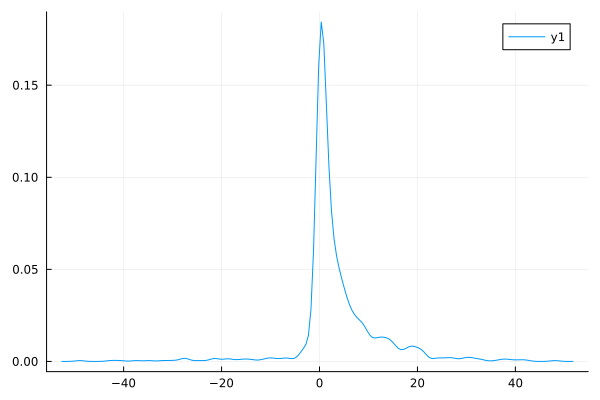

In [327]:
lim = 50
density([i for i in improvement if abs(i) < lim])

In [320]:
positiveImprovement = [i for i in improvement if i >= 0]

828-element Vector{Float64}:
  7.380845586209695
  1.0809778855065164
  0.05398809280964032
  0.14198900424294728
  0.2498113829775964
  0.717884245450662
  0.3716782801880727
 37.77136133183146
  1.1566299659113868
 14.2577334969162
 12.120137709545054
  0.30157655409915385
  9.868751891687586
  ⋮
  1.8355070175478747
  1.7896841054961588
 13.841968624624382
  0.9714367362683312
 15.490654763765551
  0.049157650480199024
  8.166115617664945
  4.269377588556234
  5.220033681498876
  4.2406720709569035
  0.23297979146688375
 30.840329344266483

In [321]:
mean(positiveImprovement)

5.008631150090688

In [328]:
median(positiveImprovement)

2.055563702255622

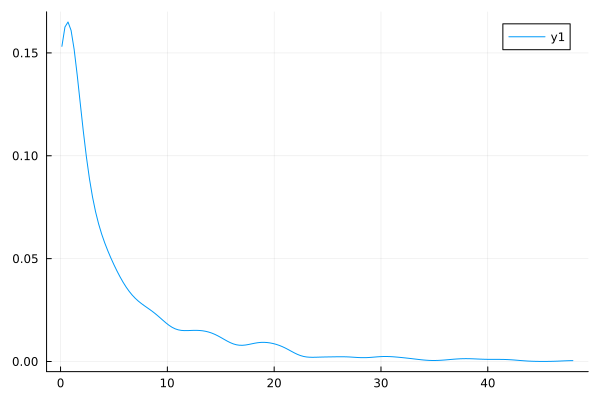

In [323]:
density(positiveImprovement, trim = true)

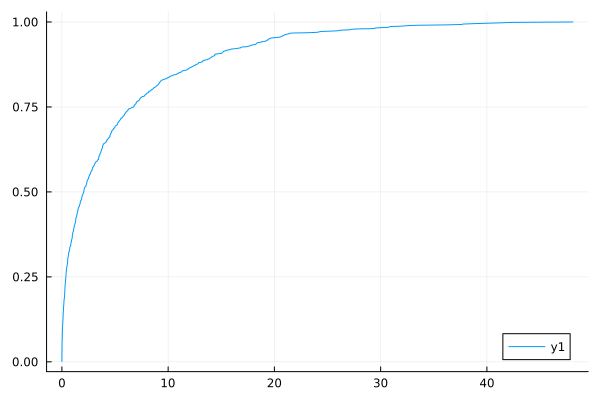

In [329]:
StatsPlots.plot(sort(positiveImprovement), (1:828)./828)

In [324]:
minimum(improvement)

-892.3358807390647

In [325]:
maximum(positiveImprovement)

48.09135806874787

## Experiment 2.1: UP

In [207]:
nMaxSmarpe = 2000000
nMaxgEval = 1000000
#dcps = []
#dcpGs = []
#dcpSoftGs = []
#piGs = []

#featuresListBig = []
#paramsListBig = []

#largeResultExp2_UP = Dict()

#largeResultExp2_UP["featuresListBig"] = featuresListBig
#largeResultExp2_UP["paramsListBig"] = paramsListBig
#largeResultExp2_UP["dcps"] = dcps
#largeResultExp2_UP["dcpGs"] = dcpGs
#largeResultExp2_UP["dcpSoftGs"] = dcpSoftGs
#largeResultExp2_UP["piGs"] = piGs

#f = serialize("largeResultExp2_UP.big", largeResultExp2_UP)

for i in (L+1):1000
    println("-----------------------------------------------------------------")
    print("Run: ")
    println(i)

    #get parameters
    tau = taus[i]
    #print("tau: ")
    #println([round(tau[i], digits = 5) for i in 1:N])

    alpha_r = alphas[i]
    #print("alpha_r: ")
    #println([round(alpha_r[i], digits = 5) for i in 1:N])

    c0 = c0s[i]
    #print("c0: ")
    #println([round(c0[i], digits = 5) for i in 1:N])

    c1 = c1s[i]
    #print("c1: ")
    #println(round(c1, digits = 5))

    r = rs[i]
    #print("r: ")
    #println([round(r[i], digits = 5) for i in 1:N])

    dcp, g, counter = jointHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    push!(dcps, dcp)
    push!(dcpGs, g)

    print("DCP: ")
    println(dcp)

    mcp = Array{Any}(nothing, N)
    for i in 1:N
        if dcp[i] == 1
            mcp[i] = -1
        else
            mcp[i] = alpha_r[i]*(1/1000)
        end
    end

    #calculate soft dcp g
    mu = copy(mcp)
    for i in 1:N
        if mu[i] == -1
            mu[i] = 1e100
        end
    end

    gSoft = calculateG_SSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, mu)[1]
    push!(dcpSoftGs, gSoft)

    print("DCP g: ")
    println(round(g, digits = 5))

    print("Soft DCP g: ")
    println(round(gSoft, digits = 5))
    
    #SMARPE steps
    Random.seed!(12345)
    sStart = fill(1, N)

    #construct problemParams struct
    probParams = problemParams()
    probParams.N = N 
    probParams.alpha = alpha_r
    probParams.beta = beta
    probParams.tau = tau
    probParams.c = c0
    probParams.p = c1
    probParams.r = fill(0.0, N)

    #precalculate FA usage costs
    gp = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, fill(0.0, N), c1, fill(0.0, N), dcp)
    gu = calculateG_DSP(N,alpha_d, alpha_r, beta, tau, c0, 0.0, fill(0.0, N), dcp)
    hUAggVec = append!([0.0], constructAggUsageH(N, alpha_r, beta, tau, c0, gu))


    #create lists of features and parameters
    features = []
    push!(features, one)

    for i in 1:N
        append!(features, [indicator(i,1), indicator(i,2), indicator(i, 3)])
    end 

    append!(features, [usedIndictor(i) for i in 1:(N+1)])

    params = fill(0.0, length(features))
    stepsizes = fill(1.0, length(features))

    #perform SMARPE
    Random.seed!(12345)
    resSMARPE = smarpeVFA_UP_MCP(probParams, nMaxSmarpe, mcp; hUAggVec = hUAggVec, params = params, features = features, stepsizes = stepsizes, vfaProvided = true, gu = gu, gp = gp, s = copy(sStart), stateTrace = [], printProgress = false, modCounter = 100000, printStates = false, rate = 0.1)
    println("SMARPE Complete")

    push!(featuresListBig, features)
    push!(paramsListBig, params)

    #evaluate API policy via simulation
    Random.seed!(12345)
    probParams.r = r
    gsPI = gEvaluationUP(probParams, dcp, nMaxgEval; hUAggVec = hUAggVec, params = params, features = features, stepsizes = [], gDCP = g, gu = gu, gp = gp, printProgress = false, modCounter = 100000, printStates = false)
    push!(piGs, gsPI[1])
    print("PI g:")
    println(round(gsPI[1], digits = 5))

    #save to file
    largeResultExp2_UP["featuresListBig"] = featuresListBig
    largeResultExp2_UP["paramsListBig"] = paramsListBig
    largeResultExp2_UP["dcps"] = dcps
    largeResultExp2_UP["dcpGs"] = dcpGs
    largeResultExp2_UP["dcpSoftGs"] = dcpSoftGs
    largeResultExp2_UP["piGs"] = piGs

    f = serialize("largeResultExp2_UP.big", largeResultExp2_UP)
    println("-----------------------------------------------------------------")
end

InterruptException: InterruptException:

In [208]:
L = length(piGs)

433

In [209]:
sum(piGs[i] <= 1.001*dcpGs[i] for i in 1:L)/L

0.9792147806004619

In [210]:
improvements = ((dcpGs[1:L] - piGs)./dcpGs[1:L]).*100

433-element Vector{Float64}:
  1.4282550694324234
  7.3803621304776375
  1.0803383806069615
  0.053903136084567226
  0.14203317507095253
  0.3705073364237302
  0.7183249774732545
  0.3718369300827824
 39.461396831948775
  2.277183196207661
  ⋮
  0.1052047106597411
  2.07315666055938
  0.12710976817986722
  8.086400098019848
 20.63188363771765
 13.298804214706866
  3.35026419184249
  5.254624170472044
  9.28581933513469

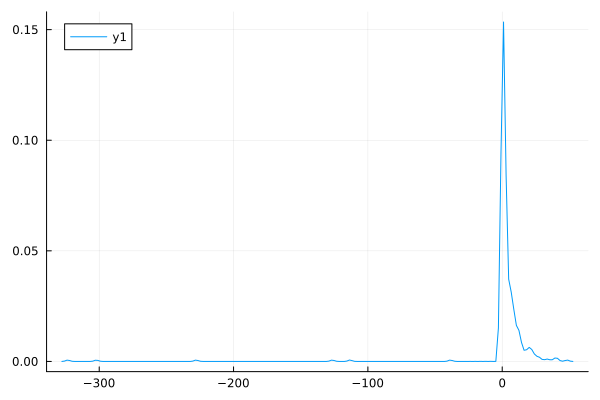

In [193]:
density(improvements)

In [194]:
minimum(improvements)

-323.3146852867704

In [211]:
posImprovements = [i for i in improvements if i >= -0.001]

402-element Vector{Float64}:
  1.4282550694324234
  7.3803621304776375
  1.0803383806069615
  0.053903136084567226
  0.14203317507095253
  0.3705073364237302
  0.7183249774732545
  0.3718369300827824
 39.461396831948775
  2.277183196207661
  ⋮
  0.1052047106597411
  2.07315666055938
  0.12710976817986722
  8.086400098019848
 20.63188363771765
 13.298804214706866
  3.35026419184249
  5.254624170472044
  9.28581933513469

In [213]:
bigImp = [i for i in posImprovements if i >= 1]

237-element Vector{Float64}:
  1.4282550694324234
  7.3803621304776375
  1.0803383806069615
 39.461396831948775
  2.277183196207661
  1.156668113041919
  4.401013073691952
 12.094493210561522
 22.157779472466164
  2.570215013301013
  ⋮
  1.2651832524434945
  1.8237274452562708
  2.07315666055938
  8.086400098019848
 20.63188363771765
 13.298804214706866
  3.35026419184249
  5.254624170472044
  9.28581933513469

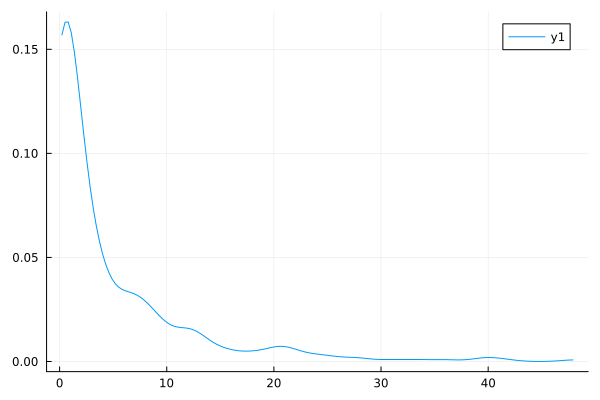

In [204]:
density(posImprovements, trim = true)

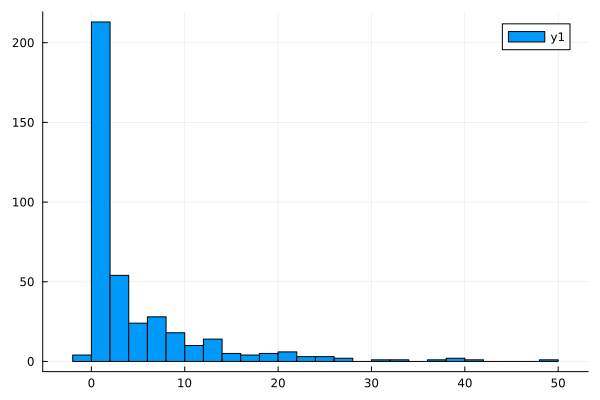

In [205]:
histogram(posImprovements)

In [212]:
mean(posImprovements)

4.717436228849997

## Experiment 3

Investigation into simulation error

In [245]:
nMaxSmarpe = 1000000
nMaxgEval = 1000000
dcps = []
exactGs = []
simGs = []
relErrors = []
for i in 1:1000
    println("-----------------------------------------------------------------")
    #get parameters
    tau = taus[i]
    print("tau: ")
    println([round(tau[i], digits = 5) for i in 1:N])

    alpha_r = alphas[i]
    print("alpha_r: ")
    println([round(alpha_r[i], digits = 5) for i in 1:N])

    c0 = c0s[i]
    print("c0: ")
    println([round(c0[i], digits = 5) for i in 1:N])

    c1 = c1s[i]
    print("c1: ")
    println(round(c1, digits = 5))

    r = rs[i]
    print("r: ")
    println([round(r[i], digits = 5) for i in 1:N])

    dcp, g, counter = jointHeuristic(N, alpha_d, alpha_r, beta, tau, c0, c1, r)
    push!(dcps, dcp)
    push!(exactGs, g)

    print("DCP: ")
    println(dcp)

    print("Exact DCP g: ")
    println(round(g, digits = 5))

    #Simulated g value
    Random.seed!(12345)
    gs = gEvaluationDSP(N,alpha_d, alpha_r, beta, tau, c0, c1, r, nMaxgEval, dcp; s = fill(1, N),  epsilon = -1.0, printProgress = false, modCounter = 100000, forceActive = false, stateTrace = false)
    push!(simGs, gs[1])
    print("Sim DCP g:")
    println(round(gs[1], digits = 5))

    #Find error 
    error = 100*( (g - gs[1])/g )
    push!(relErrors, error)
    print("Error: ")
    print(round(error, digits = 5))
    println("%")
    println("-----------------------------------------------------------------")
end


-----------------------------------------------------------------
tau: [0.79181, 0.15958, 0.33419, 0.81139, 0.79663, 0.91781, 0.31133, 0.75291, 0.63385, 0.89995]
alpha_r: [0.04209, 0.00092, 0.08004, 0.00174, 0.0383, 0.05824, 0.03548, 0.02483, 0.00868, 0.07356]
c0: [0.05805, 0.08217, 0.16504, 0.20717, 0.27659, 0.36701, 0.39868, 0.81137, 0.92479, 0.97376]
c1: 835.69729
r: [58.08576, 41.21976, 55.95246, 59.85141, 26.05061, 29.5834, 26.19536, 74.49579, 7.75329, 86.68002]
DCP: [0, 1, 0, 1, 0, 0, 0, 0, 0, 0]
Exact DCP g: 0.45756
Sim DCP g:0.45686
Error: 0.15356%
-----------------------------------------------------------------
-----------------------------------------------------------------
tau: [0.85452, 0.78337, 0.86949, 0.23438, 0.34336, 0.83449, 0.07255, 0.98995, 0.53934, 0.65504]
alpha_r: [0.01122, 0.04989, 0.05157, 0.00445, 0.0531, 0.05171, 0.0495, 0.04895, 0.02736, 0.01805]
c0: [0.2568, 0.37444, 0.44573, 0.59938, 0.61427, 0.68416, 0.72628, 0.8066, 0.80894, 0.83744]
c1: 302.50394
r: [

Excessive output truncated after 524302 bytes.

Sim DCP g:1.46877
Error: -0.15134%

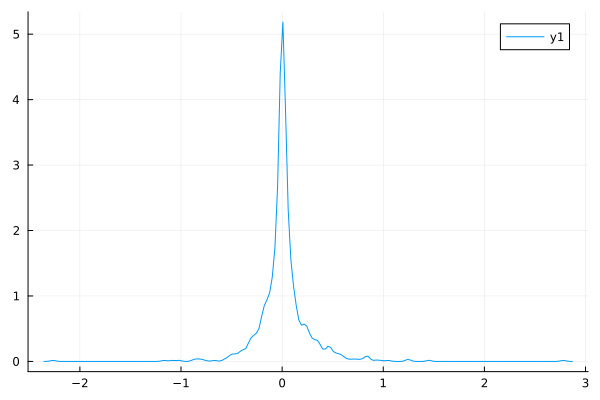

In [255]:
density(relErrors)

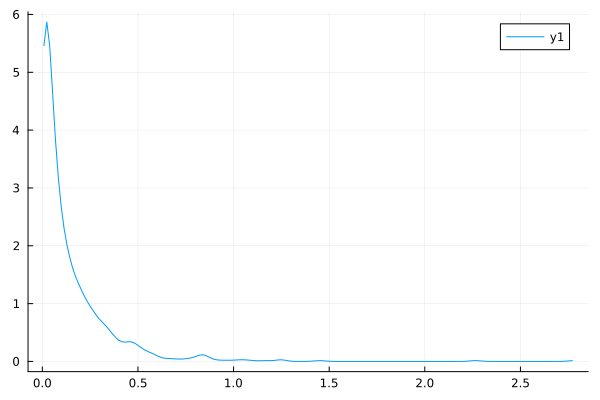

In [250]:
density(abs.(relErrors), trim = true)

In [248]:
mean(abs.(relErrors))

0.14063188724828243

In [256]:
sum(abs(r) <= 1 for r in relErrors)

991